# Tracking and tracing audiovisual reuse: Introducing the Video Reuse Detector

### Tomas  Skotare [![orcid](https://orcid.org/sites/default/files/images/orcid_16x16.png)](https://orcid.org/0000-0001-8445-0559) 
Humlab, Umeå University.


### Pelle  Snickars [![orcid](https://orcid.org/sites/default/files/images/orcid_16x16.png)](https://orcid.org/0000-0001-5122-1549) 
Department of Art and Cultural Sciences, Lund University.

### Maria  Eriksson [![orcid](https://orcid.org/sites/default/files/images/orcid_16x16.png)](https://orcid.org/0000-0002-7534-4268) 
Department of Art, Media, Philosophy, University of Basel.

[![cc-by](https://licensebuttons.net/l/by/4.0/88x31.png)](https://creativecommons.org/licenses/by/4.0/) 
© Tomas Skotare - Pelle Snickars - Maria Eriksson. Published by De Gruyter in cooperation with the University of Luxembourg Centre for Contemporary and Digital History. This is an Open Access article distributed under the terms of the [Creative Commons Attribution License CC-BY](https://creativecommons.org/licenses/by/4.0/)


In [1]:
import os 
from ipywidgets import Layout
from io import BytesIO
import numpy as np
import pandas as pd
import sys
import base64


import plotly.io as pio
pio.renderers.default = "png"
import kaleido

# we disable tensorflow warnings as they are verbose
# if things do not work, this suppression should be removed
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '2'
import tensorflow as tf

gpus = tf.config.experimental.list_physical_devices('GPU')
for gpu in gpus:
  tf.config.experimental.set_memory_growth(gpu, True)

In [3]:
from pathlib import Path
from IPython.display import Image, display

def image_metadata(image: str, metadata:str = None):
    if metadata is not None:
        metadata =  {
            "jdh": {
                "module": "object",
                "object": {
                    "type":"image",
                    "source": [metadata]
                }
            }
        }
    if not Path(image).exists():
        print(f'THE IMAGE DOES NOT EXIST: SKIPPING')
        return   

    img = Image(image)
   
    display(img, metadata=metadata)

def print_project_frame_extractor_info(project):
    video_count = len(project.frame_extractor.video_list)
    frame_count = len(project.frame_extractor.all_images)
    print(f'For project "{project.name}":\nNumber of video files: {video_count}\nNumber of frames extracted: {frame_count}\n')

The reuse and reappropriation of audiovisual content have been a recurring topic of research in the humanities, not least in studies of remix cultures. An open question that remains, however, is how artificial intelligence and machine learning may help scholars study the reuse of audiovisual heritage. In this article, we introduce the Video Reuse Detector (VRD) – a methodological toolkit for identifying visual similarities in audiovisual archives with the help of machine learning. Designed to assist in the study of the “social life” and “cultural biographies” (<cite data-cite="1971321/6PBSUNC7"></cite>, <cite data-cite="1971321/N7PZTCJU"></cite>) of video clips, the VRD helps explore how the meaning of historic footage changes when it circulates and is recycled/cross-referenced in video productions through time. The toolkit uses machine learning techniques (specifically, convolutional neural networks) combined with tools for performing similarity searches (specifically, the Faiss library) to detect copies in audiovisual archives. It also assembles a series of tools for trimming and preparing datasets and filtering/visualizing matching results. Inspired by the “visual turn” in digital history and digital humanities research, the article introduces and exemplifies the basic logic and rationale behind the VRD, and discusses how the digitization of audiovisual archives opens new ways of exploring the reuse of historic moving images. 

Digital methods, Machine learning, Cultural reuse, Video archives

Excerpts from this article have been published in Eriksson, Skotare & Snickars. 2022. 'Understanding Gardar Sahlberg with neural nets: On algorithmic reuse of the Swedish SF archive' in Journal of Scandinavian Cinema, Volume 12(3). p. 225 - 247.

## Introduction

On February 28, 2023 the Swedish YouTuber [RosaMannen](https://www.youtube.com/user/RosaMannen) — the Pink Man — uploaded an [episode](https://www.youtube.com/watch?v=arIukjQWxuU&t=783s) from the TV documentary series *Sweden, A Long Time Ago* on YouTube. Originally broadcasted on Swedish public television in 1997, the clip was 18 minutes long and surveyed the history of Swedish handicrafts, ranging from knitting to the tying of brooms and the production of metal nails. Unspectacular in its execution, the episode featured black-and-white footage of farmers preparing wool, cutting grass, and craftsmen building wooden ladders. Since 2006, RosaMannen (also known as Daniel Johansson) has uploaded tens of thousands of similar TV clips on his YouTube channel, which now provides an impressive overview of Swedish television history. Alongside episodes from the TV series *Sweden, A Long Time Ago* — which for example also includes episodes on [industrialization](https://www.youtube.com/watch?v=MettI_h2Oiw) and [school children](https://www.youtube.com/watch?v=yT5ffg_mkQY&t=9s) — his channel features an eclectic mix of cooking shows from the early 1980s and 90s, children’s shows, televised concerts by popular Scandinavian artists, investigative journalism series, historic news reports, and much, much more. These videos have accumulated millions of views and roughly 40 000 subscribers now follow RosaMannen’s channel on a day-to-day basis. Indeed, Johansson has become something of a national video celebrity, whose persistent commitment to digitizing either donated or purchased home-recorded VHS tapes has made a vast number of Swedish television shows available to the wider public. 

RosaMannen’s way of making Swedish TV history available on YouTube is illustrative of amateur archivist practices and a flourishing online video culture. His uploading of content is, however, far from legal. RosaMannen’s logo features a man in a pink suit wearing a Guy Fawkes mask yet despite this anti-establishment protest, Swedish Television has refrained from posting take-down requests. During the past decades, a massive body of audiovisual heritage has been digitized and made available online – not just by television enthusiasts such as Johansson, but by a wide range of cultural heritage institutions. This has radically transformed public access to cultural heritage and fostered new ways of engaging with the audiovisual past. By increasing the visibililty of historic video content and allowing it to circulate online, audiovisual memories are constantly revived, rewritten, and renegotiated. This does not least include breathing new life into seemingly mundane and low-key video clips – such as the episode on Swedish handicrafts – which otherwise likely would have drifted far into oblivion. Accompanied by ample user commentaries that interweave nostalgia and personal memories with discussions about nationalism, economics, and politics, the videos on RosaMannen's YouTube channel are an excellent example of how digital technologies help remediate cultural memories. 

Importantly, the digitization of audiovisual heritage has also opened up new ways of studying video archives at scale, as moving image collections can now be explored through computational means. In similar ways as the field of literature has expanded to engage with “distant reading” in the large-scale analysis of text (<cite data-cite="1971321/F98YWULX"></cite>), scholars have highlighted the potential in engaging with “distant viewing” in the context of audiovisual scholarship (<cite data-cite="1971321/3LPY6AMR"></cite>, <cite data-cite="1971321/DHJJL7VR"></cite>, <cite data-cite="1971321/DHJJL7VR"></cite>). For instance, previous studies have explored audiovisual content using algorithmic object and facial recognition techniques (ibid.), geographic mapping technologies (<cite data-cite="1971321/DRRKS77U"></cite>), and automatic color extraction and analysis (<cite data-cite="1971321/6C4DNEI4"></cite>). This growing body of research has inspired researchers to speak of a “visual turn” in the digital humanities, which takes advantage of how “computer vision techniques offer us a macroscopic perspective on thousands of images” (<cite data-cite="1971321/XVEENKLM"></cite>, pp.24).

In this article, we explore how audiovisual reuse can be tracked and traced through algorithmic means. Starting from a selection of television documentary series that are available on RosaMannen's YouTube channel, we investigate how digital tools can assist in studying video reuse in historic compilation documentaries. In particular, we set out to explore how footage in some of RosaMannen's digitized television series can be traced back to the so-called SF archive, which contains some of the earliest recordings in Swedish film history and includes roughly 5,500 newsreels and film fragments from 1897 to the early 1960s. Most of the oldest footage was filmed by cinematographers from Swedish Biograph, a company that in 1919 merged into SF (<cite data-cite="1971321/UPND8CJP"></cite>). In 1964, the SF-archive was bought by Radio Sweden (also responsible for television) – several short films from SF were purchased later – and ever since footage from the archive has been featured in thousands of TV programs. Around the millennium, the entire SF-archive was digitized in a collaborative effort between Radio Sweden and the Swedish National Archive of Recorded Sound and Moving Images. In our experiment, we work with roughly 1400 of the oldest digitized clips found within the archive (from the silent period of film history) to explore how reuse has taken place between the archive and the selected television series found on YouTube. Four different TV series from the 1980s, 90s and early 2000s were chosen, based on RosaMannen's digitization efforts: (1.) *Förväntningarnas tid* (The Time of Expectations) from 1985, a series in four hour-long episodes; (2.) *Guldkorn* (Gold Nuggets) from the SF-archive, six hour-long episodes from 1985 and six from 2002; (3.) *Sverige för länge sedan* (Sweden, A Long Time Ago), a TV series from 1984 in ten episodes, each around twenty minutes long; and (4.) *Hundra svenska år* (A Hundred Swedish Years), eight hour-long episodes from 1999. Since all these TV series focus on Swedish 20th-century history, we knew they would likely include reused content from the SF-archive. However, we were unaware of the scale and precise details of what such reuse would look like. 

To assist us in unraveling reuse between the SF-archive and the selected TV series, we introduce the Video Reuse Detector, or VRD – a toolkit for detecting visual similarities in audiovisual datasets. The VRD was developed in the year of 2020-2021 and opens up for asking questions such as: How is video content recycled, cross-referenced, and reused in video archives throughout history? And in what ways can the “social life” and “cultural biographies” (<cite data-cite="1971321/6PBSUNC7"></cite>, <cite data-cite="1971321/N7PZTCJU"></cite>) of audiovisual content be traced? These questions aim to follow the histories and career paths of individual video clips and explore how their cultural value and meaning transforms as they circulate in space and time. As Wolfgang Ernst notes, automated techniques for identifying and processing cultural content provide a unique opportunity to side-step traditional metadata (i.e., textual/semantic descriptions of cultural content) to instead perform searches *within* content itself (<cite data-cite="1971321/FGUTFYAY"></cite>). Thereby, they also introduce a radically new way of navigating and interacting with historic archives.

In the following text, we first provide an overview of previous research concerning cultural reuse. We also discuss uses of audiovisual analysis tools within digital history and the digital humanities. This overview shows that even though scholars have started using AI to analyze and navigate audiovisual archives, there is a lack of open-source toolkits that are customized for studying video reuse. Next, we introduce the Video Reuse Detector; an audiovisual content identification toolkit developed at Humlab, Umeå University. Using machine learning models (convolutional neural nets) and indexation libraries (Faiss), the VRD allows for studying how audiovisual content is reused, remixed, and re-appropriated within a given archive. Here, we make use of the Journal of Digital History's notebook setup to illustrate how the VRD functions and apply the toolkit to two demonstration videos: [The Eagle Has Landed: The Flight of Apollo 11](https://archive.org/details/gov.archives.arc.45017) which contains original footage from the first moon landing in July 1969 and was released by the U.S. National Aeronautics and Space Administration (NASA) in the same year, as well as [The Moon and Us](https://archive.org/details/journey-through-the-solar-system-episode-06-the-moon-us), which consists of Episode 6 from the documentary series *Journey Through the Solar System* that was also produced by NASA and contains footage from Apollo 11 mission. The data and code needed to run this toolkit demo on any computer are openly available on Github, making it possible for anyone to reproduce the demo and test/interact with the toolkit by themselves. 

After this demonstration, we show how the VRD can also help in the analysis of larger audiovisual datasets, namely the aforementioned SF-archive and TV series. In this case, however, the original datasets used could not be made openly available online for copyright and practical reasons – apart from the TV series that are already available on RosaMannen's YouTube channel. Hence, the second part of the article is closed and non-interactive, yet aimed to illustrate the broader potential of applying the VRD to larger sets of source materials. Our demonstration of the VRD toolkit is thus simultaneously an attempt to introduce a method for using machine learning to study video reuse – and an attempt to explore how reuse took place between the SF archive and historic, Swedish television documentaries in the 80s, 90s and early 2000s. Here, we also reflect upon the double remediation taking place as RosaMannen later picks up on and reuses the same video content on YouTube.

### Studying reuse with neural nets

The reuse, remixing, and reappropriation of cultural content – such as the production of compilation documentaries or the circulation of video content online – has been a recurring topic of investigation in the humanities. Central to the field is exploring how cultural memory and identities are (re)shaped through the circulation of cultural content, including things such as images, texts, and films. As David Jay Bolter and Richard Grusin note, cultural memory is fundamentally built on the "remediation" and repurposing of already existing memory-matters (<cite data-cite="1971321/8WKJL6UD"></cite>). Through acts of reuse, memories become created, stabilized, and consolidated; and "just as there is no cultural memory prior to mediation there is no mediation without remediation: all representations of the past draw on available media technologies, on existent media products, on patterns of representation and medial aesthetics" (<cite data-cite="8918850/VA9H5RMU"></cite>, p. 4). To borrow from Aleida Assmann: the medium and media of cultural memories therefore matter (<cite data-cite="1971321/PW6NUM4D"></cite>) and by studying how specific cultural objects (letters, photographs, moving images, etc.) have been copied and reused, we can gain important clues regarding the transformation of cultural ideas and identities over time. This is true regardless if we are interested in the history of Shakespeare's manuscripts, the afterlife of home-recorded VHS tapes on YouTube, or the circulation of viral TikTok memes. 

The historic study of cultural reuse has also taken many forms – stretching from philology in literature (<cite data-cite="1971321/SQBG3YDT"></cite>), to the study of remix and sampling in popular culture (<cite data-cite="1971321/IQDXCEY4"></cite>, <cite data-cite="1971321/QBIZTPES"></cite>). In the particular case of television history, many have pointed out the special role of TV in shaping cultural memory, creating nostalgia, and reproducing historic narratives (<cite data-cite="1971321/HDLKG7JB"></cite>, <cite data-cite="1971321/L2CHQEY6"></cite>, <cite data-cite="1971321/F3L4G94K"></cite>). Yet the research field is also faced with methodological challenges. To this date, scholars of cultural reuse have mainly had to follow traces in individual documents (such as references to previous works) or rely on textual metadata. For example, studying how a particular photograph has been reused through time may have involved searching through archives using metadata keywords, and manually studying interesting finds. This is highly time-consuming and implies relying on textual descriptions that may be of poor quality and level of detail. As a result of digitization, however, it becomes possible to 'look into' and search through the actual contents in archives at a scale that has not been possible before. Drawing inspiration from fields such as digital forensics (<cite data-cite="1971321/AVXYWLKN"></cite>), we can begin to use computational techniques to investigate the origins of cultural objects and search for visual similarities in vast archives. 

To this date, automatic content recognition techniques have been amply explored and developed in various computer science fields such as machine vision and information processing/retrieval. Early approaches for detecting image reuse included algorithmic techniques for finding geometric shapes in images, watermarking which drew on stenographic techniques to encode messages in images to make them recognizable, as well as hashing and feature detection technologies like the ORB, or [Oriented FAST and Rotated BRIEF](https://docs.opencv.org/3.4/d1/d89/tutorial_py_orb.html), which finds visual similarities by identifying pixel intensities and key points. A problem with many of these early techniques, however, was that they were slow in processing large amounts of data. Furthermore, they were often unable to detect visual similarities if content had been modified. While moving images that have been copied to the point – minute by minute, frame by frame – are often fairly easy to recognize, partial reuses of video content (where short segments of videos are copied), or instances where videos have been heavily remixed or manipulated (for example by changing their color, sharpness, composition or playback speed) presents a more difficult task. To face this problem, research has increasingly turned to artificial intelligence and machine learning, where techniques such as Convolutional Neural Networks (or CNNs) provide radically new ways of finding visual similarities in datasets. While not immediately concerned with the study of cultural reuse, such research has illustrated how artificial intelligence can assist in navigating and exploring digital archives in radically new ways. For instance, scholars have used artificial intelligence to identify scenes in collections of historic press photos (<cite data-cite="1971321/U9S22YVC"></cite>) and to explore gender representations in millions of historic advertisements (<cite data-cite="1971321/UN4WYWZW"></cite>), as well as nearly 3400 issues of Times Magazine (<cite data-cite="1971321/5BEURW8Z"></cite>). Others have used machine learning to conduct portrait studies in historic photographic datasets (<cite data-cite="1971321/Y5C3N4AT"></cite>) and explored how iconic photographs are (and aren't) memorized with the help of AI (<cite data-cite="1971321/GFJWVYNX"></cite>). 

A number of projects have also developed methodological toolkits for exploring audiovisual content with the help of machine learning – a source material that is often more complex to work with than still images because of its temporal dimension and the large size of datasets. Consider, for instance, that digital videos generally contain 24-30 frames or images per second, which means that 10 minutes of video may contain 14 400-18 000 images alone. This poses problems in terms of access to computational power. In the United States, however, the [Media Ecology Project](https://mediaecology.dartmouth.edu/wp/) at Dartmouth College has prototyped a machine vision search engine for identifying objects and actions in videos, and at the University of Richmond, the [Distant Viewing Lab](https://distantviewing.org/) has released a Python package for analyzing visual culture on a large scale, including features like facial recognition. In Germany, the project [Visual Information Retrieval in Video Archives](https://projects.tib.eu/en/viva/projekt/) has also been established to support media archives by developing a ‘videomining software’ that can for example be used to classify events (<cite data-cite="1971321/VST2JWDJ"></cite>), person relations (<cite data-cite="1971321/EUA6HDDW"></cite>) and video scenes based on geolocation (<cite data-cite="1971321/ER4QZFVE"></cite>).

Similarily, [The Sensory Moving Image Archive](https://sensorymovingimagearchive.humanities.uva.nl) project in the Netherlands has experimented with stylometric film analysis (i.e. exploring characteristic stylistic features of films and filmmakers) and released a so-called [Nearest Neighbour Browser](https://isis-data.science.uva.nl/nanne/SEMIA/#662692_1) that allows for exploring visual similarities in datasets (although without using specific images as input). The toolkit [PixPlot](https://github.com/YaleDHLab/pix-plot), developed by scholars at the Digital Humanities lab at Yale, does something similar, as it allows for two-dimensional clustering and visualization of visual similarities in tens of thousands of images. Another example is the software Snoop, which has been developed by the French Institut National de l'audiovisuel (Ina) in collaboration with the French National Institute for Research in Digital Science and Technology (Inria) since 2003. Snoop, which previously went under the name Signatur, is a visual search engine that applies the open-source machine learning framework PyTorch to find visual similarities in datasets (<cite data-cite="1971321/RZCYR4B3"></cite>). The toolkit has been used to explore and enrich visual archives by researchers connected to Ina/Inria, as well as cultural heritage institutions such as Musée d’Orsay and the Bibliothèque Nationale de France. It has also been used in citizen science projects such as [PlantNet](https://plantnet.org/en/), where it assists in identifying plants in photographic images. However, Snoop is a [proprietary software](https://hal.science/hal-02096036v1) that is not openly available for use.

In the toolkits mentioned above, machine learning models have mainly been used to produce semantic metadata and textual interpretations of what appears in images (including scene, object, or facial recognition), or to find *general* visual similarities in datasets. For example, the toolkits are often geared towards finding examples of when say, astronauts, appear in images so that several depictions of astronauts can quickly be retrieved and studied. In our case, however, we are not interested in finding examples of how astronauts appear in datasets *in general*. Rather, we want to explore how a *specific* depiction of a *specific* astronaut appears in a dataset - say footage of Neil Armstrong taking his first steps on the moon. And toolkits that are specialized in finding these kinds of audiovisual reuse are less common to find.

## Video Reuse Detector

In response to the lack of open-source software for audiovisual copy detection, we introduce the VRD – a methodological toolkit for identifying visual similarities in audiovisual archives with the help of machine learning. The VRD is meant to help archivists and humanistic scholars study video reuse and was originally developed within the research project European History Reloaded: Curation and Appropriation of Digital Audiovisual Heritage, funded by the JPI Cultural Heritage project, EU Horizon 2020 research and innovation program. Its main developer is Tomas Skotare, with assistance from Maria Eriksson and Pelle Snickars. The toolkit handles all video formats supported by the FFmpeg framework and is built to be used in Jupyter Notebooks. It is free to use and download and the source code is openly available on [Github](https://github.com/humlab/video_reuse_detector).

In what follows, we demonstrate how the toolkit functions by applying the VRD to two videos that are openly available on [Archive.org](https://archive.org/). The first video, entitled [The Eagle Has Landed: The Flight of Apollo 11](https://archive.org/details/gov.archives.arc.45017), contains footage from the first moon landing in July 1969 and was released by the U.S. National Aeronautics and Space Administration (NASA) in the same year. The second video, entitled [The Moon and Us](https://archive.org/details/journey-through-the-solar-system-episode-06-the-moon-us), consists of Episode 6 from the documentary series *Journey Through the Solar System* which was also produced by NASA. First released in 1983, the series contains footage from various Apollo missions, including Apollo 11. Both clips are roughly 30 minutes long and are used in compliance with their respective licenses. Before we used the videos in this demo, we compressed them with HEVC to stay within Github's allowed file size of 100 MB/file.

When assembling the VRD, the following rationale has guided our work:

- All applied software solutions are open source. In other words, they are licensed to be openly available for anyone to use, study, change, and distribute without cost.

- All applied software solutions can be exchanged at any time. This is ensured by the modularity of the VRD’s Jupyter Notebook and its associated Github page which is open for anyone to tweak and adjust.

- No data is exchanged with commercial actors. Aside from sharing information with Jupyter Notebook and local storage systems chosen by the user, the VRD does not transmit any data to third-party actors (including those who developed parts of its code).

The VRD toolkit is designed to process data in seven main steps which are introduced in the following sub-sections. Technical details and a step-by-step tutorial that explains how the toolkit works are placed in the article's hermeneutics layer. In the article's narrative layer, we present a textual description of the toolkit's main functionality principles. As previously stated, it is possible to download and run a local copy of the demo section by visiting the project's [Github page](https://github.com/humlab/video_reuse_detector). Readers who are less interested in methods and the technical workings of the VRD are advised to jump to the section [Finding reuse in the SF archive](#Finding-reuse-in-the-SF-archive). 

### Step 1. Pre-process videos

To begin with, the VRD includes tools for dividing audiovisual content into still frames. Digital videos generally contain 24-30 frames per second and the VRD is instructed to extract one frame per second of video by default. These still images constitute the VRD's main object of analysis. Since our research team was originally interested in performing visual similarity searches, the current version of the VRD only does not analyze sound. This means that the tool cannot detect if the audio track of a video file has been reused and reappears somewhere else. The rationale for this is that reused video is often dubbed/overlayed with different audio, meaning that the audio might not match even in cases where the video is reused. Adding audio features to the VRD has therefore not been a priority at this stage. 

The first step in using the VRD involves importing a series of necessary modules.  

In [2]:
from vrd import neural_networks, vrd_project, faiss_helper
from vrd.neural_networks import NeuralNetworks
from vrd.sequence_finder import SequenceFinder

We also install ffmpeg since it is a prerequisite for ffmpeg-python.

In [3]:
!apt update
!apt install -y ffmpeg

Reading package lists... Done
E: Could not open lock file /var/lib/apt/lists/lock - open (13: Permission denied)
E: Unable to lock directory /var/lib/apt/lists/
E: Could not open lock file /var/lib/dpkg/lock-frontend - open (13: Permission denied)
E: Unable to acquire the dpkg frontend lock (/var/lib/dpkg/lock-frontend), are you root?


We start a new project and give it a name. We also inform the VRD where to locate the video files we want to work with and choose to apply the neural network EfficientNetB4 from the Keras API. We decide to export vectors/fingerprints from a layer called Block7b_se_squeeze in EfficientNetB4.

In [4]:
demo_project = vrd_project.VRDProject(
    name = 'demo_project', 
    project_base_path="./vrd_projects/",
    video_path = 'media/demo/', 
    network = neural_networks.NeuralNetworks.efficientnetb4,
    stop_at_layer='block7b_se_squeeze'
)

We extract one frame per second from each video file. These frames are saved in the project directory, under the frames subdirectory. As can be seen in the example below, this meant that 3419 frames were extracted from the source material.

In [5]:
demo_project.initialize_frame_extractor(force_recreate=True)
print_project_frame_extractor_info(demo_project)

  0%|          | 0/2 [00:00<?, ?it/s]

For project "demo_project":
Number of video files: 2
Number of frames extracted: 3419



### Step 2. Produce fingerprints

Second, the VRD uses a so-called Convolutional Neural Network – or CNN – to extract the key visual features found in each frame. We call these extracted visual features "fingerprints." CNNs constitute a common method for studying visual imagery with the help of artificial intelligence. Modeled to imitate the connectivity pattern of neurons in the visual cortex of animals, neural networks are used in areas such as facial recognition, medical imaging, and autonomous driving. We decided to work with CNNs after doing multiple tests with more traditional tools for visual content recognition, including image hashing and video fingerprinting with the help of [ORB](https://docs.opencv.org/3.4/d1/d89/tutorial_py_orb.html) (Oriented FAST and rotated BRIEF) – a method for extracting and comparing visual features in images. CNNs quickly outperformed the ORB technology’s ways of identifying visual similarities in video content, however, both in terms of accuracy and processing speed.

It is beyond the scope of this article to explain how CNNs work in depth (for more information on the topic, one place to start is [Wikipedia](https://en.wikipedia.org/wiki/Convolutional_neural_network)), but we make a couple of remarks regarding the technology's basic technical structure. While the detailed technical workings of individual CNNs differ, neural networks are broadly designed according to multiple layers of analysis and abstraction. Each layer in a CNN will process an input and produce an output, which is passed on to the next layer. For instance, one layer in a CNN may observe how pixels are spatially arranged in an image and search for areas with high contrast between nearby pixels (a good marker for what is visually unique in a picture), while another layer might focus on reducing what information is stored about pixel contrasts (instructing the model to “forget” all areas in a picture with a lower pixel contrast than a given value, for example). In this way, the CNN produces a successively smaller and hopefully more precise map of the analyzed image. Somewhere before the final layer of a CNN is reached, the network will produce a highly compressed interpretation of the key visual characteristics of images. It is then common for the remaining layers in a CNN to classify what appears in the image, for instance by recognizing faces and objects.

In our case, the VRD applies a CNN to process individual frames but stops when a compressed yet sufficiently complex interpretation of the key visual features of an image has been produced. Again, we call these compressed interpretations fingerprints and the VRD will use them to find patterns of similarity across videos. In more detail, the VRD will export data in the form of vectors from a given layer in a CNN. These vectors mirror the visual characteristics found in the original frames. A vector is a mathematical quantity that discloses the magnitude (or length) and direction of a geometric object. In other words, we can say that fingerprints are mathematical abstractions that carry information about what a machine learning model considers to be visually unique in each frame. What is good about fingerprints is that their detailed yet highly abstracted information can be used to recognize visual similarities even if a video has been modified or distorted. For instance, frames can be recognized as similar even if someone has adjusted their color, resolution, or composition. This is useful when studying reuse and remix practices. 

When the VRD extracts its vectors/fingerprints from a given intermediate layer in a CNN – something that is otherwise done to visualize the learning process of a CNN, for example – the remaining layers of a neural net are not evaluated (more about this in the [Keras FAQ](https://keras.io/getting_started/faq/#how-can-i-obtain-the-output-of-an-intermediate-layer-feature-extraction)). We partly do this to save time/computing power, and partly because we are not interested in classifying the content in images. Instead, we essentially use a CNN to compress and vectorize video frames. It is important to understand that this is not how CNNs are normally used. Therefore, we also know relatively little about which CNN and extraction layer are best suited for the task. Commonly, the performance of CNNs are evaluated based on tests such as the [ImageNet Large Scale Visual Recognition Challenge](https://www.image-net.org/challenges/LSVRC/), where a neural network's capacity to recognize objects/faces in images is compared against human beings's ways of performing the same task. Tests such as the ImageNet Challenge are not designed to evaluate a CNNs ability to compress and vectorize frames, however. When looking at previous evaluations of CNNs and deciding what neural network to use (see [Keras documentation](https://keras.io/api/applications/)), we have therefore mainly searched for CNNs that are relatively new and perform well in overall tests. 

The current version of VRD is based on [TensorFlow2](https://www.tensorflow.org/), which includes the open-source Keras API. TensorFlow2 is an open-source machine learning platform and software library for working with machine learning and artificial intelligence. It was originally developed by Google and can be used for multiple purposes, including the training and inference of deep neural networks such as CNNs. The [Keras API](https://keras.io/about/) is a deep learning API that runs on top of the TensorFlow platform. Keras functions as an interface for solving machine learning problems and provides building blocks for using machine learning methods. We use version 2.11.0 of the Keras API which makes 11 pre-trained convolutional neural networks available for use. All of these networks are open source and can easily be applied in the VRD. We mainly decided to work with pre-trained neural nets since it was unfeasible for our small research team to train a new network from scratch. Furthermore, we found that many of the neural nets in the Keras API succeeded in producing vectors that were compressed yet detailed enough to study video reuse, without needing to be re-trained or fine-tuned. Hence, we decided to work with the networks directly in their original form. Re-training the networks on relevant datasets would likely further improve the performance of the VRD, however. 

Initially, we mainly worked with the neural network [ResNet50](https://keras.io/api/applications/resnet/) (see Snickars et.al. 2023) but later switched to a network called [EfficientNetB4](https://keras.io/api/applications/efficientnet/), which – at the time – was newer and performed better in accuracy tests. EfficientNet was first released by engineers at Google Research's Brain Team in 2019 (<cite data-cite="1971321/K5A3FXNI"></cite>), and at the time of this article's writing, it existed in seven different versions (see [Keras documentation](https://keras.io/api/applications/efficientnet/)). We have found that version B4 – which lies in the mid-range in the tradeoff between accuracy and speed among the EfficientNet versions – works well to identify video reuse. The current version of the VRD applies EfficientNetB4 *as is* (that is, without any re-training) and extracts its fingerprints from a layer called 'block7b_se_squeeze'. This layer is found toward the end of the network model (currently layer 463 out of 476). When deciding where to extract our fingerprint vectors, we wanted to find a layer that contained complex interpretations of the visual features in frames, yet produced vectors that were sufficiently compressed to work with large datasets. In addition, we wanted to find a layer where the neural network had not started to apply its object classification too strictly. In our tests, Block7b_se_squeeze appeared to live up to these qualifications. Importantly, however, we recommend exploring other layers (and CNNs) when using the VRD, as we have not performed any comprehensive performance tests of all CNNs in the Keras API and their respective layers.

We use EfficientNetB4 to create a fingerprint for each extracted frame and use these to populate the fingerprint database. The database is saved as 'database_file' in the project directory. Note that it is important to delete any pre-existing databases and start over if another CNN is used. This is done by specifying force_recreate=True. 

In [6]:
demo_project.populate_fingerprint_database(force_recreate = False)

Layer specified (block7b_se_squeeze), model index (463) will be ignored.


  0%|          | 0/3419 [00:00<?, ?it/s]

### Step 3. Calculate similarity neighbours

After saving extracted fingerprints in a database, the VRD applies its third step, where the [Faiss library](https://faiss.ai/) is used to calculate the closest similarity neighbors for each fingerprint. Faiss is an open-source software library that specializes in large-scale similarity searches. First released by Facebook AI Research in 2018, it efficiently clusters dense vectors and conducts large-scale similarity searches. For instance, Faiss can be run on Graphical Processing Units (GPUs) which provides significant advantages in terms of speed. More recent alternatives to using the FAISS index includes solutions like [USearch](https://github.com/unum-cloud/usearch) and [Haystack-Embedded](https://github.com/carsonpo/haystack-embedded), which were released in 2023 and 2024 and are reportedly 10-30 times faster than Faiss. We have no experience in using these indexes, but it is likely that they – or other, future solutions - could improve fingerprint indexation significantly. 

As an open [Faiss manual](https://www.pinecone.io/learn/faiss-tutorial/) explains, Faiss will index a given set of vectors and then use another vector (called the query vector) to search for the most similar vectors within the index. Faiss allows for determining which vectors are similar by measuring the Euclidean distance between *all* given points within an index using an index called IndexFlatL2. FlatL2 performs an *exhaustive* search and is very accurate in its evaluation of vector similarity, but slow since it matches/compares *every* point in the index (in our case, fingerprints) against the other, one by one. To speed up this process, the Faiss index contains several methods for optimizing similarity searches, although these will always be implemented at the cost of accuracy.

For instance, it is possible to optimize the speed of a Faiss similarity search by partitioning the index (i.e., limiting the search scope to *approximate* similarity, rather than calculating an absolute similarity) or by way of quantization, which involves compressing the size of vectors (more about this in the following [Faiss tutorial](https://www.pinecone.io/learn/faiss-tutorial/)). When the Faiss index has determined (or approximated) the similarities found within an index, it will output a "distance metric" to each compared set of vectors. The distance metric is a value that indicates how closely related their features are, according to Faiss. A low distance metric value (or short distance) indicates high similarity and a high distance metric value (or long distance) indicates low similarity. The distance metric 0.0 represents the absolute closest similarity Faiss can ascribe to two compared vectors and essentially corresponds to the distance that a vector would have to itself (i.e., an absolute match).

While Faiss can be used for any type of similarity search, the VRD uses it to identify visual similarities between frame fingerprints. In particular, the VRD will apply IndexFlatL2 to perform an exhaustive search and compare all fingerprints against each other, without optimizing the similarity search. While this is costly in terms of speed/processing power, it allows the VRD to later find sequential matches in the analyzed videos - a feature that is central to how the toolkit works. VRD users can overwrite the use of IndexFlatL2 and instead use the Faiss library's optimization methods. However, this implies that the VRD's current structure for outputting final matching results in the form of sequential matches will be lost.

To save time/memory and minimize the display of poor similarity matches, the Faiss index comes with a default setting that only shows the 100 closest neighbors for each analyzed vector. While it is generally desired to limit the number of neighbors shown for each vector, this threshold comes with drawbacks because of how the VRD is built. More specifically, it is important to note that the threshold is applied before the VRD runs another filter that removes all matches from the same video. This can cause problems if a video contains a lot of still images or slow visual movements since long sequences of frames from the same video could then be given a very low distance metric. In such cases, a frame's 100 closest neighbors may be occupied by lots of frames from the same video, while other relevant matching results are "pushed" out of the top 100 list. When all matches from the same video are filtered out from the top 100 similarity neighbors, important matches could thus be lost. While it would be preferable to filter matches from the same video *before* distance metrics are calculated and exported, the Faiss library does unfortunately not support this feature at the time of this article's writing (a problem that has also been noted by [others on Github](https://github.com/facebookresearch/faiss/issues/40)). It is, however, possible to adjust the 100 nearest neighbor threshold to reduce the risk of filtering out interesting matching results. This is done in the VRD, as the threshold is increased from 100 to 250 by default. 

The distance metrics produced by the Faiss library constitute a core element of the VRDs evaluation of visual similarity, although it is important to note one final thing, namely that these metrics are dynamic and will change/fluctuate depending on which dataset is processed. For instance, the quality of the source material and the number of images/frames in the dataset will affect how distance metrics are distributed. Likewise, the distribution of distance metrics is highly affected by which neural network and neural network layer is used. This means that there is no absolute value or threshold that indicates what distance metric value corresponds to a "correct" or "actual" instance of reuse. Instead, any use of the VRD will always involve manually exploring how each project's unique distance metric values correspond to actual visual likenesses in the source material.

We instruct Faiss to output the 250 closest neigbors for each fingerprint. These will be saved in the "neighbour_batch" subdirectory in the project directory. The VRD will apply Faiss IndexFlatL2 as is (i.e. perform an exhaustive search where all fingerprints in the index are compared against each other). To change this setting and make use of the Faiss library's similarity search optimization, changes have to be made to the source code. Note, however, that doing so will destroy the VRD's ability to find sequential matches.

We create a Faiss index of the fingerprints and save it as faiss_index in the project directory. If the index has already been created, the VRD will load the last saved index by default. Note that if any changes are made to the source material (i.e., the videos, frames, or fingerprints) or the selected CNN model it is necessary to recreate the index by passing the argument `force_recreate = True`.

In [ ]:
demo_project.initialize_faiss_index(force_recreate = True)

In [ ]:
demo_project.neighbours_considered = 250
demo_project.initialize_neighbours(force_recreate = True)

### Step 4. Analyze distance metric distribution

To determine how distance metric values should be interpreted, it is possible to view a distance metric visualization (histogram) that displays how metrics are distributed within a dataset. The visualization is useful for figuring out where to place a distance metric threshold and filter out irrelevant matching results. If the threshold is set too low, interesting matching results may get lost. If the threshold is set too high, there is a risk of being shown a high number of uninteresting matches.

We create a histogram to get an idea of where it might be suitable to place a distance metric threshold. When using the tool, we have found that placing the threshold around the point where the histogram indicates a sharp increase in found neighbors is a good start, although the specifics will be determined by the content and size of the dataset. Figure 1 shows a suggestion of where to place the distance metric threshold to begin with.

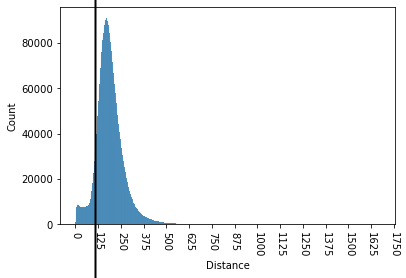

In [9]:
image_metadata("./media/distance_illustration.png", metadata="Suggestion of where to set the threshold in the analysis of a distance metric histogram.")

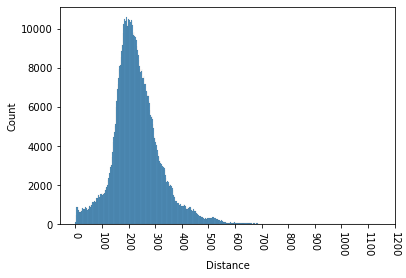

In [10]:
demo_project.neighbours.get_distance_histogram(halfway_x_ticks=True);

### Step 5.  Filter matching results

Next, it is possible to narrow down the search results with the help of two major filtering features. To begin with, it is possible to implement a general distance metric threshold before the final matching results are shown. For instance, the VRD may be instructed to only show fingerprint neighbors with a distance metric below the value 200. An accurate threshold (again, manual exploration is always necessary here) should greatly reduce the number of incorrect matches.

Second, the VRD includes a feature for applying what we call "sequential filtering." We define a sequence as an instance where two or more sequential fingerprints (i.e., frames that were extracted one after the other from the original file) from two separate videos have been given a distance metric below a specified value. If frame 1-6 in Video X and frame 11-16 in Video Y are each given a distance metric below the threshold 200, for example, this may be defined as a sequential match. 

Sequential filtering is used to identify instances when longer chunks of moving images have been reused and we assume that such chunks are more interesting to users than individual matching frames. Furthermore, we have found that sequential matches are generally more indicative of actual reuse than individual matching frames since there is a higher likelihood that actual cases of reuse have been found when at least two frames in a row have been assigned a low distance metric. Sequential filtering is implemented by deciding the minimum sequential length, or duration in seconds/frames. It is also possible to instruct the VRD to 'tolerate' that a given number of frames within a sequence deviates from the assigned distance metric threshold using the `allow_skip` parameter. Allowing some skipping is recommended, as it is likely to improve results.  For instance, it allows a sequence to be detected even if scene changes occur at slightly different times in different videos.

Importantly, the VRD's sequential filtering also includes an option called `combine_overlap`, which is a best-effort attempt to combine overlapping sequences into one. Overlapping sequences can occur if several seconds in a reused video looks very similar. Examples include reused videos with still footage, or slowly changing scenes such as panoramic overviews of landscapes. If this feature is disabled, it can lead to multiple similar sequences – which only differ slightly – to be presented in later steps, thus complicating the analysis.

For example, let's imagine that a scene depicting an ocean has been reused in two videos. In the reused scene we see a clear blue sky, a horizon, and moving waves but nothing else is happening in the picture. In such an example, several overlapping sequences may be found relating to the same footage. For instance, the VRD may find that frame 5-10 in Video 1 look very similar to frame 20-25 in Video 2. But the VRD may also find that frame 6-11 in Video 1, and frames 21-26 in Video 2 have a high visual similarity. This creates an overlapping sequence match with a slight time shift (i.e., starting one or two seconds before or after). If such overlapping sequences are not merged or combined into one, users are faced with unneccesseary clutter when looking at the sequential matching results. Hence, our solution is to combine overlapping sequences into one single sequence. 

To combine overlapping sequences, we search for sequences that overlap (i.e., contain the same frames), and merge them by starting at the earliest start time and ending at the latest end time. The algorithm can combine multiple different sequences into one, even if any one sequence does not overlap with all others. In the best-case scenario, the result is a single longer sequence that contains frames from two videos that are perfectly aligned. However, in some cases, a cumulative error from merging multiple overlapping sequences can result in a combined sequence that is significantly degraded from the original. This degradation is more likely to appear when the actual overlap has an offset of several seconds. As a consequence, the reported distance metric for the sequence (which is calculated from the mean of the frame-by-frame distance) can become misleadingly large, or even in some cases undefined. While this issue is currently unresolved, we believe it can be mitigated by performing a final matching step where the sequences are realigned to better match. A preview of such a feature can be viewed by specifying `show_shift=True` as an argument to the show_notebook_sequence function.

To recapitulate, the VRD performs its similarity search by converting videos to still frames and still frames to fingerprints. A similarity search is then performed on the fingerprints, producing for each frame a list of similar frames. Alternatively, one could describe the process as a matter of compressing, converting, and abstracting 'raw' audiovisual content to frames, frames to vectors, and vectors to distance metrics. Furthermore, the VRD contains tools for narrowing down the search results, including features for implementing distance metric thresholds, filtering out matching results from the same video, and applying sequential filtering, that is looking for instances when two sequences or more in a row have been assigned a low distance metric value.

We configure some filters to narrow down the search results. We set a maximum distance metric threshold for all found sequential matches, filter out all fingerprint matches from the same video, and decide on a sequence threshold (minimum duration in frames/seconds). Furthermore, we decide how many frames should be allowed to deviate from this threshold in a sequence (see `allow_skip` configuration) and combine all overlapping sequences into one.

In [11]:
demo_finder = SequenceFinder(
    demo_project.neighbours, 
    max_distance=125,
)

demo_finder.filter_matches_from_same_video()

demo_sequences = demo_finder.find_sequences(
    shortest_sequence=5, 
    allow_skip=2,
    combine_overlap=True,
)

3419
Maximum index found: 3418


  0%|          | 0/3419 [00:00<?, ?it/s]

Number of bytes required: 27352
Removing neighbours from same video...


  0%|          | 0/2 [00:00<?, ?it/s]

Removed 31871 entries (92.63%)!
Merged from 100 to 12 sequences


### Step 6. Output matching results

Final matching results are shown in the form of frame thumbnails where the longest found sequences will be shown first. It is possible to limit the number of shown sequences and customize the frame size. The detailed matching results for the NASA videos used in this demo can be found in the article's hermeneutics layer.

On the whole, the VRD's matching results are meant to function as a guide that points users towards videos that might be interesting to study manually in more detail. In other words, we strongly advise against using the VRD's matching results as an absolute proof of video reuse and instead emphasize the need to double-check the toolkit's evaluations. In short, the VRD should be approached as an assistance tool in navigating large video datasets. As will become evident, this is not least due to the weaknesses and pitfalls that the software brings with it.

We adjust the frame size and number of shown sequences and have a look at the final matching results. Note that the match mean distance values shown above the sequences may be higher than the previously set distance metric threshold. This is normal and expected, due to the merging of overlapping sequences. 

NOTE TO PEER REVIEWER FROM THE AUTHORS: if you are reading this in the journal's preview/rendering of the article you will be shown *a lot* of sequence matches below. We are aware that this creates a terrible reading experience and apologize for the inconvenience. At the moment, we are having a dialogue with the journal editors regarding the possibility to collapse cell outputs into a scrollable cell, which would make it much easier to read the hermeneutical layer. If you are reading this in Jupyter notebook, you will get a sense of what we want it to look like. If the journal is unable to meet our request to implement scrollable cell outputs, we are prepared to seriously revise how much data/output is shown in the hermeneutical layer. For now, however, we let the data remain as it is.

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
The Moon and Us x265.mp4,00:06:56,00:07:21,25,2122,190.951172,6
The Eagle Has Landed x265.mp4,00:12:36,00:13:01,25,756,190.951172,6


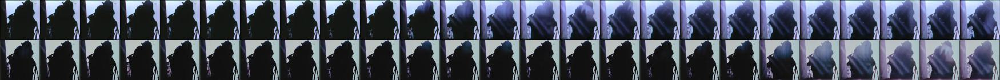

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
The Moon and Us x265.mp4,00:06:23,00:06:42,19,2089,202.467560,3
The Eagle Has Landed x265.mp4,00:11:18,00:11:37,19,678,202.467560,3


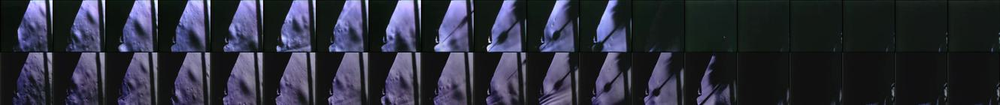

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
The Moon and Us x265.mp4,00:07:37,00:07:53,16,2163,183.856613,4
The Eagle Has Landed x265.mp4,00:16:45,00:17:01,16,1005,183.856613,4


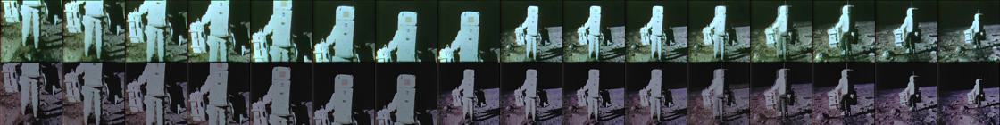

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
The Moon and Us x265.mp4,00:06:23,00:06:38,15,2089,210.874588,12
The Eagle Has Landed x265.mp4,00:19:11,00:19:26,15,1151,210.874588,12


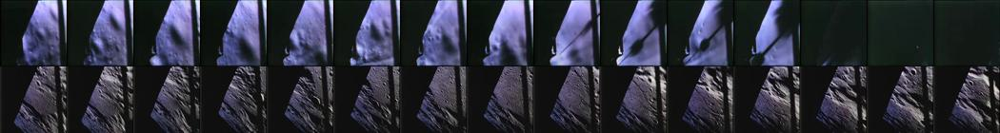

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
The Moon and Us x265.mp4,00:06:23,00:06:38,15,2089,195.551941,14
The Eagle Has Landed x265.mp4,00:23:10,00:23:25,15,1390,195.551941,14


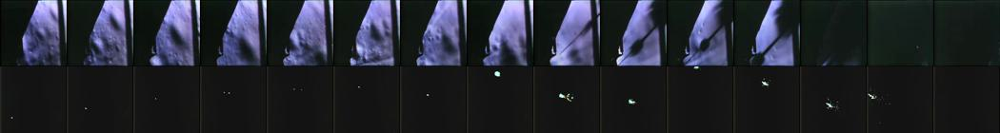

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
The Moon and Us x265.mp4,00:08:33,00:08:43,10,2219,178.567657,0
The Eagle Has Landed x265.mp4,00:17:40,00:17:50,10,1060,178.567657,0


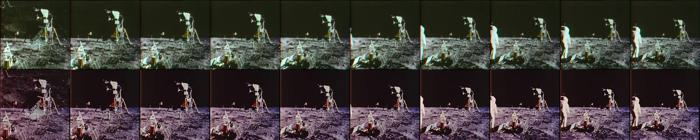

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
The Moon and Us x265.mp4,00:08:33,00:08:43,10,2219,214.169281,6
The Eagle Has Landed x265.mp4,00:17:58,00:18:08,10,1078,214.169281,6


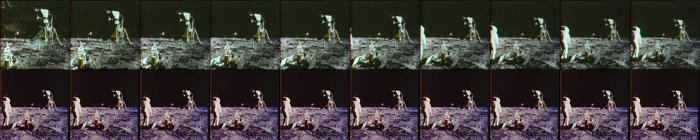

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
The Moon and Us x265.mp4,00:06:48,00:06:55,7,2114,205.490814,2
The Eagle Has Landed x265.mp4,00:11:44,00:11:51,7,704,205.490814,2


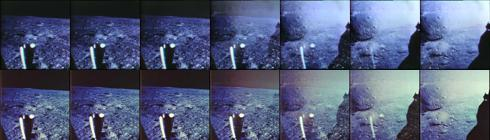

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
The Moon and Us x265.mp4,00:07:28,00:07:34,6,2154,164.090851,2
The Eagle Has Landed x265.mp4,00:13:16,00:13:22,6,796,164.090851,2


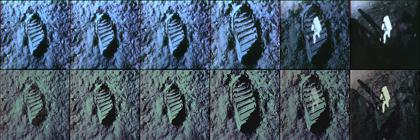

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
The Moon and Us x265.mp4,00:04:42,00:04:47,5,1988,198.131500,0
The Eagle Has Landed x265.mp4,00:23:10,00:23:15,5,1390,198.131500,0


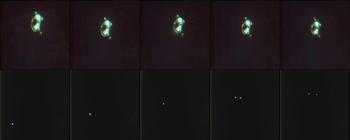

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
The Moon and Us x265.mp4,00:08:33,00:08:38,5,2219,246.937164,4
The Eagle Has Landed x265.mp4,00:27:23,00:27:28,5,1643,246.937164,4


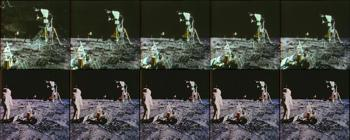

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
The Moon and Us x265.mp4,00:11:44,00:11:49,5,2410,235.579987,1
The Eagle Has Landed x265.mp4,00:19:21,00:19:26,5,1161,235.579987,1


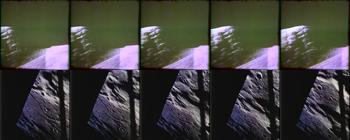

In [12]:
demo_finder.show_notebook_sequence(demo_sequences,show_limit=100, frame_resize=(70,70), convert_format='JPEG')

In the matching results discussed below, we instructed the VRD to find similar-looking sequences between the NASA-videos that were at least 5 seconds long and had been given a distance metric value below 125. A maximum of 2 frames per sequence were allowed to deviate from this threshold. In the first iteration of matching results, the VRD found 12 sequences that matched these criteria. 

The longest found sequence was 26 frames (or seconds) long and showed a clip where Neil Armstrong slowly climbs down a ladder and takes his first steps on the surface of the moon (figure 2). Vaguely discernable due to low resolution and a dark shadow cast by the Eagle shuttle, we see Armstrong wearing a white space suit in the lower left corner. 

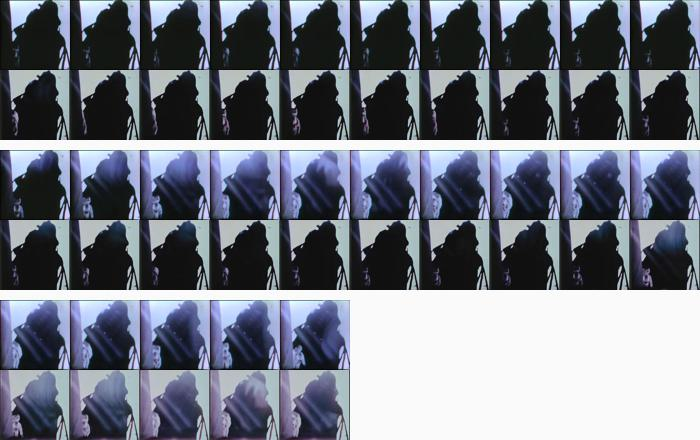

In [15]:
image_metadata("./media/armstrong.jpeg", metadata="Neil Armstrong climbs down from the Eagle shuttle. Upper row: *The Moon and Us*. Start time 00:06:56. End time 00:07:21. Bottom row: *The Eagle Has Landed*. Start time 00:12:36. End time 00:13:01.")

The second longest sequence depicts the Eagle shuttle’s descent toward the Moon, and includes panoramic scenes of the Moon surface (figure 3). The top left corner of the image is black since the camera’s view is partly blocked by the aircraft. Upon closer inspection, however, we find that the shown frames are not 100% identical. This illustrates the VRD’s (or rather, the Faiss library’s) particular ways of dealing with videos that contain slowly changing scenes. While the toolkit has, indeed, found frames with a high visual similarity, it is clear that we are seeing a matching result that appears to be a few seconds “off”. This is simply because the frames are similar enough to receive a comparatively low distance metric value. Theoretically, it would be possible to deal with this problem by increasing the distance metric threshold. However, doing so would likely imply that other interesting matches could get lost. In cases such as this, we therefore recommend accepting the somewhat imperfect matching result.

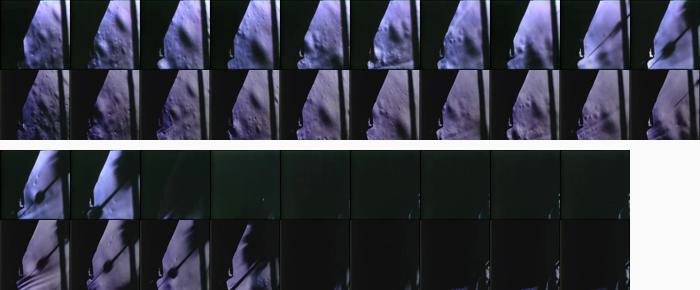

In [16]:
image_metadata("./media/descent.jpeg", metadata="The Eagle's descent toward the Moon. Upper row: *The Moon and Us*. Start time 00:06:23. End time 00:06:42. Bottom row: *The Eagle Has Landed*. Start time 00:11:18. End time 00:11:37.")

In the same sequence, we also notice that the VRD has matched several near-black frames (see the seven frames furthest to the right). This issue also occurs in other sequences, where near-black frames have been given a low distance metric value. While these matches are technically correct – indeed, the near-single-color frames do have a very high visual similarity – the matching results are practically irrelevant for studying video reuse. If matching single-color or near-single-color frames is a big problem in our dataset, we can deal with this problem by running an additional filter called `ignore_these_frames` (more about this soon).

When looking at the remaining matching results, we see that footage of the Eagle shuttle’s descent toward the Moon can also be found in three other sequences. This is due to the fact that the documentary The Moon and Us only reuses parts of the original footage. More precisely, we find that footage from the Eagle’s descent was shown for 20 seconds in the TV series episode The Moon and Us–starting 6 minutes and 23 secconds into the film. In the original video The Eagle Has Landed, however, footage from the Eagle’s descent is shown for roughly 2 minutes and 34 seconds (starting at 09 minutes and 3 seconds). Furthermore, very similar footage is shown for 1 minute and 8 seconds, starting 18 minutes and 20 seconds into The Eagle Has Landed. This time, however, it is not the Eagle’s descent, but ascent that is shown, as the shuttle begins its journey back to Earth (figure 4).

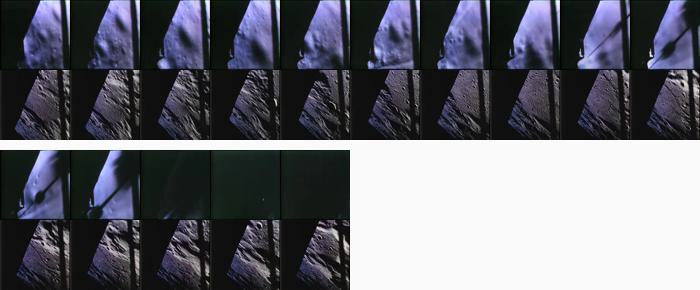

In [6]:
image_metadata("./media/ascent_1.jpeg", metadata="The Eagle's ascent towards the Earth. Upper row: *The Moon and Us*. Start time 00:06:23. End time 00:06:38. Bottom row: *The Eagle Has Landed*. Start time 00:19:11. End time 00:19:26.")

What has happened in our matching results, is that the same sequence of frames from The Moon and Us has been matched with different scenes depicting the Eagle’s descent and ascent from the moon in the The Eagle Has Landed. This issue is difficult to correct with any filter configurations since the footage does share many visual similarities. However, it can be helpful to know that when similar frames are found in different sequences, this can be an indication that similar footage appears several times within the same original video. Alternatively, it can indicate that footage has been cut/shortened in the process of reuse.

In the final sequence that includes footage of the Eagle’s descent (figure 5), the matching results are simply inaccurate. It is difficult to determine precisely why these matched frames have been given a comparatively low distance metric value when using CNNs, even without the complications added by using Faiss, and even attempting to do so is largely outside the scope of this article. One can speculate, however, that it has to do with the existence of vertical lines in the images.

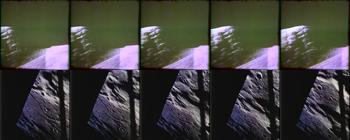

In [17]:
image_metadata("./media/ascent_2.jpeg", metadata="Mismatched sequences of the Eagle's ascent towards the Earth. Upper row: *The Moon and Us*. Start time 00:11:44. End time 00:11:49. Bottom row: *The Eagle Has Landed*. Start time 00:19:21. End time 00:19:26.")

The third longest sequence found in the matching results shows a series of still images that were taken during the collection of rock samples and the placement of scientific equipment on the moon (figure 6). Still photographs taken from the same scientific excursion can be found in three of the other sequences (figures 7, 8 and 9). In the longest of these sequences, the matching results are accurate, although in the other sequences we once again see an example of how very similar footage has been mismatched.

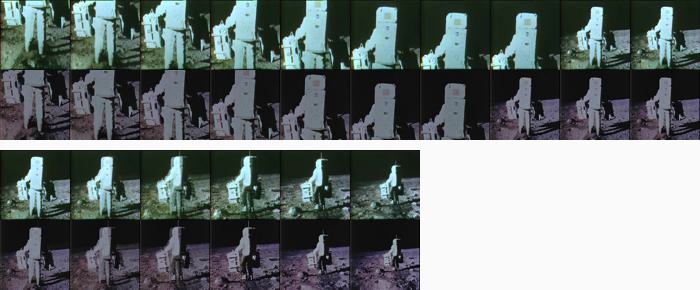

In [8]:
image_metadata("./media/experiment_1.jpeg", metadata="Scientific excursion on the Moon. Upper row: *The Moon and Us*. Start time 00:07:37. End time 00:07:53. Bottom row: *The Eagle Has Landed*. Start time 00:16:45. End time 00:17:01.")

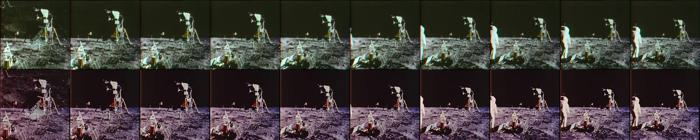

In [18]:
image_metadata("./media/experiment_2.jpeg", metadata="Scientific excursion on the Moon. Upper row: *The Moon and Us*. Start time 00:08:33. End time 00:08:43. Bottom row: *The Eagle Has Landed*. Start time 00:17:40. End time 00:17:50.")

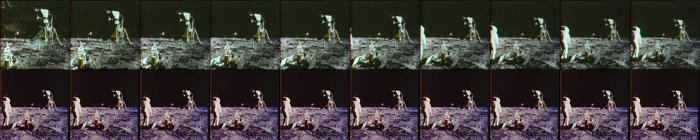

In [10]:
image_metadata("./media/experiment_3.jpeg", metadata="Mismatched scientific excursion on the Moon. Upper row: *The Moon and Us*. Start time 00:08:33. End time 00:08:43. Bottom row: *The Eagle Has Landed*. Start time 00:17:58. End time 00:18:08.")

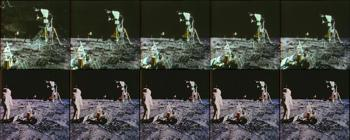

In [11]:
image_metadata("./media/experiment_4.jpeg", metadata="Mismatched scientific excursion on the Moon. Upper row: *The Moon and Us*. Start time 00:08:33. End time 00:08:38. Bottom row: *The Eagle Has Landed*. Start time 00:27:23. End time 00:27:28.")

Of the remaining sequences, the first is 8 seconds long and depicts Neil Armstrong’s and Buzz Aldrin’s view from the Eagle Shuttle (figure 10). The final sequence is 4 seconds long, and depicts footprints on the Moon surface (figure 11).

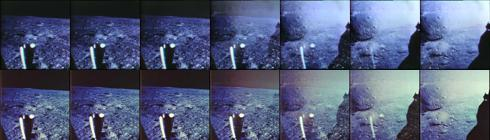

In [12]:
image_metadata("./media/view.jpeg", metadata="View from the Eagle shuttle. Upper row: *The Moon and Us*. Start time 00:06:48. End time 00:06:55. Bottom row: *The Eagle Has Landed*. Start time 00:11:44. End time 00:11:51.")

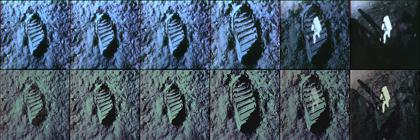

In [13]:
image_metadata("./media/footstep.jpeg", metadata="Footsteps on the Moon. Upper row: *The Moon and Us*. Start time 00:07:28. End time 00:07:34. Bottom row: *The Eagle Has Landed*. Start time 00:13:16. End time 00:13:22.")

### Step 7. Run additional filters

After having studied the first set of found sequences, we can choose to apply some additional filters and rearrange the sorting of the final output. For instance, it is possible to remove unwanted sequences from the matching results, thereby 'cleaning' the dataset from uninteresting frames. This can for example be useful if long sequences of black (or near-black) frames are found in the search results. Likewise, it can be helpful if frames with text have been excessively matched, as this is a common problem. 

It is also possible to change the sorting of the matching results, only show matching results for one or several selected videos, and re-adjust the distance metric threshold, shortest sequence threshold, and allowed skipped frames within each sequence. 

To remove unwanted sequences, we fill out an Excel template called "demo_unwanted_frames.xlsx" which is placed in the demo project folder, containing the columns "Video", "Start time", and "Duration". We copy-paste the information to be entered in the columns directly into the Excel spreadsheet from the text shown above each sequence preview above. The "Video" column should contain information about the video name (including any extension such as .avi or .mpg). The "Start time" column should include information about the start time on a HH:MM:SS format (such as 01:55:22 for 1 hour, 55 minutes and 22 seconds into the video file), and the "Duration" column should state the duration of the sequence to ignore in seconds (e.g. 120 for 2 minutes). There is no problem with additional columns, as these will simply be ignored. When the Excel spreadsheet is finished and saved, we run the `remove_unwanted_sequences` filter.

In [23]:
before_filtering = set(demo_sequences)
SequenceFinder.remove_unwanted_sequences(demo_sequences, demo_project, 'demo_unwanted_frames.xlsx')
after_filter = set(demo_sequences)

When the filter has been applied, we can double-check what sequences were removed below. The filtered sequences will not appear again in later matching results.

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
The Moon and Us x265.mp4,00:06:23,00:06:38,15,2089,195.551941,14
The Eagle Has Landed x265.mp4,00:23:10,00:23:25,15,1390,195.551941,14


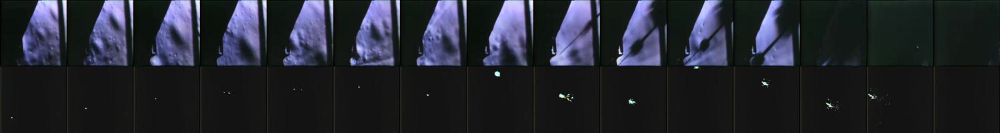

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
The Moon and Us x265.mp4,00:04:42,00:04:47,5,1988,198.131500,0
The Eagle Has Landed x265.mp4,00:23:10,00:23:15,5,1390,198.131500,0


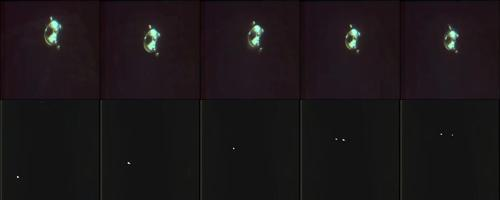

In [24]:
demo_finder.show_notebook_sequence(before_filtering.difference(after_filter), show_limit=100, frame_resize=(100,100), convert_format='JPEG')

As can be seen in the code cell above, two matched sequences were removed from the dataset.

Aside from removing unwanted sequences, it is possible to change the sorting of the matching results. Initially, matching results are sorted according to the length of sequences, but it is possible to adjust this to instead sort according to the lowest/shortest median distance metric value per sequence. We can also re-adjust the distance metric threshold, shortest sequence threshold, and allowed skipped frames within each sequence, or filter the search results so that only matches from one or several selected videos are shown. Prompts for applying additional filters can be found below.

In [25]:
# Additional filters

def sort_by_lowest_distance(sequences, finder):
    new_seq_order = np.argsort([finder.get_sequence_mean_distance(*x)[0] for x in sequences])
    new_sequence = [sequences[x] for x in new_seq_order]
    return new_sequence

def sort_by_longest_duration(sequences):
    return sorted(sequences, key = lambda x: x[2], reverse=True)

def filter_minimum_duration(sequences, minimum_duration):
    return [(v1,v2,dur) for v1,v2,dur in sequences if dur >= minimum_duration]

def filter_maximum_duration(sequences, maximum_duration):
    return [(v1,v2,dur) for v1,v2,dur in sequences if dur <= maximum_duration]

def sort_by_shortest_duration(sequences):
    longest_duration = sort_by_longest_duration(sequences)
    longest_duration.reverse()
    return longest_duration

def contains_video(sequences: list , video: str, finder: SequenceFinder):
    frames = finder.neigh.frames
    indexes = frames.get_index_from_video_name(video)
    return [(v1,v2,dur) for v1,v2,dur in sequences if (v1 in indexes) or (v2 in indexes)]

To try them out we recommend you download the VRD and demo dataset on your local computer. For instance, if you want to show sequences that are a maximum of 5 seconds, sorted by shortest duration first, you run the code below. You can also decide to run more filters at the same time. 

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
The Moon and Us x265.mp4,00:11:44,00:11:49,5,2410,235.579987,1
The Eagle Has Landed x265.mp4,00:19:21,00:19:26,5,1161,235.579987,1


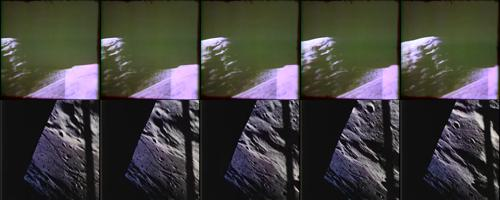

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
The Moon and Us x265.mp4,00:08:33,00:08:38,5,2219,246.937164,4
The Eagle Has Landed x265.mp4,00:27:23,00:27:28,5,1643,246.937164,4


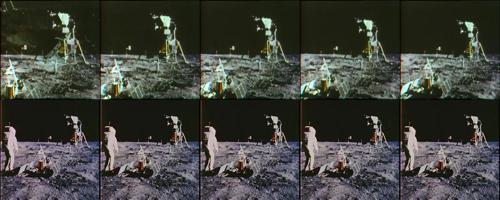

In [26]:
def demonstration_filter(sequences):
    sequences = filter_maximum_duration(sequences, 5)
    sequences = sort_by_shortest_duration(sequences)
    return sequences

demo_finder.show_notebook_sequence(demo_sequences,show_limit=100, frame_resize=(100,100), sort_order=demonstration_filter, convert_format='JPEG')

### Possibilities and pitfalls

As shown in the demonstration with the NASA videos above, the VRD can function as an efficient tool for identifying instances of video reuse and the toolkit did help us find a series of reused sequences that are open for further explorations. For instance, how has footage from the moon landing in 1969 been reused in other documentary films and news broadcasts throughout history? When, where, and how has this footage played a role in extraterrestrial imaginaries, or potentially helped shape narratives concerning fundamentally different topics? What footage from the Apollo 11 mission has become most iconic (i.e. most excessively reused) throughout history? And which scenes from the space mission have been excluded from later documentary/news productions, thereby becoming partially erased from cultural memory? Naturally, the investigation of the Apollo 11 mission would have been more interesting, had the toolkit been applied to a larger dataset, or perhaps an entire archive. Thus, we suggest there is great potential for archives and cultural heritage institutions to consider fingerprinting their collections, thereby opening them up for new ways of search.  

On a more practical level, the VRD toolkit works very well for finding visual similarities in video collections that have a high resolution and similar color/contrast scheme. The lesser original materials have been modified, edited, and/or remixed, the easier it also is for the toolkit to find relevant similarity matches. There are, however, a couple of instances where the toolkit performs less well. One such instance is when the VRD is applied to source materials that contain lots of textual and symbolic overlays, such as subtitles, news show banners, and/or tv-channel symbols. Another problem is videos that contain a lot of single-color (or near-single-color) frames. This is because text, symbols, and (near-)single-color frames tend to receive very low distance metric values. While this is often technically correct – since the pictures often do look very similar - it may cause problems in the search for cultural reuse. 

For instance, finding out that several black frames share visual similarities is of little use-value in research situations. Likewise, it is comparatively uninteresting to find out that frames with text look alike, especially when the text in such images does not contain the same words or even language, which is often the case. Similar problems also arise with symbols that are mistaken for other symbols, even though they share few visual similarities. If a recurring problem in the matching results is images with texts, symbols, or (near-)single-color frames, we suggest using the function `remove_unwanted_frames` to clean the dataset (see hermeneutics layer). This can be applied by manually selecting precisely what sequences to remove/ignore in the matching results, or by applying a general rule for ignoring frames in all videos. For instance, if a recurring problem in the matching results is frames showing video introductions and after texts (sections that often contain text, symbols, and black frames), it might be worth considering removing a fixed number of frames from the beginning and end of each analyzed video. However, this will always come at the expense of losing possibly interesting matching results.

The VRD's embeddedness in Jupyter Notebooks also brings with it some possibilities and pitfalls. While Jupyter Notebook provides excellent opportunities to document workflows and comment on code, the software's memory storage carries some drawbacks. More precisely, Jupyter Notebook stores information about executed code during each session, so that it is possible to work in a non-linear way, jumping back and forth between code cells without necessarily re-running the entire notebook (<cite data-cite="1971321/B4MKWQ9W"></cite> p. 58). This can be very useful, but it also means that if code is executed and later deleted from a notebook during a session, the deleted code will still be saved in memory and continue to influence the analysis. For instance, this means that other researchers may have difficulties reproducing the results. To ensure that deleted code cannot influence the analysis, it is prudent to re-run the entire notebook regularly.  

Aside from these practical issues, a couple of broader pitfalls and ethical issues regarding the use of CNNs must also be considered. We will return to a discussion concerning these issues in the [concluding remarks](#concluding-remarks). For now, however, let us have a look at an example of how the VRD can be used to study audiovisual reuse based on a larger dataset.

## Finding reuse in the SF archive

As mentioned in the introduction to this article, the SF-archive – in Swedish, *Svensk filmindustris journalfilmsarkiv* – is one of the most important audiovisual archives in Swedish film history. Consisting of film fragments, newsreels, and short films dating from 1897 to the early 1960s, the archive was digitized in the early 2000s and was prior used as a source in numerous TV programs and compilation films. In what follows, we re-trace the history of the SF-archive and reflect on how this archive has been reappropriated and remixed throughout more recent media history. More specifically, we explore *how* and *when* 1,400 of the oldest film clips that can be found in the archive appear in a series of historic TV documentaries that are available on RosaMannen's YouTube channel. After being uploaded on YouTube, we are thus studying SF footage that has gone through double remediation, since the footage was first included and broadcasted in historic television documentaries, and then digitized and made openly available online. 

The selected videos from the SF-archive vary in lenght but are usually between five to fifteen minutes long. Hence, our SF-dataset contains approximately 10,000 hours of moving image material. Regarding the TV series, we chose to work with 34 episodes taken from four different series, all focusing on Swedish 20th-century history. Put together, our TV-dataset consists of roughly 30 hours of film. When preparing the TV dataset, we edited out all introductory and closing texts from the films. This was done to minimize the risk of finding excessive matches with texts and symbols in the matching results ([see discussion in section Potentials and Pitfalls](#anchor-potentialls-and-pitfalls)). Most (but not all) of the TV-series episodes can be found on RosaMannen’s YouTube channel, and missing episodes were added through The Swedish Media Database ([SMDB](https://smdb.kb.se/smdb/english/)) which lets university staff order audiovisual content, giving access to streamed copies. All episodes in our selected TV series contain footage from the SF-archive – but also interviews, talking heads, stills, or other inserted materials. Hence, we knew that the VRD we would detect several visual similarities, but that there would also be sequences without any matches at all.

The first TV series, entitled [*The Time of Expectations*](https://www.youtube.com/watch?v=LMh5Jd9OS0I) (*Förväntningarnas tid*) — with an unknown producer — was broadcasted on Swedish Television during autumn 1985. The series consists of four episodes that depict the economic and political developments in Sweden following World War II and explores the landscape of opportunities that opened up when the country emerged as one of few European countries with an undamaged industry — and population — due to the country’s political neutrality. The series is foremost based on footage from the SF-archive but also contains a number of interviews, featuring well-known Swedish intellectuals and public figures such as novelist Per Olov Enquist and the political scientist Gunnar Myrdal. 

The second TV series, *Gold Nuggets* (*Guldkorn*) — sometimes with the addition "from SF" or from a particular year as [1945](https://www.youtube.com/watch?v=xKV1B3POqn4) — was a long-running series broadcasted on public service television in Sweden from the mid-1980s up until the early 2000s. All episodes were produced by Jan Bergman who worked at the film archive at Swedish Television for many years. Bergman’s *Gold Nuggets* combined a deep knowledge of the SF-archive, often detecting and inserting unusual footage, with a more traditional style of filmmaking. Characteristic of his TV-series is a combination of his own personal narration with that of the typical fast-paced voice-over taken from the original newsreels in the SF-archive. In the dataset, six hour-long episodes of *Gold Nuggets* from 1985 and six from 2002 are included.

Bergman — together with Britta Emmer and Ebbe Schön — was also the producer of the third selected TV series, entitled [*Sweden, A Long Time Ago*](https://www.youtube.com/watch?v=MettI_h2Oiw) (*Sverige, för länge sedan*) broadcasted in 1984 in ten short episodes. The series — depicting different aspects of Sweden and its 20th-century history — is an illustrative example of how instrumental the SF-archive was during the 1980s. The series (in the form of individual films) were produced for the Swedish Educational Broadcasting Company (a subsidiary to the public broadcaster) and were clearly aimed as a kind of filler for school TV. “Compiled of material from the SF-archive”, was explicitly stated in all of the film’s closing credits. As in *Gold Nuggets* Bergman’s voice-of-god sutured the footage. 

If the series *Sweden, A Long Time Ago* was all likely produced fairly rapidly — a budget compilation of sorts with its ten short episodes — the opposite is true of the final TV series that was selected for our experiment, namely the eight hour-long episodes of [*A Hundred Swedish Years*](https://www.youtube.com/watch?v=s53UPoAuh50) (*Hundra Svenska år*), first broadcast in 1999. The latter series was directed by Olle Häger, a long-time TV-producer with a career in public service television spanning three decades. Häger — and his narrator Hans Villius — are arguably the best-known documentary filmmakers in Sweden, having worked for decades with [still photography productions](https://www.youtube.com/watch?v=09QtLKchRq0) and films made from the SF-archive. *A Hundred Swedish Years* is usually regarded as one the finest historical documentaries compiled from the SF-archive. The production was a lavish one with a major budget and also included numerous interviews with elderly Swedes (recorded in the mid 1990s). The eight episodes each have a distinct theme — politics, fashion, labor market, children, technology, vacation, monarchy and foreign policy — giving the series a changing and dynamic setting. To prepare his TV production, Häger worked for years with the SF-archive, and even reprinted some footage with a higher resolution. *A Hundred Swedish Years* was broadcasted on prime time during the autumn of 1999, and was later also commercially released on both VHS and DVD.

In our exploration of the reuse taking place between the SF-archive and these four TV series, we perform two different similarity searches. First, we compare all selected television series episodes against each other to see if they contained any internal examples of reuse. Does any particular footage appear to have been reused multiple times in the documentaries? For instance, can we find examples of Jan Bergman and Olle Häger reusing the same footage? Second – and arguably more interesting – we compare the 30 hours of series episodes against the SF-archive (ignoring any potential examples of reuse that might be discovered *within* the TV series and the SF-archive respectively). In short, we wish to retrace the steps of the documentary filmmakers and map their choice of selected historic footage. Since our dataset from the SF-archive contains some 10,000 hours we are naturally interested in exploring what type of footage that was reused the most. Was it primarily the oldest footage? Or were other selection and editing criteria (aesthetic, historical, topical etcetera) of principal interest?

### Reuse in the televisual dataset

Producers of TV programs usually work within a limited time frame and the same goes for documentary productions. Hence, one might assume that filmmakers do their research primarily by looking at previous (similar) productions to save time. However, if the topic is general – i.e. Swedish history – there is plenty of footage to choose from, and reusing sequences that have already appeared in previous documentaries might come across as awkward. Then again, it is of course hard (if not impossible) for television audiences to remember if a sequence is shown for the first time or not. After applying a series of filters and features to customize the matching results, we were not surprised to find several examples of reuse within the televisual dataset.

We start a new project called "tv_series", extract one frame per second from the TV dataset, and apply the neural network EfficientNetB4 in our analysis. 

In [27]:
video_source_base_folder = "/home/jovyan/work/videos/"
TV_dataset_project = vrd_project.VRDProject(
    name = 'tv_series', 
    project_base_path=f"/home/jovyan/work/notebooks/projects/",
    video_path = f'{video_source_base_folder}/tv_series', 
    network = neural_networks.NeuralNetworks.efficientnetb4,
    additional_video_extensions = ['.webm', '.mpg'])
TV_dataset_project.initialize_frame_extractor()
print_project_frame_extractor_info(TV_dataset_project)

  0%|          | 0/34 [00:00<?, ?it/s]

For project "tv_series":
Number of video files: 34
Number of frames extracted: 89169



We then apply the selected neural net to compress and vectorize the frames into fingerprints and use Faiss to index and then calculate the most similar neighbors for each fingerprint.

In [ ]:
TV_dataset_project.populate_fingerprint_database()
TV_dataset_project.initialize_faiss_index()
TV_dataset_project.initialize_neighbours()

To get a sense of where to apply a distance metric threshold, we have a look at the initial distance metric distribution in a histogram.

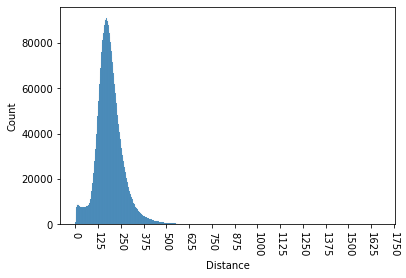

In [29]:
TV_dataset_project.neighbours.get_distance_histogram(halfway_x_ticks=True);

Based on this histogram, we decide to begin by applying a distance metric threshold of 120 and decide to filter out all matching frames that have origins in the same video. We also decide to proceed by only searching for sequential matches that are at least five seconds long with an allowed skip rate of two frames per sequence. We merge overlapping sequences into one. As can be seen in the statistics below the code cell, this reduces the number of found sequences from 14 571 to 1 302. 

In [30]:
TV_dataset_finder = SequenceFinder(
    TV_dataset_project.neighbours, 
    max_distance=120
)
TV_dataset_finder.filter_matches_from_same_video()
TV_dataset_sequences = TV_dataset_finder.find_sequences(
    shortest_sequence=5, 
    allow_skip=2,
    combine_overlap=True
)
len(TV_dataset_sequences)

89169
Maximum index found: 89168


  0%|          | 0/89169 [00:00<?, ?it/s]

Number of bytes required: 713352
Removing neighbours from same video...


  0%|          | 0/34 [00:00<?, ?it/s]

Removed 789488 entries (47.85%)!
Merged from 14571 to 1302 sequences


1302

We also decide that we are not interested in analyzing sequences that come from the same TV series. For instance, one TV series production team may have reused the same video segment several times in different episodes, but such examples of reuse are uninteresting to us since we want to explore potential instances of reuse among *different* TV series producers. To do this, we apply a customized filter called `not_from_same_tv_series`. This filter will be applied in all proceeding displays of matching results.

In [31]:
def not_from_same_tv_series(sequences, project):
    # NOTE: This example only works as we know that the first word is different in each included
    # TV series, and is not a general solution.
    frames = project.frame_extractor
    
    new_sequence = []
    for start1, start2, dur in sequences:
        vid1 = frames.get_video_name_from_index(start1)
        vid2 = frames.get_video_name_from_index(start2)
        if vid1.split()[0] != vid2.split()[0]:
            new_sequence.append((start1,start2,dur))        
    return new_sequence
TV_dataset_sequences = not_from_same_tv_series(TV_dataset_sequences, TV_dataset_project)

Next, we look at the remaining matching results in a stacked bar plot, where the reuse count on the Y-axis refers to the number of found sequences that are at least 5 seconds long. 

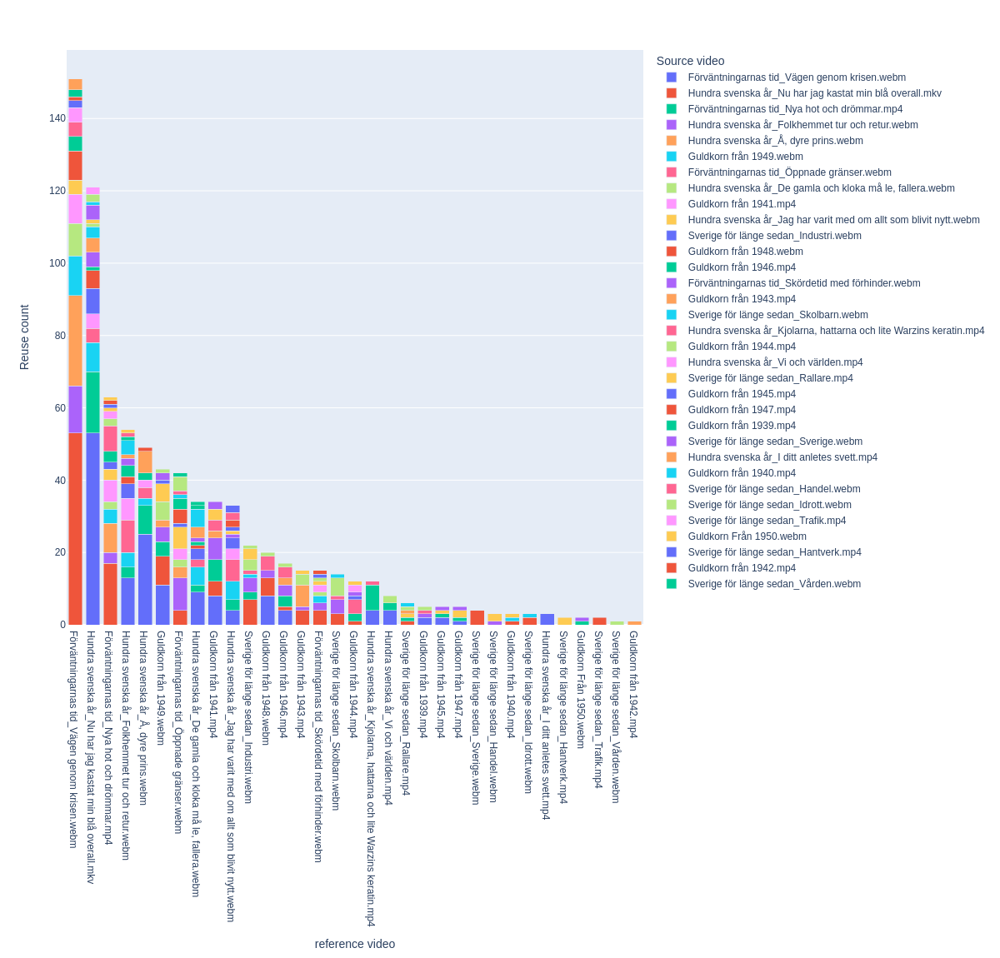

In [32]:
TV_dataset_project.show_most_reused_files(TV_dataset_sequences, size=(1200, 1150))

As can be seen in the bar plot, it appears as if footage from primarily two videos has been excessively reused within the TV dataset. This concerns the episode *Vägen genom krisen* (The path through the crisis) from the TV series *Förväntningarnas tid* (The time of expectations) and the episode *Nu har jag kastat min blå overall* (Now I have discarded by blue overall) from the TV series *Hundra Svenska år* (A hundred Swedish years). 

We proceed by looking at the matching results as thumbnail previews. The quality of these matches will give hints regarding how well the distance metric threshold was set in the `SequenceFinder` step above. If we find that many sequences that do not match, perhaps the distance metric threshold is set too high. Similarly, if all matches look good but a bit short, perhaps the distance metric threshold is set too low. In other words, we can use this data to adjust the previous filtering settings according to our specific dataset. As previously noted, the distribution of distance metric values will for example be impacted by the choice of neural net, the layer from which to extract the fingerprints, the size of the dataset, and the quality of the source material. We recommend finding a threshold that is slightly too high (rather than too low), to avoid missing relevant matches. Invalid matches can then be filtered out using other tools. In this notebook, we limit the number of shown sequences to 10 in the example below. During our analysis, however, the 200 longest sequences were analyzed. 

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1946.mp4,00:47:13,00:47:49,36,46103,196.216522,23
Förväntningarnas tid_Öppnade gränser.webm,00:52:37,00:53:13,36,13374,196.216522,23


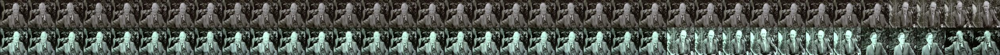

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:48:49,00:49:25,36,62901,149.945541,28
Förväntningarnas tid_Vägen genom krisen.webm,00:13:00,00:13:36,36,7464,149.945541,28


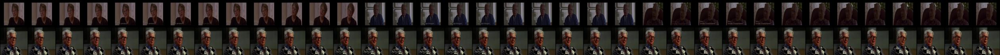

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:48:49,00:49:25,36,62901,109.044975,27
Förväntningarnas tid_Vägen genom krisen.webm,00:13:48,00:14:24,36,7512,109.044975,27


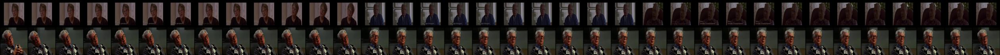

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:48:49,00:49:25,36,62901,133.668579,26
Förväntningarnas tid_Öppnade gränser.webm,00:46:01,00:46:37,36,12978,133.668579,26


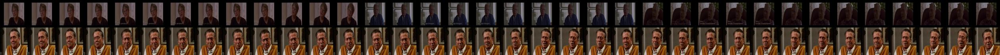

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1949.webm,00:36:37,00:37:12,35,55703,124.169785,17
Förväntningarnas tid_Vägen genom krisen.webm,00:14:56,00:15:31,35,7580,124.169785,17


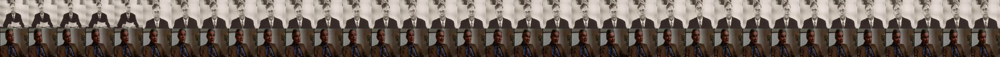

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Å, dyre prins.webm",00:36:47,00:37:22,35,77844,125.457573,28
Förväntningarnas tid_Nya hot och drömmar.mp4,00:10:25,00:11:00,35,625,125.457573,28


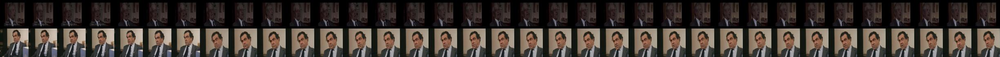

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Å, dyre prins.webm",00:36:47,00:37:22,35,77844,100.240112,9
Förväntningarnas tid_Nya hot och drömmar.mp4,00:14:05,00:14:40,35,845,100.240112,9


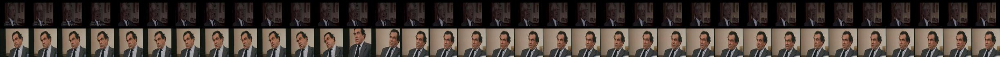

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:09:44,00:10:18,34,60556,157.660568,11
Förväntningarnas tid_Vägen genom krisen.webm,00:13:00,00:13:34,34,7464,157.660568,11


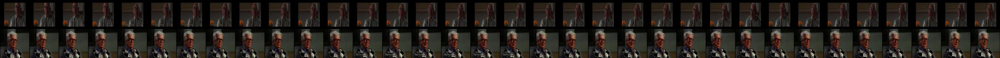

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:09:44,00:10:18,34,60556,130.338272,5
Förväntningarnas tid_Vägen genom krisen.webm,00:13:46,00:14:20,34,7510,130.338272,5


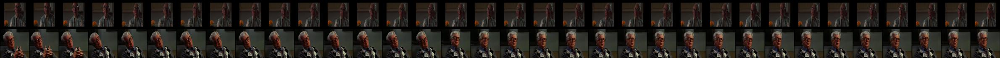

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1949.webm,00:36:37,00:37:10,33,55703,85.215118,12
Förväntningarnas tid_Nya hot och drömmar.mp4,00:14:17,00:14:50,33,857,85.215118,12


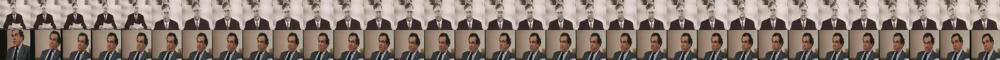

In [33]:
TV_dataset_finder.show_notebook_sequence(TV_dataset_sequences,  show_limit=10, frame_resize=(70,70), convert_format='JPEG')

When studying these thumbnails, we decide to keep working with a distance metric threshold of 120 but notice that a special type of frame seem to distort the matching results. These are frames showing talking heads – that is, shots of people's heads and shoulders as they are talking to the camera. As can be seen in several examples, such frames have been given a comparatively low distance metric, even though they depict entirely different people. We decide to filter out these sequences manually, even though this means that actual reuse of talking heads may get lost. This is done by adding the unwanted sequences to an Excel (.xlsx) template entitled "unwanted_frames" and running the `remove_unwanted_sequences` function. We also find some black (or near-black) sequences and sequences containing text in the matching results and add these to the list of unwanted frames as well. As can be seen in the statistics after the code cell below, this reduces the number of found sequences from 402 to 105. 

In [34]:
before_set = set(TV_dataset_sequences)
SequenceFinder.remove_unwanted_sequences(TV_dataset_sequences, TV_dataset_project, 'TV_unwanted_frames.xlsx')
after_set = set(TV_dataset_sequences)
print(f'Before removal: {len(before_set)} sequences.\nAfter removal: {len(after_set)} sequences.\n({(len(before_set)-len(after_set)) / len(before_set)*100:.2f}% removed)')

Before removal: 402 sequences.
After removal: 105 sequences.
(73.88% removed)


To double-check what sequences were removed in the previous step, we run the code below. This will provide a sample 50 sequences that were filtered out using the `unwanted_sequences` feature.

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1946.mp4,00:47:13,00:47:49,36,46103,196.216522,23
Förväntningarnas tid_Öppnade gränser.webm,00:52:37,00:53:13,36,13374,196.216522,23


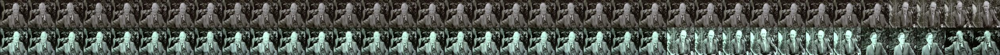

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:48:49,00:49:25,36,62901,149.945541,28
Förväntningarnas tid_Vägen genom krisen.webm,00:13:00,00:13:36,36,7464,149.945541,28


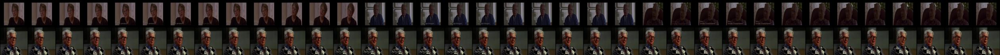

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:48:49,00:49:25,36,62901,133.668579,26
Förväntningarnas tid_Öppnade gränser.webm,00:46:01,00:46:37,36,12978,133.668579,26


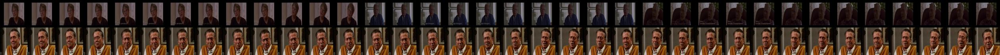

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:48:49,00:49:25,36,62901,109.044975,27
Förväntningarnas tid_Vägen genom krisen.webm,00:13:48,00:14:24,36,7512,109.044975,27


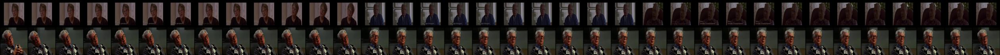

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Å, dyre prins.webm",00:36:47,00:37:22,35,77844,125.457573,28
Förväntningarnas tid_Nya hot och drömmar.mp4,00:10:25,00:11:00,35,625,125.457573,28


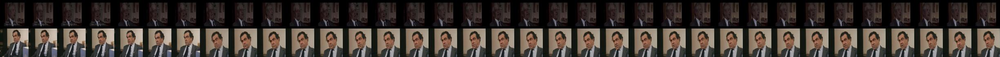

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1949.webm,00:36:37,00:37:12,35,55703,124.169785,17
Förväntningarnas tid_Vägen genom krisen.webm,00:14:56,00:15:31,35,7580,124.169785,17


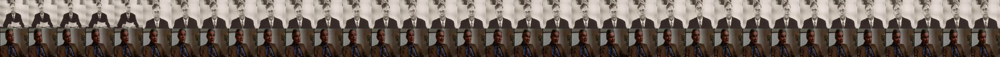

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Å, dyre prins.webm",00:36:47,00:37:22,35,77844,100.240112,9
Förväntningarnas tid_Nya hot och drömmar.mp4,00:14:05,00:14:40,35,845,100.240112,9


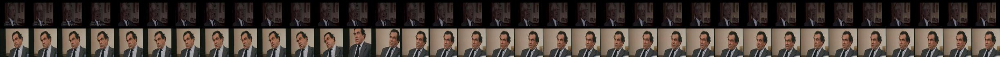

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:09:44,00:10:18,34,60556,130.338272,5
Förväntningarnas tid_Vägen genom krisen.webm,00:13:46,00:14:20,34,7510,130.338272,5


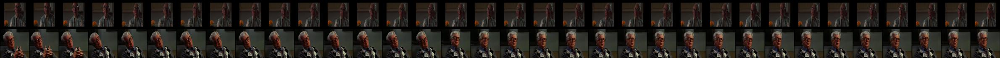

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:09:44,00:10:18,34,60556,157.660568,11
Förväntningarnas tid_Vägen genom krisen.webm,00:13:00,00:13:34,34,7464,157.660568,11


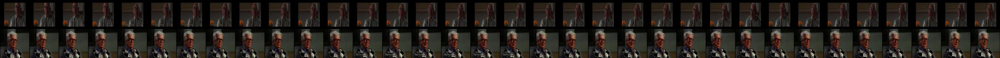

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1949.webm,00:36:37,00:37:10,33,55703,85.215118,12
Förväntningarnas tid_Nya hot och drömmar.mp4,00:14:17,00:14:50,33,857,85.215118,12


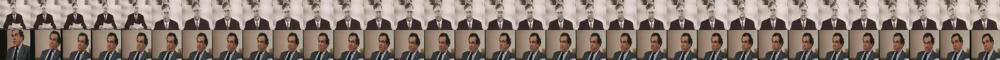

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Å, dyre prins.webm",00:36:47,00:37:16,29,77844,130.023712,6
Guldkorn från 1949.webm,00:36:43,00:37:12,29,55709,130.023712,6


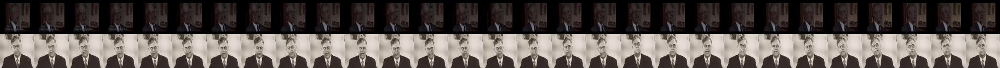

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1941.mp4,00:34:39,00:35:04,25,26055,150.327011,16
Förväntningarnas tid_Skördetid med förhinder.webm,00:13:03,00:13:28,25,4032,150.327011,16


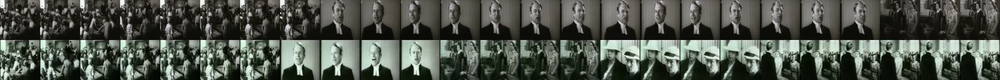

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:13:31,00:13:55,24,71422,120.059944,3
Förväntningarnas tid_Vägen genom krisen.webm,00:14:53,00:15:17,24,7577,120.059944,3


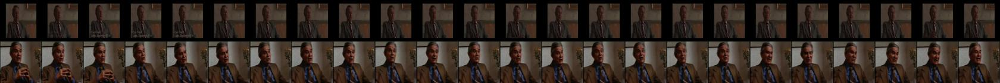

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:13:31,00:13:55,24,71422,138.392166,7
Guldkorn från 1949.webm,00:36:44,00:37:08,24,55710,138.392166,7


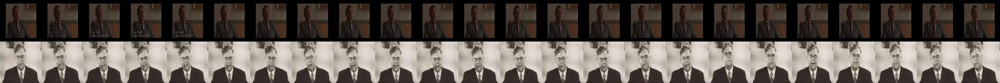

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:13:31,00:13:55,24,71422,86.606483,15
Förväntningarnas tid_Nya hot och drömmar.mp4,00:14:17,00:14:41,24,857,86.606483,15


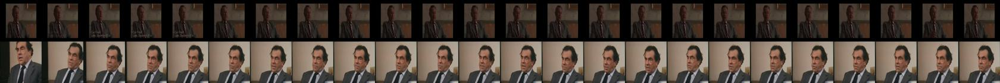

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:13:31,00:13:55,24,71422,95.935287,11
Förväntningarnas tid_Vägen genom krisen.webm,00:16:47,00:17:11,24,7691,95.935287,11


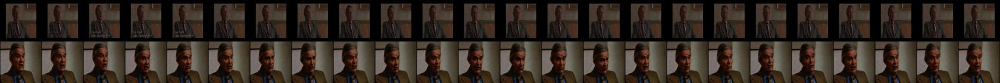

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Å, dyre prins.webm",00:34:31,00:34:54,23,77708,112.683418,12
Förväntningarnas tid_Nya hot och drömmar.mp4,00:12:54,00:13:17,23,774,112.683418,12


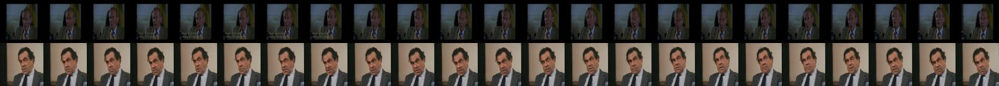

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Vi och världen.mp4,00:05:16,00:05:39,23,73924,178.765335,6
Förväntningarnas tid_Vägen genom krisen.webm,00:13:49,00:14:12,23,7513,178.765335,6


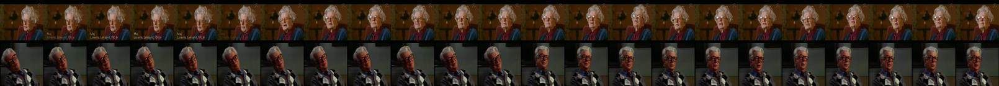

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Å, dyre prins.webm",00:34:31,00:34:54,23,77708,125.750618,12
Förväntningarnas tid_Nya hot och drömmar.mp4,00:10:24,00:10:47,23,624,125.750618,12


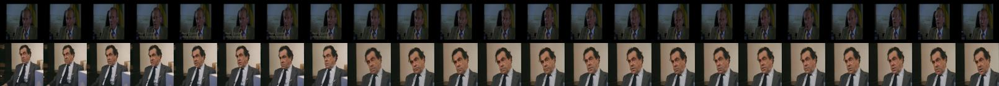

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Vi och världen.mp4,00:05:16,00:05:39,23,73924,171.003433,12
Förväntningarnas tid_Vägen genom krisen.webm,00:13:00,00:13:23,23,7464,171.003433,12


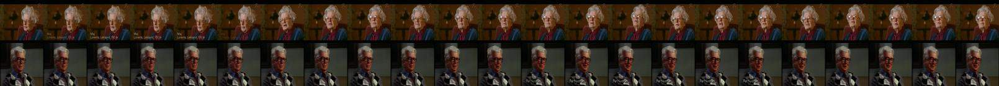

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Å, dyre prins.webm",00:34:31,00:34:54,23,77708,108.842972,14
Förväntningarnas tid_Nya hot och drömmar.mp4,00:13:57,00:14:20,23,837,108.842972,14


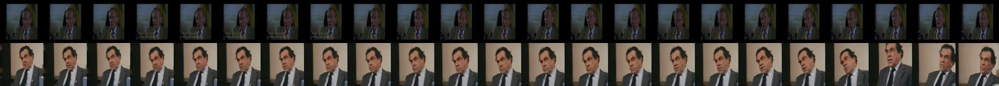

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Å, dyre prins.webm",00:38:46,00:39:07,21,77963,157.964981,6
Förväntningarnas tid_Vägen genom krisen.webm,00:13:13,00:13:34,21,7477,157.964981,6


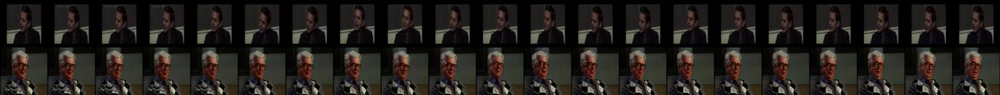

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Å, dyre prins.webm",00:38:46,00:39:07,21,77963,166.820312,3
Förväntningarnas tid_Vägen genom krisen.webm,00:13:46,00:14:07,21,7510,166.820312,3


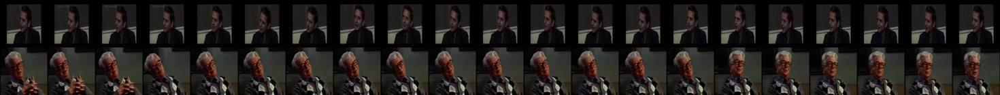

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1949.webm,00:36:37,00:36:58,21,55703,110.536385,6
Förväntningarnas tid_Vägen genom krisen.webm,00:33:42,00:34:03,21,8706,110.536385,6


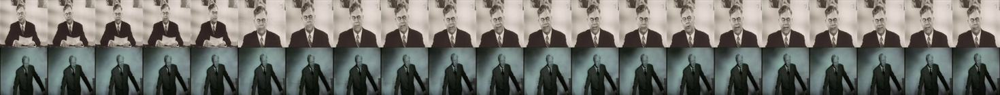

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1949.webm,00:36:37,00:36:57,20,55703,82.515350,11
Förväntningarnas tid_Vägen genom krisen.webm,00:17:02,00:17:22,20,7706,82.515350,11


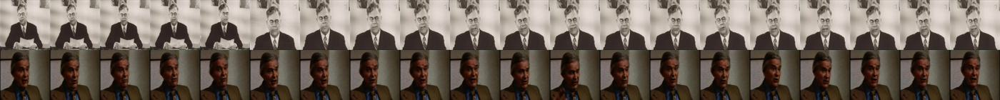

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1941.mp4,00:34:39,00:34:59,20,26055,183.016891,8
Förväntningarnas tid_Nya hot och drömmar.mp4,00:09:38,00:09:58,20,578,183.016891,8


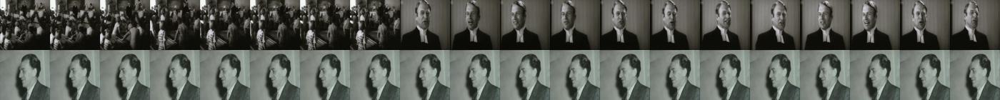

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:13:31,00:13:51,20,71422,146.902115,5
Förväntningarnas tid_Vägen genom krisen.webm,00:33:43,00:34:03,20,8707,146.902115,5


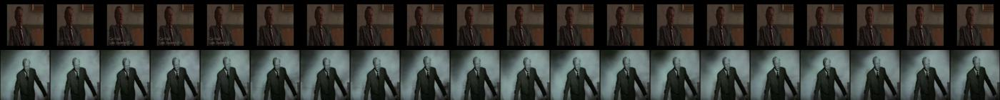

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Jag har varit med om allt som blivit nytt.webm,00:41:02,00:41:21,19,68845,161.262024,18
Förväntningarnas tid_Öppnade gränser.webm,00:29:49,00:30:08,19,12006,161.262024,18


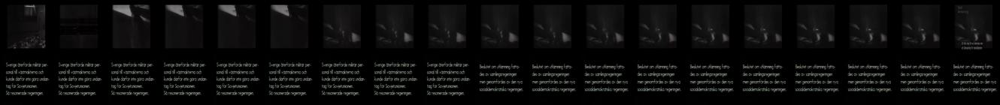

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:25:06,00:25:24,18,72117,128.884476,8
Guldkorn från 1949.webm,00:36:44,00:37:02,18,55710,128.884476,8


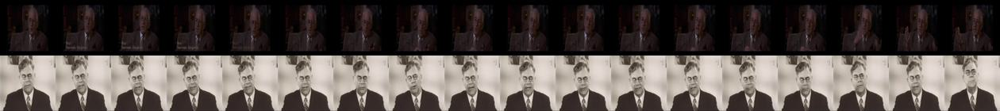

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:33:14,00:33:32,18,72605,102.175171,8
Förväntningarnas tid_Vägen genom krisen.webm,00:16:37,00:16:55,18,7681,102.175171,8


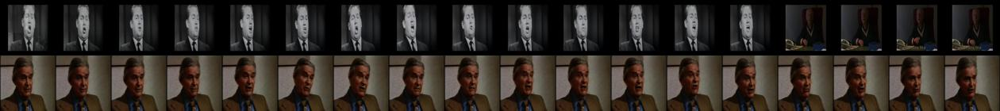

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:33:14,00:33:32,18,72605,112.607742,8
Guldkorn från 1949.webm,00:36:42,00:37:00,18,55708,112.607742,8


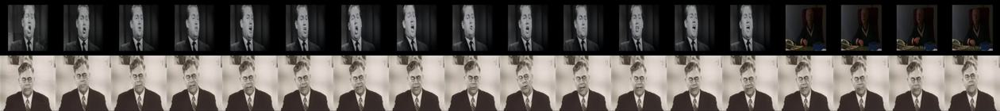

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:25:06,00:25:24,18,72117,99.314232,3
Förväntningarnas tid_Vägen genom krisen.webm,00:16:30,00:16:48,18,7674,99.314232,3


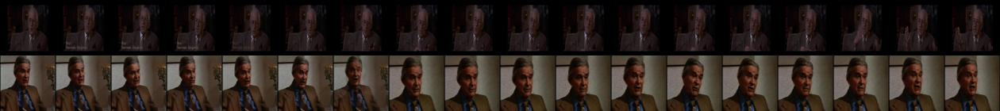

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:33:14,00:33:32,18,72605,110.816185,10
Förväntningarnas tid_Nya hot och drömmar.mp4,00:09:38,00:09:56,18,578,110.816185,10


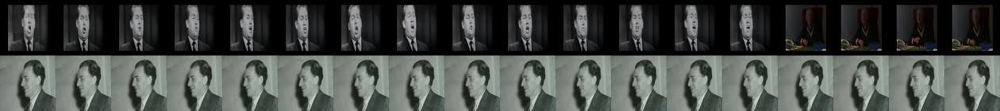

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:25:06,00:25:24,18,72117,99.748123,2
Förväntningarnas tid_Nya hot och drömmar.mp4,00:14:17,00:14:35,18,857,99.748123,2


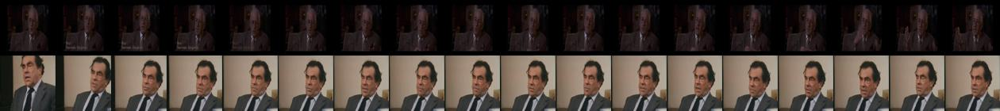

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_De gamla och kloka må le, fallera.webm",00:22:51,00:23:09,18,58332,104.177681,4
Förväntningarnas tid_Vägen genom krisen.webm,00:14:56,00:15:14,18,7580,104.177681,4


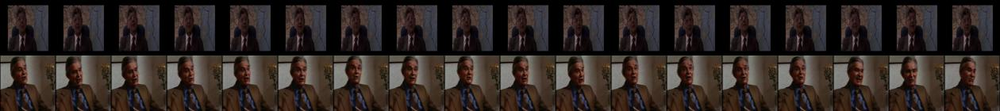

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:25:06,00:25:24,18,72117,92.699623,12
Förväntningarnas tid_Vägen genom krisen.webm,00:15:18,00:15:36,18,7602,92.699623,12


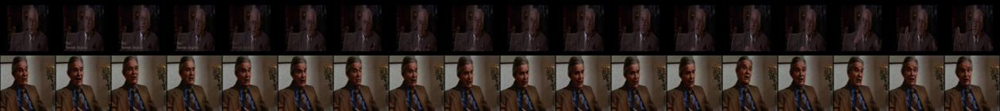

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:33:14,00:33:32,18,72605,103.834503,9
Förväntningarnas tid_Vägen genom krisen.webm,00:17:34,00:17:52,18,7738,103.834503,9


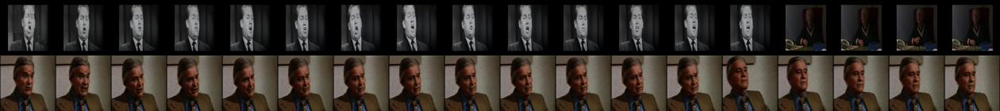

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_De gamla och kloka må le, fallera.webm",00:22:51,00:23:09,18,58332,135.312515,0
Guldkorn från 1949.webm,00:36:43,00:37:01,18,55709,135.312515,0


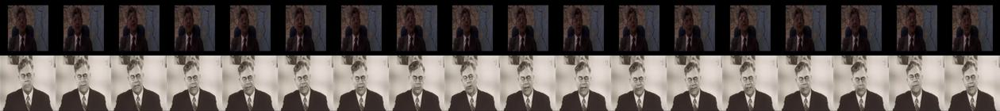

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Å, dyre prins.webm",00:36:47,00:37:05,18,77844,90.044228,15
Förväntningarnas tid_Vägen genom krisen.webm,00:17:04,00:17:22,18,7708,90.044228,15


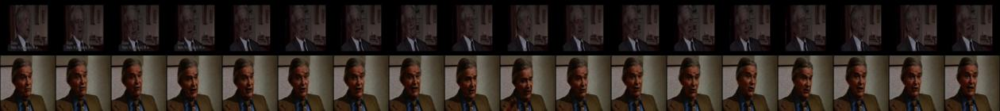

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:09:43,00:10:00,17,71194,155.285065,7
Förväntningarnas tid_Vägen genom krisen.webm,00:13:16,00:13:33,17,7480,155.285065,7


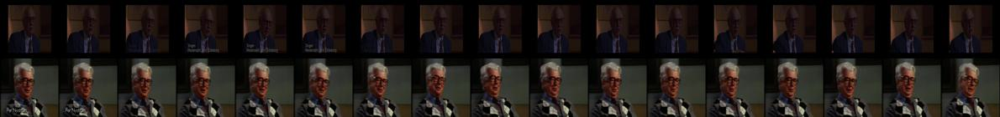

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1949.webm,00:36:03,00:36:19,16,55669,114.492867,9
Förväntningarnas tid_Vägen genom krisen.webm,00:15:32,00:15:48,16,7616,114.492867,9


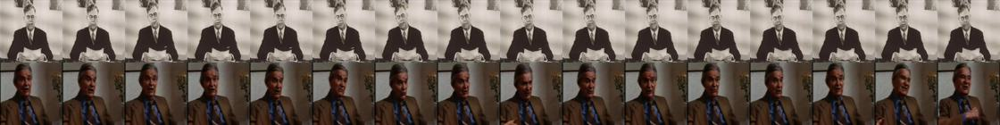

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_De gamla och kloka må le, fallera.webm",00:34:02,00:34:18,16,59003,126.745026,12
Guldkorn från 1943.mp4,00:55:33,00:55:49,16,34262,126.745026,12


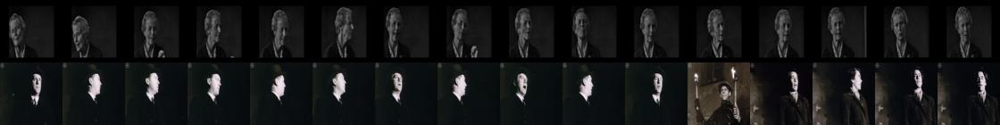

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:48:49,00:49:05,16,62901,160.721436,15
Förväntningarnas tid_Öppnade gränser.webm,00:45:40,00:45:56,16,12957,160.721436,15


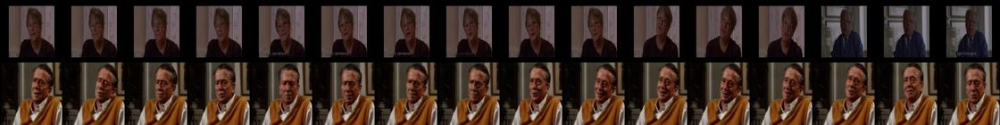

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Å, dyre prins.webm",00:33:50,00:34:06,16,77667,113.223297,7
Förväntningarnas tid_Vägen genom krisen.webm,00:13:56,00:14:12,16,7520,113.223297,7


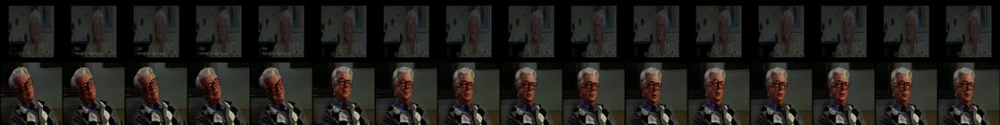

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Industri.webm,00:05:44,00:06:00,16,82040,151.763489,10
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:23:11,00:23:27,16,72002,151.763489,10


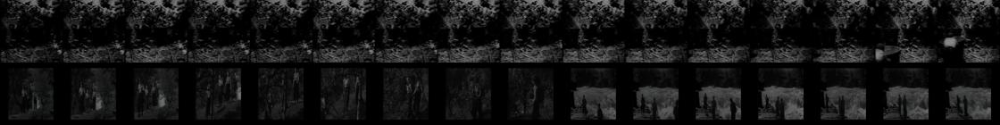

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Industri.webm,00:05:44,00:06:00,16,82040,149.800812,9
Hundra svenska år_Folkhemmet tur och retur.webm,00:24:05,00:24:21,16,61417,149.800812,9


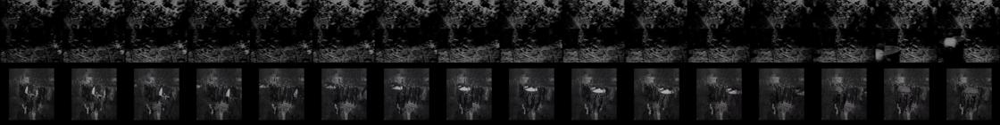

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1949.webm,00:36:03,00:36:19,16,55669,113.304184,11
Förväntningarnas tid_Vägen genom krisen.webm,00:15:12,00:15:28,16,7596,113.304184,11


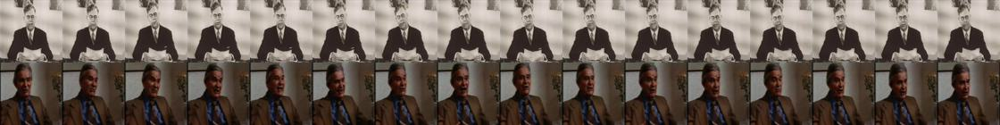

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_De gamla och kloka må le, fallera.webm",00:06:43,00:06:59,16,57364,125.482964,9
Förväntningarnas tid_Vägen genom krisen.webm,00:14:03,00:14:19,16,7527,125.482964,9


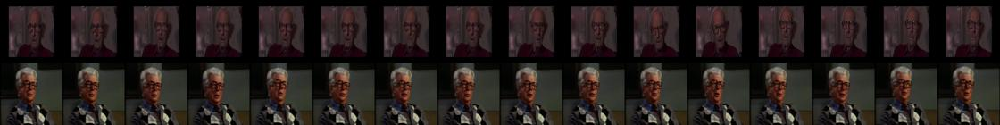

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Å, dyre prins.webm",00:33:50,00:34:06,16,77667,123.559593,6
Förväntningarnas tid_Öppnade gränser.webm,00:46:15,00:46:31,16,12992,123.559593,6


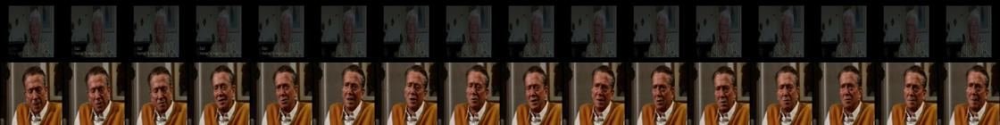

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Å, dyre prins.webm",00:33:50,00:34:06,16,77667,167.313278,4
Förväntningarnas tid_Vägen genom krisen.webm,00:13:13,00:13:29,16,7477,167.313278,4


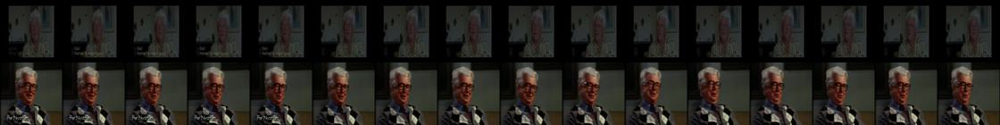

In [35]:
TV_dataset_finder.show_notebook_sequence(before_set.difference(after_set), show_limit=50, show_shift=False, frame_resize=(70,70), convert_format='JPEG')

As can be seen in the thumbnail preview above, the Excel spreadsheet did include many talking heads, as well as black or near-black frames. Interestingly, we also find a couple of correct matches. For instance, the first sequence does appear to be correct, even though it has a slight time shift. 

Next, we look at our updated matching results in the form of a stacked bar plot.

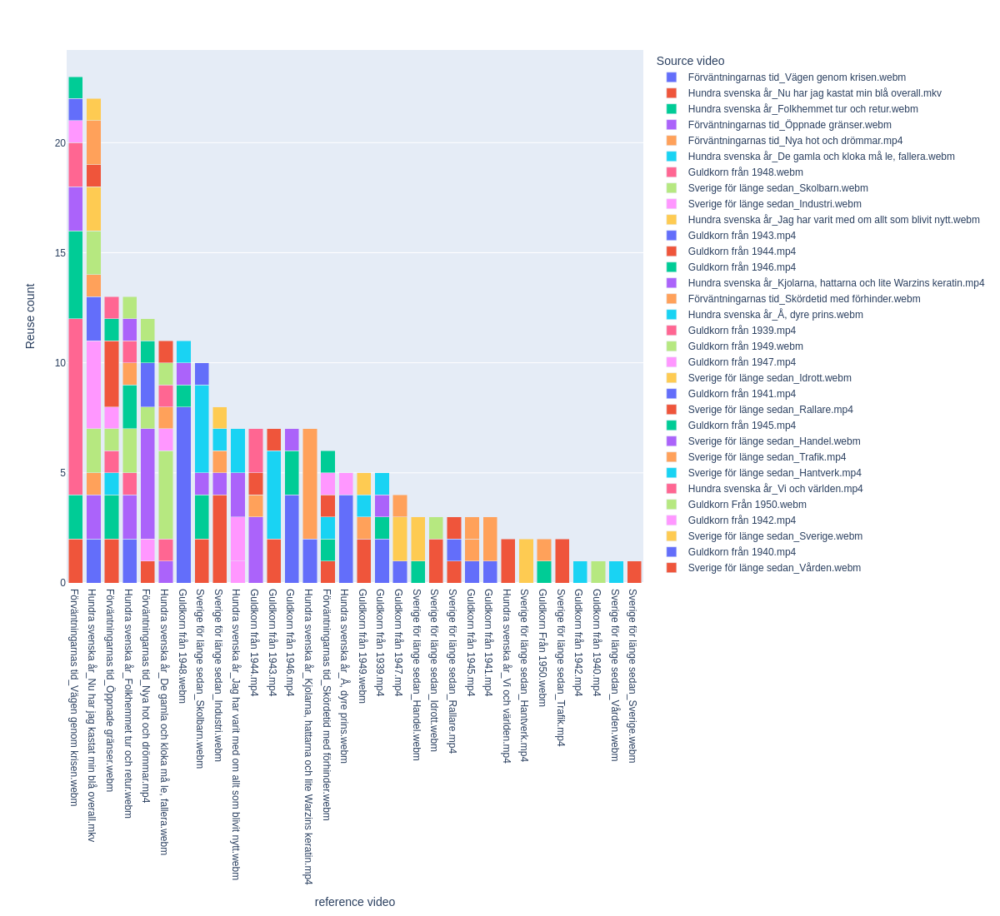

In [36]:
TV_dataset_project.show_most_reused_files(not_from_same_tv_series(TV_dataset_sequences, TV_dataset_project), size=(1200, 1100))

As can be seen in the bar plot, the number of found sequences is now highly reduced. Still, however, we find the same two TV series episodes being seemingly reused the most amount of times (i.e., the episodes *Vägen genom krisen* and *Nu har jag kastat min blå overall*). 

We have a look at the remaining matching results as thumbnail previews once more. The longest found sequence will be shown first, and we decide to only show the 200 longest sequences found.

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1946.mp4,00:54:47,00:55:14,27,46557,196.678253,10
Förväntningarnas tid_Vägen genom krisen.webm,00:25:19,00:25:46,27,8203,196.678253,10


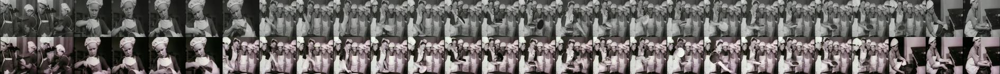

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Vi och världen.mp4,00:30:57,00:31:17,20,75465,166.710052,5
Guldkorn från 1944.mp4,00:57:03,00:57:23,20,37849,166.710052,5


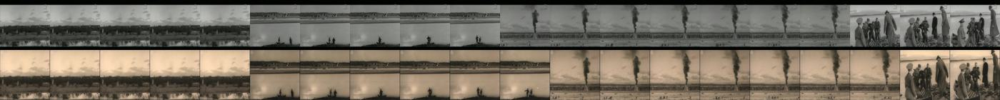

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1944.mp4,00:28:51,00:29:10,19,36157,199.057266,8
Förväntningarnas tid_Öppnade gränser.webm,00:20:18,00:20:37,19,11435,199.057266,8


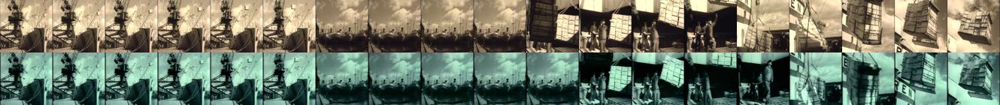

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1946.mp4,00:54:15,00:54:31,16,46525,211.580536,7
Förväntningarnas tid_Vägen genom krisen.webm,00:24:46,00:25:02,16,8170,211.580536,7


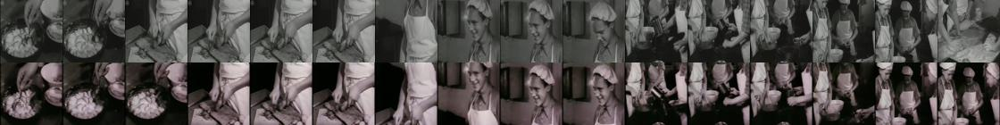

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1947.mp4,00:28:30,00:28:46,16,48420,190.984879,4
Förväntningarnas tid_Vägen genom krisen.webm,00:00:03,00:00:19,16,6687,190.984879,4


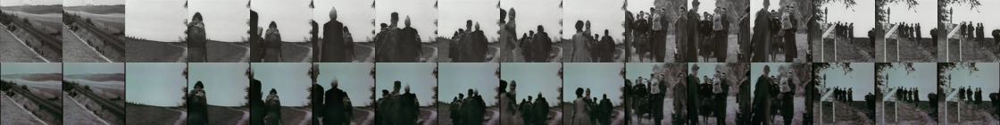

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1948.webm,00:46:30,00:46:46,16,52859,191.281067,4
Förväntningarnas tid_Vägen genom krisen.webm,00:37:54,00:38:10,16,8958,191.281067,4


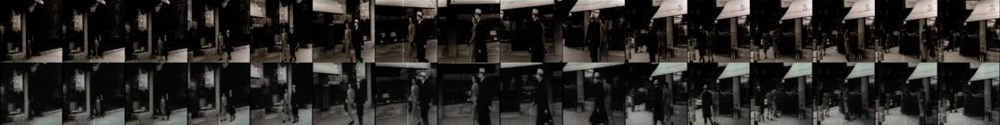

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1946.mp4,00:55:21,00:55:36,15,46591,180.833862,5
Förväntningarnas tid_Vägen genom krisen.webm,00:25:52,00:26:07,15,8236,180.833862,5


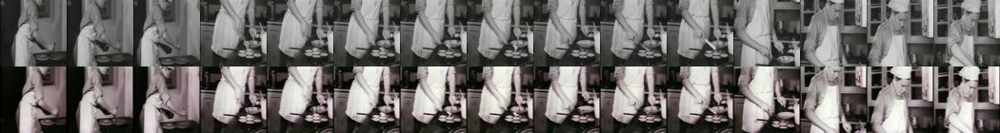

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1948.webm,00:45:41,00:45:56,15,52810,217.616089,10
Förväntningarnas tid_Vägen genom krisen.webm,00:39:50,00:40:05,15,9074,217.616089,10


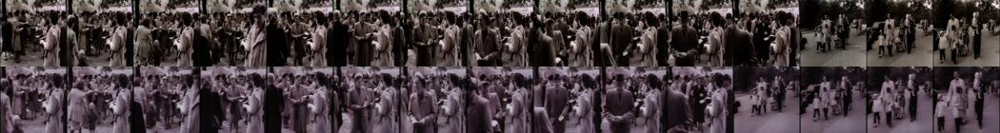

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1948.webm,00:47:05,00:47:19,14,52894,177.207947,2
Förväntningarnas tid_Vägen genom krisen.webm,00:51:51,00:52:05,14,9795,177.207947,2


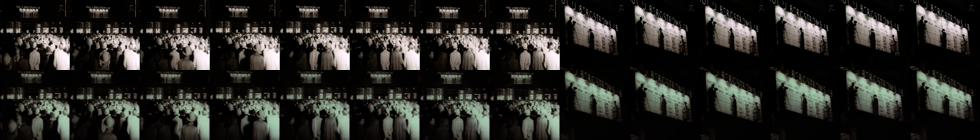

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1945.mp4,00:19:16,00:19:29,13,39102,176.571075,4
Förväntningarnas tid_Vägen genom krisen.webm,00:21:57,00:22:10,13,8001,176.571075,4


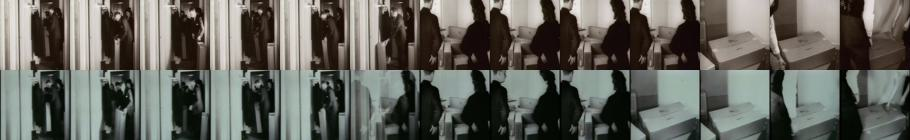

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1944.mp4,00:28:16,00:28:28,12,36122,175.445938,3
Förväntningarnas tid_Öppnade gränser.webm,00:20:02,00:20:14,12,11419,175.445938,3


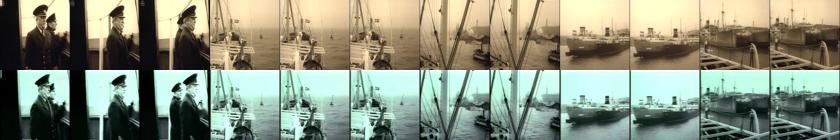

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1948.webm,00:45:20,00:45:32,12,52789,158.465561,2
Förväntningarnas tid_Vägen genom krisen.webm,00:37:04,00:37:16,12,8908,158.465561,2


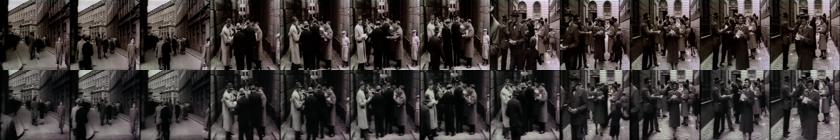

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Trafik.mp4,00:09:05,00:09:17,12,87571,155.887985,0
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:02:47,00:02:59,12,70778,155.887985,0


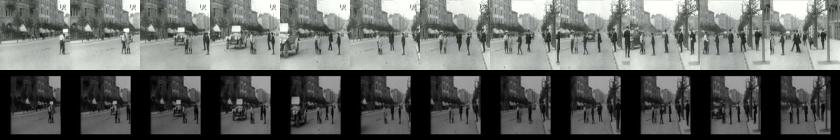

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Vården.webm,00:00:47,00:00:59,12,88151,212.113281,4
"Hundra svenska år_De gamla och kloka må le, fallera.webm",00:04:25,00:04:37,12,57226,212.113281,4


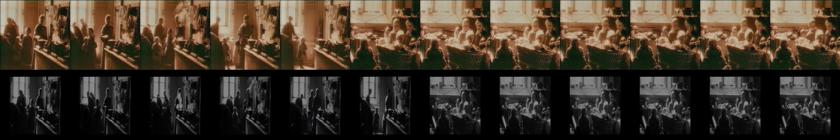

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_De gamla och kloka må le, fallera.webm",00:31:28,00:31:39,11,58849,191.758423,5
Guldkorn från 1948.webm,00:17:49,00:18:00,11,51138,191.758423,5


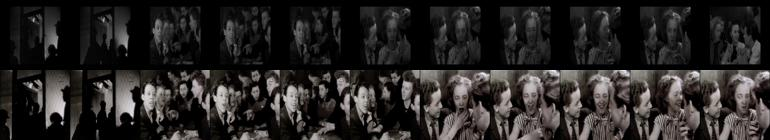

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Hantverk.mp4,00:02:56,00:03:07,11,79849,206.091156,3
Hundra svenska år_Jag har varit med om allt som blivit nytt.webm,00:13:27,00:13:38,11,67190,206.091156,3


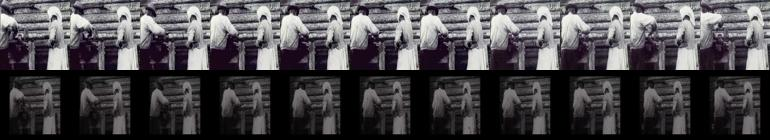

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:24:39,00:24:49,10,72090,170.030502,8
Guldkorn från 1949.webm,00:05:53,00:06:03,10,53859,170.030502,8


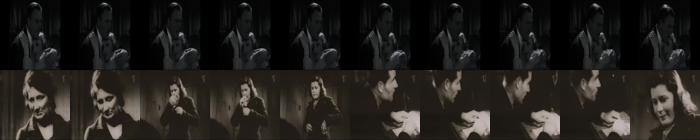

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Skolbarn.webm,00:13:08,00:13:18,10,85647,207.649689,5
Hundra svenska år_Folkhemmet tur och retur.webm,00:14:36,00:14:46,10,60848,207.649689,5


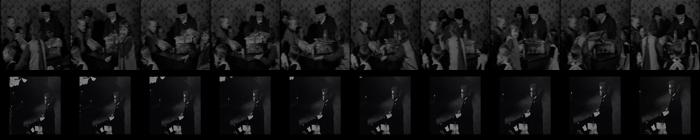

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Jag har varit med om allt som blivit nytt.webm,00:29:00,00:29:09,9,68123,164.106964,4
Guldkorn från 1947.mp4,00:36:46,00:36:55,9,48916,164.106964,4


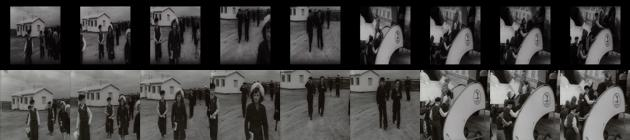

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:29:17,00:29:26,9,72368,129.285294,5
Förväntningarnas tid_Öppnade gränser.webm,00:02:55,00:03:04,9,10392,129.285294,5


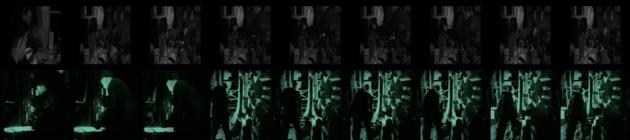

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Handel.webm,00:02:06,00:02:15,9,78704,209.031662,6
Hundra svenska år_Folkhemmet tur och retur.webm,00:03:38,00:03:47,9,60190,209.031662,6


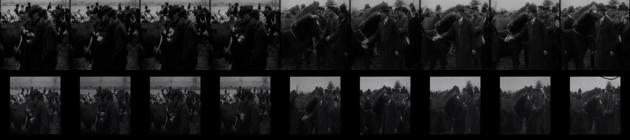

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1944.mp4,00:27:12,00:27:20,8,36058,205.983139,2
Förväntningarnas tid_Öppnade gränser.webm,00:41:58,00:42:06,8,12735,205.983139,2


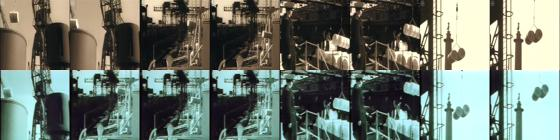

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1946.mp4,00:53:50,00:53:58,8,46500,179.766174,3
Förväntningarnas tid_Vägen genom krisen.webm,00:24:21,00:24:29,8,8145,179.766174,3


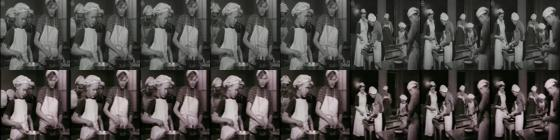

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1947.mp4,00:14:53,00:15:01,8,47603,198.120819,4
Förväntningarnas tid_Skördetid med förhinder.webm,00:20:13,00:20:21,8,4462,198.120819,4


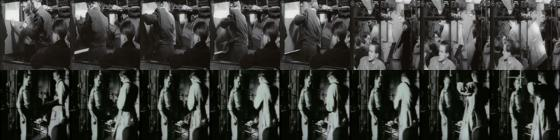

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_De gamla och kloka må le, fallera.webm",00:04:21,00:04:29,8,57222,198.227875,4
Förväntningarnas tid_Skördetid med förhinder.webm,00:20:13,00:20:21,8,4462,198.227875,4


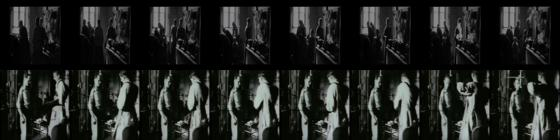

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:30:49,00:30:57,8,61821,191.182175,5
Guldkorn från 1948.webm,00:46:08,00:46:16,8,52837,191.182175,5


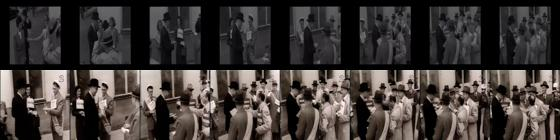

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Skolbarn.webm,00:04:53,00:05:01,8,85152,205.074036,4
Hundra svenska år_Folkhemmet tur och retur.webm,00:01:45,00:01:53,8,60077,205.074036,4


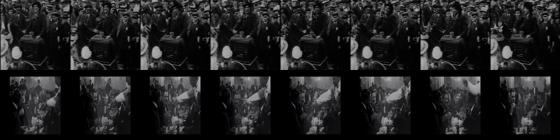

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Trafik.mp4,00:08:13,00:08:21,8,87519,202.395554,2
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:03:07,00:03:15,8,70798,202.395554,2


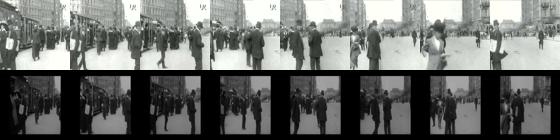

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1948.webm,00:25:55,00:26:02,7,51624,210.489655,2
Förväntningarnas tid_Vägen genom krisen.webm,00:20:34,00:20:41,7,7918,210.489655,2


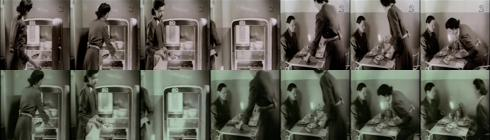

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1948.webm,00:45:33,00:45:40,7,52802,179.485306,3
Förväntningarnas tid_Vägen genom krisen.webm,00:37:45,00:37:52,7,8949,179.485306,3


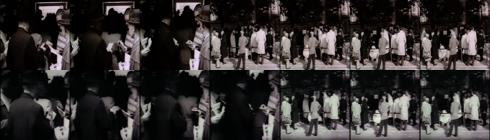

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:46:54,00:47:01,7,62786,179.079727,2
Guldkorn Från 1950.webm,00:43:12,00:43:19,7,16330,179.079727,2


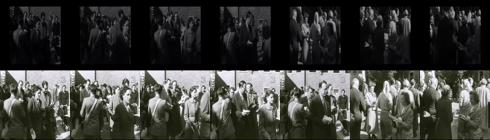

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Handel.webm,00:17:21,00:17:28,7,79619,206.157806,3
Hundra svenska år_Jag har varit med om allt som blivit nytt.webm,00:14:23,00:14:30,7,67246,206.157806,3


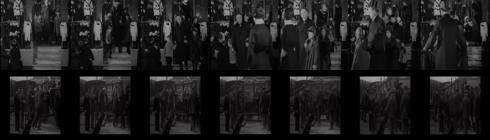

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Hantverk.mp4,00:00:10,00:00:17,7,79683,184.933517,1
Hundra svenska år_Jag har varit med om allt som blivit nytt.webm,00:48:20,00:48:27,7,69283,184.933517,1


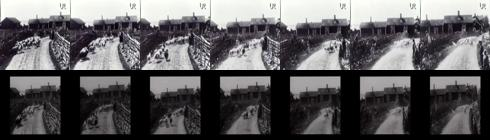

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Idrott.webm,00:05:42,00:05:49,7,81107,133.461609,1
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:29:19,00:29:26,7,72370,133.461609,1


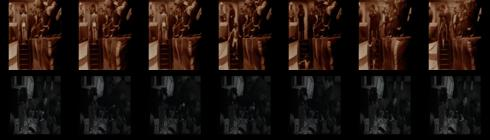

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1948.webm,00:08:21,00:08:27,6,50570,199.624878,2
Förväntningarnas tid_Öppnade gränser.webm,00:26:27,00:26:33,6,11804,199.624878,2


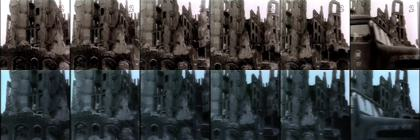

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1948.webm,00:46:08,00:46:14,6,52837,163.865082,1
Förväntningarnas tid_Vägen genom krisen.webm,00:38:59,00:39:05,6,9023,163.865082,1


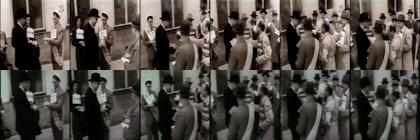

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:14:32,00:14:38,6,60844,184.478958,2
Förväntningarnas tid_Skördetid med förhinder.webm,00:20:21,00:20:27,6,4470,184.478958,2


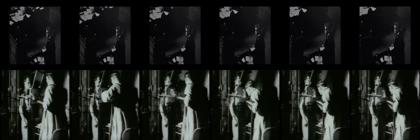

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:30:33,00:30:39,6,61805,188.436447,1
Förväntningarnas tid_Öppnade gränser.webm,00:52:11,00:52:17,6,13348,188.436447,1


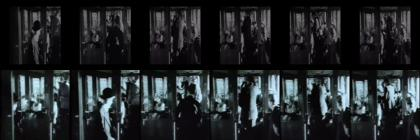

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:30:49,00:30:55,6,61821,192.597519,2
Förväntningarnas tid_Vägen genom krisen.webm,00:38:57,00:39:03,6,9021,192.597519,2


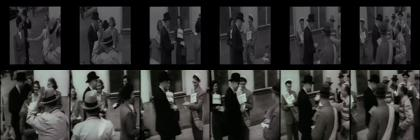

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:03:17,00:03:23,6,70808,218.875504,2
Förväntningarnas tid_Nya hot och drömmar.mp4,00:48:16,00:48:22,6,2896,218.875504,2


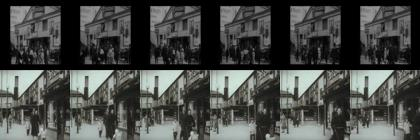

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:13:11,00:13:17,6,71402,186.160278,1
Guldkorn från 1943.mp4,00:41:24,00:41:30,6,33413,186.160278,1


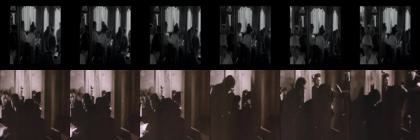

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:29:17,00:29:23,6,72368,122.709740,2
Förväntningarnas tid_Skördetid med förhinder.webm,00:20:21,00:20:27,6,4470,122.709740,2


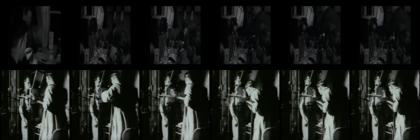

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:34:34,00:34:40,6,72685,135.414017,2
Guldkorn från 1943.mp4,00:41:24,00:41:30,6,33413,135.414017,2


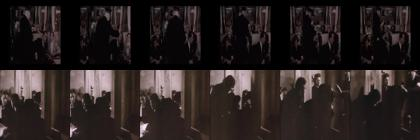

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Å, dyre prins.webm",00:30:13,00:30:19,6,77450,180.547745,0
Guldkorn från 1942.mp4,00:04:18,00:04:24,6,27743,180.547745,0


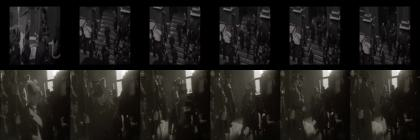

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Industri.webm,00:15:04,00:15:10,6,82600,181.873291,1
Hundra svenska år_Jag har varit med om allt som blivit nytt.webm,00:15:37,00:15:43,6,67320,181.873291,1


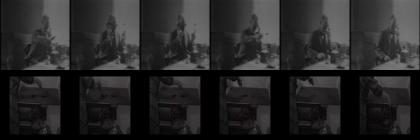

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Industri.webm,00:15:04,00:15:10,6,82600,163.132019,0
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:29:19,00:29:25,6,72370,163.132019,0


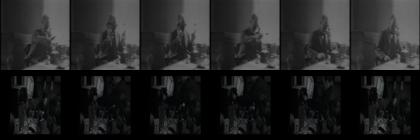

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Industri.webm,00:15:04,00:15:10,6,82600,157.307907,2
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:32:13,00:32:19,6,72544,157.307907,2


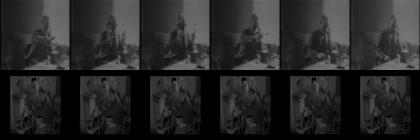

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Skolbarn.webm,00:06:05,00:06:11,6,85224,192.405838,1
"Hundra svenska år_De gamla och kloka må le, fallera.webm",00:47:46,00:47:52,6,59827,192.405838,1


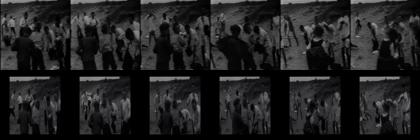

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Skolbarn.webm,00:09:47,00:09:53,6,85446,212.037415,2
Guldkorn från 1940.mp4,00:14:07,00:14:13,6,21344,212.037415,2


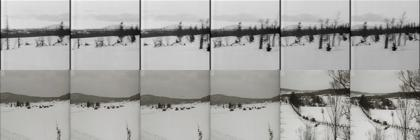

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Skolbarn.webm,00:10:34,00:10:40,6,85493,208.778320,1
"Hundra svenska år_De gamla och kloka må le, fallera.webm",00:03:00,00:03:06,6,57141,208.778320,1


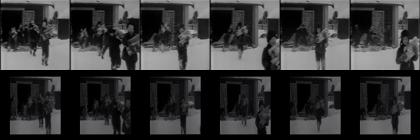

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Skolbarn.webm,00:14:43,00:14:49,6,85742,145.495239,1
"Hundra svenska år_De gamla och kloka må le, fallera.webm",00:17:39,00:17:45,6,58020,145.495239,1


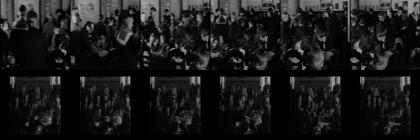

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1941.mp4,00:19:59,00:20:04,5,25175,184.122574,1
Förväntningarnas tid_Nya hot och drömmar.mp4,00:35:51,00:35:56,5,2151,184.122574,1


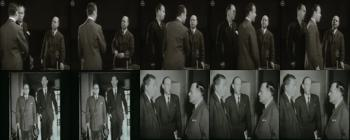

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1941.mp4,00:36:08,00:36:13,5,26144,209.442474,1
Förväntningarnas tid_Nya hot och drömmar.mp4,00:12:20,00:12:25,5,740,209.442474,1


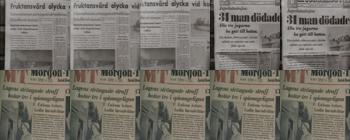

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1941.mp4,00:36:08,00:36:13,5,26144,216.576370,0
Förväntningarnas tid_Vägen genom krisen.webm,00:12:44,00:12:49,5,7448,216.576370,0


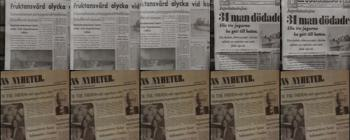

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1945.mp4,00:20:31,00:20:36,5,39177,229.642197,1
Förväntningarnas tid_Skördetid med förhinder.webm,00:06:51,00:06:56,5,3660,229.642197,1


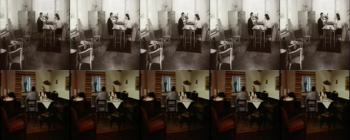

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_De gamla och kloka må le, fallera.webm",00:22:45,00:22:50,5,58326,186.222412,1
Guldkorn från 1949.webm,00:05:59,00:06:04,5,53865,186.222412,1


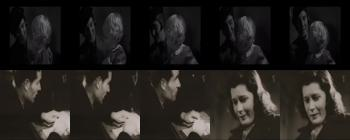

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:14:32,00:14:37,5,60844,186.503082,4
Guldkorn från 1939.mp4,00:57:06,00:57:11,5,20419,186.503082,4


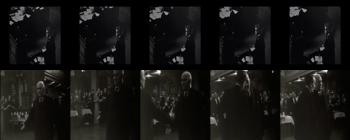

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:30:09,00:30:14,5,61781,197.619797,0
Guldkorn från 1946.mp4,00:46:16,00:46:21,5,46046,197.619797,0


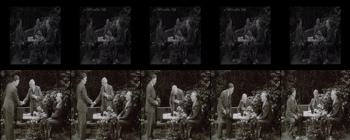

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:39:08,00:39:13,5,62320,136.884094,1
Förväntningarnas tid_Öppnade gränser.webm,00:24:51,00:24:56,5,11708,136.884094,1


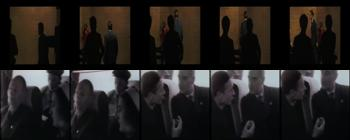

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Jag har varit med om allt som blivit nytt.webm,00:02:08,00:02:13,5,66511,191.375214,1
Guldkorn från 1947.mp4,00:02:56,00:03:01,5,46886,191.375214,1


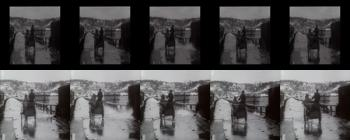

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Kjolarna, hattarna och lite Warzins keratin.mp4",00:12:53,00:12:58,5,70109,184.292221,0
Förväntningarnas tid_Nya hot och drömmar.mp4,00:12:20,00:12:25,5,740,184.292221,0


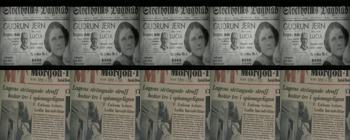

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Kjolarna, hattarna och lite Warzins keratin.mp4",00:12:53,00:12:58,5,70109,185.058350,0
Förväntningarnas tid_Nya hot och drömmar.mp4,00:12:34,00:12:39,5,754,185.058350,0


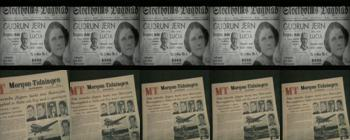

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Kjolarna, hattarna och lite Warzins keratin.mp4",00:12:53,00:12:58,5,70109,204.400726,0
Förväntningarnas tid_Nya hot och drömmar.mp4,00:18:10,00:18:15,5,1090,204.400726,0


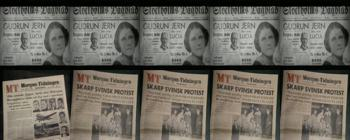

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Kjolarna, hattarna och lite Warzins keratin.mp4",00:12:53,00:12:58,5,70109,192.448105,0
Förväntningarnas tid_Nya hot och drömmar.mp4,00:19:00,00:19:05,5,1140,192.448105,0


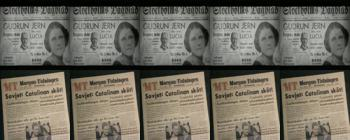

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Kjolarna, hattarna och lite Warzins keratin.mp4",00:12:53,00:12:58,5,70109,226.537842,0
Förväntningarnas tid_Vägen genom krisen.webm,00:12:43,00:12:48,5,7447,226.537842,0


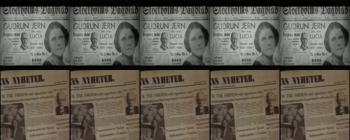

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Kjolarna, hattarna och lite Warzins keratin.mp4",00:12:53,00:12:58,5,70109,217.483765,0
Förväntningarnas tid_Vägen genom krisen.webm,00:41:02,00:41:07,5,9146,217.483765,0


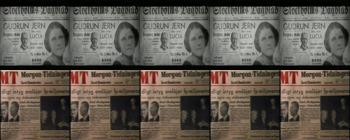

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:24:26,00:24:31,5,72077,177.929153,0
Förväntningarnas tid_Öppnade gränser.webm,00:54:34,00:54:39,5,13491,177.929153,0


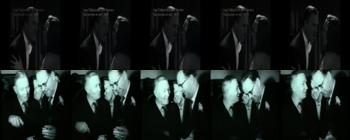

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:29:17,00:29:22,5,72368,170.781693,2
Förväntningarnas tid_Vägen genom krisen.webm,00:57:12,00:57:17,5,10116,170.781693,2


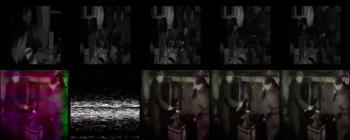

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Å, dyre prins.webm",00:39:31,00:39:36,5,78008,190.303833,2
Guldkorn från 1943.mp4,00:41:23,00:41:28,5,33412,190.303833,2


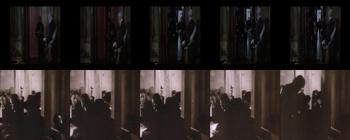

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Å, dyre prins.webm",00:43:28,00:43:33,5,78245,200.937057,0
Guldkorn från 1943.mp4,00:18:31,00:18:36,5,32040,200.937057,0


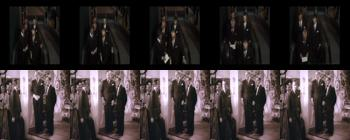

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Å, dyre prins.webm",00:43:28,00:43:33,5,78245,216.355682,1
Guldkorn från 1943.mp4,00:18:38,00:18:43,5,32047,216.355682,1


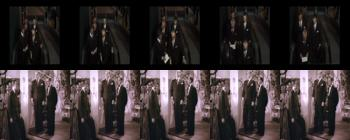

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Idrott.webm,00:05:42,00:05:47,5,81107,131.453735,1
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:34:37,00:34:42,5,72688,131.453735,1


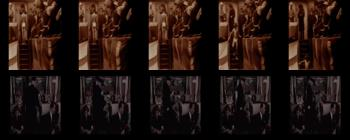

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Industri.webm,00:08:29,00:08:34,5,82205,169.137970,1
Förväntningarnas tid_Öppnade gränser.webm,00:03:00,00:03:05,5,10397,169.137970,1


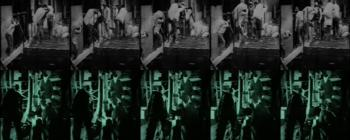

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Industri.webm,00:08:29,00:08:34,5,82205,106.933006,1
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:29:19,00:29:24,5,72370,106.933006,1


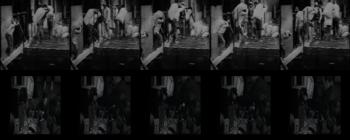

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Industri.webm,00:10:13,00:10:18,5,82309,216.528732,1
Förväntningarnas tid_Nya hot och drömmar.mp4,00:18:24,00:18:29,5,1104,216.528732,1


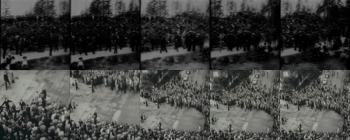

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Industri.webm,00:15:04,00:15:09,5,82600,160.037216,0
"Hundra svenska år_De gamla och kloka må le, fallera.webm",00:26:46,00:26:51,5,58567,160.037216,0


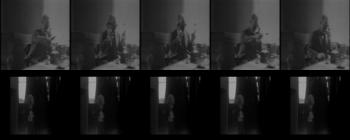

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Industri.webm,00:15:04,00:15:09,5,82600,110.767448,3
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:32:22,00:32:27,5,72553,110.767448,3


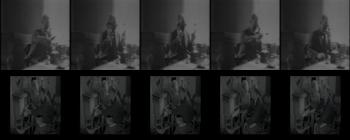

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Rallare.mp4,00:00:31,00:00:36,5,83828,231.415085,1
Guldkorn från 1944.mp4,00:56:36,00:56:41,5,37822,231.415085,1


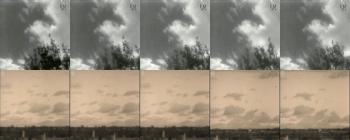

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Rallare.mp4,00:00:31,00:00:36,5,83828,201.345459,0
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:12:55,00:13:00,5,71386,201.345459,0


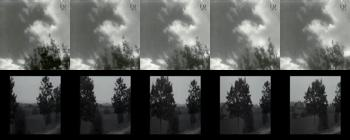

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Skolbarn.webm,00:03:17,00:03:22,5,85056,206.271393,1
Förväntningarnas tid_Öppnade gränser.webm,00:03:00,00:03:05,5,10397,206.271393,1


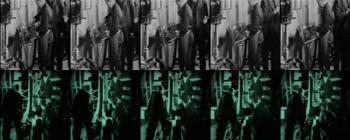

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Skolbarn.webm,00:14:00,00:14:05,5,85699,186.701324,0
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:03:16,00:03:21,5,70807,186.701324,0


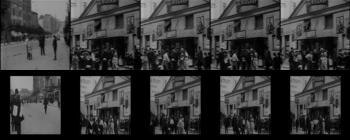

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Skolbarn.webm,00:15:15,00:15:20,5,85774,222.519531,0
"Hundra svenska år_De gamla och kloka må le, fallera.webm",00:14:49,00:14:54,5,57850,222.519531,0


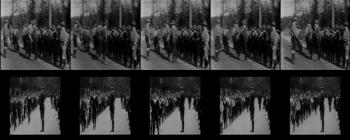

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Sverige.webm,00:11:49,00:11:54,5,86674,180.529205,0
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:34:36,00:34:41,5,72687,180.529205,0


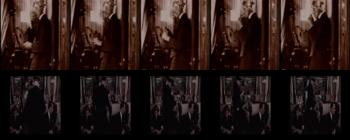

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn Från 1950.webm,00:31:42,00:31:46,4,15640,149.703949,0
Förväntningarnas tid_Nya hot och drömmar.mp4,00:02:18,00:02:22,4,138,149.703949,0


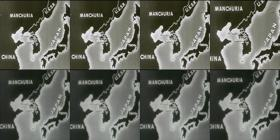

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1939.mp4,00:11:47,00:11:51,4,17700,225.086151,0
Förväntningarnas tid_Vägen genom krisen.webm,00:18:53,00:18:57,4,7817,225.086151,0


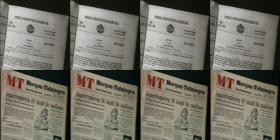

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1939.mp4,00:11:47,00:11:51,4,17700,230.128281,0
Förväntningarnas tid_Vägen genom krisen.webm,00:19:04,00:19:08,4,7828,230.128281,0


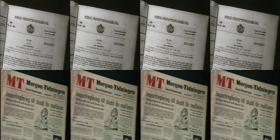

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1939.mp4,00:11:47,00:11:51,4,17700,227.963531,0
Förväntningarnas tid_Öppnade gränser.webm,00:45:27,00:45:31,4,12944,227.963531,0


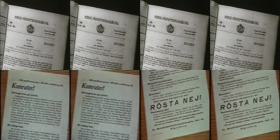

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1944.mp4,00:13:56,00:14:00,4,35262,168.654572,0
Förväntningarnas tid_Skördetid med förhinder.webm,00:31:27,00:31:31,4,5136,168.654572,0


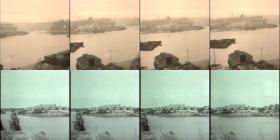

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1945.mp4,00:22:04,00:22:08,4,39270,201.146729,0
Förväntningarnas tid_Nya hot och drömmar.mp4,00:17:56,00:18:00,4,1076,201.146729,0


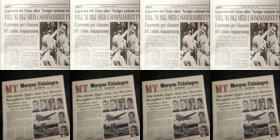

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1946.mp4,00:44:31,00:44:35,4,45941,169.495407,0
Förväntningarnas tid_Öppnade gränser.webm,00:56:05,00:56:09,4,13582,169.495407,0


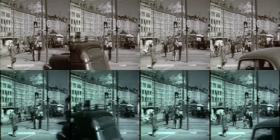

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1948.webm,00:26:09,00:26:13,4,51638,184.181396,0
Förväntningarnas tid_Vägen genom krisen.webm,00:20:43,00:20:47,4,7927,184.181396,0


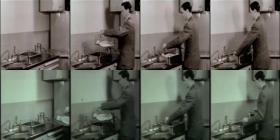

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1949.webm,00:39:58,00:40:02,4,55904,230.316849,0
Förväntningarnas tid_Nya hot och drömmar.mp4,00:33:29,00:33:33,4,2009,230.316849,0


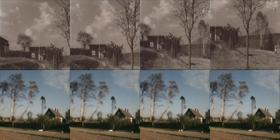

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_De gamla och kloka må le, fallera.webm",00:23:10,00:23:14,4,58351,201.903107,0
Förväntningarnas tid_Öppnade gränser.webm,00:24:48,00:24:52,4,11705,201.903107,0


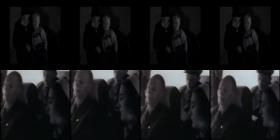

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_De gamla och kloka må le, fallera.webm",00:25:02,00:25:06,4,58463,167.931381,0
Guldkorn från 1939.mp4,00:54:52,00:54:56,4,20285,167.931381,0


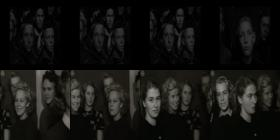

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:30:09,00:30:13,4,61781,216.093475,0
Guldkorn från 1946.mp4,00:46:55,00:46:59,4,46085,216.093475,0


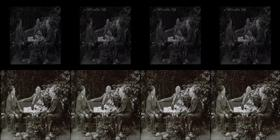

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:47:21,00:47:25,4,62813,145.292130,0
Förväntningarnas tid_Vägen genom krisen.webm,00:28:28,00:28:32,4,8392,145.292130,0


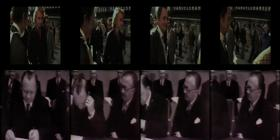

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Kjolarna, hattarna och lite Warzins keratin.mp4",00:12:53,00:12:57,4,70109,194.814316,0
Förväntningarnas tid_Nya hot och drömmar.mp4,00:17:15,00:17:19,4,1035,194.814316,0


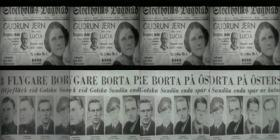

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:24:26,00:24:30,4,72077,194.608200,0
Förväntningarnas tid_Vägen genom krisen.webm,00:06:41,00:06:45,4,7085,194.608200,0


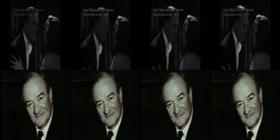

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:24:26,00:24:30,4,72077,188.533234,0
Guldkorn från 1949.webm,00:01:42,00:01:46,4,53608,188.533234,0


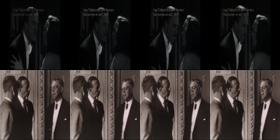

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Vi och världen.mp4,00:30:57,00:31:01,4,75465,226.893631,0
Guldkorn från 1944.mp4,00:56:23,00:56:27,4,37809,226.893631,0


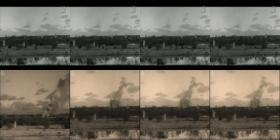

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Å, dyre prins.webm",00:43:28,00:43:32,4,78245,202.793274,1
Guldkorn från 1943.mp4,00:18:43,00:18:47,4,32052,202.793274,1


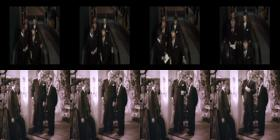

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Handel.webm,00:16:47,00:16:51,4,79585,194.573059,0
Hundra svenska år_Jag har varit med om allt som blivit nytt.webm,00:03:57,00:04:01,4,66620,194.573059,0


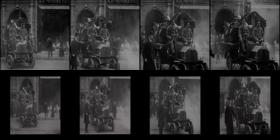

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Idrott.webm,00:06:19,00:06:23,4,81144,220.682236,0
Guldkorn från 1949.webm,00:00:16,00:00:20,4,53522,220.682236,0


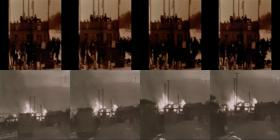

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Rallare.mp4,00:00:26,00:00:30,4,83823,189.222931,0
Guldkorn från 1943.mp4,00:38:56,00:39:00,4,33265,189.222931,0


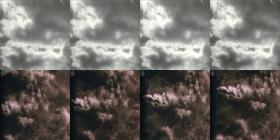

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Skolbarn.webm,00:13:08,00:13:12,4,85647,167.476944,1
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:15:38,00:15:42,4,71549,167.476944,1


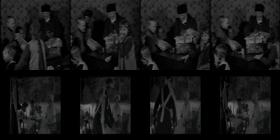

In [37]:
TV_dataset_finder.show_notebook_sequence(TV_dataset_sequences, show_limit=200, show_shift=False, frame_resize=(70,70), convert_format='JPEG')

When looking at these thumbnails, we notice that a few unwanted sequences remain in the matching results. If desired, we could have gone back to add these to the unwanted_frames Excel spreadsheet and filtered the matching results once more. For instance, one sequence shows mismatched newspaper pages, and in another, clouds appear to have been mixed up with trees. In this case, however, we decide that the dataset is sufficiently clean to facilitate the rest of our analysis. 

Next, we decide to drill deeper into the matching results by having a closer look at reuse based on some specific TV series episodes. Using the latest bar plot, we begin by looking at the episode with the most identified instances of reuse (i.e. the video entitled "Förväntningarnas tid_Vägen genom krisen").

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1946.mp4,00:54:47,00:55:14,27,46557,196.678253,10
Förväntningarnas tid_Vägen genom krisen.webm,00:25:19,00:25:46,27,8203,196.678253,10


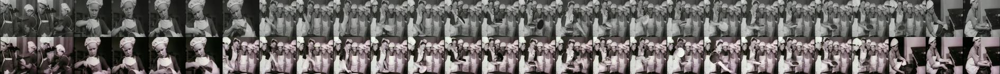

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1946.mp4,00:54:15,00:54:31,16,46525,211.580536,7
Förväntningarnas tid_Vägen genom krisen.webm,00:24:46,00:25:02,16,8170,211.580536,7


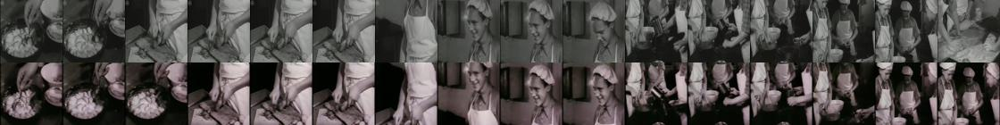

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1947.mp4,00:28:30,00:28:46,16,48420,190.984879,4
Förväntningarnas tid_Vägen genom krisen.webm,00:00:03,00:00:19,16,6687,190.984879,4


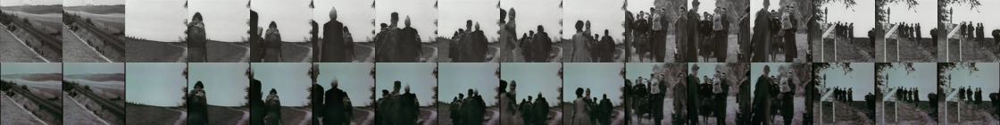

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1948.webm,00:46:30,00:46:46,16,52859,191.281067,4
Förväntningarnas tid_Vägen genom krisen.webm,00:37:54,00:38:10,16,8958,191.281067,4


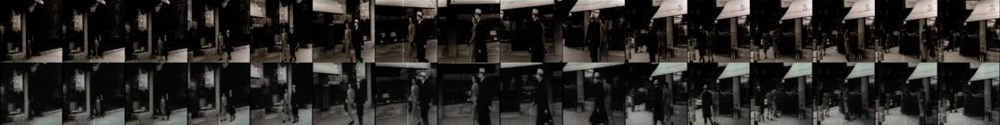

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1946.mp4,00:55:21,00:55:36,15,46591,180.833862,5
Förväntningarnas tid_Vägen genom krisen.webm,00:25:52,00:26:07,15,8236,180.833862,5


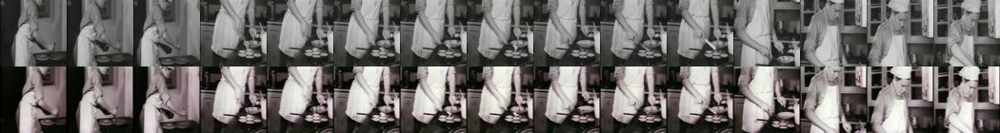

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1948.webm,00:45:41,00:45:56,15,52810,217.616089,10
Förväntningarnas tid_Vägen genom krisen.webm,00:39:50,00:40:05,15,9074,217.616089,10


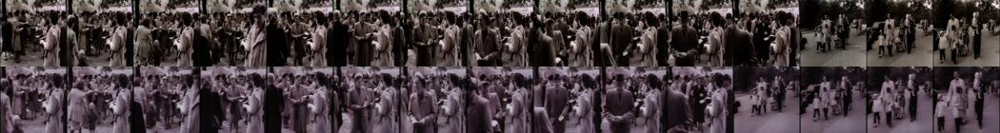

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1948.webm,00:47:05,00:47:19,14,52894,177.207947,2
Förväntningarnas tid_Vägen genom krisen.webm,00:51:51,00:52:05,14,9795,177.207947,2


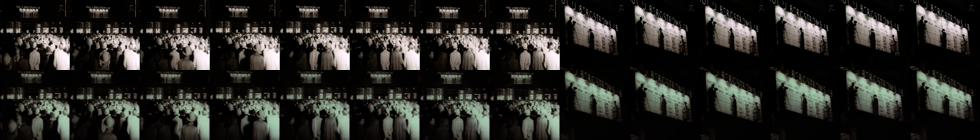

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1945.mp4,00:19:16,00:19:29,13,39102,176.571075,4
Förväntningarnas tid_Vägen genom krisen.webm,00:21:57,00:22:10,13,8001,176.571075,4


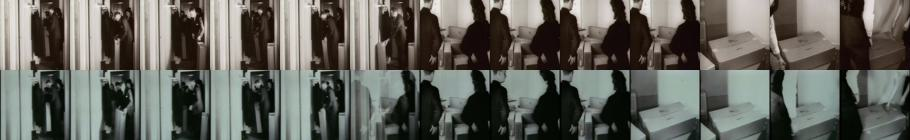

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1948.webm,00:45:20,00:45:32,12,52789,158.465561,2
Förväntningarnas tid_Vägen genom krisen.webm,00:37:04,00:37:16,12,8908,158.465561,2


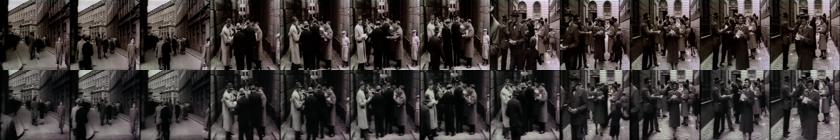

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1946.mp4,00:53:50,00:53:58,8,46500,179.766174,3
Förväntningarnas tid_Vägen genom krisen.webm,00:24:21,00:24:29,8,8145,179.766174,3


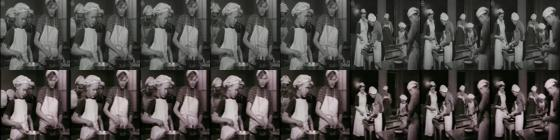

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1948.webm,00:25:55,00:26:02,7,51624,210.489655,2
Förväntningarnas tid_Vägen genom krisen.webm,00:20:34,00:20:41,7,7918,210.489655,2


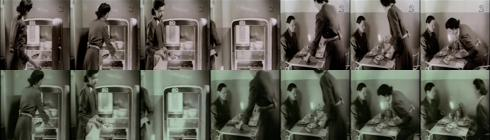

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1948.webm,00:45:33,00:45:40,7,52802,179.485306,3
Förväntningarnas tid_Vägen genom krisen.webm,00:37:45,00:37:52,7,8949,179.485306,3


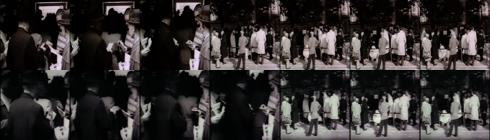

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1948.webm,00:46:08,00:46:14,6,52837,163.865082,1
Förväntningarnas tid_Vägen genom krisen.webm,00:38:59,00:39:05,6,9023,163.865082,1


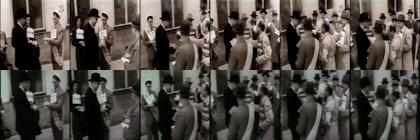

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:30:49,00:30:55,6,61821,192.597519,2
Förväntningarnas tid_Vägen genom krisen.webm,00:38:57,00:39:03,6,9021,192.597519,2


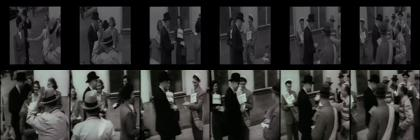

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1941.mp4,00:36:08,00:36:13,5,26144,216.576370,0
Förväntningarnas tid_Vägen genom krisen.webm,00:12:44,00:12:49,5,7448,216.576370,0


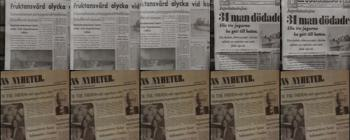

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Kjolarna, hattarna och lite Warzins keratin.mp4",00:12:53,00:12:58,5,70109,226.537842,0
Förväntningarnas tid_Vägen genom krisen.webm,00:12:43,00:12:48,5,7447,226.537842,0


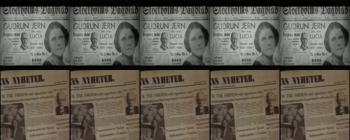

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Kjolarna, hattarna och lite Warzins keratin.mp4",00:12:53,00:12:58,5,70109,217.483765,0
Förväntningarnas tid_Vägen genom krisen.webm,00:41:02,00:41:07,5,9146,217.483765,0


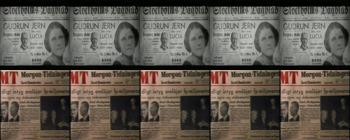

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:29:17,00:29:22,5,72368,170.781693,2
Förväntningarnas tid_Vägen genom krisen.webm,00:57:12,00:57:17,5,10116,170.781693,2


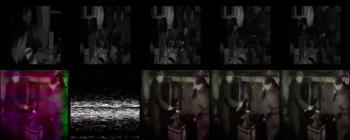

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1939.mp4,00:11:47,00:11:51,4,17700,225.086151,0
Förväntningarnas tid_Vägen genom krisen.webm,00:18:53,00:18:57,4,7817,225.086151,0


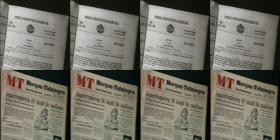

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1939.mp4,00:11:47,00:11:51,4,17700,230.128281,0
Förväntningarnas tid_Vägen genom krisen.webm,00:19:04,00:19:08,4,7828,230.128281,0


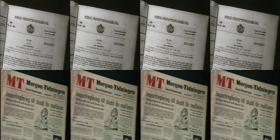

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1948.webm,00:26:09,00:26:13,4,51638,184.181396,0
Förväntningarnas tid_Vägen genom krisen.webm,00:20:43,00:20:47,4,7927,184.181396,0


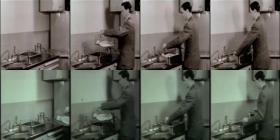

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:47:21,00:47:25,4,62813,145.292130,0
Förväntningarnas tid_Vägen genom krisen.webm,00:28:28,00:28:32,4,8392,145.292130,0


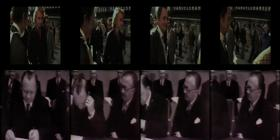

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:24:26,00:24:30,4,72077,194.608200,0
Förväntningarnas tid_Vägen genom krisen.webm,00:06:41,00:06:45,4,7085,194.608200,0


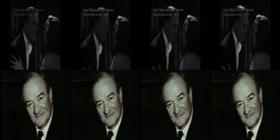

In [38]:
TV_dataset_finder.show_notebook_sequence(contains_video(TV_dataset_sequences, 'Förväntningarnas tid_Vägen genom krisen.webm', TV_dataset_finder), show_limit=200, show_shift=False, frame_resize=(70,70), convert_format='JPEG')

We also have a closer look at all matching results for the four clips that can be found furthest to the left in the bar plot above.

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Trafik.mp4,00:09:05,00:09:17,12,87571,155.887985,0
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:02:47,00:02:59,12,70778,155.887985,0


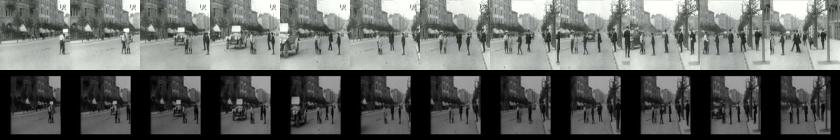

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:24:39,00:24:49,10,72090,170.030502,8
Guldkorn från 1949.webm,00:05:53,00:06:03,10,53859,170.030502,8


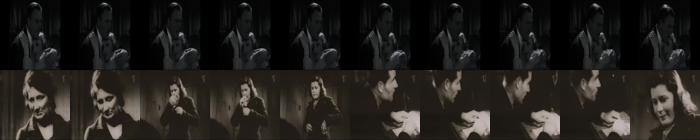

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:29:17,00:29:26,9,72368,129.285294,5
Förväntningarnas tid_Öppnade gränser.webm,00:02:55,00:03:04,9,10392,129.285294,5


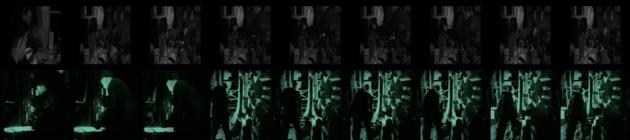

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Trafik.mp4,00:08:13,00:08:21,8,87519,202.395554,2
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:03:07,00:03:15,8,70798,202.395554,2


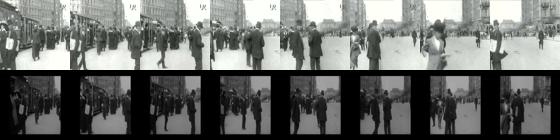

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Idrott.webm,00:05:42,00:05:49,7,81107,133.461609,1
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:29:19,00:29:26,7,72370,133.461609,1


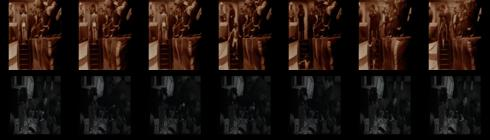

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:03:17,00:03:23,6,70808,218.875504,2
Förväntningarnas tid_Nya hot och drömmar.mp4,00:48:16,00:48:22,6,2896,218.875504,2


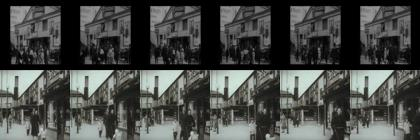

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:13:11,00:13:17,6,71402,186.160278,1
Guldkorn från 1943.mp4,00:41:24,00:41:30,6,33413,186.160278,1


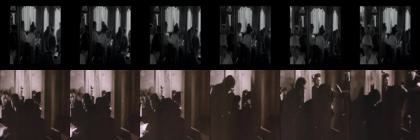

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:29:17,00:29:23,6,72368,122.709740,2
Förväntningarnas tid_Skördetid med förhinder.webm,00:20:21,00:20:27,6,4470,122.709740,2


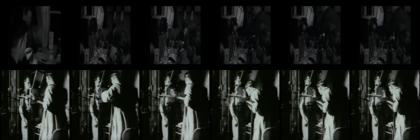

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:34:34,00:34:40,6,72685,135.414017,2
Guldkorn från 1943.mp4,00:41:24,00:41:30,6,33413,135.414017,2


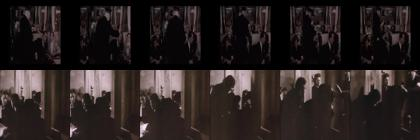

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Industri.webm,00:15:04,00:15:10,6,82600,163.132019,0
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:29:19,00:29:25,6,72370,163.132019,0


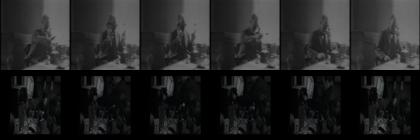

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Industri.webm,00:15:04,00:15:10,6,82600,157.307907,2
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:32:13,00:32:19,6,72544,157.307907,2


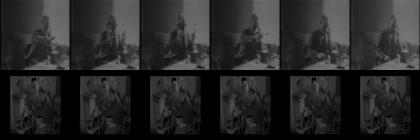

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:24:26,00:24:31,5,72077,177.929153,0
Förväntningarnas tid_Öppnade gränser.webm,00:54:34,00:54:39,5,13491,177.929153,0


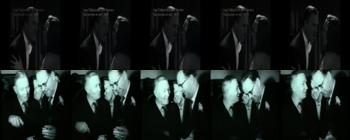

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:29:17,00:29:22,5,72368,170.781693,2
Förväntningarnas tid_Vägen genom krisen.webm,00:57:12,00:57:17,5,10116,170.781693,2


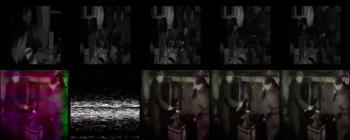

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Idrott.webm,00:05:42,00:05:47,5,81107,131.453735,1
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:34:37,00:34:42,5,72688,131.453735,1


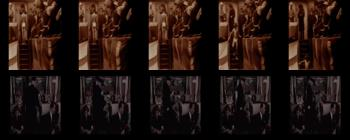

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Industri.webm,00:08:29,00:08:34,5,82205,106.933006,1
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:29:19,00:29:24,5,72370,106.933006,1


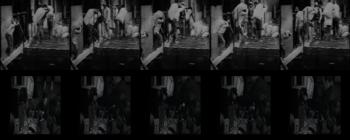

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Industri.webm,00:15:04,00:15:09,5,82600,110.767448,3
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:32:22,00:32:27,5,72553,110.767448,3


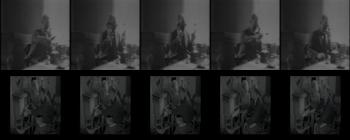

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Rallare.mp4,00:00:31,00:00:36,5,83828,201.345459,0
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:12:55,00:13:00,5,71386,201.345459,0


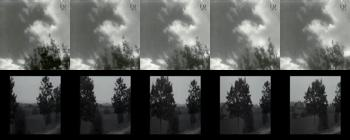

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Skolbarn.webm,00:14:00,00:14:05,5,85699,186.701324,0
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:03:16,00:03:21,5,70807,186.701324,0


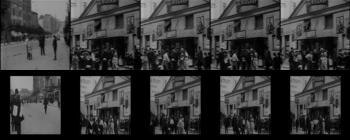

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Sverige.webm,00:11:49,00:11:54,5,86674,180.529205,0
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:34:36,00:34:41,5,72687,180.529205,0


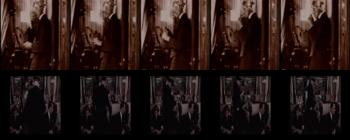

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:24:26,00:24:30,4,72077,194.608200,0
Förväntningarnas tid_Vägen genom krisen.webm,00:06:41,00:06:45,4,7085,194.608200,0


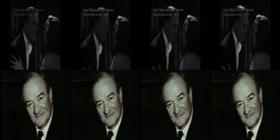

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:24:26,00:24:30,4,72077,188.533234,0
Guldkorn från 1949.webm,00:01:42,00:01:46,4,53608,188.533234,0


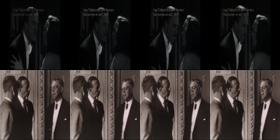

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Skolbarn.webm,00:13:08,00:13:12,4,85647,167.476944,1
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:15:38,00:15:42,4,71549,167.476944,1


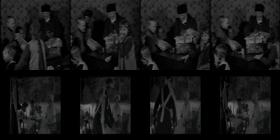

In [39]:
TV_dataset_finder.show_notebook_sequence(contains_video(TV_dataset_sequences, 'Hundra svenska år_Nu har jag kastat min blå overall.mkv', TV_dataset_finder), show_limit=200, show_shift=False, frame_resize=(70,70), convert_format='JPEG')

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Skolbarn.webm,00:13:08,00:13:18,10,85647,207.649689,5
Hundra svenska år_Folkhemmet tur och retur.webm,00:14:36,00:14:46,10,60848,207.649689,5


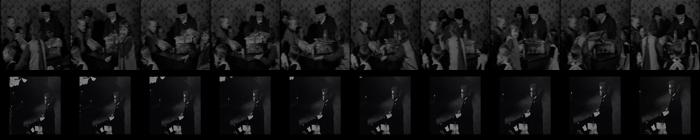

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Handel.webm,00:02:06,00:02:15,9,78704,209.031662,6
Hundra svenska år_Folkhemmet tur och retur.webm,00:03:38,00:03:47,9,60190,209.031662,6


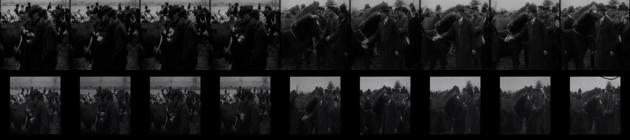

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:30:49,00:30:57,8,61821,191.182175,5
Guldkorn från 1948.webm,00:46:08,00:46:16,8,52837,191.182175,5


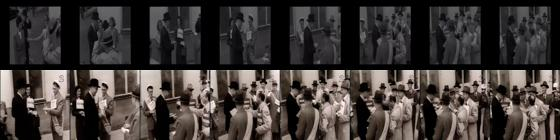

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Skolbarn.webm,00:04:53,00:05:01,8,85152,205.074036,4
Hundra svenska år_Folkhemmet tur och retur.webm,00:01:45,00:01:53,8,60077,205.074036,4


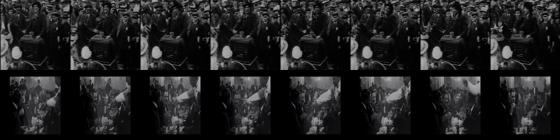

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:46:54,00:47:01,7,62786,179.079727,2
Guldkorn Från 1950.webm,00:43:12,00:43:19,7,16330,179.079727,2


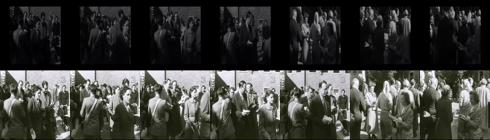

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:14:32,00:14:38,6,60844,184.478958,2
Förväntningarnas tid_Skördetid med förhinder.webm,00:20:21,00:20:27,6,4470,184.478958,2


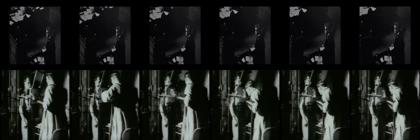

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:30:33,00:30:39,6,61805,188.436447,1
Förväntningarnas tid_Öppnade gränser.webm,00:52:11,00:52:17,6,13348,188.436447,1


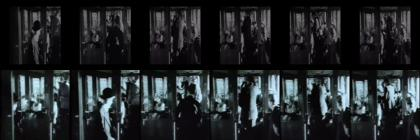

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:30:49,00:30:55,6,61821,192.597519,2
Förväntningarnas tid_Vägen genom krisen.webm,00:38:57,00:39:03,6,9021,192.597519,2


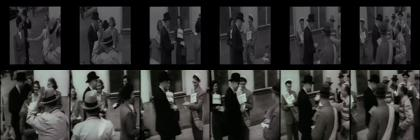

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:14:32,00:14:37,5,60844,186.503082,4
Guldkorn från 1939.mp4,00:57:06,00:57:11,5,20419,186.503082,4


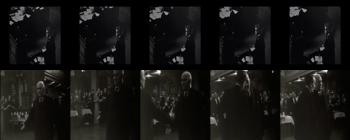

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:30:09,00:30:14,5,61781,197.619797,0
Guldkorn från 1946.mp4,00:46:16,00:46:21,5,46046,197.619797,0


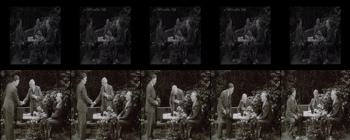

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:39:08,00:39:13,5,62320,136.884094,1
Förväntningarnas tid_Öppnade gränser.webm,00:24:51,00:24:56,5,11708,136.884094,1


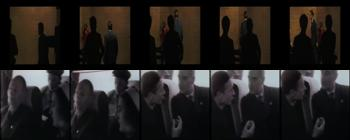

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:30:09,00:30:13,4,61781,216.093475,0
Guldkorn från 1946.mp4,00:46:55,00:46:59,4,46085,216.093475,0


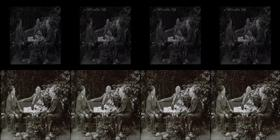

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:47:21,00:47:25,4,62813,145.292130,0
Förväntningarnas tid_Vägen genom krisen.webm,00:28:28,00:28:32,4,8392,145.292130,0


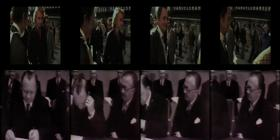

In [40]:
TV_dataset_finder.show_notebook_sequence(contains_video(TV_dataset_sequences, 'Hundra svenska år_Folkhemmet tur och retur.webm', TV_dataset_finder), show_limit=200, show_shift=False, frame_resize=(70,70), convert_format='JPEG')

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Hantverk.mp4,00:02:56,00:03:07,11,79849,206.091156,3
Hundra svenska år_Jag har varit med om allt som blivit nytt.webm,00:13:27,00:13:38,11,67190,206.091156,3


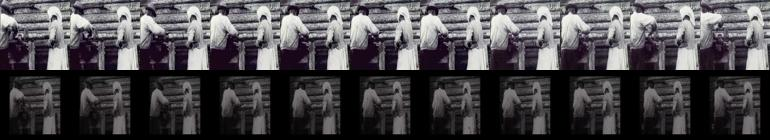

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Jag har varit med om allt som blivit nytt.webm,00:29:00,00:29:09,9,68123,164.106964,4
Guldkorn från 1947.mp4,00:36:46,00:36:55,9,48916,164.106964,4


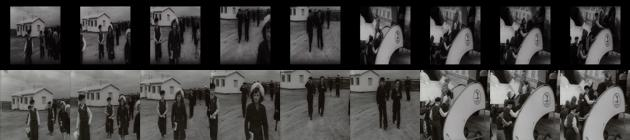

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Handel.webm,00:17:21,00:17:28,7,79619,206.157806,3
Hundra svenska år_Jag har varit med om allt som blivit nytt.webm,00:14:23,00:14:30,7,67246,206.157806,3


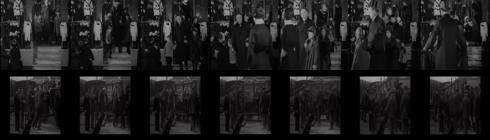

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Hantverk.mp4,00:00:10,00:00:17,7,79683,184.933517,1
Hundra svenska år_Jag har varit med om allt som blivit nytt.webm,00:48:20,00:48:27,7,69283,184.933517,1


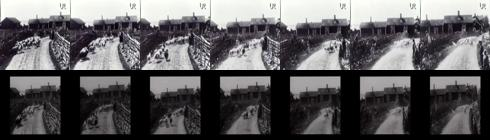

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Industri.webm,00:15:04,00:15:10,6,82600,181.873291,1
Hundra svenska år_Jag har varit med om allt som blivit nytt.webm,00:15:37,00:15:43,6,67320,181.873291,1


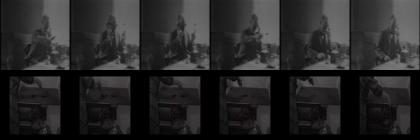

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Jag har varit med om allt som blivit nytt.webm,00:02:08,00:02:13,5,66511,191.375214,1
Guldkorn från 1947.mp4,00:02:56,00:03:01,5,46886,191.375214,1


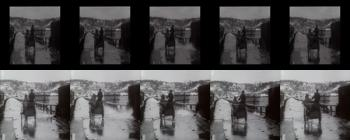

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Handel.webm,00:16:47,00:16:51,4,79585,194.573059,0
Hundra svenska år_Jag har varit med om allt som blivit nytt.webm,00:03:57,00:04:01,4,66620,194.573059,0


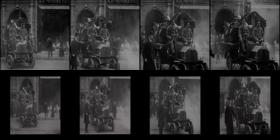

In [41]:
TV_dataset_finder.show_notebook_sequence(contains_video(TV_dataset_sequences, 'Hundra svenska år_Jag har varit med om allt som blivit nytt.webm', TV_dataset_finder), show_limit=200, show_shift=False, frame_resize=(70,70), convert_format='JPEG')

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1944.mp4,00:28:51,00:29:10,19,36157,199.057266,8
Förväntningarnas tid_Öppnade gränser.webm,00:20:18,00:20:37,19,11435,199.057266,8


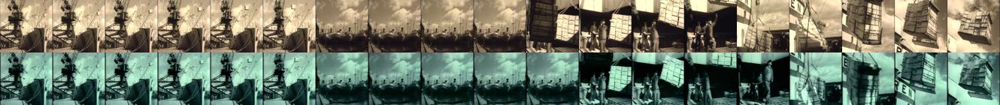

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1944.mp4,00:28:16,00:28:28,12,36122,175.445938,3
Förväntningarnas tid_Öppnade gränser.webm,00:20:02,00:20:14,12,11419,175.445938,3


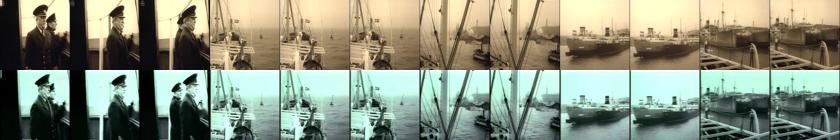

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:29:17,00:29:26,9,72368,129.285294,5
Förväntningarnas tid_Öppnade gränser.webm,00:02:55,00:03:04,9,10392,129.285294,5


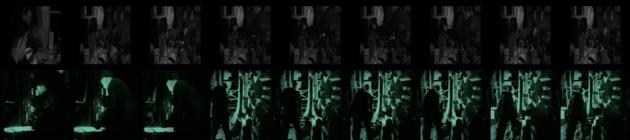

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1944.mp4,00:27:12,00:27:20,8,36058,205.983139,2
Förväntningarnas tid_Öppnade gränser.webm,00:41:58,00:42:06,8,12735,205.983139,2


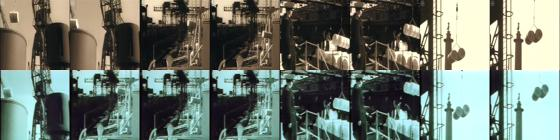

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1948.webm,00:08:21,00:08:27,6,50570,199.624878,2
Förväntningarnas tid_Öppnade gränser.webm,00:26:27,00:26:33,6,11804,199.624878,2


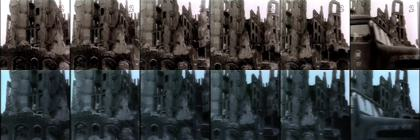

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:30:33,00:30:39,6,61805,188.436447,1
Förväntningarnas tid_Öppnade gränser.webm,00:52:11,00:52:17,6,13348,188.436447,1


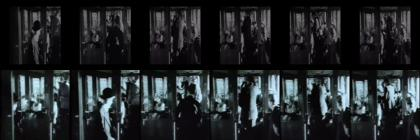

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:39:08,00:39:13,5,62320,136.884094,1
Förväntningarnas tid_Öppnade gränser.webm,00:24:51,00:24:56,5,11708,136.884094,1


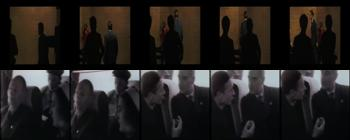

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:24:26,00:24:31,5,72077,177.929153,0
Förväntningarnas tid_Öppnade gränser.webm,00:54:34,00:54:39,5,13491,177.929153,0


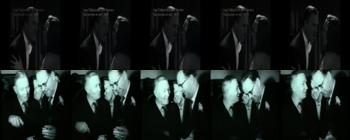

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Industri.webm,00:08:29,00:08:34,5,82205,169.137970,1
Förväntningarnas tid_Öppnade gränser.webm,00:03:00,00:03:05,5,10397,169.137970,1


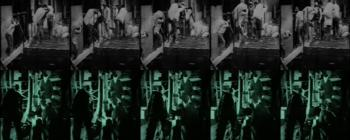

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Skolbarn.webm,00:03:17,00:03:22,5,85056,206.271393,1
Förväntningarnas tid_Öppnade gränser.webm,00:03:00,00:03:05,5,10397,206.271393,1


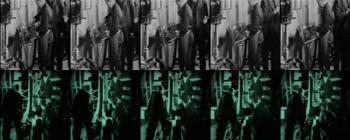

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1939.mp4,00:11:47,00:11:51,4,17700,227.963531,0
Förväntningarnas tid_Öppnade gränser.webm,00:45:27,00:45:31,4,12944,227.963531,0


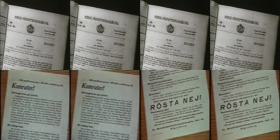

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1946.mp4,00:44:31,00:44:35,4,45941,169.495407,0
Förväntningarnas tid_Öppnade gränser.webm,00:56:05,00:56:09,4,13582,169.495407,0


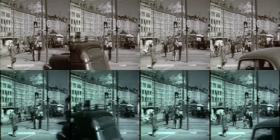

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_De gamla och kloka må le, fallera.webm",00:23:10,00:23:14,4,58351,201.903107,0
Förväntningarnas tid_Öppnade gränser.webm,00:24:48,00:24:52,4,11705,201.903107,0


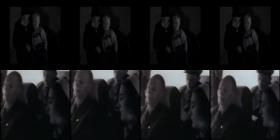

In [42]:
TV_dataset_finder.show_notebook_sequence(contains_video(TV_dataset_sequences, 'Förväntningarnas tid_Öppnade gränser.webm', TV_dataset_finder), show_limit=200, show_shift=False, frame_resize=(70,70), convert_format='JPEG')

In total, 89 169 fingerprints were produced from the TV dataset and compared against each other. Among these fingerprints, we applied a distance metric threshold of 120 (see [step 4](#Step-4.-Analyze-distance-metric-distribution)) and filtered out all matching frames with origins in the same TV series. We also searched for sequential matches that were at least 5 seconds long and allowed a skip rate of two frames per sequence (see [step 5](#Step-5.-Filter-matching-results)). We also filtered out 297 uninteresting sequences that were identified manually.

In the remaining matching results, we for example found that several cooking sequences with children had been reused in both *Gold Nuggets* from 1946, and the episode 'The Path Through the Crisis' (Vägen genom krisen) from the series *The Time of Expectations* (Förväntningarnas tid). Looking closer at the footage (see figure 12-15), it was apparent that the children doing the cooking were boys. The Swedish welfare state did not solely deem domestic sciences to be a subject for girls – gender neutrality was to rule the kitchen – which naturally was an alluring theme for TV-producers. The selected sequences were almost identical, and the boys – of course, supervised by a female teacher – were preparing pancakes and apple pie: "nicer to eat than cook".

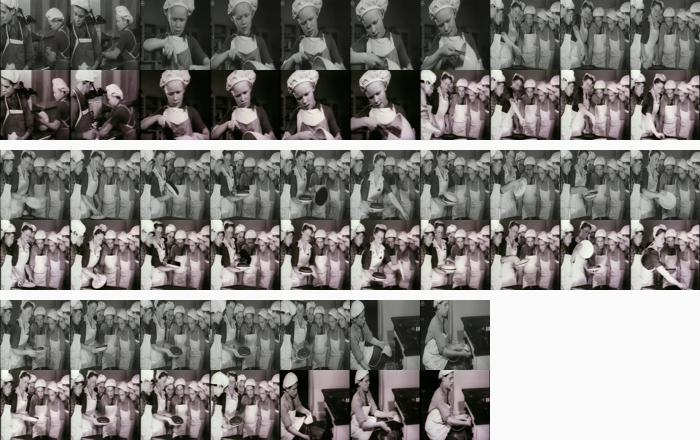

In [4]:
image_metadata("./media/cooking_1.jpeg", metadata="Cooking sequence. Upper row: *Gold Nuggets From 1946*. Start time 00:54:47. End time 00:55:14. Bottom row: *The Time of Expectations*, 'The Path Through the Crisis'. Start time 00:25:19. End time 00:25:46.")

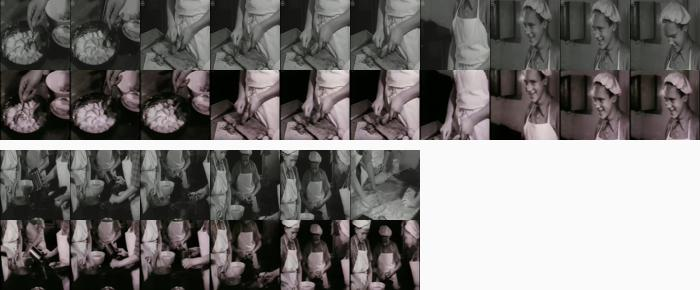

In [5]:
image_metadata("./media/cooking_2.jpeg", metadata="Cooking sequence. Upper row: *Gold Nuggets from 1946.*. Start time 00:54:15. End time 00:54:31. Bottom row: *The Time of Expectations*, 'The Path Through the Crisis'. Start time 00:24:46. End time 00:25:02.")

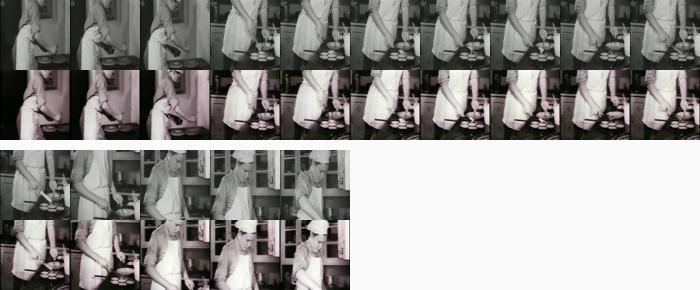

In [6]:
image_metadata("./media/cooking_3.jpeg", metadata="Cooking sequence. Upper row: *Gold Nuggets from 1946.* Start time 00:55:21. End time 00:55:36. Bottom row: *The Time of Expectations*, 'The Path Through the Crisis'. Start time 00:25:52. End time 00:26:07.")

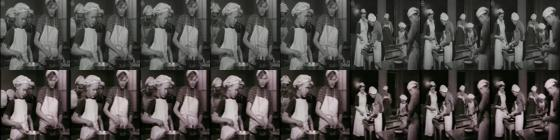

In [7]:
image_metadata("./media/cooking_4.jpeg", metadata="Cooking sequence. Upper row: *Gold Nuggets from 1946.* Start time 00:53:50. End time 00:53:58. Bottom row: *The Time of Expectations*, 'The Path Through the Crisis. Start time 00:24:21. End time 00:24:29.")

Upon closer inspection, we also found that footage from the same episode, 'The Path Through the Crisis', could be found in no less than five episodes from the TV series *Gold Nuggets*. More precisely, footage from 'The Path Through the Crisis' re-appeared in *Gold Nuggets* depicting the years 1941, 1945, 1946, 1947 as well as 1948. In these sequences, we found footage of refugees during the Second World War (figure 16), footage from the Swedish parliamentary election in 1948 (figure 17), and clips showing a newly-wed couple's unpacking of a furniture series by the designer and architect Elias Svedberg, which was designed to be assembled in the home (figure 18). Since the producer of *Gold Nuggets*, Jan Bergman, worked at the Swedish Television film archive, he was well aware of the series *The Time of Expectations*. He might even have assisted in the production by suggesting interesting footage from the SF-archive. Hence, even if the latter series was screened on television the same year as *Gold Nuggets* (in 1985), Bergman did apparently not hesitate to include identical sequences in his own TV programs.

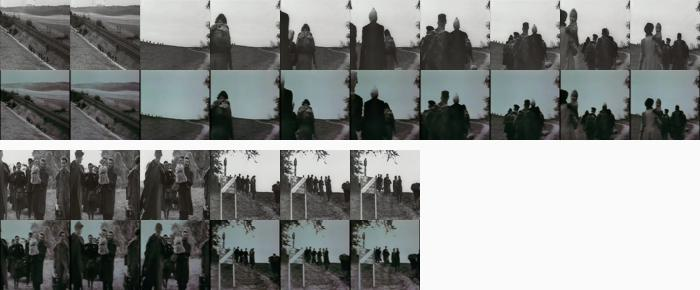

In [9]:
image_metadata("./media/refugees.jpeg", metadata="Refugees walking along a country side road during the Second World War. Upper row: *Gold Nuggets from 1947*. Start time 00:28:30. End time 00:28:46. Bottom row: *The Time of Expectations*, 'The Path Through the Crisis'. Start time 00:00:03. End time 00:00:19.")

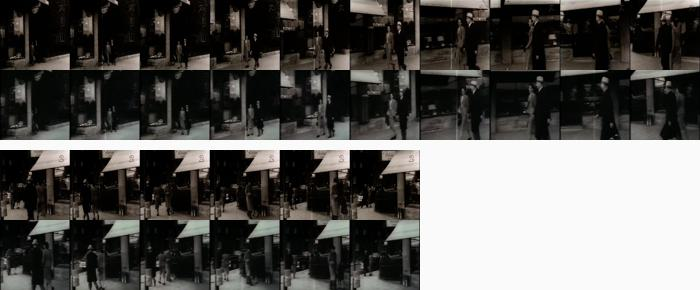

In [10]:
image_metadata("./media/election.jpeg", metadata="Footage from the Swedish parliamentary election in 1948. Upper row: *Guldkorn från 1948*. Start time 00:46:30. End time 00:46:46. Bottom row: *The Time of Expectations*, 'The Path Through the Crisis'. Start time 00:37:54. End time 00:38:10.")

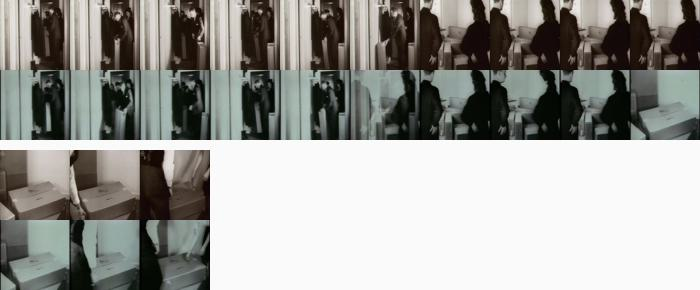

In [11]:
image_metadata("./media/furniture.jpeg", metadata="Married couple unpacking Elias Svedberg's furniture series *Triva bygg*. Upper row: *Guldkorn från 1945*. Start time 00:19:16. End time 00:19:29. Bottom row: *The Time of Expectations*, 'The Path Through the Crisis'. Start time 00:21:57. End time 00:22:10.")

In a similar way, and following the plot below (figure 19), we find indications that footage found in episode six of *A Hundred Swedish Years*, entitled 'Now I have discarded my blue overall' (*Hundra svenska år*, 'Nu har jag kastat min blå overall'), has been matched nearly 25 times with content in other TV series episodes. Since Olle Häger produced his documentary series *A Hundred Swedish Years* in the 1990s, he had all likely seen most of the previous TV series in our experiment, cherry-picking the best footage.

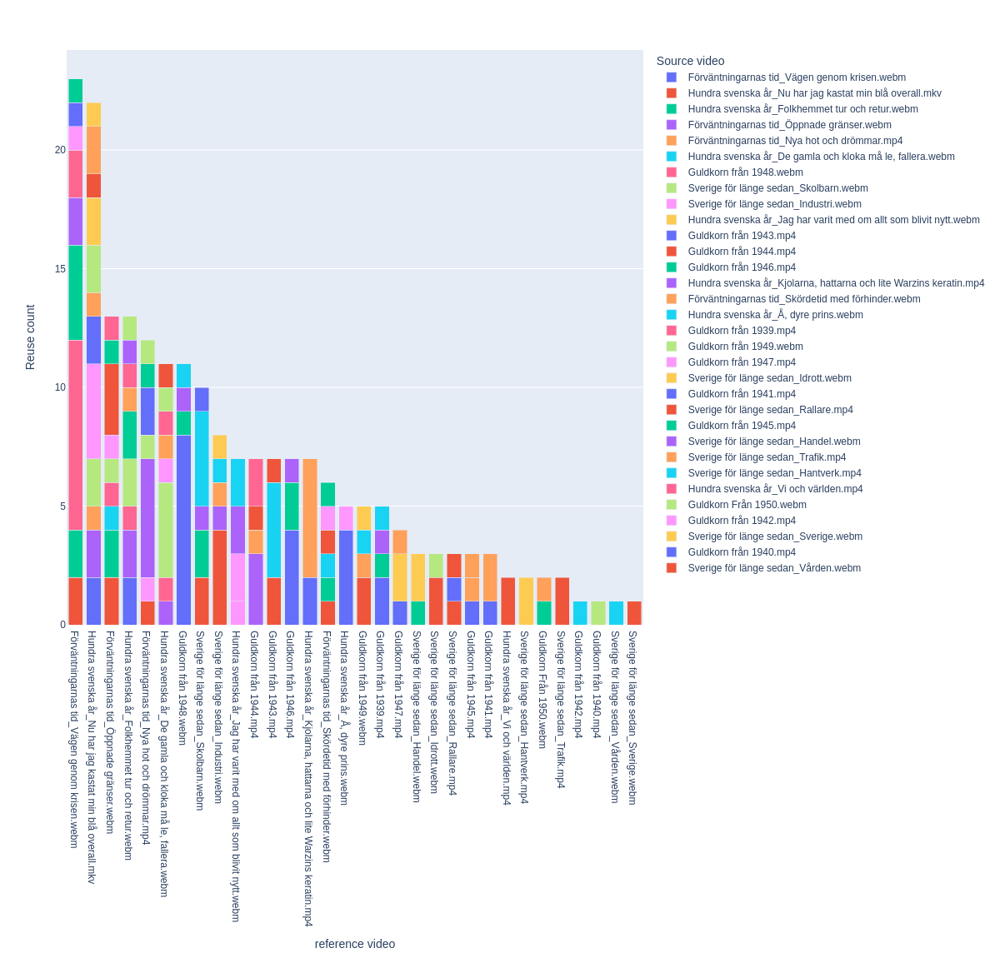

In [12]:
image_metadata("./media/plot_1.png", metadata="Plot showing the most reused TV serie episodes to the left. The reuse count refers to the number of identified sequences. To produce this chart, we searched for sequences that were at least 5 seconds long. We also applied a distance metric of 120 and allowed a maximum of two frames within each sequence to deviate from this threshold. All matches from the same video and TV series were removed from the search results. In addition, a series of manually identified unwanted frames had been removed. For details, see hermeneutics layer.")

Importantly, however, the plot above should not be read as an absolute proof of reuse, since it contains several mismatched sequences. These inaccurate sequences remain in our matching results since we intentionally decide not to apply harsher filtering settings, as this could risk filtering out correct matches (for further discussions on this topic, see the hermeneutics layer). In other words, the chart should be read as a tool for getting an overview of *where to start looking for* actual instances of reuse. Following this chart, we find an eight second long identical match between Häger's production and the transportation episode in *Sweden, A Long Time Ago*, featuring a sequence from 1913 with automobiles and trams in the city of Stockholm (figure 20). In the background of the footage a horse-drawn hearse suddenly appears – *fin de siècle* Stockholm was still a city with tens of thousands of horses (figure 21). Häger's voice-over comments on the hearse, steering the gaze towards the background of the image. 

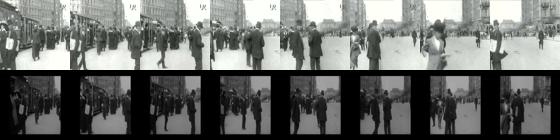

In [13]:
image_metadata("./media/hearse.jpeg", metadata="Automobiles and trams in Stockholm, with a hearse appearing in the background. Upper row: *Sweden, A Long Time Ago*, 'Traffic'. Start time 00:08:13. End time 00:08:21. Bottom row: *A Hundred Swedish Years*, 'Now I Have Discarded my Blue Overall'. Start time 00:03:07. End time 00:03:15")

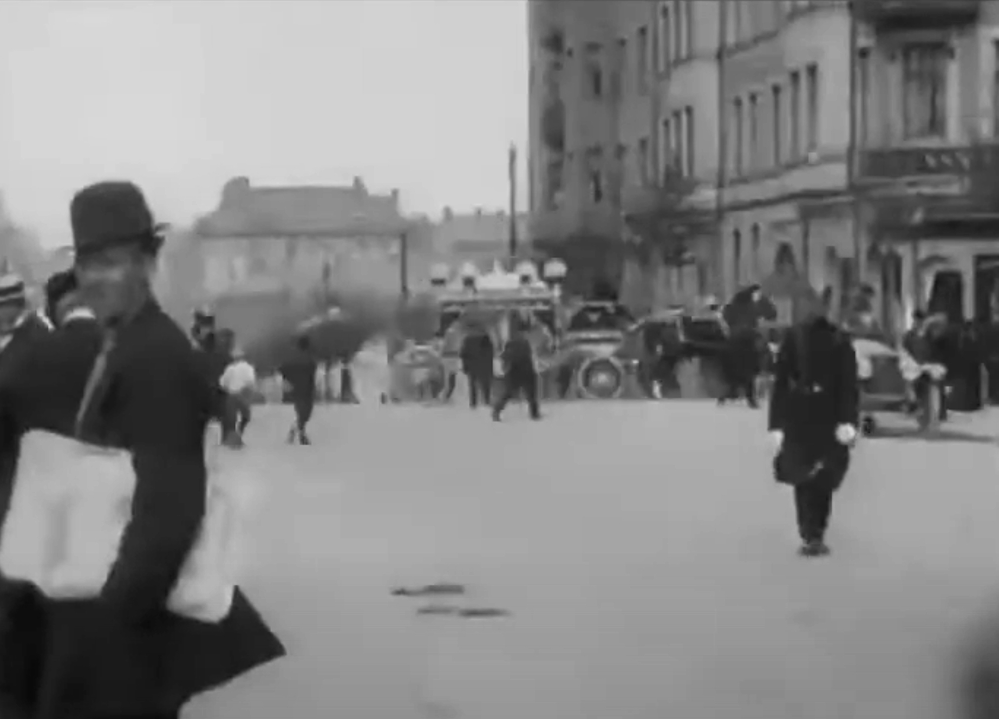

In [15]:
image_metadata("./media/hearse_enlargement.jpg", metadata="Frame enlargement of the horse-drawn hearse.")

Another match from his episode displays a similar pattern, namely a short sequence of some five seconds depicting the cinema Pariserteatern (on Roslagsgatan in Stockholm), footage which also appears in two episodes from Jan Bergman's *Sweden, A Long Time Ago* (figure 22). In one of Bergman's episodes, the focus is on education and children with Sweden's elementary school system being described as harsh: "so it was not surprising that children were dreamy, escaping from everyday life by going to the cinema", the voice-over states. In another of Bergman's episodes, focus is placed on leisure activities and the footage is used to exemplify how local cinema's provided a new source of entertainment and rapidly spread across the country. In contrast, Häger uses the identical sequence to suggest that the film operator at the cinema Pariserteatern (visible in a window above the entrance) only had a few minutes for himself, again guiding the viewer to a significant detail within the footage (figure 23). The point to be made is that even if these sequences are identical, by using a voice-over to accentuate different aspects within the footage, it is possible to alter its meaning significantly. Discovering how footage is re-contextualized and embedded in alternative meanings throughout time, is thus a good example of where the VRD can be of assistance. 

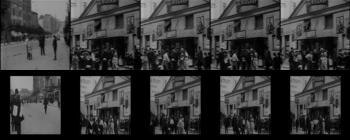

In [16]:
image_metadata("./media/cinema_1.jpeg", metadata="Cinema Paristeatern. Upper row: *Sweden A Long Time Ago*, 'School children'. Start time 00:14:00. End time 00:14:05. Bottom row: *A Hundred Swedish Years*, 'Now I Have Discarded my Blue Overall'. Start time 00:03:16. End time 00:03:21")              

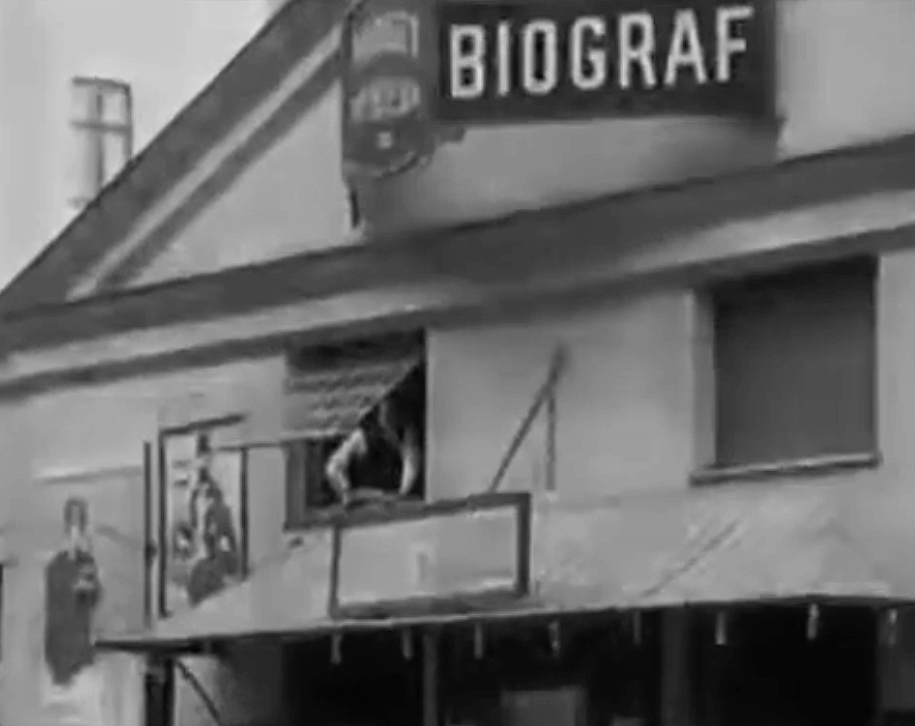

In [17]:
image_metadata("./media/cinema_enlargement.jpg", metadata="Frame enlargement of film operator seen in a window at the cinema Paristeatern.")

Then again, the VRD also indicates a false match with regards to the sequence with the film operator at Pariserteatern (figure 24). It is claimed that it resembles a six-second sequence of a factory in the series *Time of Expectations*. At first glance, the sequences do look familiar with people in the foreground of the image and a building with a diagonal shape in the center. But the sequences are in fact not identical at all. Hence, a word of caution should be raised regarding the plot above. When looking at the plot, it appears as if sequences from *A Hundred Swedish Years*, 'Now I have discarded my blue overall' (*Hundra svenska år,* 'Nu har jag kastat min blå overall') have been reused nearly 25 times. Upon closer inspection, however, several of these sequence matches are of doubtful quality. More precisely, 17 of the matched sequences are inaccurate and display things such as mismatched people, near-black frames, and frames depicting clouds or trees. This illustrates that plots such as the one shown in figure 19 may say a lot about the *quantity* of matches, but little about their *quality*.

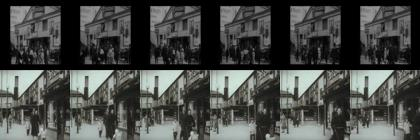

In [18]:
image_metadata("./media/cinema_2.jpeg", metadata="Cinema Paristeatern, although incorrectly matched. Upper row: *A Hundred Swedish Years*, 'Now I Have Discarded my Blue Overall'. Start time 00:13:17. End time 00:03:23. Bottom row: *Time of Expectations*, 'New Threats and Dreams'. Start time 00:48:16. End time 00:48:22." )

For instance, the VRD – and its underlying CNNs and ways of finding similarity neighbors using Faiss – sometimes suggests reuse regarding sequences that are of an abstract nature and depict environments, buildnings, streets etc. Such footage shares graphical similarities (like the cinema and the factory in the example above). Sometimes these matches are correct, as the almost symbolic curved road in a longer dolly shot, filmed from a car depicting sheep running along a village road in rural Sweden around 1910 (figure 25). This sequence appears in both Häger's *A Hundred Swedish Years* and Bergman's *Sweden, A Long Time Ago*. But at other times, comparable abstract scenes are totally dissimilar, even if the VRD defines the frames as looking alike: trees, clouds, or shots of the sky are three examples (figure 26), inserted sequences of books or newspapers another (figure 27). Close-ups of newspaper pages in *Gold Nuggets* and *Time of Expectations* are hence perceived as having a close visual similarity by the software – even if it is apparent to the human eye that these newspapers have nothing in common at all, other than being newspapers.

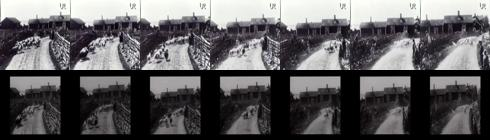

In [20]:
image_metadata("./media/road.jpeg", metadata="Dolly shot of a curved village road with sheep. Upper row: *Sweden, A Long Time Ago*, 'Handicrafts'. Start time 00:00:10. End time 00:00:17. Bottom row: *A Hundred Swedish Years*, 'Now I Have Experienced Everything that is New'. Start time 00:48:20. End time. 00:48:27.'. Start time 00:05:53. End time 00:06:03.")

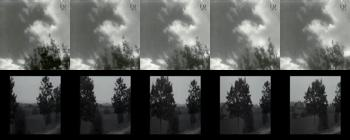

In [21]:
image_metadata("./media/trees.jpeg", metadata="Mismatched frames showing trees and clouds. Upper row: *Sweden, a long time ago*, 'Ralliers'. Start time 00:00:31. End time 00:00:36. Bottom row: *A Hundred Swedish Years*, 'Now I have discarded my blue overall'. Start time 00:12:55. End time 00:13:00.")

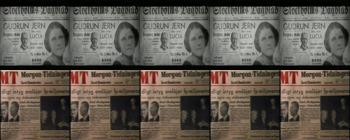

In [22]:
image_metadata("./media/newspaper.jpeg", metadata="Mismatched frames showing newspapers. Upper row: *A Hundred Swedish Years*, 'The Skirts, Hats and Some Warzin's Keratin'. Start time 00:12:53. End time 00:12:58. Bottom row: *Time of Expectations*, 'The Path Through the Crisis'. Start time 00:41:02. End time 00:41:07.")

To summarize, we can thus state that aside from a series of mismatched frames, the VRD has indeed helped us identify multiple instances of reuse within the televisual dataset, of which we have only highlighted and discussed a few in this narrative layer (for a closer look at the matching results, see hermeneutical layer). One conclusion to be drawn from the findings is that the producers of the selected TV series showcase a somewhat surprising tendency to reuse the same audiovisual content, despite having access to thousands of archival films at the television archive. It is apparent that some sequences have been particularly enticing for producers, especially those that depict the film medium *per se* (for example the cinema Pariserteatern). The same goes for striking footage of everyday life in the Swedish capital. As we have found the same audiovisual content reemerge in different TV series, we have also been able to start mapping how footage is assigned different meanings – particularly via sound. Early cinema was mute, but television documentaries nearly always added artificial sound, a distortion of sorts but also a way of altering the significance of the film footage. The VRD does not detect sound, but as we have shown it can be used to highlight how sound changes filmic intentions at scale. Undoubtedly, the task of manually watching and comparing each frame in these 35 episodes (roughly 30 hours of television) would have been insurmountable for any single human being, let alone a modestly sized research team. This will only become more apparent as we compare the televisual dataset with the 1,400 selected newsreels and short films from the SF-archive, a step that will increase the number of potentially matching frames exponentially.

### Reuse in the TV and SF dataset

Next, we explore visual similarities between the televisual dataset and the SF dataset, without searching for examples of reuse within the SF dataset as such. Put simply, we are not interested in studying internal reuse in the SF archive, since all likely such reuse was modest, occurring primarily when Swedish Film Industry produced documentaries or short films of past notable events – as when SF in 1956 celebrated one of its cinematographers, [Gustaf Boge](https://www.filmarkivet.se/movies/gustaf-boges-samling-nr-1/), having worked for the company during 35 years. We hence decided to focus our efforts on exploring which footage from the SF-archive was reused in the aforementioned television series. As stated, the SF dataset is considerably larger than the televisual dataset, and to perform this kind of similarity search we first had to create two sets of indexed fingerprints. Secondly, we combined the datasets and used Faiss to calculate the closest similarity neighbors between the two. Since the TV dataset had already been fingerprinted and indexed, we were able to reuse previous data, but still needed to process the videos from the SF dataset.

We begin by starting a second project called "sf_archive" and extract one frame per second from the SF dataset. Again, we apply the neural network EfficientNetB4 in our analysis.

In [59]:
from pathlib import Path
SF_dataset_project = vrd_project.VRDProject(
    name = 'sf_archive', 
    project_base_path=f"/home/jovyan/work/notebooks/projects/",
    video_path = f'{video_source_base_folder}/from_pelle',
    network = neural_networks.NeuralNetworks.efficientnetb4,
    additional_video_extensions = ['.webm', '.mpg'])
SF_dataset_project.initialize_frame_extractor()

# The folders contains additional directories, which cannot be moved.
# Only retain videos from the wanted directory.
fixed_frames = [x for x in SF_dataset_project.frame_extractor.all_images if x.startswith('/home/jovyan/work/notebooks/projects/sf_archive/frames/sf/sf2')]
file_names = set()
for f in fixed_frames:
    p = Path(f)
    file_names.add(p.name.split('_frame_')[0])    
SF_dataset_project.frame_extractor.video_list = list(file_names)
SF_dataset_project.frame_extractor.all_images = fixed_frames
print_project_frame_extractor_info(SF_dataset_project)

  0%|          | 0/5457 [00:00<?, ?it/s]

For project "sf_archive":
Number of video files: 1369
Number of frames extracted: 895286



Next, we compress and vectorize the extracted frames into fingerprints using the selected CNN.

In [60]:
# SF_dataset_project.populate_fingerprint_database()

We index the fingerprints using Faiss. 

In [ ]:
SF_dataset_project.initialize_faiss_index(force_recreate=False)

And then combine the two projects using the `combine_projects` feature. This will initialize the use of Faiss to  calculate the most similar neighbours between the indexed fingerprints in SF dataset and TV dataset.

In [ ]:
combined_project = vrd_project.combine_projects(SF_dataset_project, TV_dataset_project, name='reference_vs_tv_series')

When the similarity neighbors have been calculated, we look at a histogram of the distances metric value distribution and use it to determine a reasonable threshold for finding sequences.

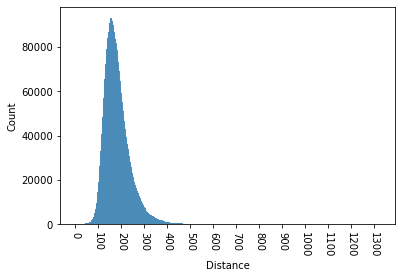

In [63]:
combined_project.neighbours.get_distance_histogram(halfway_x_ticks=True);

Based on the data shown in the histogram above, we decide to apply the distance metric threshold 120 and filter out all matching results from the same video. We also decide to only search for sequences that are at least five seconds long, and allow a skip rate of 2 frames per sequence. As can be seen in the statistics below, this reduces our dataset from 10 670 to 1983 found sequences.

In [64]:
combined_project_finder = SequenceFinder(combined_project.neighbours, 
                                         max_distance=120
)
combined_project_finder.filter_matches_from_same_video()
combined_project_sequences = combined_project_finder.find_sequences(shortest_sequence=5, allow_skip=2,combine_overlap=True)
len(combined_project_sequences)

984455
Maximum index found: 984454


  0%|          | 0/89169 [00:00<?, ?it/s]

Number of bytes required: 7875640
Removing neighbours from same video...


  0%|          | 0/1403 [00:00<?, ?it/s]

Removed 0 entries (0.00%)!
Merged from 10670 to 1983 sequences


1983

Using the same rationale as before, we filter out the same sequences that were labeled as unwanted in the TV dataset. Since we will only match the TV dataset against the SF dataset - and not search for any examples of reuse within the SF dataset as such - the removal of these frames should be enough to clean the search results. Note, however, that if any real reuse of unwanted frames has occurred (for instance, reuse of footage containing talking heads), these sequences will be lost from the matching results. As can be seen in the statistics below the code cell, this reduces the number of found sequences from 1983 to 1553. 

In [65]:
before_set_combined = set(combined_project_sequences)
SequenceFinder.remove_unwanted_sequences(combined_project_sequences, combined_project, 'TV_unwanted_frames.xlsx')
after_set_combined = set(combined_project_sequences)
print(f'Before removal: {len(before_set_combined)} sequences.\nAfter removal: {len(after_set_combined)} sequences.\n({(len(before_set_combined)-len(after_set_combined)) / len(before_set_combined)*100:.2f}% removed)')

Before removal: 1983 sequences.
After removal: 1553 sequences.
(21.68% removed)


To double-check what sequences were removed in the previous step, we output a sample of 50 sequences that were removed using `remove_unwanted_sequences` functionality.

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1941.mp4,00:34:38,00:35:21,43,921340,75.451225,4
SF2794.1.mpg,00:06:55,00:07:38,43,688487,75.451225,4


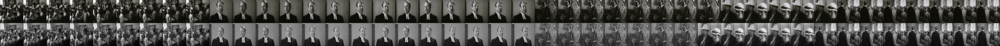

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Förväntningarnas tid_Vägen genom krisen.webm,00:14:56,00:15:27,31,902866,98.425964,12
SF2997A-E.1.mpg,00:23:58,00:24:29,31,888940,98.425964,12


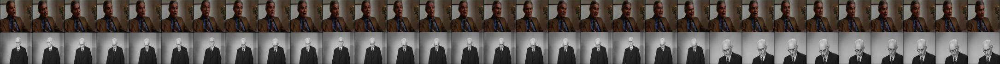

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1946.mp4,00:47:13,00:47:44,31,941389,104.821907,10
SF2601.1.mpg,00:01:36,00:02:07,31,520186,104.821907,10


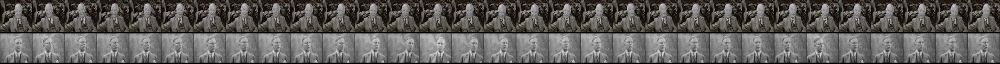

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1949.webm,00:36:42,00:37:12,30,950994,109.140099,18
SF2824.1.mpg,00:10:34,00:11:04,30,714977,109.140099,18


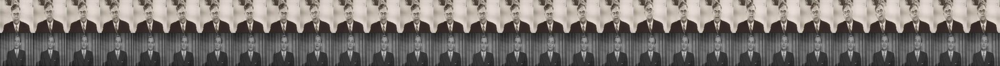

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1949.webm,00:36:42,00:37:12,30,950994,90.998489,15
SF2997A-E.1.mpg,00:23:58,00:24:28,30,888940,90.998489,15


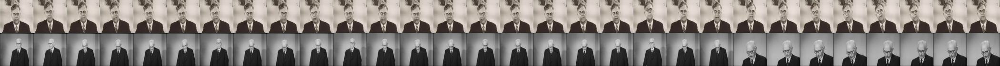

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1949.webm,00:36:42,00:37:12,30,950994,103.157272,3
SF2824.1.mpg,00:00:54,00:01:24,30,714397,103.157272,3


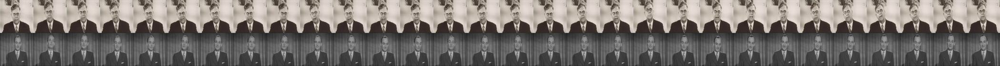

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Förväntningarnas tid_Vägen genom krisen.webm,00:14:56,00:15:26,30,902866,114.876228,18
SF2824.1.mpg,00:00:54,00:01:24,30,714397,114.876228,18


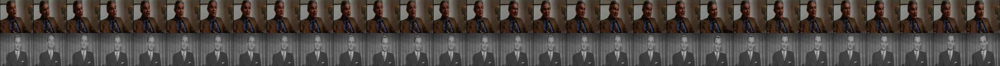

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Förväntningarnas tid_Vägen genom krisen.webm,00:14:56,00:15:25,29,902866,96.028160,6
SF2997A-E.1.mpg,00:24:37,00:25:06,29,888979,96.028160,6


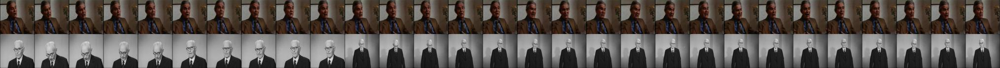

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1941.mp4,00:34:38,00:35:06,28,921340,101.156525,19
SF2601.1.mpg,00:00:43,00:01:11,28,520133,101.156525,19


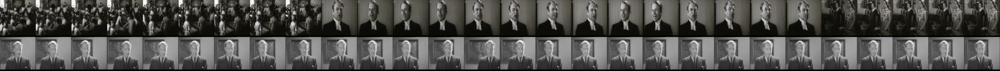

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1949.webm,00:36:42,00:37:08,26,950994,75.643166,1
SF2997A-E.1.mpg,00:24:40,00:25:06,26,888982,75.643166,1


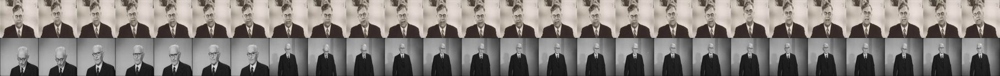

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1949.webm,00:36:42,00:37:07,25,950994,111.576645,8
SF2824.1.mpg,00:02:52,00:03:17,25,714515,111.576645,8


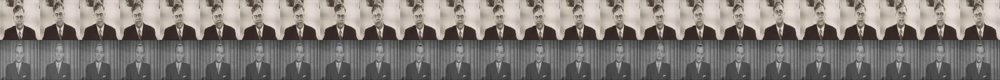

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Förväntningarnas tid_Öppnade gränser.webm,00:29:19,00:29:44,25,907262,59.076576,3
SF2925F.1.mpg,00:00:06,00:00:31,25,824421,59.076576,3


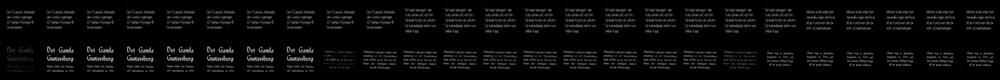

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:23:52,00:24:14,22,956690,100.512985,14
SF2017.1.mpg,00:03:07,00:03:29,22,12696,100.512985,14


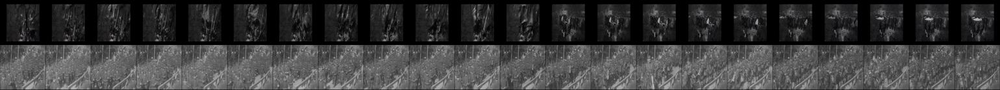

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Förväntningarnas tid_Vägen genom krisen.webm,00:33:42,00:34:03,21,903992,82.185028,0
SF2997A-E.1.mpg,00:23:58,00:24:19,21,888940,82.185028,0


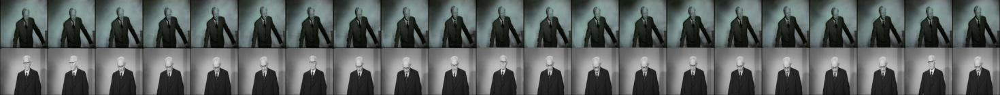

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Förväntningarnas tid_Vägen genom krisen.webm,00:33:42,00:34:03,21,903992,82.669540,3
SF2997A-E.1.mpg,00:24:43,00:25:04,21,888985,82.669540,3


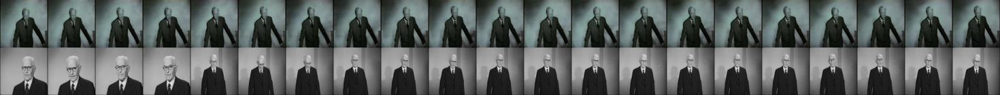

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Förväntningarnas tid_Nya hot och drömmar.mp4,00:09:38,00:09:58,20,895864,106.229736,3
SF2601.1.mpg,00:00:43,00:01:03,20,520133,106.229736,3


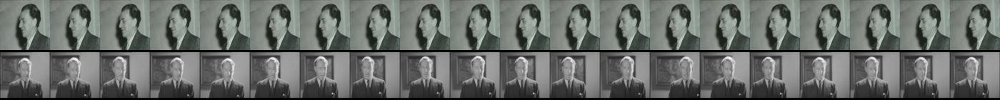

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:13:36,00:13:55,19,966713,90.159531,1
SF2997A-E.1.mpg,00:24:42,00:25:01,19,888984,90.159531,1


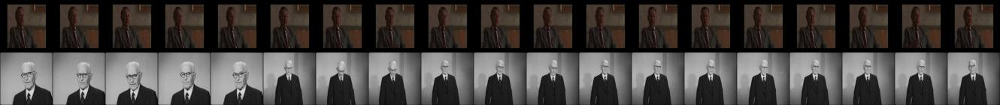

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:13:36,00:13:55,19,966713,111.935982,12
SF2824.1.mpg,00:00:54,00:01:13,19,714397,111.935982,12


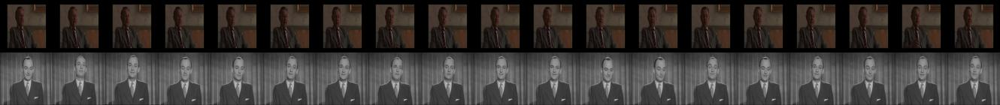

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:13:36,00:13:55,19,966713,89.121521,0
SF2997A-E.1.mpg,00:23:59,00:24:18,19,888941,89.121521,0


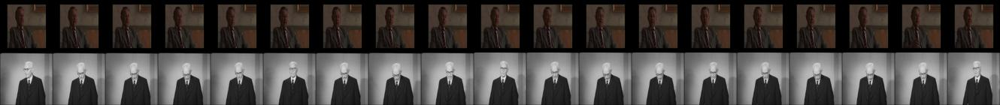

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_De gamla och kloka må le, fallera.webm",00:22:51,00:23:09,18,953618,113.886963,11
SF2997A-E.1.mpg,00:24:43,00:25:01,18,888985,113.886963,11


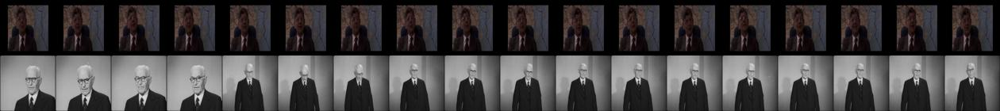

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Förväntningarnas tid_Nya hot och drömmar.mp4,00:09:38,00:09:56,18,895864,115.720520,11
SF2805.1.mpg,00:00:03,00:00:21,18,696170,115.720520,11


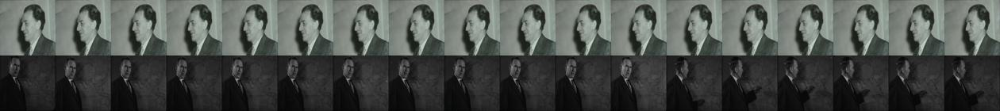

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1949.webm,00:36:42,00:37:00,18,950994,106.872856,7
SF2655.1.mpg,00:12:23,00:12:41,18,583266,106.872856,7


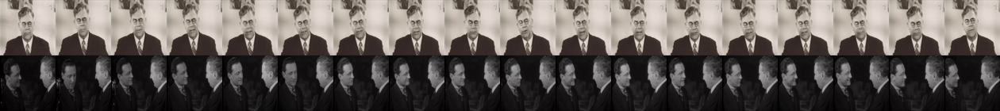

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1941.mp4,00:34:38,00:34:55,17,921340,101.932968,12
SF2655.1.mpg,00:12:24,00:12:41,17,583267,101.932968,12


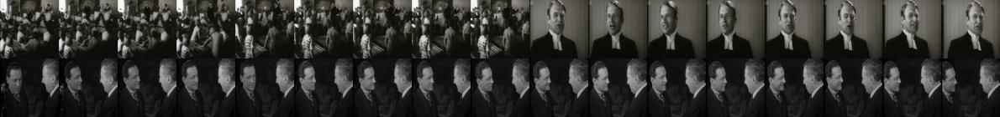

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:32:37,00:32:54,17,957215,85.481979,4
SF2554.1.mpg,00:10:27,00:10:44,17,483942,85.481979,4


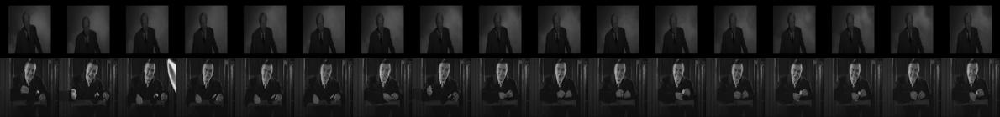

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_De gamla och kloka må le, fallera.webm",00:34:01,00:34:18,17,954288,112.943130,12
SF2655.1.mpg,00:02:44,00:03:01,17,582687,112.943130,12


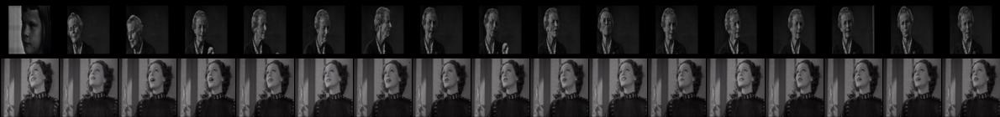

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Industri.webm,00:05:43,00:06:00,17,977325,80.110313,8
SF2868A-E.1.mpg,00:06:06,00:06:23,17,767703,80.110313,8


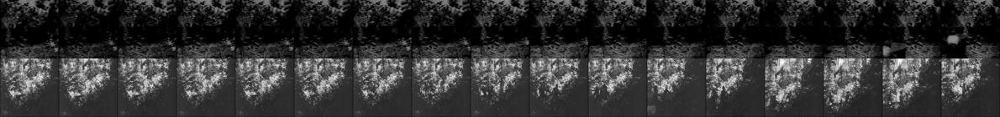

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1946.mp4,00:48:11,00:48:28,17,941447,103.629311,8
SF2410A-C.1.mpg,00:09:45,00:10:02,17,339605,103.629311,8


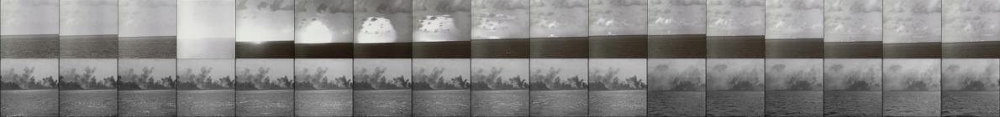

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:32:37,00:32:54,17,957215,88.605789,1
SF2789.1.mpg,00:13:37,00:13:54,17,685294,88.605789,1


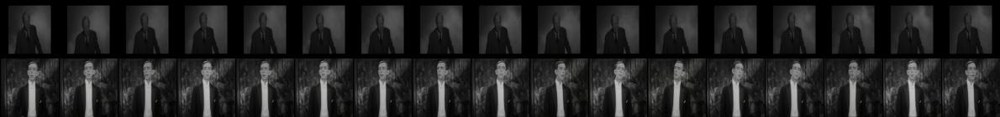

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Förväntningarnas tid_Nya hot och drömmar.mp4,00:00:14,00:00:31,17,895300,103.378166,5
SF2410A-C.1.mpg,00:09:45,00:10:02,17,339605,103.378166,5


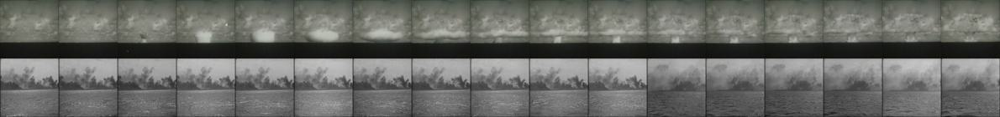

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_De gamla och kloka må le, fallera.webm",00:34:01,00:34:18,17,954288,108.193596,11
SF2789.1.mpg,00:06:35,00:06:52,17,684872,108.193596,11


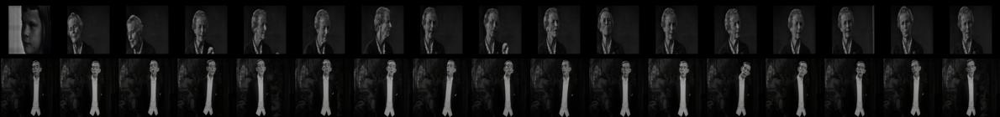

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1946.mp4,00:47:54,00:48:10,16,941430,110.538353,10
SF2601.1.mpg,00:02:35,00:02:51,16,520245,110.538353,10


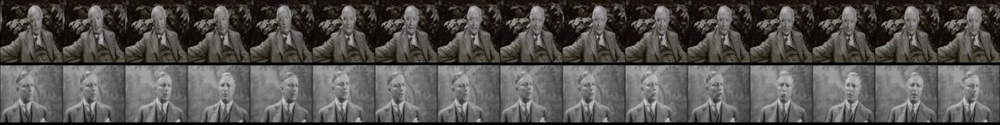

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Förväntningarnas tid_Skördetid med förhinder.webm,00:41:14,00:41:30,16,901009,109.655739,13
SF2805.1.mpg,00:00:31,00:00:47,16,696198,109.655739,13


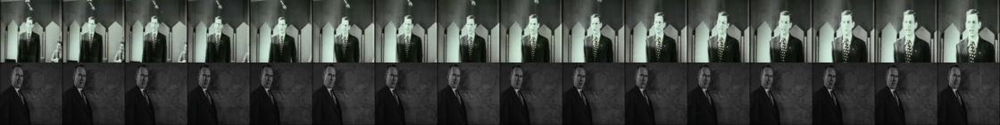

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1946.mp4,00:47:54,00:48:10,16,941430,110.156898,2
SF2997A-E.1.mpg,00:23:58,00:24:14,16,888940,110.156898,2


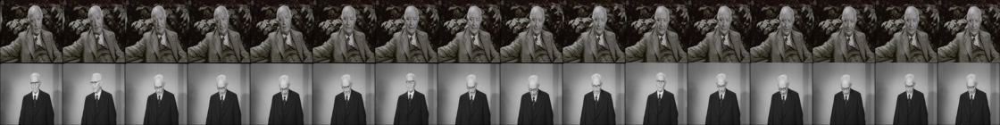

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:32:37,00:32:53,16,957215,89.325447,5
SF2554.1.mpg,00:10:10,00:10:26,16,483925,89.325447,5


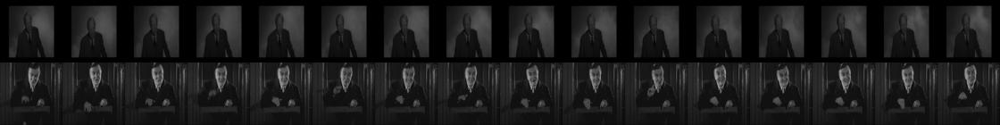

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:19:48,00:20:04,16,967085,106.321663,12
SF2670A-D.1.mpg,00:11:10,00:11:26,16,599628,106.321663,12


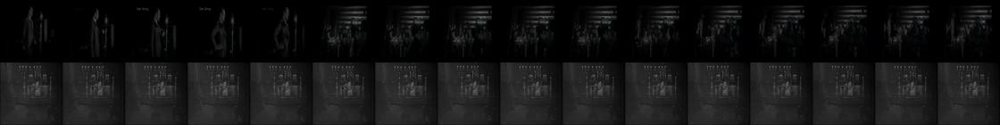

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1946.mp4,00:47:54,00:48:10,16,941430,105.680206,7
SF2997A-E.1.mpg,00:24:43,00:24:59,16,888985,105.680206,7


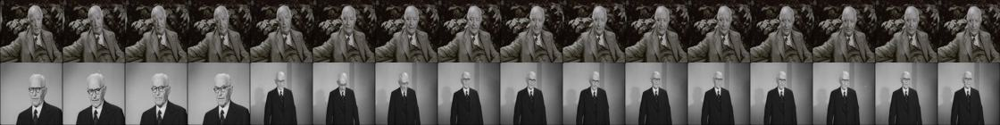

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:32:37,00:32:52,15,957215,86.838470,5
SF2805.1.mpg,00:00:31,00:00:46,15,696198,86.838470,5


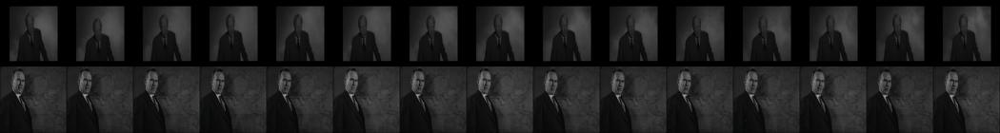

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_De gamla och kloka må le, fallera.webm",00:34:37,00:34:52,15,954324,105.079651,7
SF2789.1.mpg,00:06:35,00:06:50,15,684872,105.079651,7


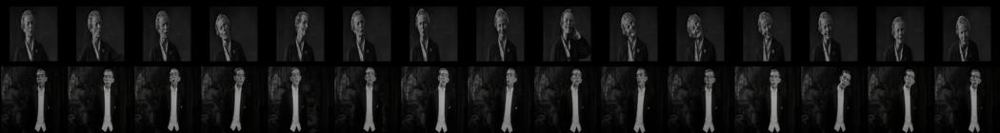

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:29:47,00:30:02,15,967684,101.224869,11
SF2824.1.mpg,00:00:56,00:01:11,15,714399,101.224869,11


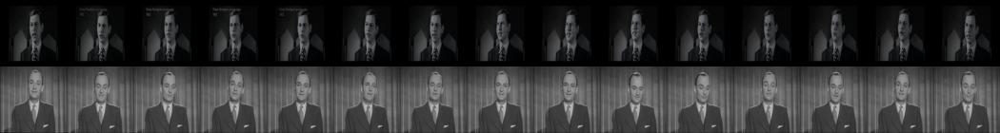

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1946.mp4,00:47:13,00:47:28,15,941389,109.147285,8
SF2553A.1.mpg,00:08:26,00:08:41,15,482641,109.147285,8


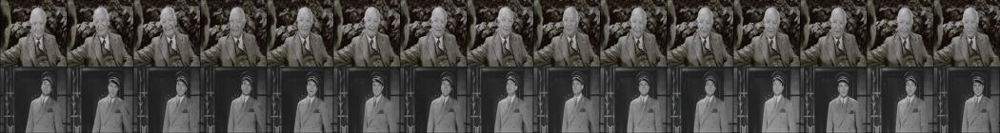

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_De gamla och kloka må le, fallera.webm",00:10:02,00:10:17,15,952849,109.414810,5
SF2831A-C.1.mpg,00:20:10,00:20:25,15,721228,109.414810,5


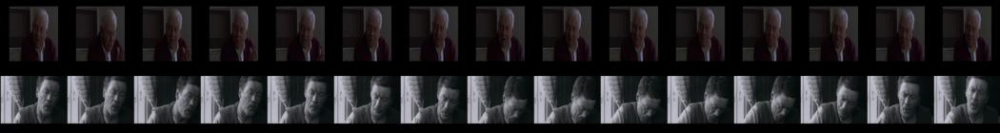

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:23:52,00:24:07,15,956690,95.676910,13
SF2868A-E.1.mpg,00:06:12,00:06:27,15,767709,95.676910,13


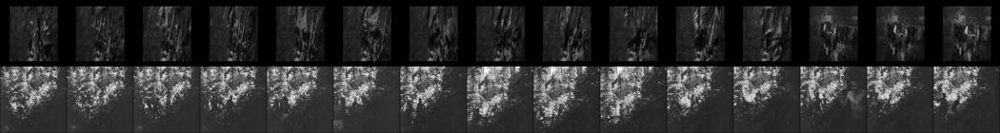

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1941.mp4,00:34:38,00:34:53,15,921340,111.471863,11
SF2805.1.mpg,00:00:32,00:00:47,15,696199,111.471863,11


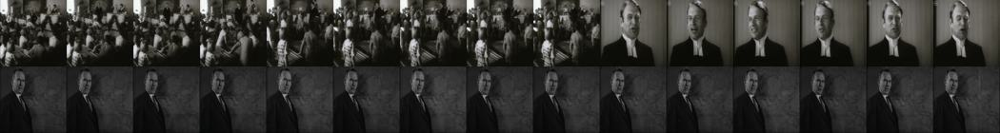

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:29:47,00:30:02,15,967684,101.412682,3
SF2655.1.mpg,00:12:25,00:12:40,15,583268,101.412682,3


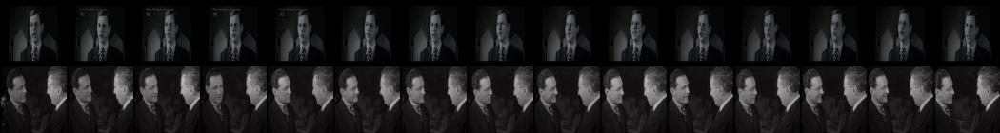

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_De gamla och kloka må le, fallera.webm",00:10:02,00:10:17,15,952849,112.452682,5
SF2742A.1.mpg,00:01:18,00:01:33,15,655813,112.452682,5


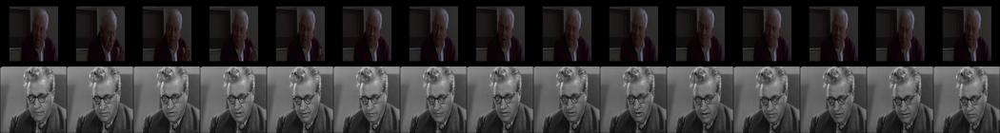

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Å, dyre prins.webm",00:36:52,00:37:07,15,973135,102.814865,7
SF2655.1.mpg,00:12:26,00:12:41,15,583269,102.814865,7


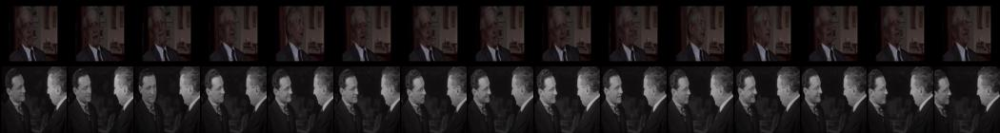

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_De gamla och kloka må le, fallera.webm",00:10:02,00:10:17,15,952849,99.250999,4
SF2831A-C.1.mpg,00:17:38,00:17:53,15,721076,99.250999,4


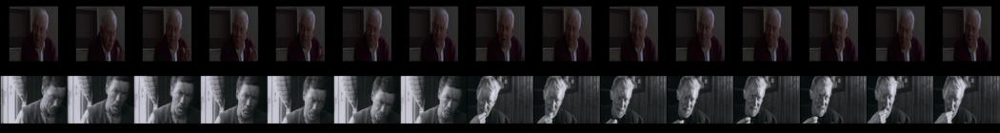

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1946.mp4,00:47:54,00:48:09,15,941430,110.028374,6
SF2553A.1.mpg,00:08:26,00:08:41,15,482641,110.028374,6


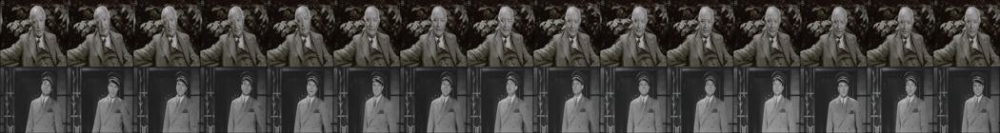

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_De gamla och kloka må le, fallera.webm",00:34:37,00:34:52,15,954324,105.008766,10
SF2789.1.mpg,00:13:37,00:13:52,15,685294,105.008766,10


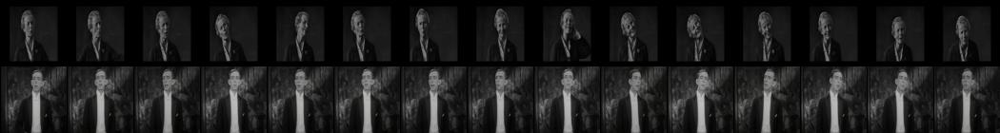

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1941.mp4,00:34:38,00:34:52,14,921340,99.213013,13
SF2805.1.mpg,00:00:08,00:00:22,14,696175,99.213013,13


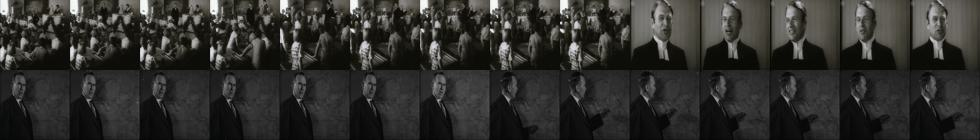

In [66]:
combined_project_finder.show_notebook_sequence(before_set_combined.difference(after_set_combined), show_limit=50, show_shift=False, frame_resize=(70,70), convert_format='JPEG')

Looking at these thumbnails, we notice that at least one accurate match has been removed. This concerns the first sequence shown above. Other than that, however, the removed sequences do seem to contain a large number of wrongly matched talking heads, or uninteresting frames.

We look at the remaining matching results in a stacked bar plot.

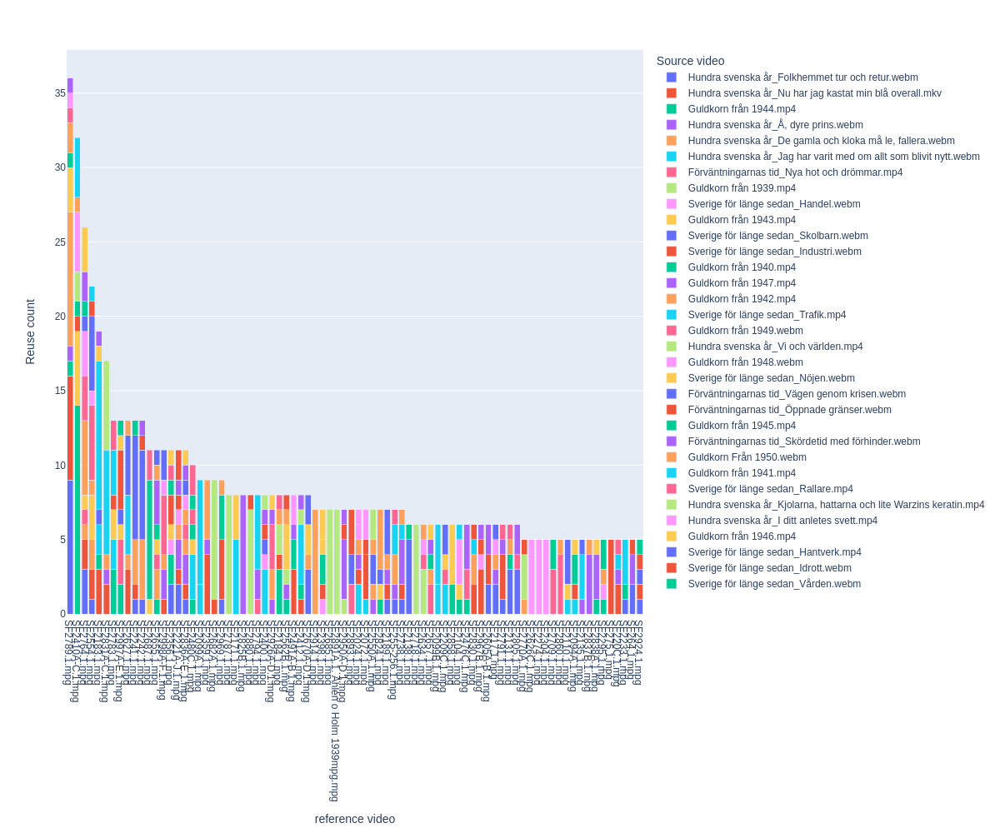

In [67]:
combined_project.show_most_reused_files(combined_project_sequences, video_list=TV_dataset_project.frame_extractor.video_list,size=(1200, 1000))

As can be seen in this plot, footage from the video SF27891.1 appears to have been reused the most amount of times, as over 35 sequences from the video have been identified in 11 of the TV series episodes. More than 15 matching sequences have also been found in the videos entitled SF2410A-C.1, 2764.1, 2554.1, 2183.1, and 2831.A-C.1. We take note of these video clips and will return to them later. 

We also output the matching results as thumbnail previews, sorted with the longest found sequence first. We limit the number of shown matching results to the 200 longest sequences. To enlarge the thumbnail previews when the notebook is viewed in Jupyter Notebooks, it is possible to double-click on the sequences. In the Journal of Digital History's rendering of the text, it is possible to zoom in on the thumbnails by opening them in a separate window by right-clicking on the images, or copying/pasting the link into a new browser window, for example. 

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1942.mp4,00:10:06,00:12:04,118,923377,56.226704,17
SF2914.1.mpg,00:08:44,00:10:42,118,815376,56.226704,17


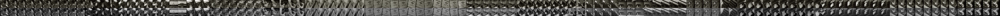

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1942.mp4,00:07:09,00:08:31,82,923200,69.738831,53
SF2914.1.mpg,00:04:26,00:05:48,82,815118,69.738831,53


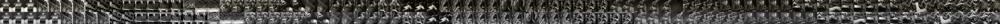

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1942.mp4,00:05:45,00:07:05,80,923116,60.305912,11
SF2914.1.mpg,00:02:17,00:03:37,80,814989,60.305912,11


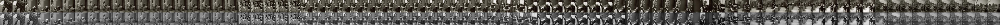

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1942.mp4,00:08:38,00:09:54,76,923289,60.310738,7
SF2914.1.mpg,00:05:57,00:07:13,76,815209,60.310738,7


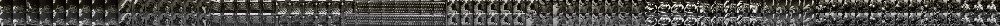

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1939.mp4,00:21:03,00:22:06,63,913542,76.565796,12
SF2908.1.mpg,00:05:27,00:06:30,63,809048,76.565796,12


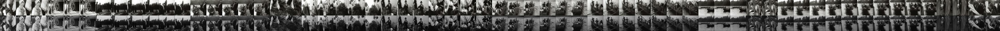

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1939.mp4,00:22:11,00:23:09,58,913610,95.022957,23
SF2908.1.mpg,00:06:35,00:07:33,58,809116,95.022957,23


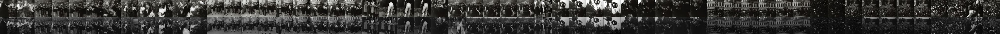

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Nöjen.webm,00:10:16,00:11:14,58,978667,93.224342,14
SF2171.1.mpg,00:05:21,00:06:19,58,124978,93.224342,14


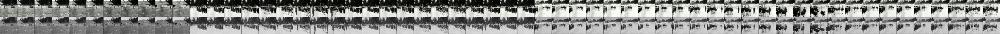

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1942.mp4,00:04:54,00:05:44,50,923065,52.389378,5
SF2914.1.mpg,00:00:21,00:01:11,50,814873,52.389378,5


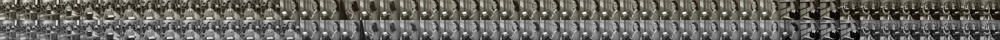

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1939.mp4,00:20:09,00:20:58,49,913488,84.219406,14
SF2908.1.mpg,00:04:33,00:05:22,49,808994,84.219406,14


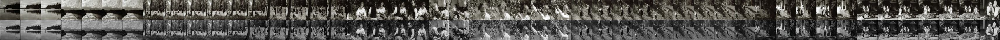

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1939.mp4,00:05:21,00:06:09,48,912600,57.845322,5
SF2891A.1. Åhlen o Holm 1939mpg.mpg,00:05:46,00:06:34,48,786031,57.845322,5


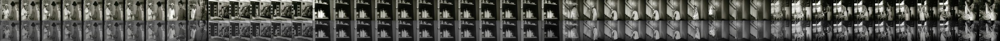

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1939.mp4,00:16:16,00:17:03,47,913255,76.669266,9
SF2685.1.mpg,00:02:41,00:03:28,47,615531,76.669266,9


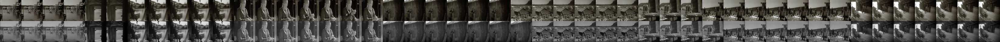

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1939.mp4,00:11:46,00:12:31,45,912985,83.681335,25
SF2880.1.mpg,00:00:00,00:00:45,45,778198,83.681335,25


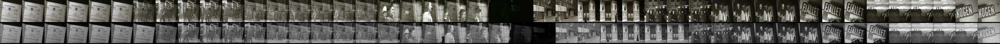

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Trafik.mp4,00:12:18,00:13:02,44,983050,93.602379,17
SF2171.1.mpg,00:09:06,00:09:50,44,125203,93.602379,17


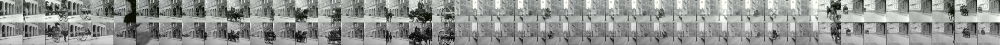

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1940.mp4,00:25:38,00:26:21,43,917321,86.894432,21
SF2687.1.mpg,00:09:23,00:10:06,43,616993,86.894432,21


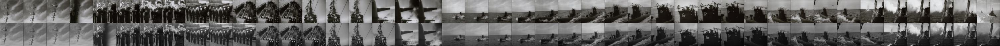

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1939.mp4,00:34:38,00:35:17,39,914357,73.552811,12
SF2682A.1.mpg,00:01:36,00:02:15,39,612719,73.552811,12


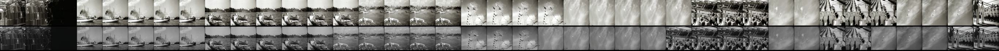

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1939.mp4,00:03:14,00:03:52,38,912473,82.992157,8
SF2891A.1. Åhlen o Holm 1939mpg.mpg,00:01:43,00:02:21,38,785788,82.992157,8


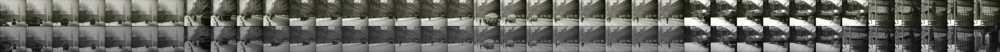

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1939.mp4,00:13:46,00:14:24,38,913105,79.497665,3
SF2880.1.mpg,00:03:28,00:04:06,38,778406,79.497665,3


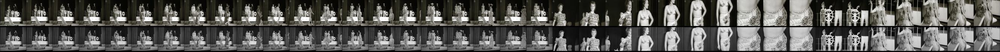

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1939.mp4,00:17:21,00:17:59,38,913320,70.479393,0
SF2685.1.mpg,00:05:40,00:06:18,38,615710,70.479393,0


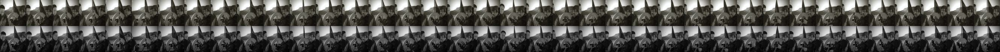

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1947.mp4,00:28:55,00:29:32,37,943731,92.652832,4
SF2825B.1.mpg,00:04:29,00:05:06,37,715778,92.652832,4


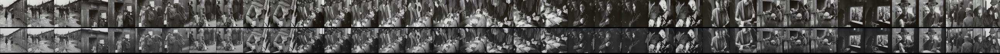

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_De gamla och kloka må le, fallera.webm",00:04:03,00:04:40,37,952490,88.195404,25
SF217.1.mpg,00:09:21,00:09:58,37,123903,88.195404,25


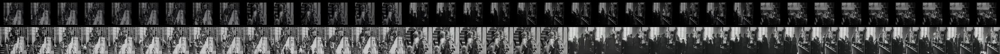

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1939.mp4,00:03:54,00:04:30,36,912513,50.344997,0
SF2891A.1. Åhlen o Holm 1939mpg.mpg,00:03:28,00:04:04,36,785893,50.344997,0


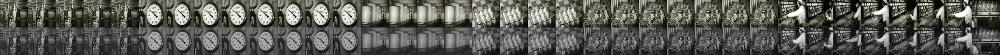

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1939.mp4,00:45:25,00:46:00,35,915004,95.372627,10
SF2718.1.mpg,00:08:54,00:09:29,35,640110,95.372627,10


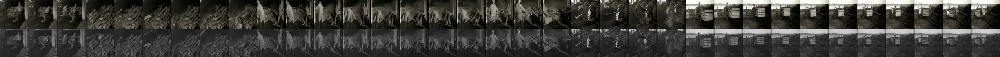

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Skolbarn.webm,00:03:03,00:03:37,34,980328,85.450867,6
SF2242.1.mpg,00:02:21,00:02:55,34,187366,85.450867,6


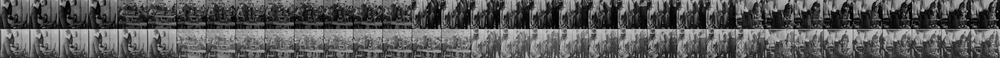

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1939.mp4,00:13:13,00:13:45,32,913072,84.782234,3
SF2880.1.mpg,00:02:32,00:03:04,32,778350,84.782234,3


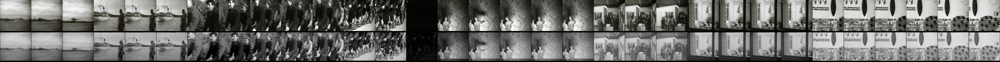

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1939.mp4,00:04:43,00:05:13,30,912562,71.237610,9
SF2891A.1. Åhlen o Holm 1939mpg.mpg,00:04:49,00:05:19,30,785974,71.237610,9


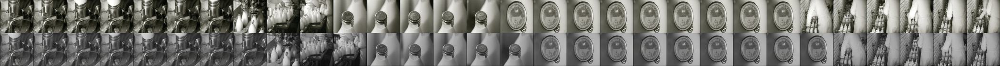

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1939.mp4,00:46:07,00:46:36,29,915046,78.378021,11
SF2718.1.mpg,00:09:57,00:10:26,29,640173,78.378021,11


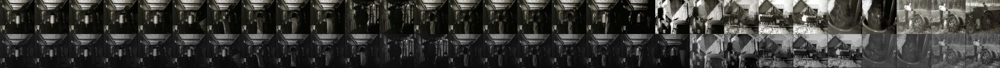

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Skolbarn.webm,00:15:52,00:16:21,29,981097,91.764587,26
SF2138.1.mpg,00:06:57,00:07:26,29,100836,91.764587,26


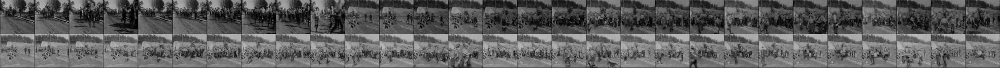

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1941.mp4,00:33:56,00:34:24,28,921298,88.743309,5
SF2794.1.mpg,00:01:22,00:01:50,28,688154,88.743309,5


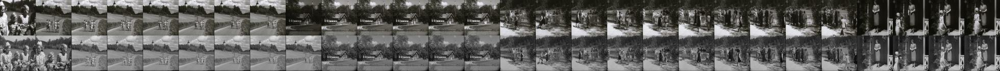

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Handel.webm,00:11:40,00:12:08,28,974564,96.281219,12
SF267.1.mpg,00:03:42,00:04:10,28,598437,96.281219,12


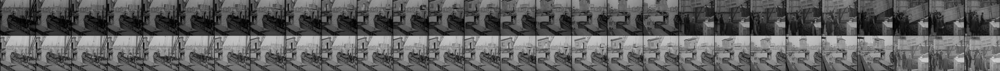

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Trafik.mp4,00:17:20,00:17:47,27,983352,91.839058,18
SF2183.1.mpg,00:10:31,00:10:58,27,133227,91.839058,18


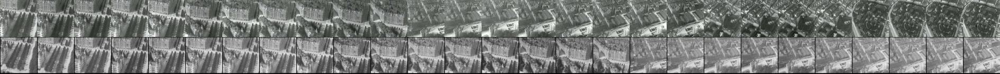

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Handel.webm,00:12:18,00:12:44,26,974602,98.521385,11
SF2209A.1.mpg,00:01:46,00:02:12,26,151314,98.521385,11


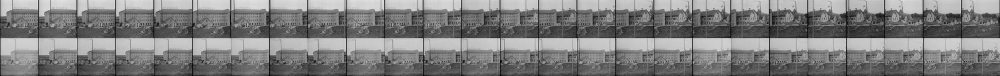

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Handel.webm,00:15:40,00:16:05,25,974804,97.920235,16
SF2265.1.mpg,00:06:42,00:07:07,25,205363,97.920235,16


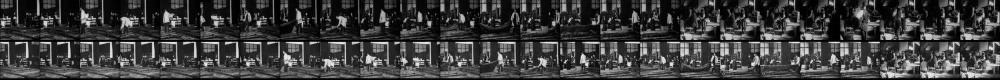

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Handel.webm,00:17:08,00:17:33,25,974892,93.782288,13
SF2304.1.mpg,00:12:28,00:12:53,25,241502,93.782288,13


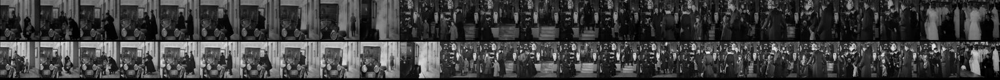

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1939.mp4,00:33:36,00:34:00,24,914295,95.200233,15
SF2682A.1.mpg,00:00:33,00:00:57,24,612656,95.200233,15


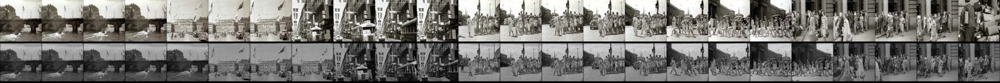

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Å, dyre prins.webm",00:03:52,00:04:16,24,971155,81.691032,11
SF2129.1.mpg,00:02:39,00:03:03,24,94304,81.691032,11


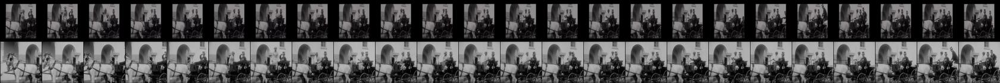

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1939.mp4,00:15:49,00:16:12,23,913228,71.239296,12
SF2685.1.mpg,00:01:22,00:01:45,23,615452,71.239296,12


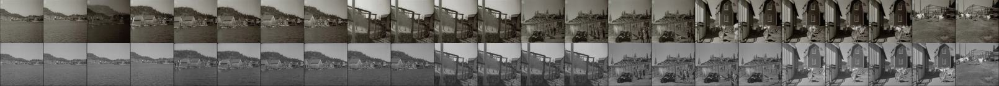

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:06:04,00:06:26,22,955622,107.429359,16
SF2017.1.mpg,00:03:10,00:03:32,22,12699,107.429359,16


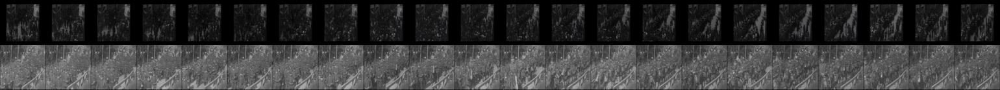

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Förväntningarnas tid_Nya hot och drömmar.mp4,00:35:44,00:36:05,21,897430,104.427605,12
SF2601.1.mpg,00:00:43,00:01:04,21,520133,104.427605,12


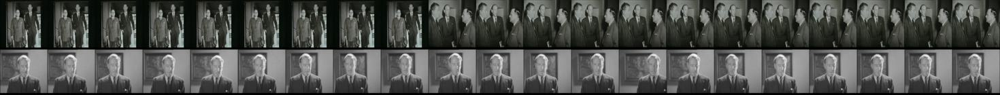

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Å, dyre prins.webm",00:06:25,00:06:46,21,971308,99.447853,11
SF2221A-J.1.mpg,00:30:52,00:31:13,21,169552,99.447853,11


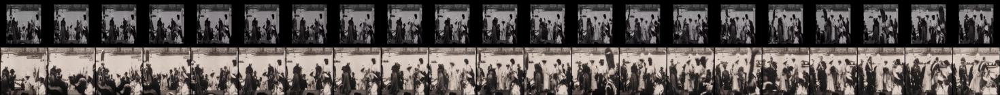

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Handel.webm,00:03:17,00:03:38,21,974061,88.864342,1
SF2050.1.mpg,00:05:33,00:05:54,21,35567,88.864342,1


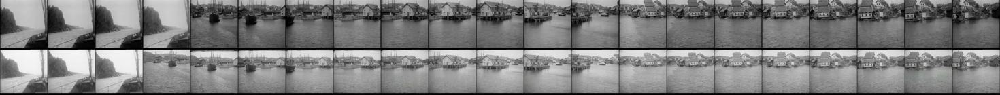

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1939.mp4,00:15:24,00:15:44,20,913203,81.614304,5
SF2685.1.mpg,00:00:34,00:00:54,20,615404,81.614304,5


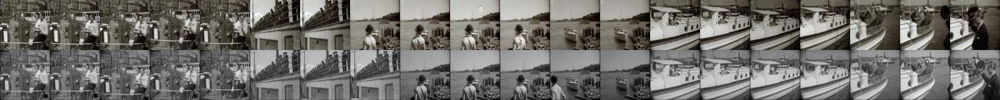

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1939.mp4,00:44:37,00:44:57,20,914956,88.384430,4
SF2718.1.mpg,00:06:41,00:07:01,20,639977,88.384430,4


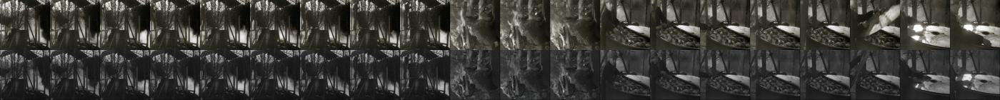

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1940.mp4,00:16:07,00:16:27,20,916750,111.948196,13
SF2886.1.mpg,00:06:38,00:06:58,20,782990,111.948196,13


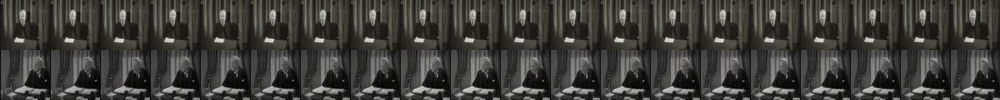

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Handel.webm,00:08:46,00:09:06,20,974390,115.262207,19
SF2826.1.mpg,00:03:37,00:03:57,20,716312,115.262207,19


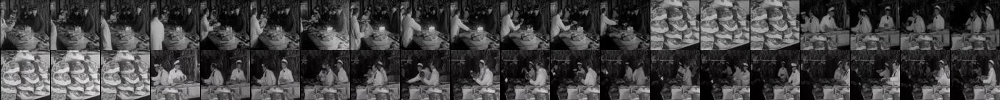

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Förväntningarnas tid_Nya hot och drömmar.mp4,00:35:44,00:36:03,19,897430,112.491554,14
SF2997A-E.1.mpg,00:24:42,00:25:01,19,888984,112.491554,14


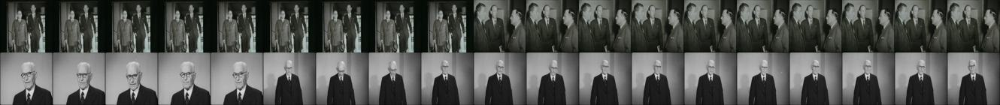

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1941.mp4,00:35:24,00:35:43,19,921386,85.310341,6
SF2794.1.mpg,00:09:25,00:09:44,19,688637,85.310341,6


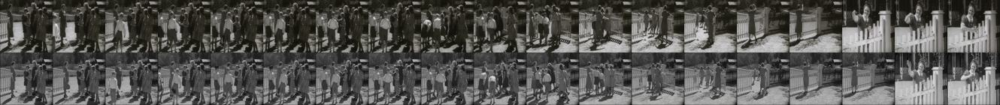

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Industri.webm,00:04:14,00:04:33,19,977236,91.588692,8
SF2140B.1.mpg,00:06:00,00:06:19,19,103336,91.588692,8


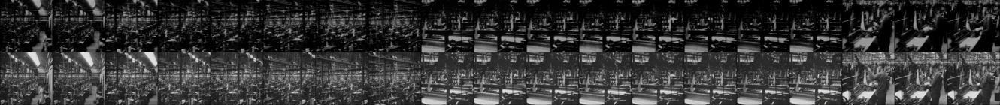

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Skolbarn.webm,00:15:52,00:16:11,19,981097,94.077087,18
SF2195.1.mpg,00:04:02,00:04:21,19,141027,94.077087,18


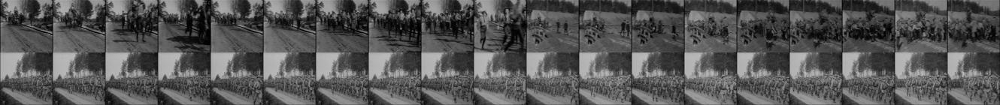

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Förväntningarnas tid_Nya hot och drömmar.mp4,00:35:44,00:36:02,18,897430,113.526711,11
SF2716.1.mpg,00:00:17,00:00:35,18,638228,113.526711,11


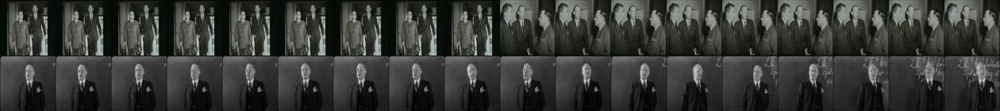

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1941.mp4,00:00:27,00:00:45,18,919289,83.970291,5
SF2554.1.mpg,00:00:26,00:00:44,18,483341,83.970291,5


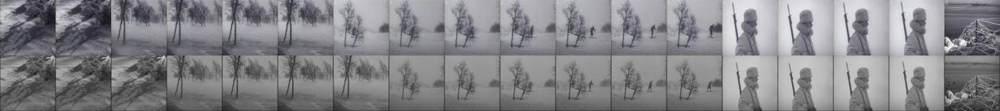

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1947.mp4,00:27:49,00:28:07,18,943665,93.706558,4
SF2825B.1.mpg,00:03:10,00:03:28,18,715699,93.706558,4


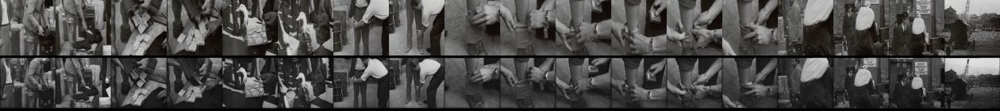

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Nöjen.webm,00:07:17,00:07:35,18,978488,93.325912,1
SF2183.1.mpg,00:02:44,00:03:02,18,132760,93.325912,1


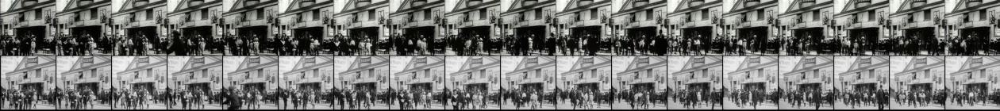

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Nöjen.webm,00:08:37,00:08:55,18,978568,102.741455,5
SF2218.1.mpg,00:01:41,00:01:59,18,162464,102.741455,5


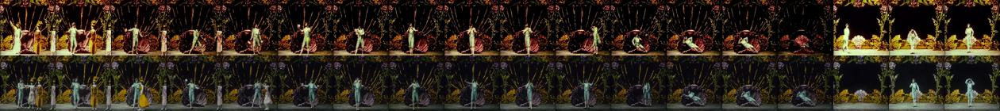

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Förväntningarnas tid_Nya hot och drömmar.mp4,00:35:44,00:36:01,17,897430,113.249069,13
SF2655.1.mpg,00:12:24,00:12:41,17,583267,113.249069,13


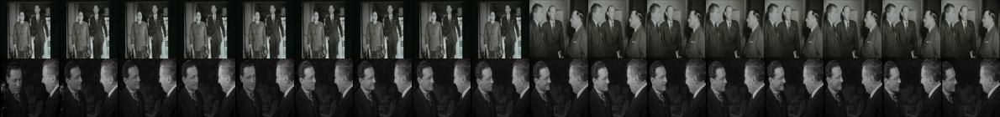

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1939.mp4,00:14:29,00:14:46,17,913148,80.564018,2
SF2880.1.mpg,00:04:11,00:04:28,17,778449,80.564018,2


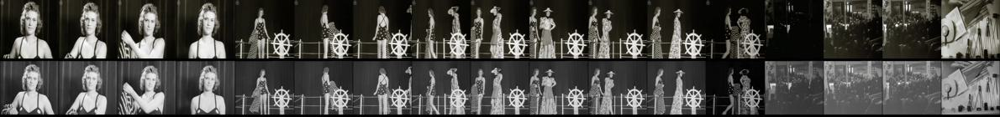

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1939.mp4,00:38:12,00:38:29,17,914571,97.639130,5
SF2682C.1.mpg,00:01:07,00:01:24,17,613846,97.639130,5


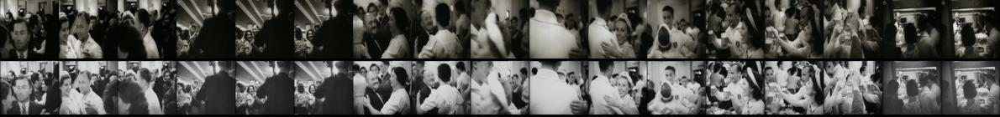

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1940.mp4,00:31:12,00:31:29,17,917655,80.061638,5
SF2687.1.mpg,00:13:16,00:13:33,17,617226,80.061638,5


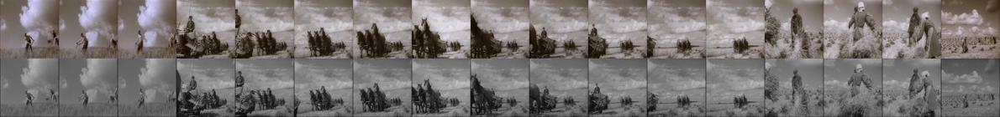

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_De gamla och kloka må le, fallera.webm",00:24:06,00:24:23,17,953693,88.486397,6
SF260A.1.mpg,00:00:03,00:00:20,17,527820,88.486397,6


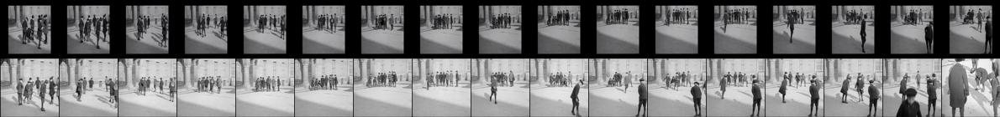

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:06:04,00:06:21,17,955622,104.107063,6
SF2670A-D.1.mpg,00:11:11,00:11:28,17,599629,104.107063,6


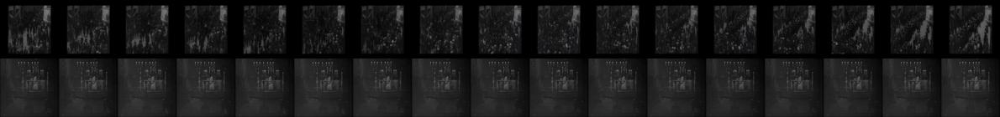

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:10:53,00:11:10,17,966550,95.618584,10
SF2042.1.mpg,00:09:24,00:09:41,17,30821,95.618584,10


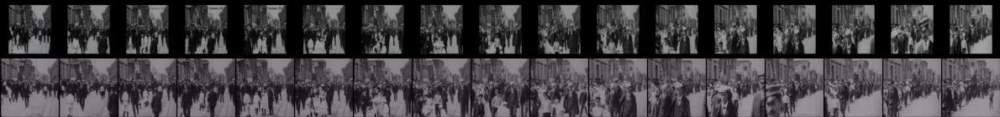

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:18:33,00:18:50,17,967010,90.173630,4
SF2627.1.mpg,00:10:08,00:10:25,17,548690,90.173630,4


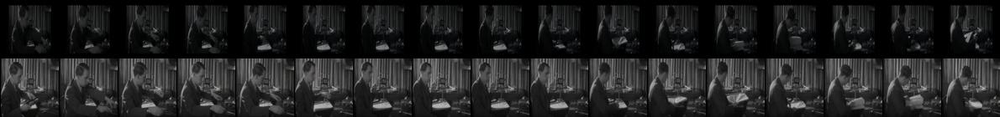

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:24:26,00:24:43,17,967363,104.550415,8
SF2554.1.mpg,00:09:31,00:09:48,17,483886,104.550415,8


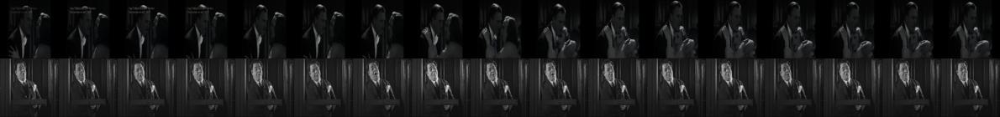

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:24:26,00:24:43,17,967363,103.596512,12
SF2554.1.mpg,00:10:37,00:10:54,17,483952,103.596512,12


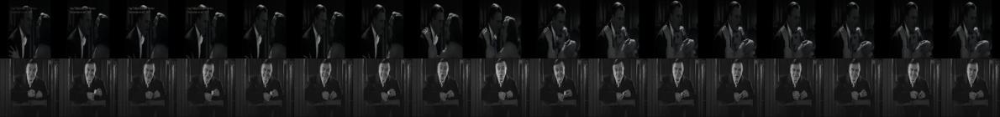

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Å, dyre prins.webm",00:08:00,00:08:17,17,971403,103.266663,5
SF2283B.1.mpg,00:07:56,00:08:13,17,225887,103.266663,5


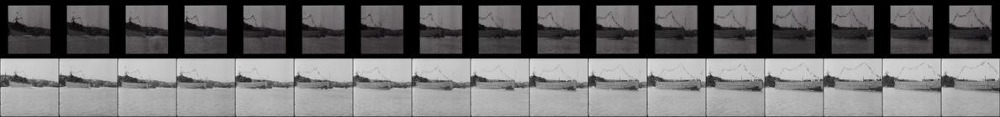

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Å, dyre prins.webm",00:08:00,00:08:17,17,971403,98.196915,7
SF2283C.1.mpg,00:10:07,00:10:24,17,226638,98.196915,7


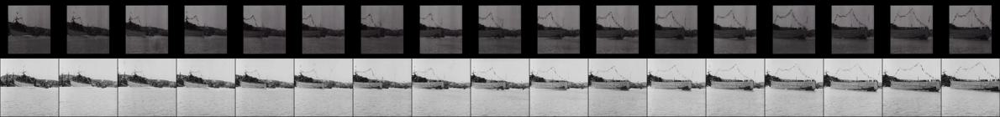

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Å, dyre prins.webm",00:10:39,00:10:56,17,971562,93.725479,3
SF2835.1.mpg,00:02:43,00:03:00,17,724451,93.725479,3


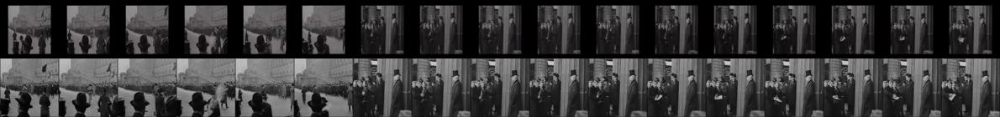

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Handel.webm,00:08:46,00:09:03,17,974390,81.673904,4
SF2826.1.mpg,00:03:18,00:03:35,17,716293,81.673904,4


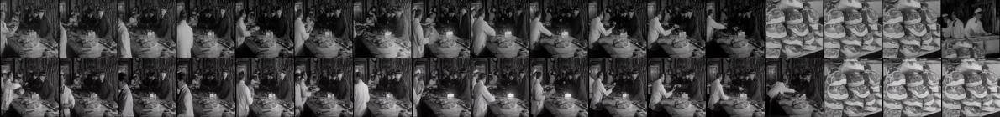

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1939.mp4,00:44:15,00:44:31,16,914934,73.343857,6
SF2718.1.mpg,00:06:18,00:06:34,16,639954,73.343857,6


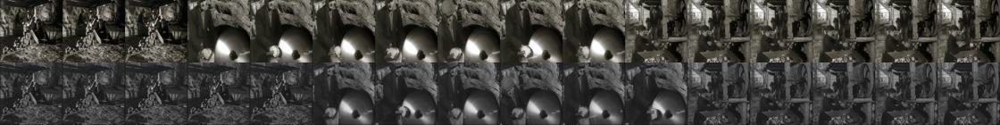

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1940.mp4,00:24:52,00:25:08,16,917275,83.044075,4
SF2687.1.mpg,00:08:38,00:08:54,16,616948,83.044075,4


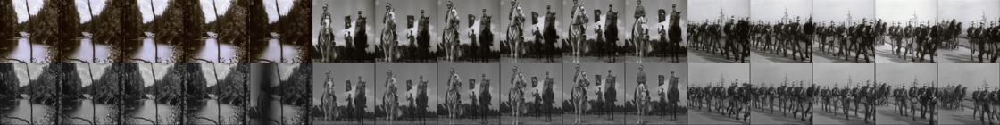

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1941.mp4,00:35:50,00:36:06,16,921412,97.103973,4
SF2794.1.mpg,00:09:52,00:10:08,16,688664,97.103973,4


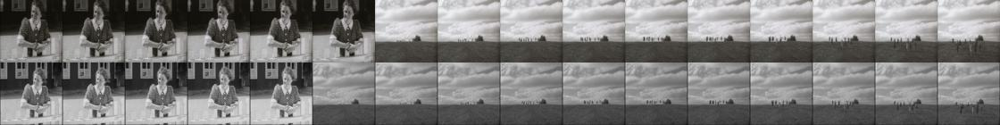

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:10:01,00:10:17,16,966498,103.371338,5
SF275.1.mpg,00:03:12,00:03:28,16,661983,103.371338,5


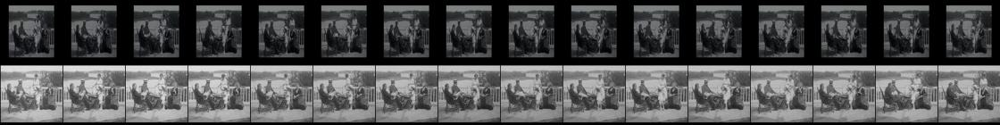

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Vi och världen.mp4,00:31:33,00:31:49,16,970787,83.155052,4
SF2770A.1.mpg,00:02:36,00:02:52,16,670875,83.155052,4


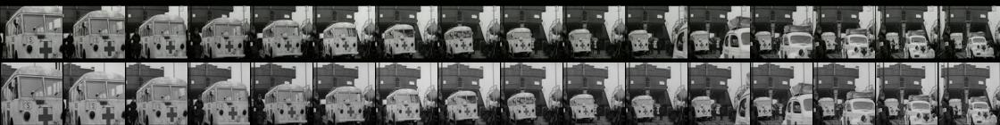

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Å, dyre prins.webm",00:31:58,00:32:14,16,972841,96.550400,9
SF220B.1.mpg,00:12:32,00:12:48,16,154896,96.550400,9


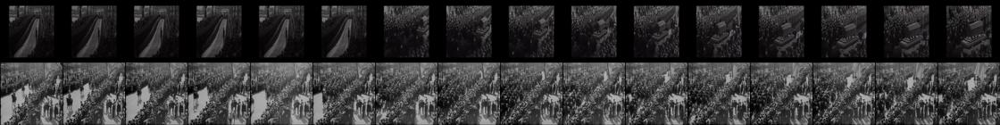

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Handel.webm,00:04:21,00:04:37,16,974125,88.328865,4
SF29.1.mpg,00:01:28,00:01:44,16,800984,88.328865,4


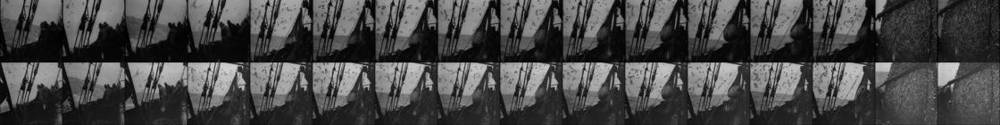

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Handel.webm,00:14:21,00:14:37,16,974725,102.063583,8
SF2304.1.mpg,00:01:58,00:02:14,16,240872,102.063583,8


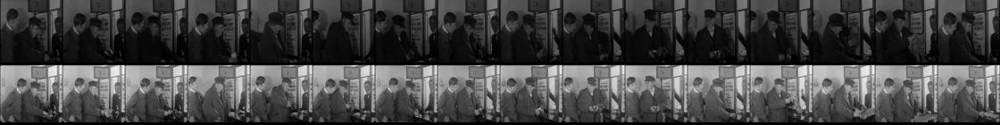

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Handel.webm,00:15:40,00:15:56,16,974804,54.748951,0
SF2064A.1.mpg,00:08:38,00:08:54,16,47088,54.748951,0


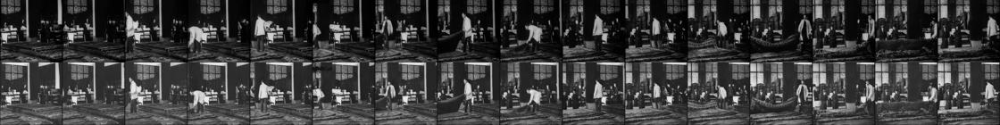

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Industri.webm,00:16:04,00:16:20,16,977946,87.264954,2
SF2480.B.Agafyr mm.1924mpg.mpg,00:01:15,00:01:31,16,404755,87.264954,2


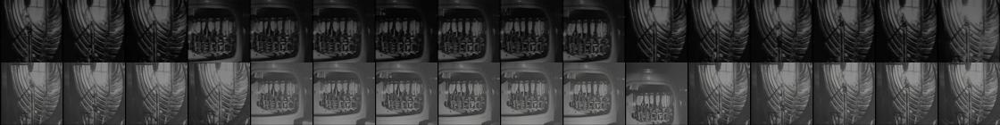

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Nöjen.webm,00:08:16,00:08:32,16,978547,100.743408,8
SF2218.1.mpg,00:01:20,00:01:36,16,162443,100.743408,8


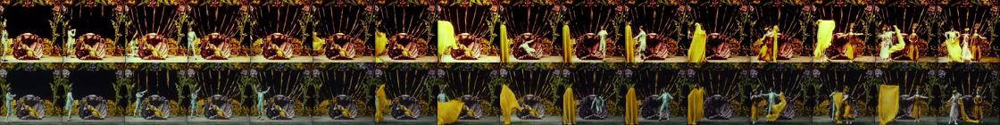

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Trafik.mp4,00:00:53,00:01:09,16,982365,95.031929,5
SF2412.1.mpg,00:09:31,00:09:47,16,341966,95.031929,5


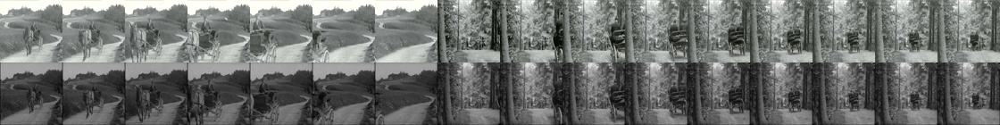

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Trafik.mp4,00:01:09,00:01:25,16,982381,93.782448,10
SF2412.1.mpg,00:10:05,00:10:21,16,342000,93.782448,10


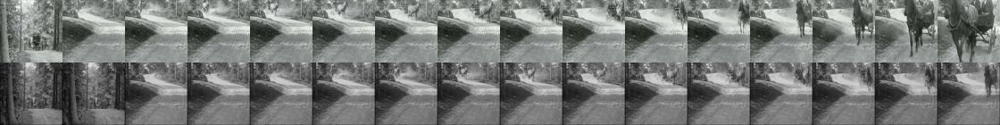

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Trafik.mp4,00:15:49,00:16:05,16,983261,93.637268,7
SF2099A.1.mpg,00:01:31,00:01:47,16,70143,93.637268,7


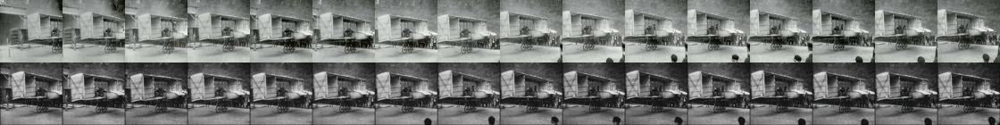

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Trafik.mp4,00:16:31,00:16:47,16,983303,97.617310,8
SF2108.1.mpg,00:07:26,00:07:42,16,79573,97.617310,8


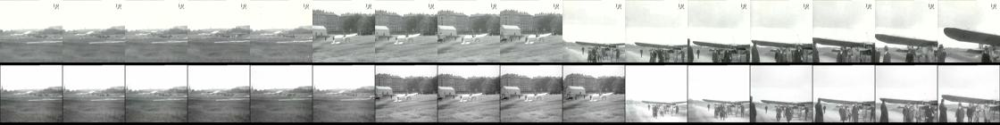

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1939.mp4,00:17:04,00:17:19,15,913303,90.671959,3
SF2685.1.mpg,00:04:10,00:04:25,15,615620,90.671959,3


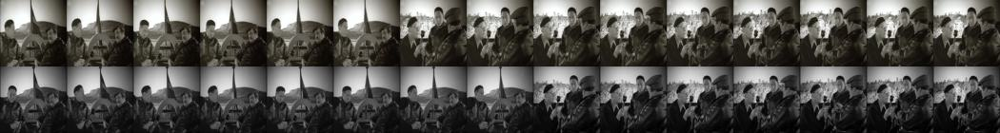

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1939.mp4,00:18:02,00:18:17,15,913361,83.485077,6
SF2880.1.mpg,00:04:51,00:05:06,15,778489,83.485077,6


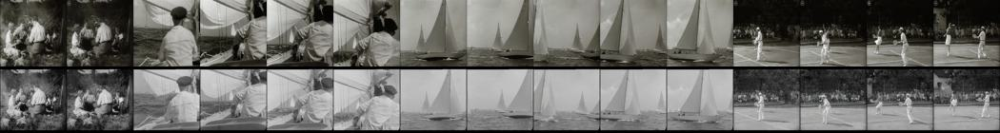

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1942.mp4,00:12:11,00:12:26,15,923502,59.148247,2
SF2914.1.mpg,00:10:49,00:11:04,15,815501,59.148247,2


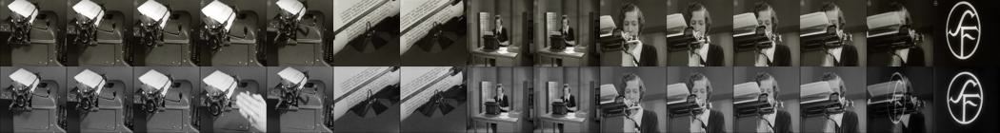

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1942.mp4,00:19:27,00:19:42,15,923938,61.278362,0
SF2621.1.mpg,00:01:27,00:01:42,15,542242,61.278362,0


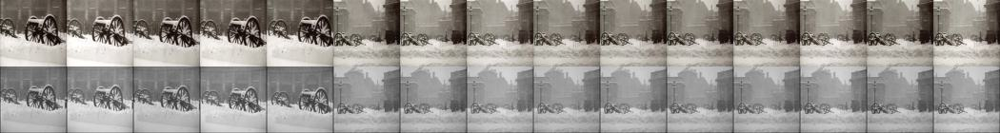

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1944.mp4,00:33:52,00:34:07,15,931744,67.104584,10
SF2410A-C.1.mpg,00:14:47,00:15:02,15,339907,67.104584,10


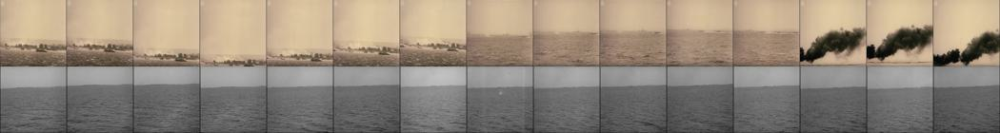

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_De gamla och kloka må le, fallera.webm",00:03:12,00:03:27,15,952439,83.379608,9
SF2241.1.mpg,00:00:40,00:00:55,15,186757,83.379608,9


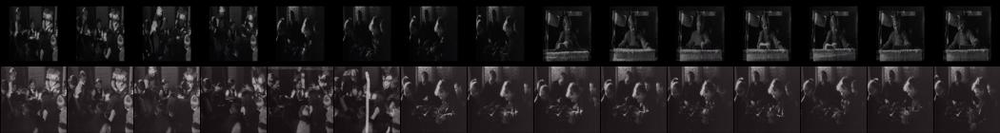

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_De gamla och kloka må le, fallera.webm",00:03:12,00:03:27,15,952439,89.617134,10
SF2241.1.mpg,00:02:38,00:02:53,15,186875,89.617134,10


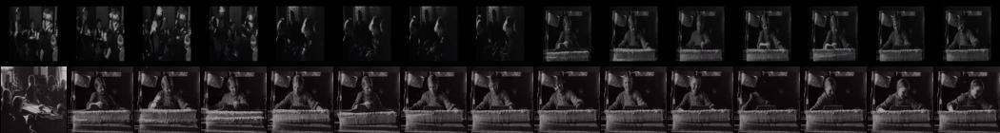

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_I ditt anletes svett.mp4,00:35:30,00:35:45,15,960421,91.540962,2
SF2635B.1.mpg,00:01:56,00:02:11,15,556411,91.540962,2


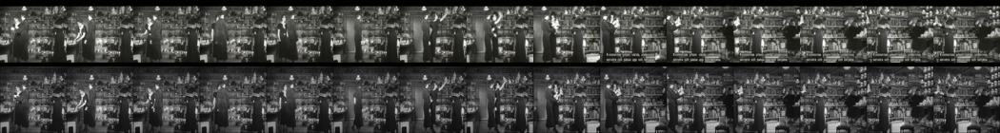

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Jag har varit med om allt som blivit nytt.webm,00:09:39,00:09:54,15,962248,86.548462,6
SF2183.1.mpg,00:11:22,00:11:37,15,133278,86.548462,6


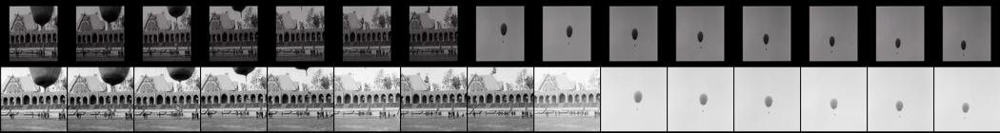

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Kjolarna, hattarna och lite Warzins keratin.mp4",00:03:15,00:03:30,15,964817,92.787041,5
SF2500A.1.mpg,00:06:52,00:07:07,15,424577,92.787041,5


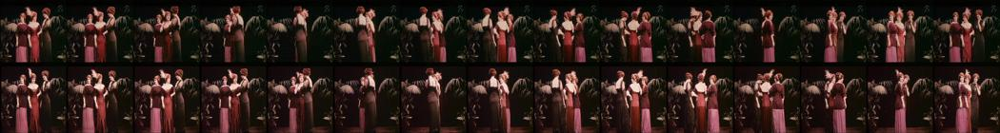

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:03:17,00:03:32,15,966094,85.655487,0
SF2183.1.mpg,00:02:44,00:02:59,15,132760,85.655487,0


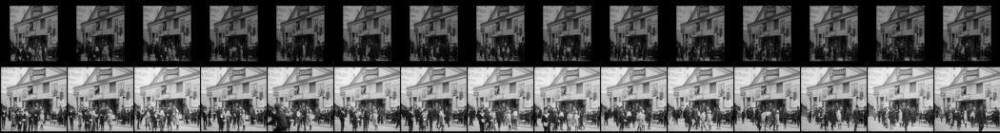

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Å, dyre prins.webm",00:31:58,00:32:13,15,972841,99.980492,9
SF2230.1.mpg,00:02:49,00:03:04,15,179879,99.980492,9


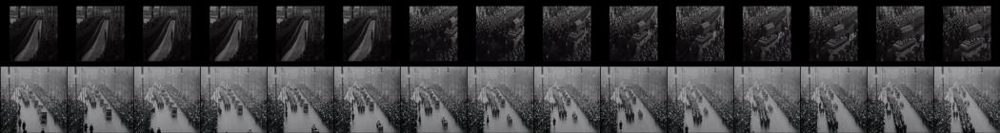

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Handel.webm,00:01:12,00:01:27,15,973936,95.767464,5
SF2644A.1.mpg,00:01:18,00:01:33,15,562857,95.767464,5


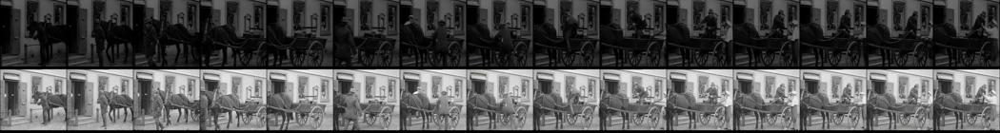

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Handel.webm,00:01:48,00:02:03,15,973972,92.135399,8
SF2028.1.mpg,00:03:18,00:03:33,15,20488,92.135399,8


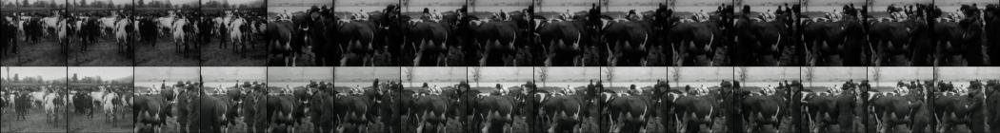

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Handel.webm,00:06:51,00:07:06,15,974275,87.385628,2
SF2064A.1.mpg,00:03:13,00:03:28,15,46763,87.385628,2


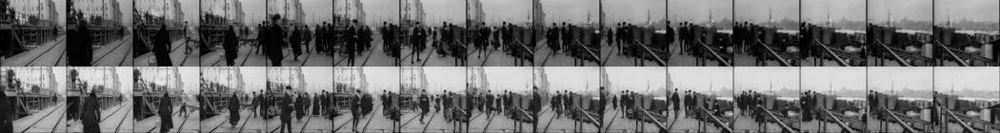

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Handel.webm,00:11:18,00:11:33,15,974542,92.195030,6
SF2274.1.mpg,00:05:51,00:06:06,15,217963,92.195030,6


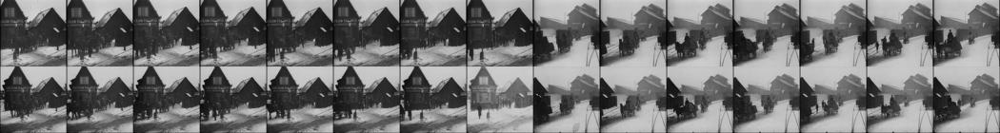

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Handel.webm,00:17:36,00:17:51,15,974920,101.122185,7
SF2304.1.mpg,00:12:58,00:13:13,15,241532,101.122185,7


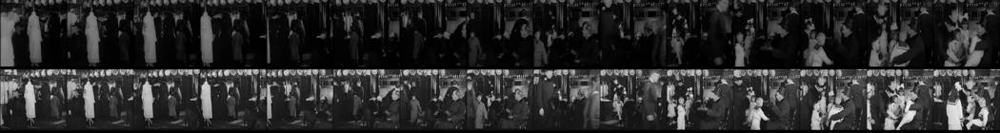

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Nöjen.webm,00:09:18,00:09:33,15,978609,86.525040,6
SF2062A.1.mpg,00:04:49,00:05:04,15,45348,86.525040,6


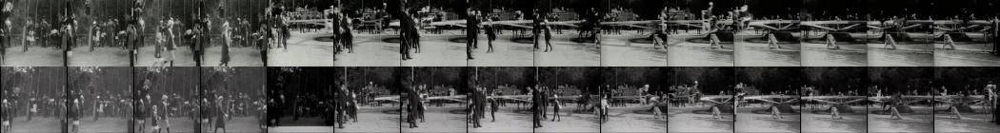

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Nöjen.webm,00:12:01,00:12:16,15,978772,81.482735,0
SF292.1.mpg,00:01:43,00:01:58,15,818808,81.482735,0


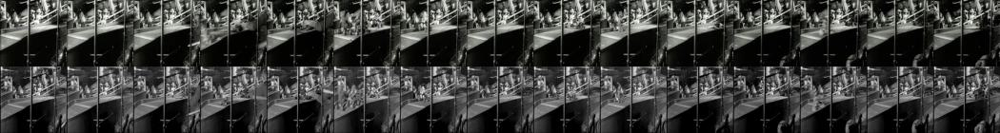

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Skolbarn.webm,00:15:52,00:16:07,15,981097,82.878174,14
SF2863A.1.mpg,00:08:36,00:08:51,15,755025,82.878174,14


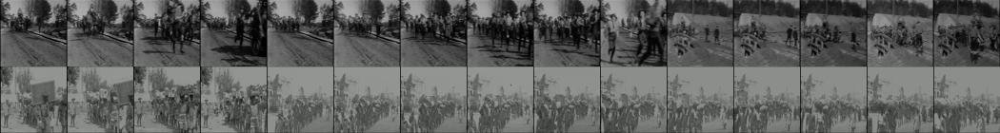

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Trafik.mp4,00:08:48,00:09:03,15,982840,94.334030,8
SF2183.1.mpg,00:02:20,00:02:35,15,132736,94.334030,8


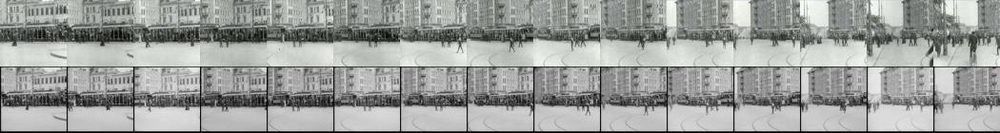

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1939.mp4,00:17:04,00:17:18,14,913303,92.314377,9
SF2685.1.mpg,00:03:50,00:04:04,14,615600,92.314377,9


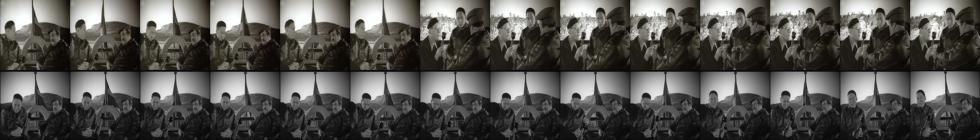

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1939.mp4,00:35:31,00:35:45,14,914410,96.707809,5
SF2682A.1.mpg,00:02:29,00:02:43,14,612772,96.707809,5


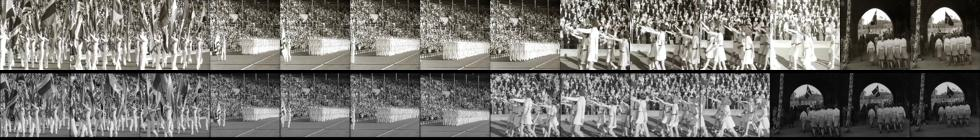

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1942.mp4,00:33:58,00:34:12,14,924809,106.671623,8
SF2789.1.mpg,00:13:36,00:13:50,14,685293,106.671623,8


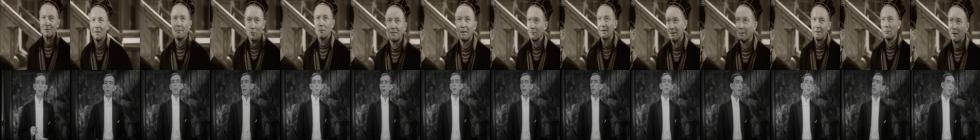

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1944.mp4,00:33:24,00:33:38,14,931716,93.003258,5
SF2410A-C.1.mpg,00:09:47,00:10:01,14,339607,93.003258,5


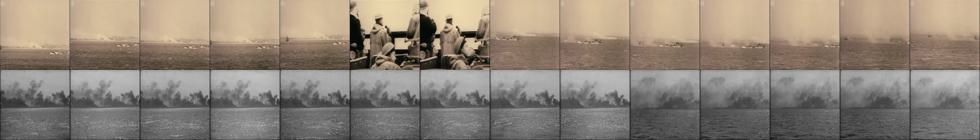

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1944.mp4,00:33:24,00:33:38,14,931716,94.171356,9
SF2410A-C.1.mpg,00:14:47,00:15:01,14,339907,94.171356,9


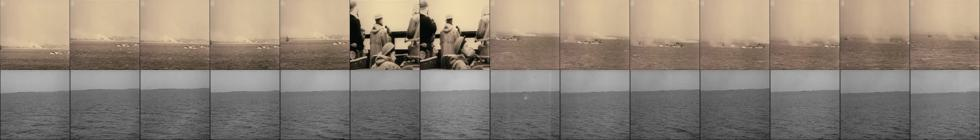

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1947.mp4,00:42:01,00:42:15,14,944517,93.500954,8
SF2476C.1.mpg,00:09:01,00:09:15,14,400991,93.500954,8


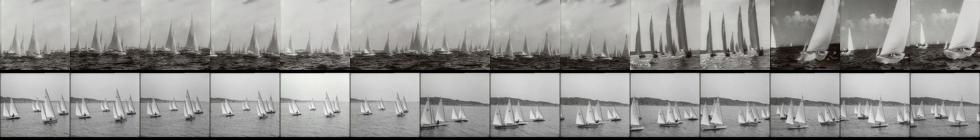

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1947.mp4,00:42:01,00:42:15,14,944517,94.194725,9
SF2695.1.mpg,00:00:56,00:01:10,14,623395,94.194725,9


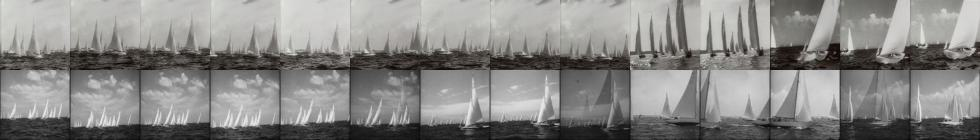

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1947.mp4,00:42:01,00:42:15,14,944517,81.846207,7
SF273.1.mpg,00:03:47,00:04:01,14,647104,81.846207,7


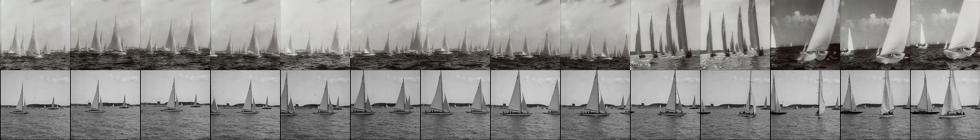

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:04:04,00:04:18,14,955502,106.167786,10
SF2242.1.mpg,00:06:36,00:06:50,14,187621,106.167786,10


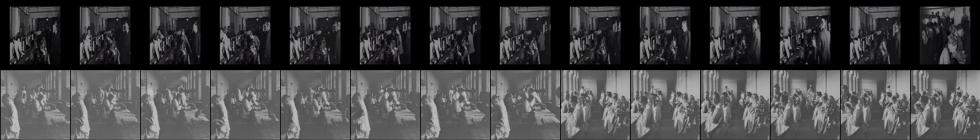

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:32:55,00:33:09,14,957233,100.733345,5
SF220B.1.mpg,00:12:33,00:12:47,14,154897,100.733345,5


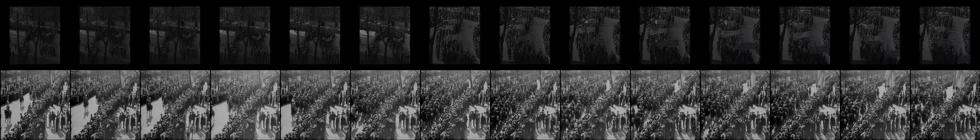

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:10:01,00:10:15,14,966498,96.166077,6
SF288.1.mpg,00:03:25,00:03:39,14,778183,96.166077,6


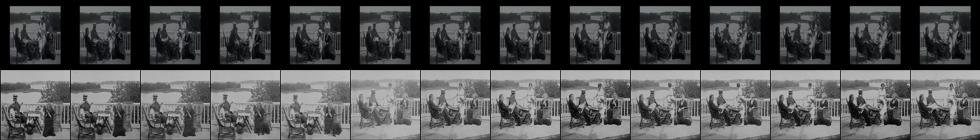

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:24:26,00:24:40,14,967363,97.442802,7
SF2491A-B.1.mpg,00:16:16,00:16:30,14,413256,97.442802,7


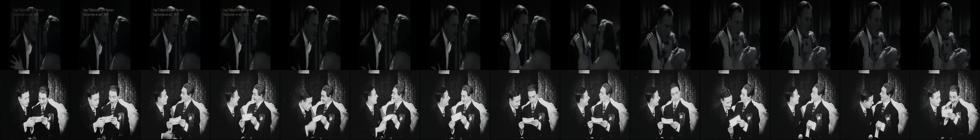

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Skolbarn.webm,00:01:56,00:02:10,14,980261,97.105965,7
SF2242.1.mpg,00:00:17,00:00:31,14,187242,97.105965,7


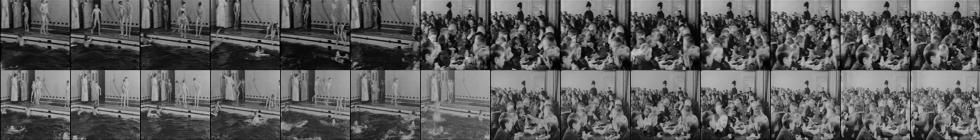

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Skolbarn.webm,00:06:57,00:07:11,14,980562,102.414551,8
SF2051.1.mpg,00:00:33,00:00:47,14,35774,102.414551,8


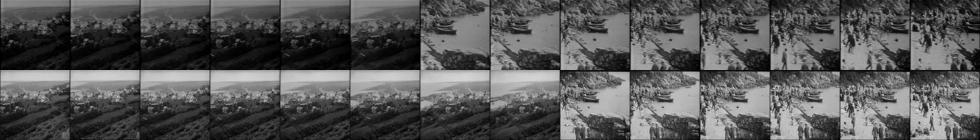

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Skolbarn.webm,00:10:41,00:10:55,14,980786,82.972488,6
SF2241.1.mpg,00:02:26,00:02:40,14,186863,82.972488,6


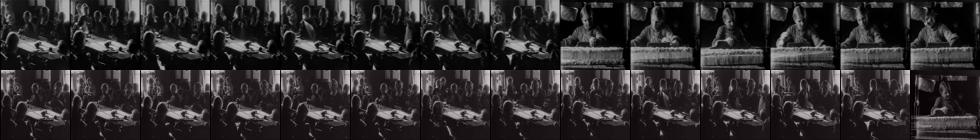

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Trafik.mp4,00:02:09,00:02:23,14,982441,74.601196,2
SF2055.1.mpg,00:06:08,00:06:22,14,39487,74.601196,2


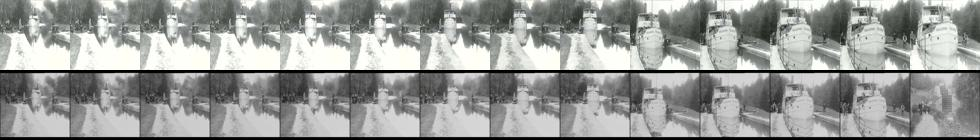

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Trafik.mp4,00:09:29,00:09:43,14,982881,99.021729,4
SF2183.1.mpg,00:07:59,00:08:13,14,133075,99.021729,4


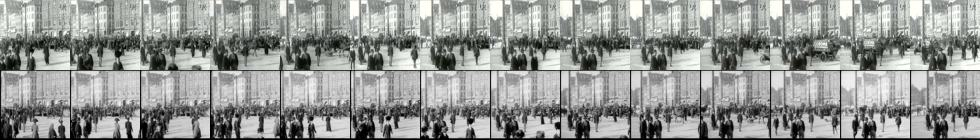

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Trafik.mp4,00:14:31,00:14:45,14,983183,89.057007,3
SF2171.1.mpg,00:11:26,00:11:40,14,125343,89.057007,3


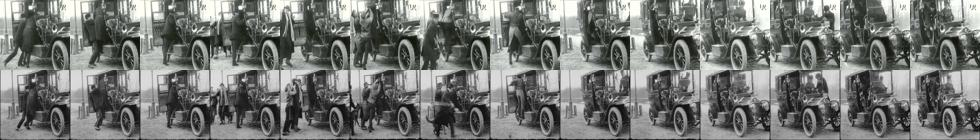

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Förväntningarnas tid_Nya hot och drömmar.mp4,00:35:44,00:35:57,13,897430,107.819557,10
SF2997A-E.1.mpg,00:23:58,00:24:11,13,888940,107.819557,10


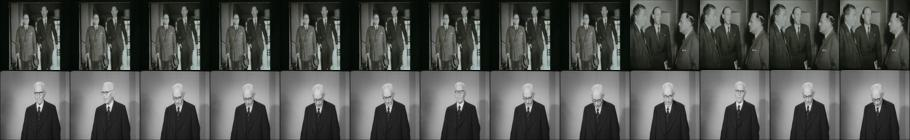

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1940.mp4,00:14:04,00:14:17,13,916627,106.548744,8
SF2398.1.mpg,00:09:01,00:09:14,13,330819,106.548744,8


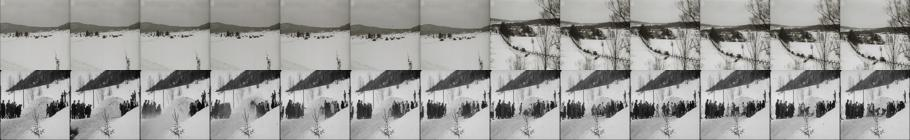

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1946.mp4,00:32:49,00:33:02,13,940525,103.736763,4
SF2835.1.mpg,00:10:57,00:11:10,13,724945,103.736763,4


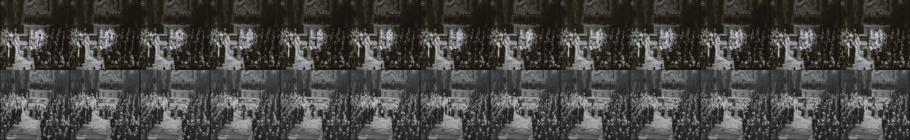

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1946.mp4,00:32:49,00:33:02,13,940525,99.431847,4
SF2836A-E.1.mpg,00:44:44,00:44:57,13,727813,99.431847,4


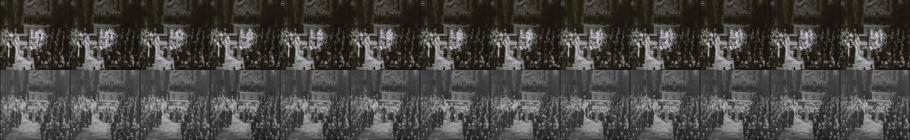

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1947.mp4,00:29:53,00:30:06,13,943789,87.263817,3
SF2825B.1.mpg,00:05:27,00:05:40,13,715836,87.263817,3


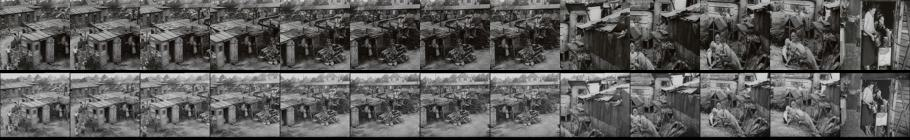

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_De gamla och kloka må le, fallera.webm",00:00:03,00:00:16,13,952250,108.333336,8
SF2131.1.mpg,00:09:54,00:10:07,13,96274,108.333336,8


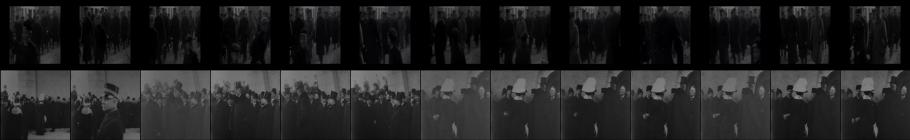

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_De gamla och kloka må le, fallera.webm",00:00:03,00:00:16,13,952250,102.073669,9
SF2457.1.mpg,00:09:11,00:09:24,13,386588,102.073669,9


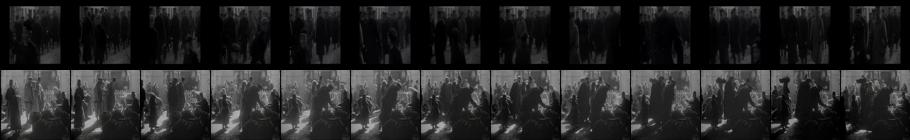

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_De gamla och kloka må le, fallera.webm",00:14:22,00:14:35,13,953109,94.276161,4
SF224.1.mpg,00:00:56,00:01:09,13,185791,94.276161,4


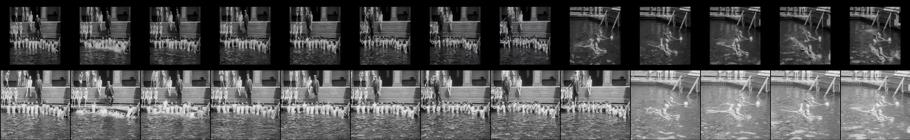

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_De gamla och kloka må le, fallera.webm",00:17:39,00:17:52,13,953306,100.495468,6
SF2605C.1.mpg,00:14:26,00:14:39,13,524542,100.495468,6


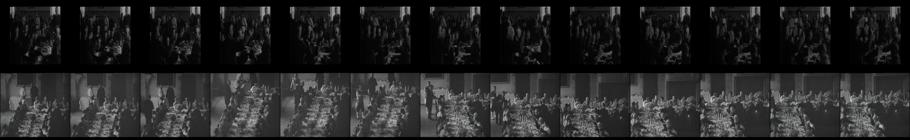

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:04:04,00:04:17,13,955502,94.006065,10
SF202.1.mpg,00:12:56,00:13:09,13,14863,94.006065,10


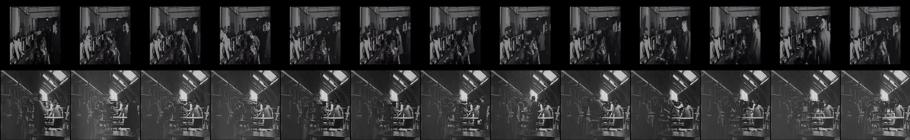

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:07:58,00:08:11,13,955736,84.749046,2
SF2221A-J.1.mpg,00:40:35,00:40:48,13,170135,84.749046,2


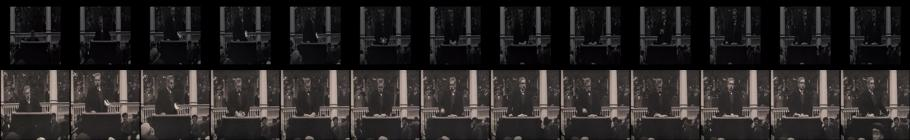

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:14:31,00:14:44,13,956129,102.199310,5
SF2791.1.mpg,00:03:48,00:04:01,13,686516,102.199310,5


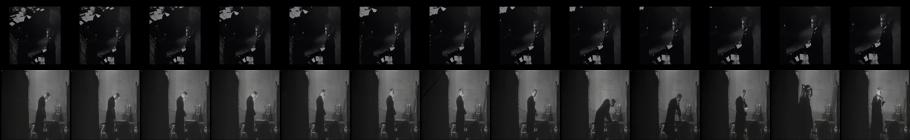

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_I ditt anletes svett.mp4,00:07:19,00:07:32,13,958730,82.243919,4
SF2072.1.mpg,00:11:05,00:11:18,13,52214,82.243919,4


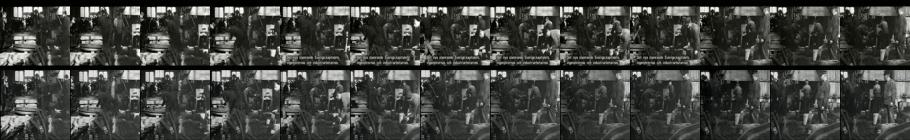

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Jag har varit med om allt som blivit nytt.webm,00:15:08,00:15:21,13,962577,101.209152,5
SF2831A-C.1.mpg,00:17:37,00:17:50,13,721075,101.209152,5


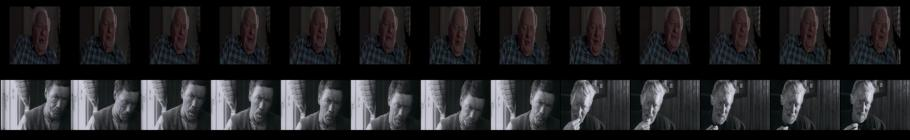

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:19:48,00:20:01,13,967085,103.732338,7
SF2911A.1.mpg,00:01:36,00:01:49,13,812259,103.732338,7


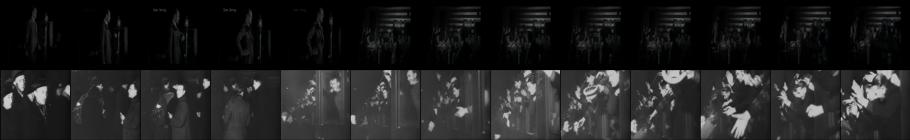

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Vi och världen.mp4,00:22:11,00:22:24,13,970225,99.909142,7
SF2413.1.mpg,00:03:43,00:03:56,13,342460,99.909142,7


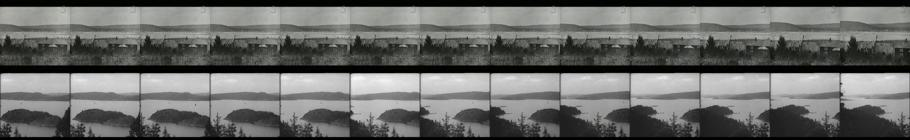

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Å, dyre prins.webm",00:08:00,00:08:13,13,971403,96.773598,7
SF2283A.1.mpg,00:04:55,00:05:08,13,225372,96.773598,7


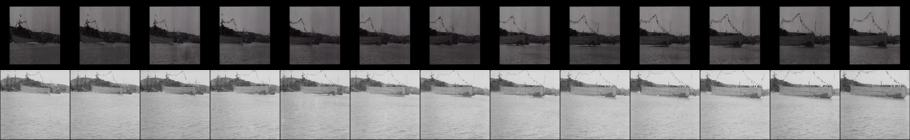

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Å, dyre prins.webm",00:10:39,00:10:52,13,971562,71.719887,10
SF2230.1.mpg,00:01:52,00:02:05,13,179822,71.719887,10


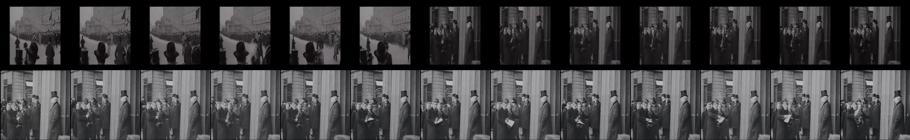

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Å, dyre prins.webm",00:31:58,00:32:11,13,972841,105.076370,11
SF2837B.1.mpg,00:03:20,00:03:33,13,729320,105.076370,11


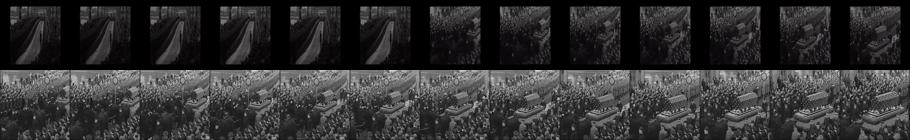

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Handel.webm,00:01:12,00:01:25,13,973936,96.773178,9
SF2129.1.mpg,00:02:51,00:03:04,13,94316,96.773178,9


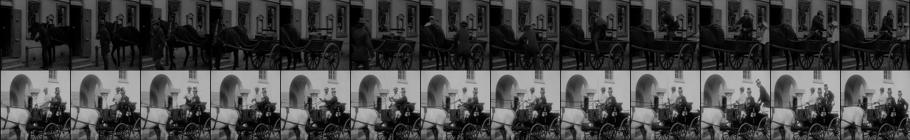

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Handel.webm,00:06:51,00:07:04,13,974275,115.609512,11
SF2061A.1.mpg,00:04:15,00:04:28,13,43682,115.609512,11


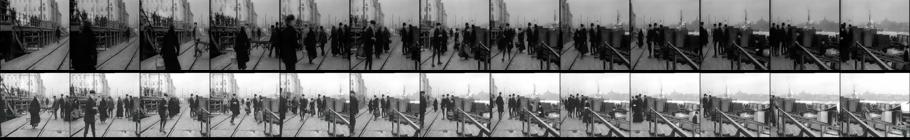

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Industri.webm,00:01:22,00:01:35,13,977064,112.972321,11
SF2184.1.mpg,00:01:20,00:01:33,13,133783,112.972321,11


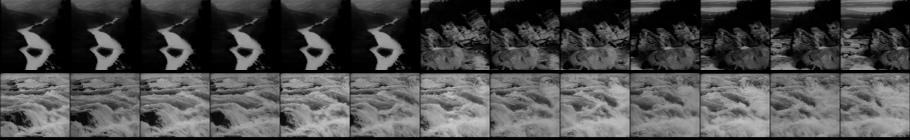

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Industri.webm,00:12:42,00:12:55,13,977744,95.405396,5
SF2072.1.mpg,00:12:36,00:12:49,13,52305,95.405396,5


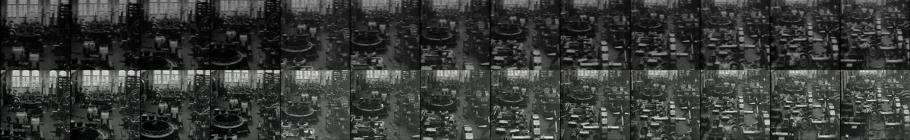

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Nöjen.webm,00:06:50,00:07:03,13,978461,84.767128,0
SF2322.1.mpg,00:07:51,00:08:04,13,252611,84.767128,0


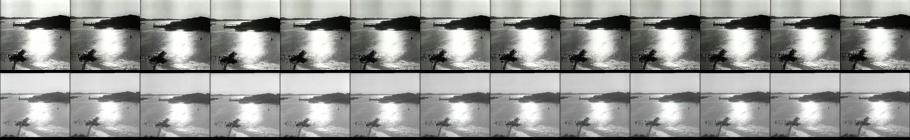

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Skolbarn.webm,00:15:13,00:15:26,13,981058,72.841537,0
SF2138.1.mpg,00:04:37,00:04:50,13,100696,72.841537,0


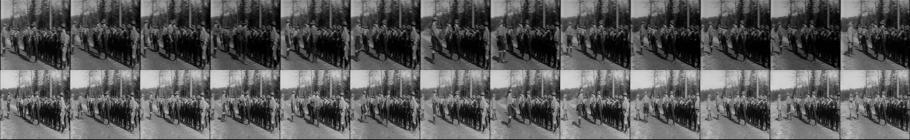

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Förväntningarnas tid_Nya hot och drömmar.mp4,00:23:31,00:23:43,12,896697,nan,12
SF2860.1.mpg,00:03:16,00:03:28,12,752350,nan,12


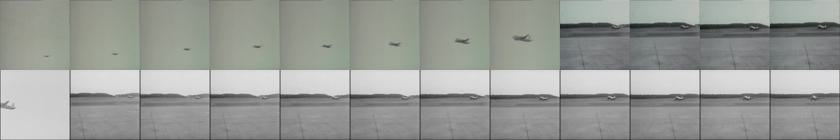

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1939.mp4,00:38:57,00:39:09,12,914616,100.777161,6
SF2682C.1.mpg,00:01:59,00:02:11,12,613898,100.777161,6


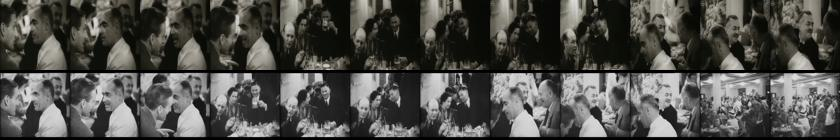

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1940.mp4,00:14:04,00:14:16,12,916627,109.847992,10
SF2312.1.mpg,00:06:59,00:07:11,12,246368,109.847992,10


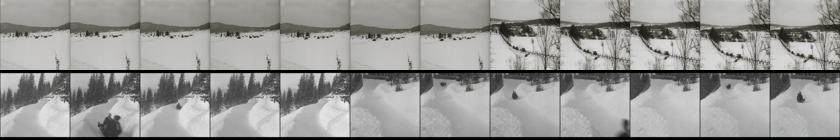

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1940.mp4,00:31:52,00:32:04,12,917695,61.589840,0
SF2687.1.mpg,00:13:56,00:14:08,12,617266,61.589840,0


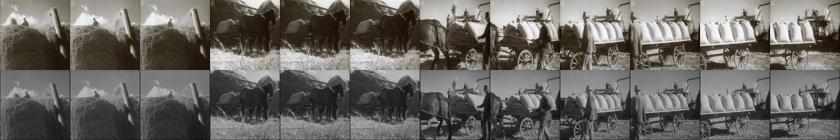

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1944.mp4,00:21:10,00:21:22,12,930982,112.249779,6
SF2148.1.mpg,00:11:30,00:11:42,12,109394,112.249779,6


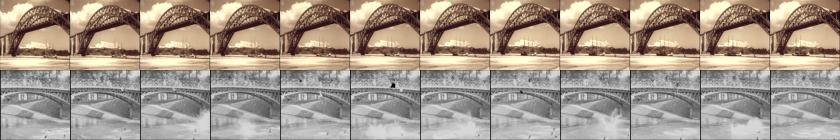

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1944.mp4,00:33:24,00:33:36,12,931716,90.387772,8
SF2410A-C.1.mpg,00:19:43,00:19:55,12,340203,90.387772,8


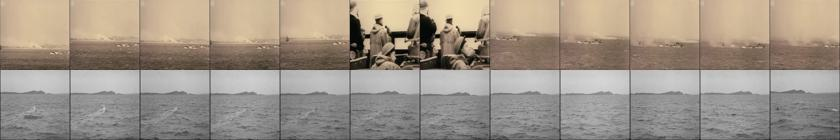

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1944.mp4,00:47:05,00:47:17,12,932537,101.612999,5
SF2382C.1.mpg,00:08:13,00:08:25,12,304612,101.612999,5


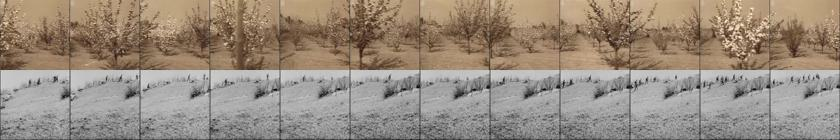

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1947.mp4,00:11:08,00:11:20,12,942664,94.038918,5
SF2382B.1.mpg,00:05:52,00:06:04,12,303881,94.038918,5


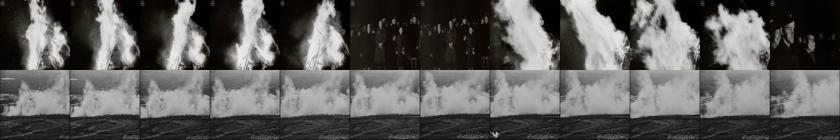

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1947.mp4,00:42:01,00:42:13,12,944517,85.701332,6
SF273.1.mpg,00:03:20,00:03:32,12,647077,85.701332,6


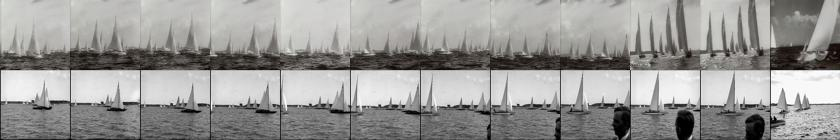

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:01:54,00:02:06,12,955372,115.185547,8
SF2789.1.mpg,00:04:26,00:04:38,12,684743,115.185547,8


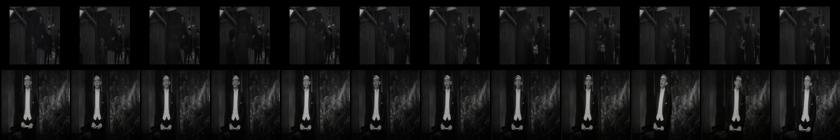

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_I ditt anletes svett.mp4,00:35:16,00:35:28,12,960407,100.791397,4
SF2635B.1.mpg,00:00:37,00:00:49,12,556332,100.791397,4


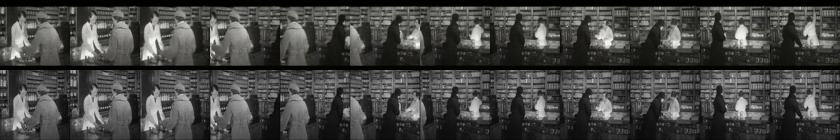

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Jag har varit med om allt som blivit nytt.webm,00:02:35,00:02:47,12,961824,101.857414,6
SF2094B.1.mpg,00:03:51,00:04:03,12,67477,101.857414,6


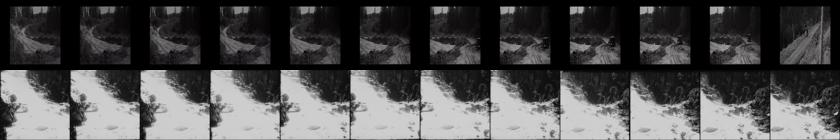

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Jag har varit med om allt som blivit nytt.webm,00:27:08,00:27:20,12,963297,83.662018,1
SF2024.1.mpg,00:09:16,00:09:28,12,18282,83.662018,1


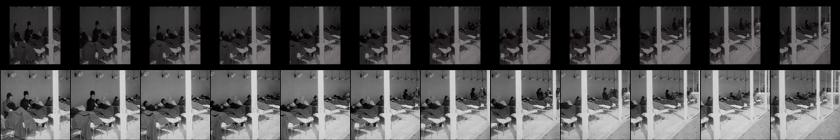

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Jag har varit med om allt som blivit nytt.webm,00:49:00,00:49:12,12,964609,92.896484,3
SF2209C.1.mpg,00:10:40,00:10:52,12,153294,92.896484,3


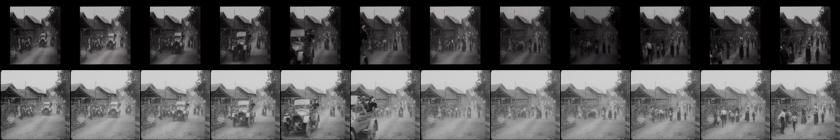

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:04:13,00:04:25,12,966150,109.415840,5
SF2830.1.mpg,00:01:46,00:01:58,12,719430,109.415840,5


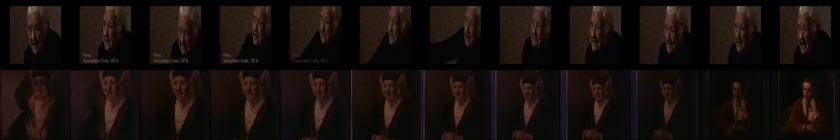

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:22:04,00:22:16,12,967221,115.108482,5
SF2742A.1.mpg,00:00:02,00:00:14,12,655737,115.108482,5


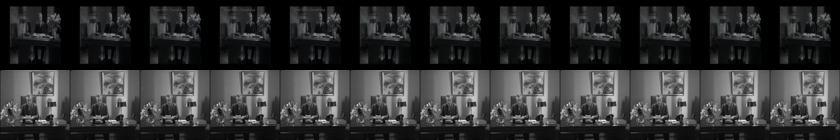

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Vi och världen.mp4,00:08:57,00:09:09,12,969431,107.565880,5
SF2410A-C.1.mpg,00:09:47,00:09:59,12,339607,107.565880,5


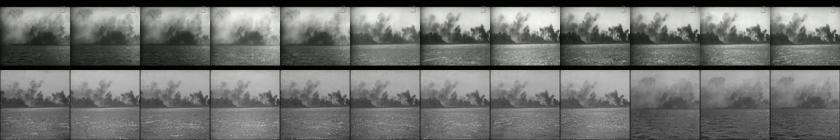

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Å, dyre prins.webm",00:31:58,00:32:10,12,972841,106.130737,7
SF220C.1.mpg,00:12:49,00:13:01,12,155914,106.130737,7


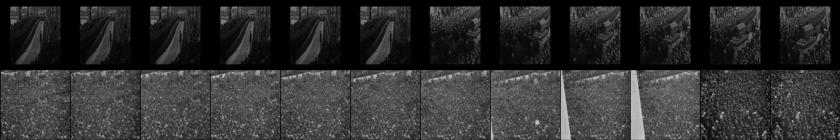

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Å, dyre prins.webm",00:31:58,00:32:10,12,972841,100.026276,9
SF2502D.1.mpg,00:02:56,00:03:08,12,428668,100.026276,9


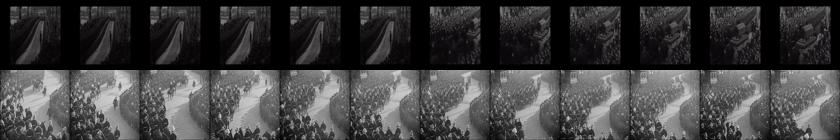

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Handel.webm,00:03:17,00:03:29,12,974061,nan,12
SF2569B.1.mpg,00:00:57,00:01:09,12,494715,nan,12


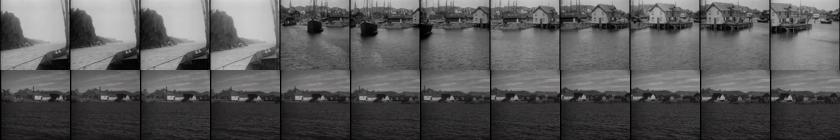

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Handel.webm,00:05:24,00:05:36,12,974188,83.764351,5
SF2433.1.mpg,00:03:48,00:04:00,12,364388,83.764351,5


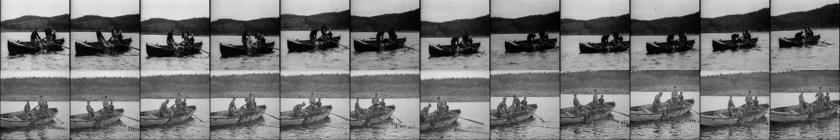

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Handel.webm,00:09:21,00:09:33,12,974425,84.271912,5
SF216.1.mpg,00:04:33,00:04:45,12,116999,84.271912,5


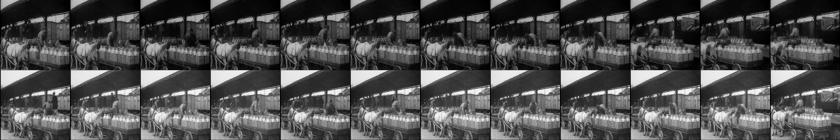

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Handel.webm,00:14:02,00:14:14,12,974706,59.198975,3
SF2304.1.mpg,00:01:08,00:01:20,12,240822,59.198975,3


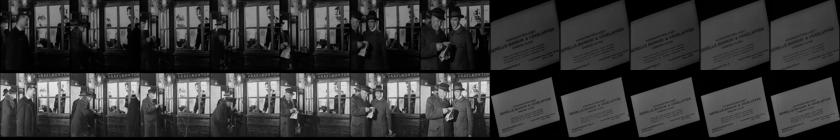

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Handel.webm,00:14:02,00:14:14,12,974706,98.224693,7
SF2545B.1.mpg,00:05:10,00:05:22,12,475628,98.224693,7


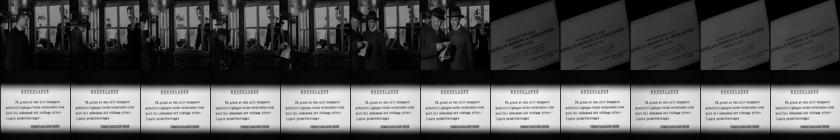

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Handel.webm,00:14:02,00:14:14,12,974706,103.778175,7
SF2626C.1.mpg,00:10:15,00:10:27,12,547746,103.778175,7


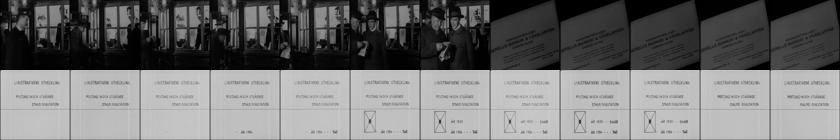

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Handel.webm,00:15:27,00:15:39,12,974791,65.896019,0
SF2265.1.mpg,00:05:30,00:05:42,12,205291,65.896019,0


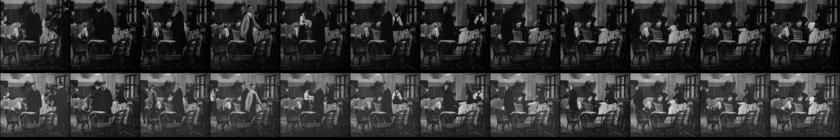

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Handel.webm,00:16:17,00:16:29,12,974841,52.854389,0
SF2265.1.mpg,00:08:44,00:08:56,12,205485,52.854389,0


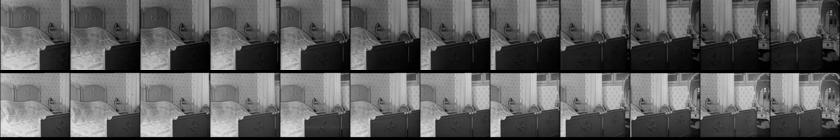

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Idrott.webm,00:13:37,00:13:49,12,976868,90.348076,8
SF2221A-J.1.mpg,01:15:34,01:15:46,12,172234,90.348076,8


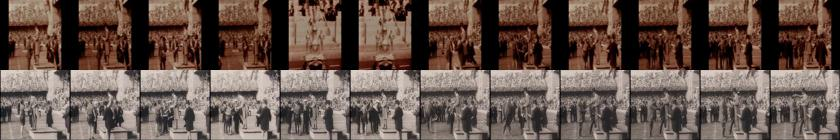

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Skolbarn.webm,00:15:52,00:16:04,12,981097,80.505493,5
SF2138.1.mpg,00:06:41,00:06:53,12,100820,80.505493,5


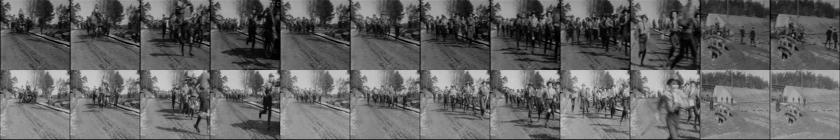

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Trafik.mp4,00:15:49,00:16:01,12,983261,92.353455,3
SF2099A.1.mpg,00:00:42,00:00:54,12,70094,92.353455,3


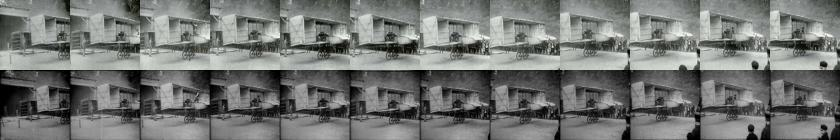

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Förväntningarnas tid_Nya hot och drömmar.mp4,00:22:32,00:22:43,11,896638,64.736588,1
SF2860.1.mpg,00:02:42,00:02:53,11,752316,64.736588,1


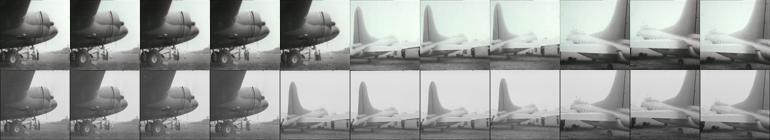

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Förväntningarnas tid_Nya hot och drömmar.mp4,00:35:44,00:35:55,11,897430,109.926186,6
SF2604.1.mpg,00:00:06,00:00:17,11,522294,109.926186,6


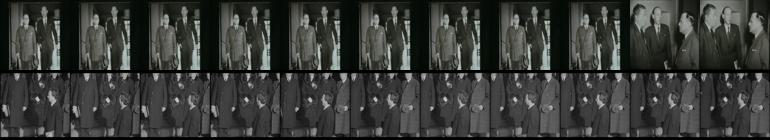

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Förväntningarnas tid_Nya hot och drömmar.mp4,00:35:44,00:35:55,11,897430,114.885620,10
SF2998A-F.1.mpg,00:04:54,00:05:05,11,890727,114.885620,10


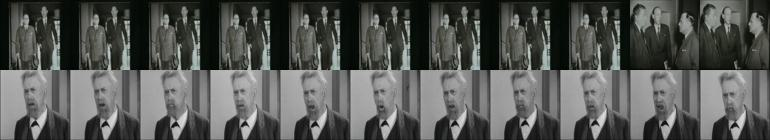

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1939.mp4,00:04:31,00:04:42,11,912550,61.798302,0
SF2891A.1. Åhlen o Holm 1939mpg.mpg,00:04:14,00:04:25,11,785939,61.798302,0


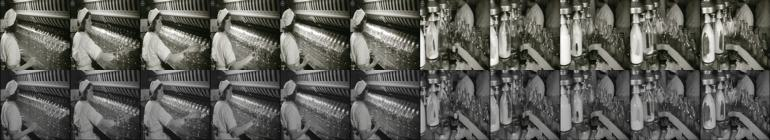

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1941.mp4,00:33:02,00:33:13,11,921244,107.365211,1
SF2794.1.mpg,00:00:28,00:00:39,11,688100,107.365211,1


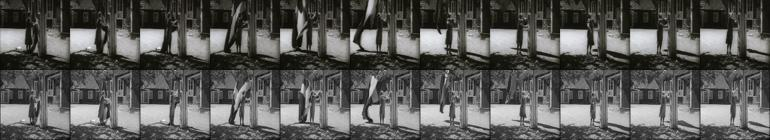

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1942.mp4,00:34:29,00:34:40,11,924840,115.732658,5
SF2789.1.mpg,00:13:48,00:13:59,11,685305,115.732658,5


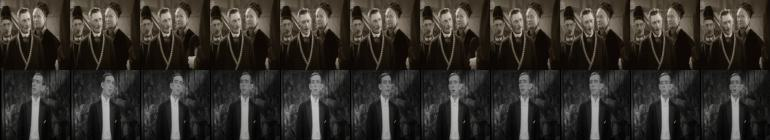

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1947.mp4,00:30:25,00:30:36,11,943821,93.092636,3
SF2825B.1.mpg,00:05:59,00:06:10,11,715868,93.092636,3


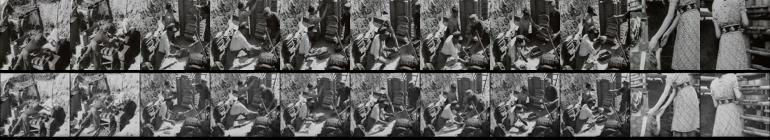

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1947.mp4,00:42:01,00:42:12,11,944517,76.867775,2
SF2695.1.mpg,00:00:04,00:00:15,11,623343,76.867775,2


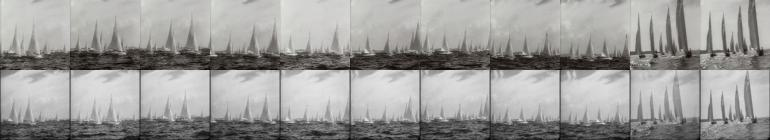

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1949.webm,00:57:08,00:57:19,11,952220,111.908524,6
SF2000.1.mpg,00:00:36,00:00:47,11,743,111.908524,6


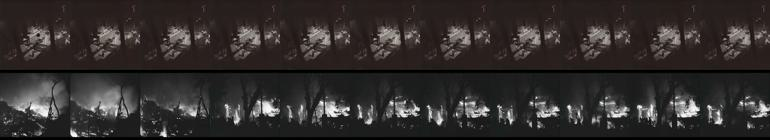

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:06:04,00:06:15,11,955622,99.125694,5
SF264.1.mpg,00:04:38,00:04:49,11,560247,99.125694,5


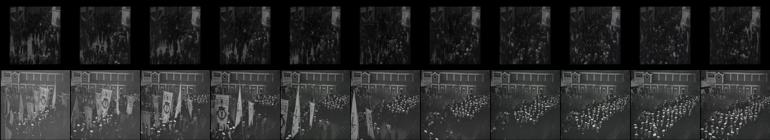

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:23:52,00:24:03,11,956690,97.594856,6
SF2023.1.mpg,00:04:22,00:04:33,11,17228,97.594856,6


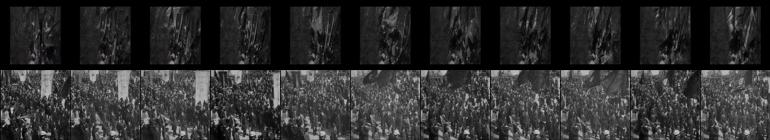

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:30:15,00:30:26,11,957073,97.844521,8
SF2554.1.mpg,00:10:32,00:10:43,11,483947,97.844521,8


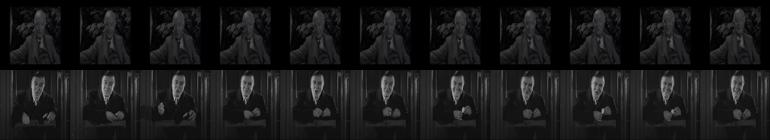

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:30:15,00:30:26,11,957073,96.204063,4
SF2654.1.mpg,00:06:25,00:06:36,11,582339,96.204063,4


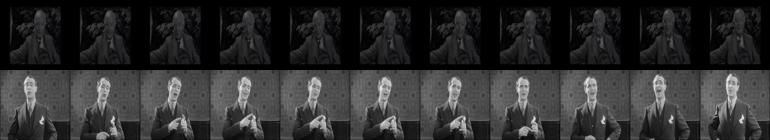

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:30:15,00:30:26,11,957073,97.305122,5
SF2654.1.mpg,00:06:58,00:07:09,11,582372,97.305122,5


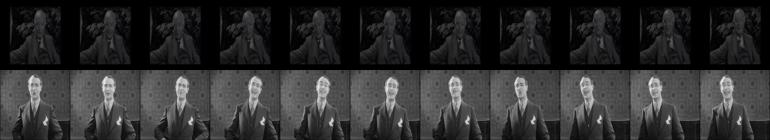

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:30:15,00:30:26,11,957073,97.268242,3
SF2764.1.mpg,00:03:33,00:03:44,11,668238,97.268242,3


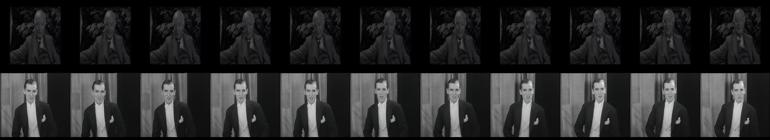

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:30:15,00:30:26,11,957073,84.205643,3
SF2789.1.mpg,00:05:27,00:05:38,11,684804,84.205643,3


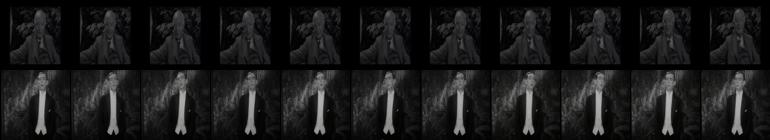

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:30:15,00:30:26,11,957073,98.547340,4
SF2789.1.mpg,00:13:37,00:13:48,11,685294,98.547340,4


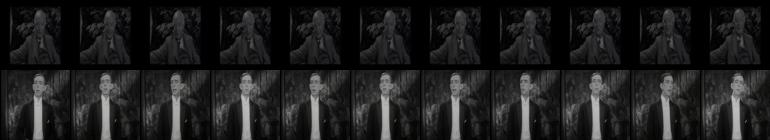

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:30:15,00:30:26,11,957073,93.233543,4
SF2805.1.mpg,00:00:32,00:00:43,11,696199,93.233543,4


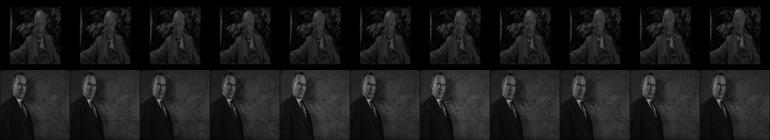

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Jag har varit med om allt som blivit nytt.webm,00:03:01,00:03:12,11,961850,103.006905,2
SF2480C.1.mpg,00:00:56,00:01:07,11,406053,103.006905,2


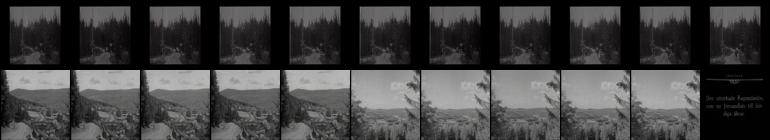

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Jag har varit med om allt som blivit nytt.webm,00:13:13,00:13:24,11,962462,86.884499,4
SF2296.1.mpg,00:04:40,00:04:51,11,235041,86.884499,4


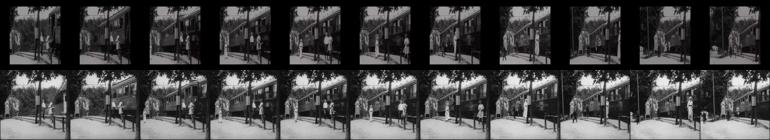

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Kjolarna, hattarna och lite Warzins keratin.mp4",00:03:03,00:03:14,11,964805,91.770309,3
SF2500A.1.mpg,00:07:15,00:07:26,11,424600,91.770309,3


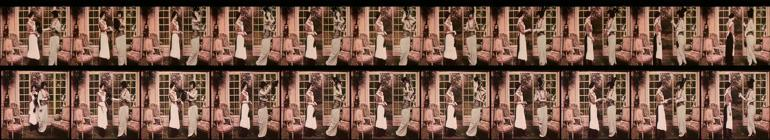

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Kjolarna, hattarna och lite Warzins keratin.mp4",00:16:15,00:16:26,11,965597,108.424194,5
SF2550A.1.mpg,00:01:13,00:01:24,11,480176,108.424194,5


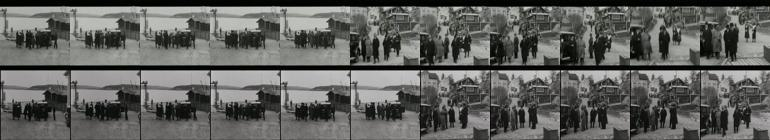

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Kjolarna, hattarna och lite Warzins keratin.mp4",00:16:32,00:16:43,11,965614,91.727608,4
SF2550A.1.mpg,00:01:32,00:01:43,11,480195,91.727608,4


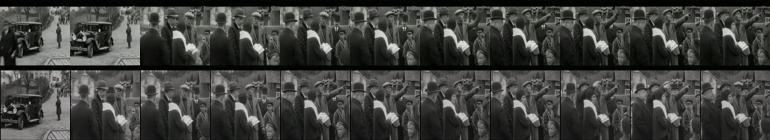

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:02:49,00:03:00,11,966066,79.764496,2
SF2183.1.mpg,00:01:11,00:01:22,11,132667,79.764496,2


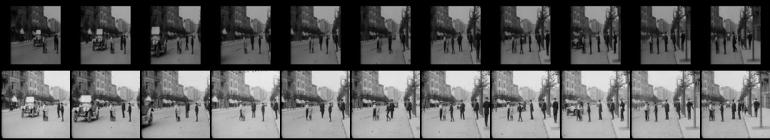

In [68]:
combined_project_finder.show_notebook_sequence(combined_project_sequences, show_limit=200, frame_resize=(70,70), convert_format='JPEG')

When browsing through the thumbnail previews, we do find that most of the sequences look correct. In some cases, there is a slight time shift in the identified frames, but overall, it seems as if the VRD has successfully found several instances of reuse. Some notable exceptions, however, include sequences where crowds of people have been mismatched. We also see examples of talking heads that remain in the search results. Other mismatched sequences include frames showing ocean horizons, sailing boats, and snowy landscapes. We also find examples of frames that have likely been mismatched since they are dark or near-black. 

We add these and other found unwanted sequences to a new Excel spreadsheet called "Unwanted_frames_2" and save it for later. Notably, adding unwanted sequences to the document will imply that our abilities to identify *actual* instances of reuse of footage showing talking heads, ocean horizons, trees and near-black frames, etc. will be severely reduced from now on. This is a price that we decide that we are willing to pay, however, to 'clean' and make it easier to read and navigate in our matching results.

An alternative to using the feature for removing unwanted frames could have involved lowering the distance metric threshold. This, however, could also imply that correct matches are removed from the search results, for example if a "correct" sequence match may be given a lower distance metric value than an incorrect sequence. This can happen if the color or resolution is very different in two video clips that otherwise contain the same footage. In this experiment, we choose to work with the feature for removing unwanted frames since it gives us a clearer idea of which matching results may have been removed from our dataset, such as sequences showing talking heads and persons depicted in half-figure shots.

To further inspect the search results, we look at the 200 longest sequences from the 5 most reused videos, as seen in the stacked bar plot above. We begin by looking at the matching results for the video SF2789.1, that is, the video clip with the most identified instances of reused sequences.

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1942.mp4,00:33:58,00:34:12,14,924809,106.671623,8
SF2789.1.mpg,00:13:36,00:13:50,14,685293,106.671623,8


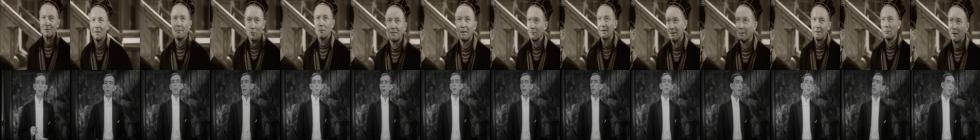

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:01:54,00:02:06,12,955372,115.185547,8
SF2789.1.mpg,00:04:26,00:04:38,12,684743,115.185547,8


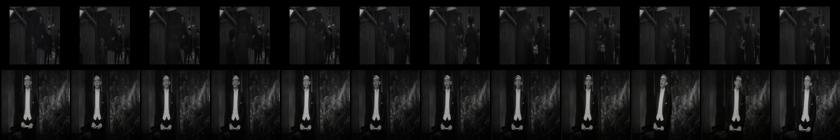

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1942.mp4,00:34:29,00:34:40,11,924840,115.732658,5
SF2789.1.mpg,00:13:48,00:13:59,11,685305,115.732658,5


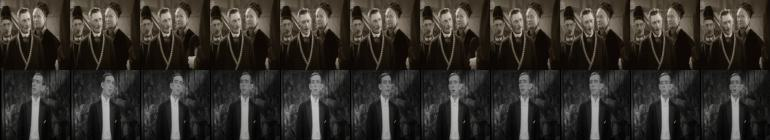

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:30:15,00:30:26,11,957073,84.205643,3
SF2789.1.mpg,00:05:27,00:05:38,11,684804,84.205643,3


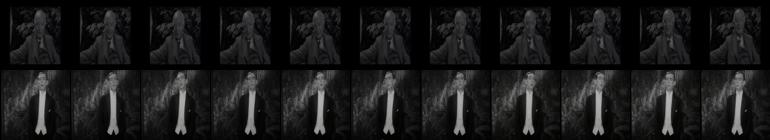

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:30:15,00:30:26,11,957073,98.547340,4
SF2789.1.mpg,00:13:37,00:13:48,11,685294,98.547340,4


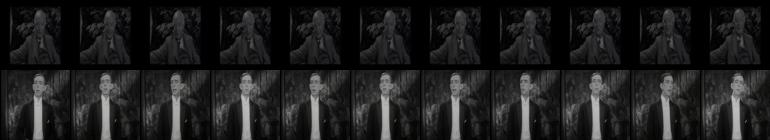

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1948.webm,00:19:22,00:19:32,10,946517,101.282059,2
SF2789.1.mpg,00:13:36,00:13:46,10,685293,101.282059,2


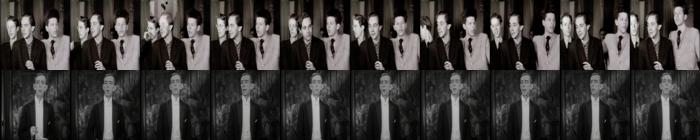

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_De gamla och kloka må le, fallera.webm",00:21:27,00:21:37,10,953534,97.920425,2
SF2789.1.mpg,00:02:23,00:02:33,10,684620,97.920425,2


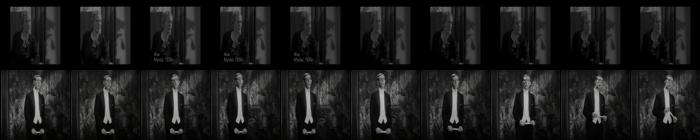

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_De gamla och kloka må le, fallera.webm",00:21:27,00:21:37,10,953534,100.329735,5
SF2789.1.mpg,00:02:45,00:02:55,10,684642,100.329735,5


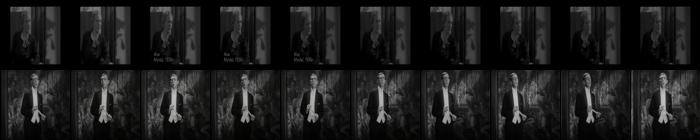

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_De gamla och kloka må le, fallera.webm",00:21:27,00:21:37,10,953534,95.647377,7
SF2789.1.mpg,00:03:01,00:03:11,10,684658,95.647377,7


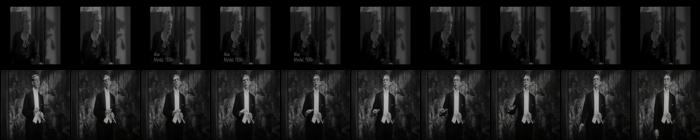

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_De gamla och kloka må le, fallera.webm",00:21:27,00:21:37,10,953534,94.053589,1
SF2789.1.mpg,00:03:55,00:04:05,10,684712,94.053589,1


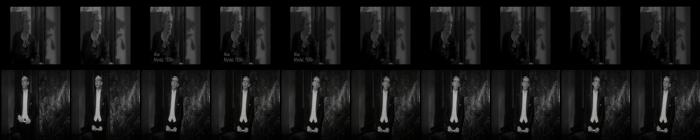

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_De gamla och kloka må le, fallera.webm",00:21:27,00:21:37,10,953534,96.930214,3
SF2789.1.mpg,00:04:25,00:04:35,10,684742,96.930214,3


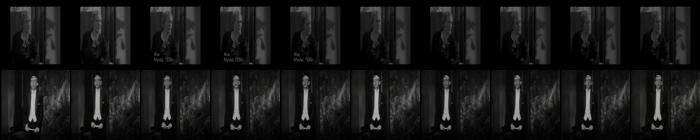

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:01:54,00:02:04,10,955372,108.287544,7
SF2789.1.mpg,00:03:55,00:04:05,10,684712,108.287544,7


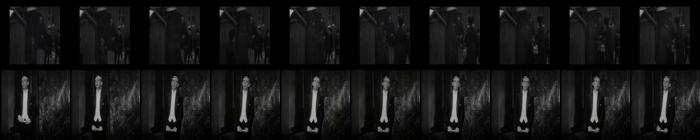

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:30:15,00:30:25,10,957073,95.688965,3
SF2789.1.mpg,00:06:49,00:06:59,10,684886,95.688965,3


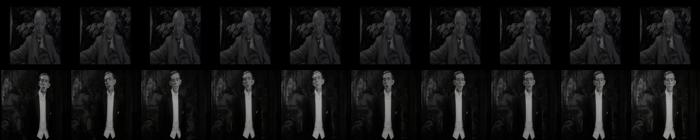

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Förväntningarnas tid_Skördetid med förhinder.webm,00:41:14,00:41:23,9,901009,111.387070,4
SF2789.1.mpg,00:13:37,00:13:46,9,685294,111.387070,4


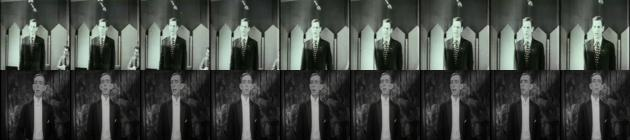

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1943.mp4,00:38:43,00:38:52,9,928538,105.397987,3
SF2789.1.mpg,00:14:13,00:14:22,9,685330,105.397987,3


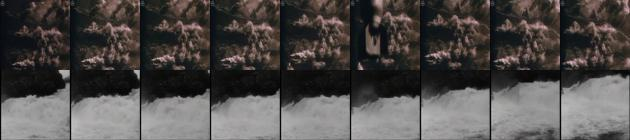

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:30:15,00:30:24,9,957073,97.521179,6
SF2789.1.mpg,00:03:29,00:03:38,9,684686,97.521179,6


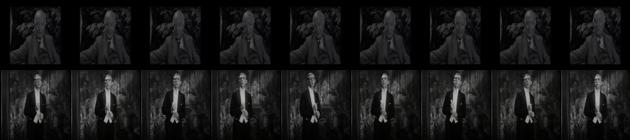

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_De gamla och kloka må le, fallera.webm",00:38:37,00:38:45,8,954564,112.952950,2
SF2789.1.mpg,00:03:57,00:04:05,8,684714,112.952950,2


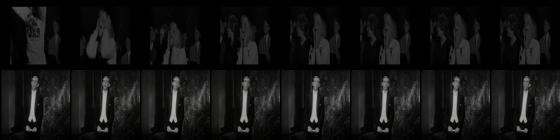

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:30:15,00:30:23,8,957073,102.245628,1
SF2789.1.mpg,00:02:18,00:02:26,8,684615,102.245628,1


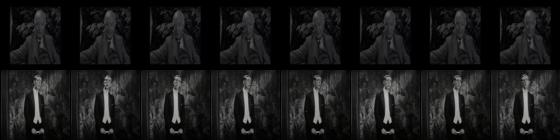

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1949.webm,00:01:39,00:01:46,7,948891,94.863640,2
SF2789.1.mpg,00:13:37,00:13:44,7,685294,94.863640,2


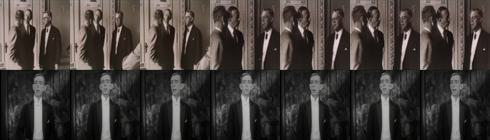

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1940.mp4,00:17:00,00:17:06,6,916803,102.902443,2
SF2789.1.mpg,00:02:21,00:02:27,6,684618,102.902443,2


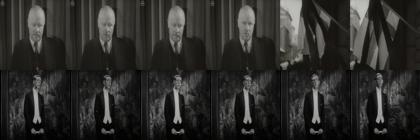

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1943.mp4,00:38:55,00:39:01,6,928550,106.237167,2
SF2789.1.mpg,00:14:15,00:14:21,6,685332,106.237167,2


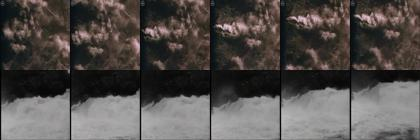

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_De gamla och kloka må le, fallera.webm",00:21:27,00:21:33,6,953534,101.904434,1
SF2789.1.mpg,00:02:04,00:02:10,6,684601,101.904434,1


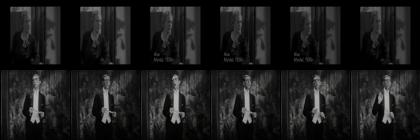

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_De gamla och kloka må le, fallera.webm",00:21:27,00:21:33,6,953534,97.967438,1
SF2789.1.mpg,00:02:14,00:02:20,6,684611,97.967438,1


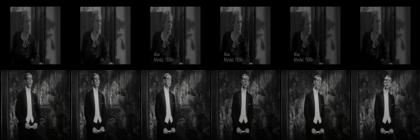

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_De gamla och kloka må le, fallera.webm",00:21:27,00:21:33,6,953534,106.123802,3
SF2789.1.mpg,00:06:35,00:06:41,6,684872,106.123802,3


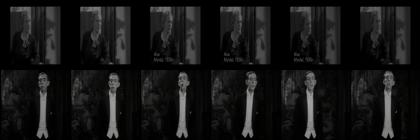

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:30:15,00:30:21,6,957073,100.498207,3
SF2789.1.mpg,00:00:58,00:01:04,6,684535,100.498207,3


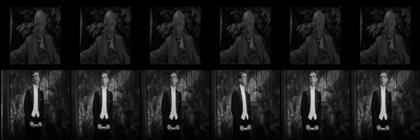

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:24:26,00:24:32,6,967363,94.128807,3
SF2789.1.mpg,00:06:52,00:06:58,6,684889,94.128807,3


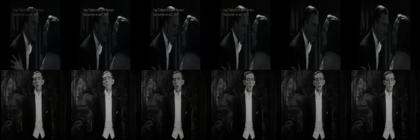

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:24:56,00:25:02,6,967393,113.739815,2
SF2789.1.mpg,00:03:58,00:04:04,6,684715,113.739815,2


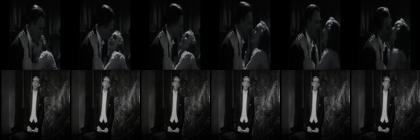

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:28:41,00:28:47,6,967618,110.485390,0
SF2789.1.mpg,00:05:27,00:05:33,6,684804,110.485390,0


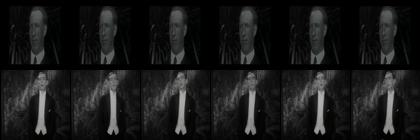

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:28:41,00:28:47,6,967618,116.106041,2
SF2789.1.mpg,00:08:45,00:08:51,6,685002,116.106041,2


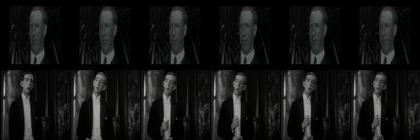

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:28:41,00:28:47,6,967618,107.873878,0
SF2789.1.mpg,00:13:37,00:13:43,6,685294,107.873878,0


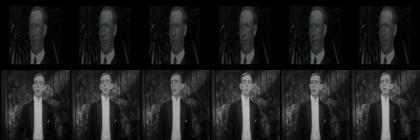

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1944.mp4,00:14:04,00:14:09,5,930556,106.030716,0
SF2789.1.mpg,00:13:36,00:13:41,5,685293,106.030716,0


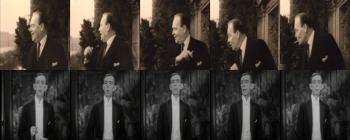

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:29:02,00:29:07,5,957000,103.728615,0
SF2789.1.mpg,00:02:16,00:02:21,5,684613,103.728615,0


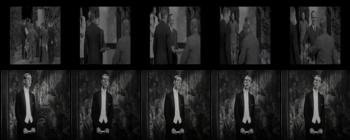

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:13:10,00:13:15,5,966687,100.433525,3
SF2789.1.mpg,00:03:55,00:04:00,5,684712,100.433525,3


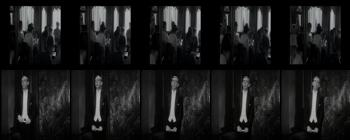

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:24:26,00:24:31,5,967363,105.854263,1
SF2789.1.mpg,00:05:27,00:05:32,5,684804,105.854263,1


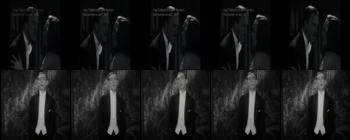

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Å, dyre prins.webm",00:42:29,00:42:34,5,973472,113.829399,1
SF2789.1.mpg,00:13:43,00:13:48,5,685300,113.829399,1


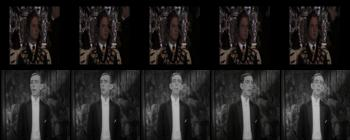

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1943.mp4,00:51:00,00:51:04,4,929275,107.891060,0
SF2789.1.mpg,00:06:53,00:06:57,4,684890,107.891060,0


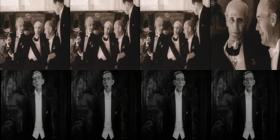

In [69]:
combined_project_finder.show_notebook_sequence(contains_video(combined_project_sequences, 'SF2789.1.mpg', combined_project_finder), show_limit=200, show_shift=False, frame_resize=(70,70), convert_format='JPEG')

In this case, we find that a particular sequence from the video SF2789.1.mpg has been excessively mismatched in the search results. As it turns out, this sequence shows Prince Wilhelm of Norway and Sweden reading a poem called "While the boat is drifting" ("Medan båten glider").

We add the sequences showing Prince Wilhelm and other talking heads to the Excel spreadsheet "TV_unwanted_frames_2.xlsx" and continue by studying the second most reused video clip in the same way, zooming in on the matching results for the video SF2410A-C.1, which depics a [military exercise](https://smdb.kb.se/catalog/search?q=SF2410&x=0&y=0), performed by the Swedish Navy in 1918.

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1944.mp4,00:33:52,00:34:07,15,931744,67.104584,10
SF2410A-C.1.mpg,00:14:47,00:15:02,15,339907,67.104584,10


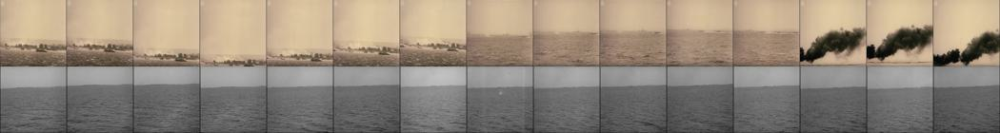

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1944.mp4,00:33:24,00:33:38,14,931716,93.003258,5
SF2410A-C.1.mpg,00:09:47,00:10:01,14,339607,93.003258,5


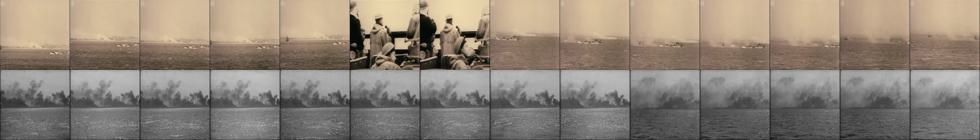

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1944.mp4,00:33:24,00:33:38,14,931716,94.171356,9
SF2410A-C.1.mpg,00:14:47,00:15:01,14,339907,94.171356,9


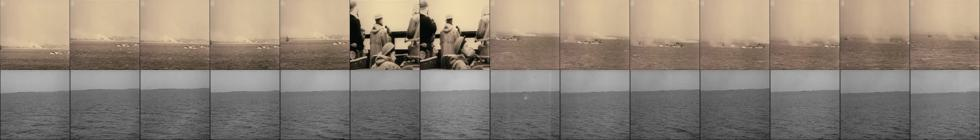

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1944.mp4,00:33:24,00:33:36,12,931716,90.387772,8
SF2410A-C.1.mpg,00:19:43,00:19:55,12,340203,90.387772,8


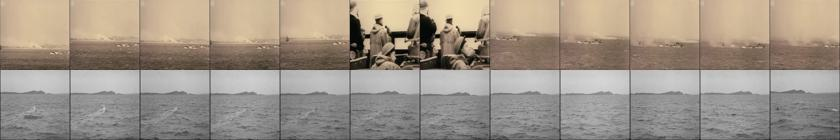

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Vi och världen.mp4,00:08:57,00:09:09,12,969431,107.565880,5
SF2410A-C.1.mpg,00:09:47,00:09:59,12,339607,107.565880,5


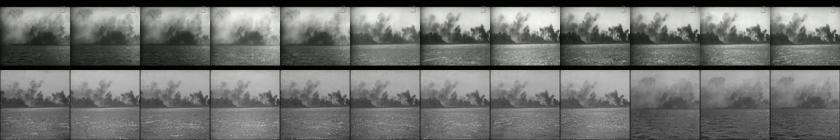

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1944.mp4,00:33:24,00:33:34,10,931716,89.856781,5
SF2410A-C.1.mpg,00:20:08,00:20:18,10,340228,89.856781,5


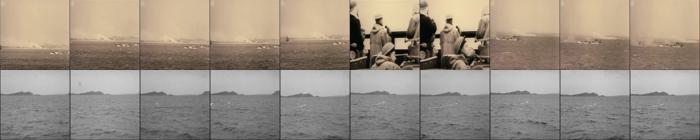

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1944.mp4,00:33:24,00:33:33,9,931716,88.250809,7
SF2410A-C.1.mpg,00:15:16,00:15:25,9,339936,88.250809,7


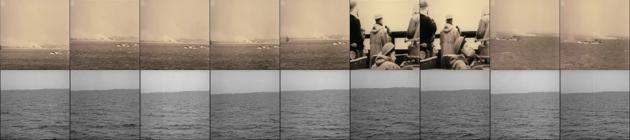

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1941.mp4,00:40:08,00:40:15,7,921670,105.250641,3
SF2410A-C.1.mpg,00:03:07,00:03:14,7,339207,105.250641,3


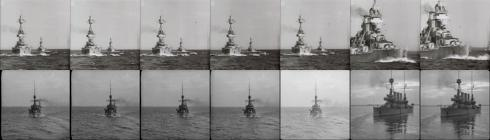

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1944.mp4,00:33:24,00:33:31,7,931716,96.925430,3
SF2410A-C.1.mpg,00:23:21,00:23:28,7,340421,96.925430,3


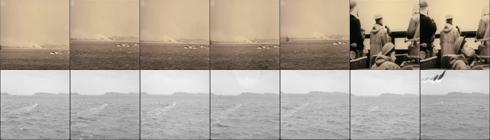

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Vi och världen.mp4,00:08:48,00:08:55,7,969422,104.414513,0
SF2410A-C.1.mpg,00:09:33,00:09:40,7,339593,104.414513,0


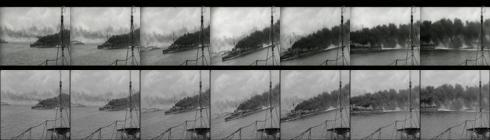

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1944.mp4,00:33:52,00:33:58,6,931744,92.213104,5
SF2410A-C.1.mpg,00:09:49,00:09:55,6,339609,92.213104,5


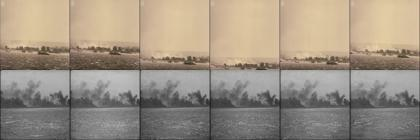

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn Från 1950.webm,00:36:36,00:36:41,5,911220,114.558083,1
SF2410A-C.1.mpg,00:15:27,00:15:32,5,339947,114.558083,1


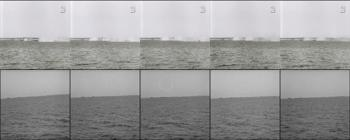

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1940.mp4,00:38:47,00:38:52,5,918110,103.552658,1
SF2410A-C.1.mpg,00:03:19,00:03:24,5,339219,103.552658,1


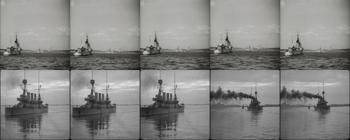

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1941.mp4,00:39:52,00:39:57,5,921654,103.218407,1
SF2410A-C.1.mpg,00:05:24,00:05:29,5,339344,103.218407,1


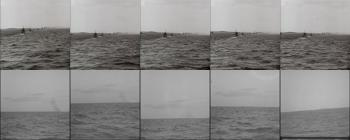

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1941.mp4,00:39:52,00:39:57,5,921654,97.676636,0
SF2410A-C.1.mpg,00:15:11,00:15:16,5,339931,97.676636,0


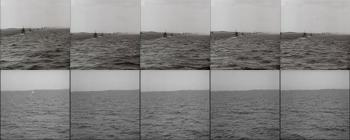

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1941.mp4,00:39:52,00:39:57,5,921654,101.311371,1
SF2410A-C.1.mpg,00:15:25,00:15:30,5,339945,101.311371,1


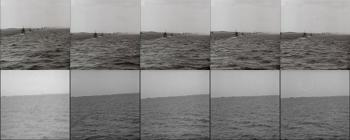

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1943.mp4,00:30:28,00:30:33,5,928043,89.051254,0
SF2410A-C.1.mpg,00:13:21,00:13:26,5,339821,89.051254,0


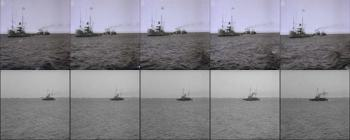

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1944.mp4,00:33:52,00:33:57,5,931744,nan,5
SF2410A-C.1.mpg,00:19:19,00:19:24,5,340179,nan,5


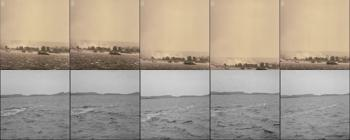

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1948.webm,00:40:54,00:40:59,5,947809,94.484055,1
SF2410A-C.1.mpg,00:15:11,00:15:16,5,339931,94.484055,1


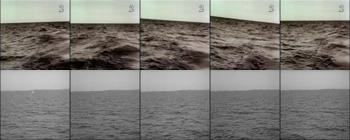

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1948.webm,00:40:54,00:40:59,5,947809,96.601036,1
SF2410A-C.1.mpg,00:19:45,00:19:50,5,340205,96.601036,1


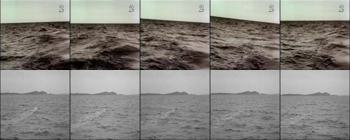

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1948.webm,00:40:54,00:40:59,5,947809,94.621475,1
SF2410A-C.1.mpg,00:22:29,00:22:34,5,340369,94.621475,1


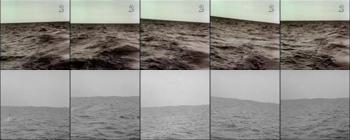

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1948.webm,00:40:54,00:40:59,5,947809,108.255539,0
SF2410A-C.1.mpg,00:22:42,00:22:47,5,340382,108.255539,0


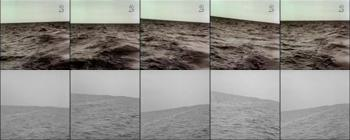

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Industri.webm,00:03:08,00:03:13,5,977170,108.297127,1
SF2410A-C.1.mpg,00:19:20,00:19:25,5,340180,108.297127,1


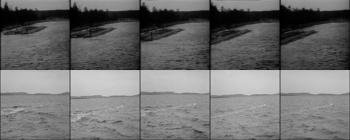

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1943.mp4,00:33:05,00:33:09,4,928200,97.372498,0
SF2410A-C.1.mpg,00:06:15,00:06:19,4,339395,97.372498,0


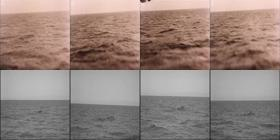

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1943.mp4,00:33:05,00:33:09,4,928200,96.854256,0
SF2410A-C.1.mpg,00:14:47,00:14:51,4,339907,96.854256,0


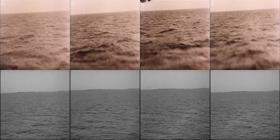

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1943.mp4,00:33:05,00:33:09,4,928200,104.909523,0
SF2410A-C.1.mpg,00:14:56,00:15:00,4,339916,104.909523,0


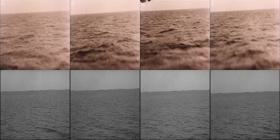

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1943.mp4,00:33:05,00:33:09,4,928200,99.505348,0
SF2410A-C.1.mpg,00:15:25,00:15:29,4,339945,99.505348,0


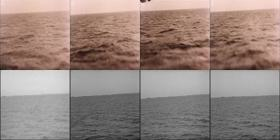

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1944.mp4,00:32:40,00:32:44,4,931672,86.299492,0
SF2410A-C.1.mpg,00:05:27,00:05:31,4,339347,86.299492,0


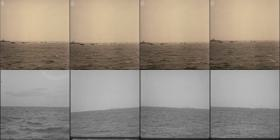

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1944.mp4,00:32:40,00:32:44,4,931672,93.761215,0
SF2410A-C.1.mpg,00:05:38,00:05:42,4,339358,93.761215,0


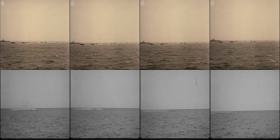

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1944.mp4,00:32:40,00:32:44,4,931672,98.758224,0
SF2410A-C.1.mpg,00:15:13,00:15:17,4,339933,98.758224,0


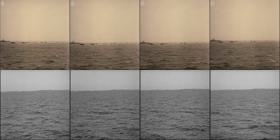

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1944.mp4,00:33:52,00:33:56,4,931744,nan,4
SF2410A-C.1.mpg,00:15:18,00:15:22,4,339938,nan,4


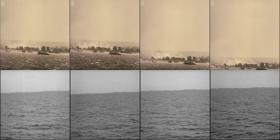

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1944.mp4,00:33:52,00:33:56,4,931744,nan,4
SF2410A-C.1.mpg,00:23:19,00:23:23,4,340419,nan,4


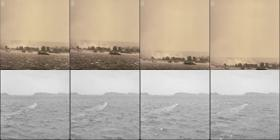

In [70]:
combined_project_finder.show_notebook_sequence(contains_video(combined_project_sequences, 'SF2410A-C.1.mpg', combined_project_finder), show_limit=200, show_shift=False, frame_resize=(70,70), convert_format='JPEG')

In this case, we find that frames depicting an ocean horizon have been excessively matched against ocean horizons in other TV series episodes. While this is technically correct – since the ocean horizons do look very much alike – it is uninteresting for our purposes here. However, skimming through the matching results we do find two interesting sequences. The first depicts an explosion on the ocean horizon, although with a slight time shift. The second sequence shows a correct match between shots land, taken from a boat.

We add the remaining uninteresting ocean horizon sequences to the "Unwanted_frames_2" spreadsheet. We also look through the matching results for the video SF2764.1, SF2554.1, and SF2831A-C.1 and add unwanted frames found there to the same Excel document. In the interest of space, however, these matching results are not displayed in this notebook. 

When the updated Excel sheet is finished, we apply the `remove_unwanted_sequences` function once more and output a sample of what the removed sequences look like to double-check the filtering.

Before removal: 1553 sequences.
After removal: 1322 sequences.
(14.87% removed)


,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:06:04,00:06:26,22,955622,107.429359,16
SF2017.1.mpg,00:03:10,00:03:32,22,12699,107.429359,16


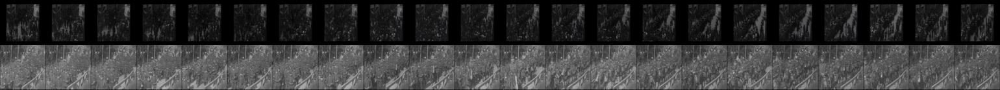

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Förväntningarnas tid_Nya hot och drömmar.mp4,00:35:44,00:36:05,21,897430,104.427605,12
SF2601.1.mpg,00:00:43,00:01:04,21,520133,104.427605,12


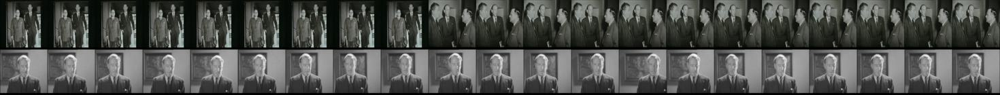

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1940.mp4,00:16:07,00:16:27,20,916750,111.948196,13
SF2886.1.mpg,00:06:38,00:06:58,20,782990,111.948196,13


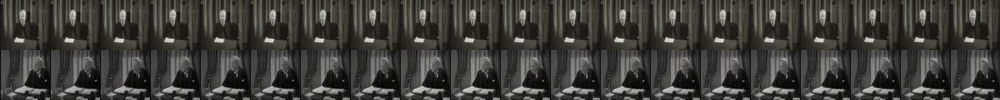

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Förväntningarnas tid_Nya hot och drömmar.mp4,00:35:44,00:36:03,19,897430,112.491554,14
SF2997A-E.1.mpg,00:24:42,00:25:01,19,888984,112.491554,14


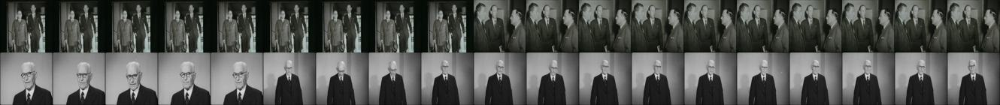

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Förväntningarnas tid_Nya hot och drömmar.mp4,00:35:44,00:36:02,18,897430,113.526711,11
SF2716.1.mpg,00:00:17,00:00:35,18,638228,113.526711,11


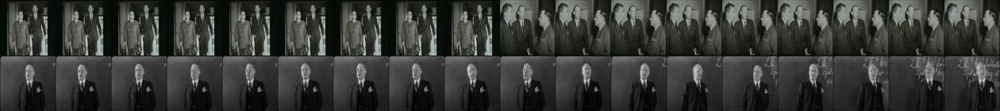

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Förväntningarnas tid_Nya hot och drömmar.mp4,00:35:44,00:36:01,17,897430,113.249069,13
SF2655.1.mpg,00:12:24,00:12:41,17,583267,113.249069,13


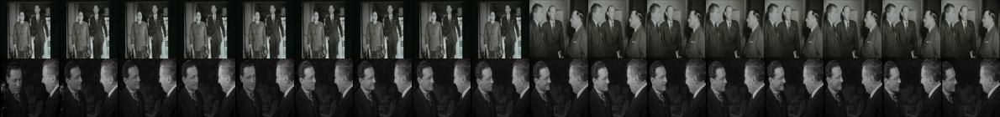

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:06:04,00:06:21,17,955622,104.107063,6
SF2670A-D.1.mpg,00:11:11,00:11:28,17,599629,104.107063,6


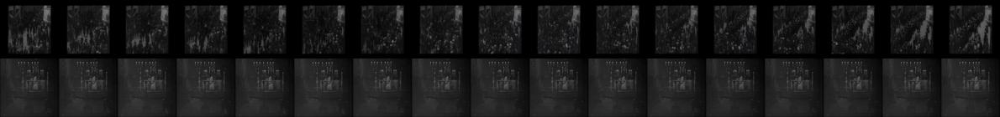

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:24:26,00:24:43,17,967363,104.550415,8
SF2554.1.mpg,00:09:31,00:09:48,17,483886,104.550415,8


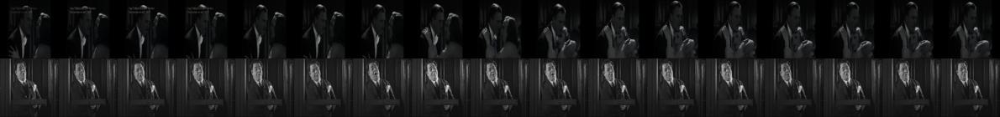

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:24:26,00:24:43,17,967363,103.596512,12
SF2554.1.mpg,00:10:37,00:10:54,17,483952,103.596512,12


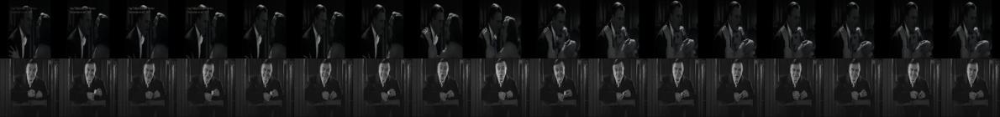

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Handel.webm,00:14:21,00:14:37,16,974725,102.063583,8
SF2304.1.mpg,00:01:58,00:02:14,16,240872,102.063583,8


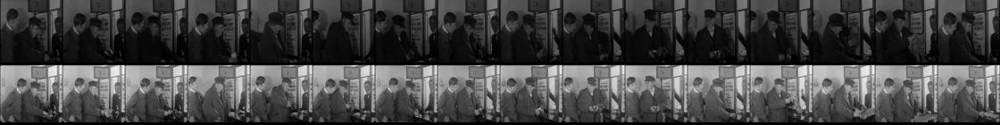

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Å, dyre prins.webm",00:31:58,00:32:14,16,972841,96.550400,9
SF220B.1.mpg,00:12:32,00:12:48,16,154896,96.550400,9


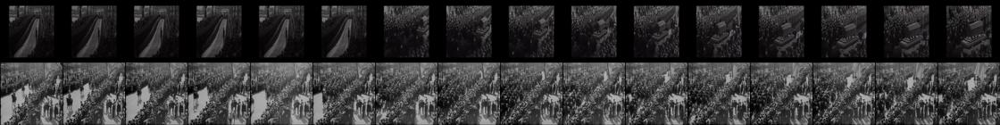

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Å, dyre prins.webm",00:31:58,00:32:13,15,972841,99.980492,9
SF2230.1.mpg,00:02:49,00:03:04,15,179879,99.980492,9


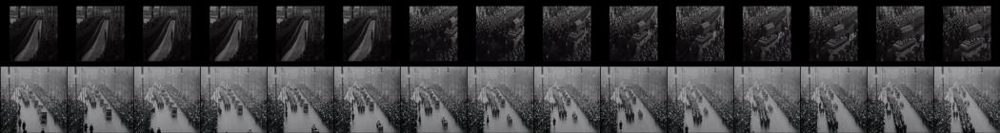

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1944.mp4,00:33:52,00:34:07,15,931744,67.104584,10
SF2410A-C.1.mpg,00:14:47,00:15:02,15,339907,67.104584,10


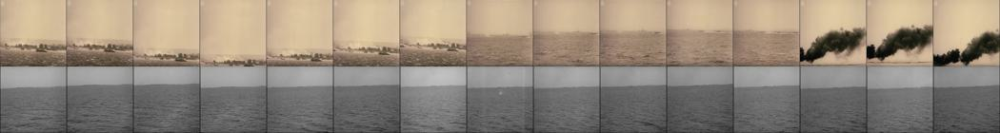

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1944.mp4,00:33:24,00:33:38,14,931716,93.003258,5
SF2410A-C.1.mpg,00:09:47,00:10:01,14,339607,93.003258,5


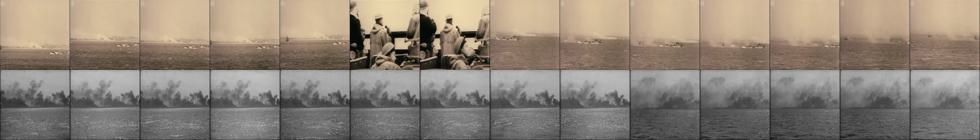

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:32:55,00:33:09,14,957233,100.733345,5
SF220B.1.mpg,00:12:33,00:12:47,14,154897,100.733345,5


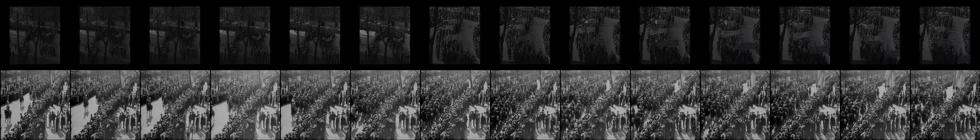

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1942.mp4,00:33:58,00:34:12,14,924809,106.671623,8
SF2789.1.mpg,00:13:36,00:13:50,14,685293,106.671623,8


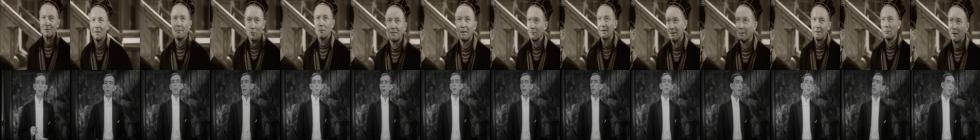

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1944.mp4,00:33:24,00:33:38,14,931716,94.171356,9
SF2410A-C.1.mpg,00:14:47,00:15:01,14,339907,94.171356,9


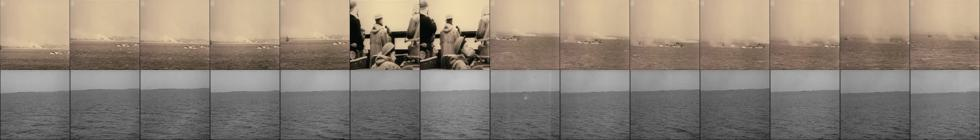

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:24:26,00:24:40,14,967363,97.442802,7
SF2491A-B.1.mpg,00:16:16,00:16:30,14,413256,97.442802,7


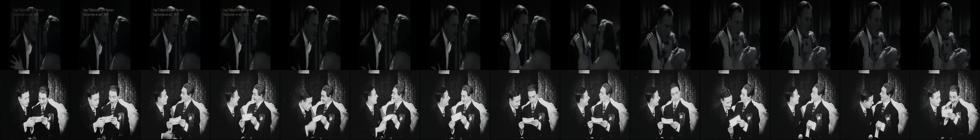

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Jag har varit med om allt som blivit nytt.webm,00:15:08,00:15:21,13,962577,101.209152,5
SF2831A-C.1.mpg,00:17:37,00:17:50,13,721075,101.209152,5


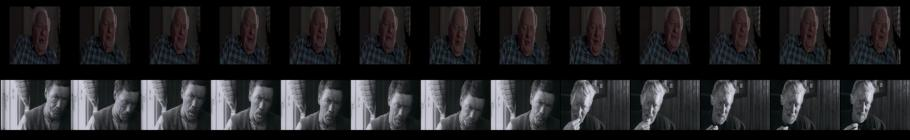

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_De gamla och kloka må le, fallera.webm",00:00:03,00:00:16,13,952250,108.333336,8
SF2131.1.mpg,00:09:54,00:10:07,13,96274,108.333336,8


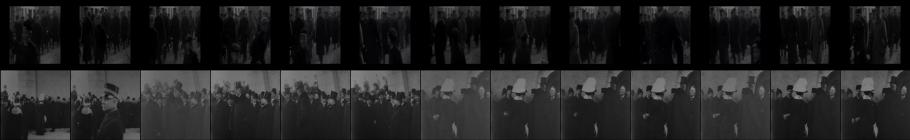

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_De gamla och kloka må le, fallera.webm",00:17:39,00:17:52,13,953306,100.495468,6
SF2605C.1.mpg,00:14:26,00:14:39,13,524542,100.495468,6


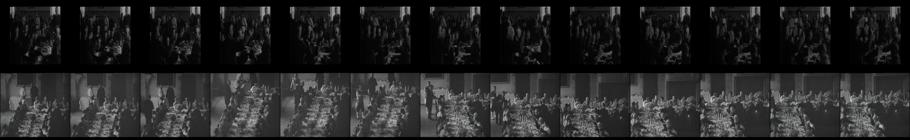

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_De gamla och kloka må le, fallera.webm",00:00:03,00:00:16,13,952250,102.073669,9
SF2457.1.mpg,00:09:11,00:09:24,13,386588,102.073669,9


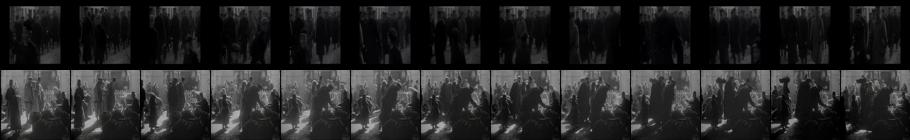

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:19:48,00:20:01,13,967085,103.732338,7
SF2911A.1.mpg,00:01:36,00:01:49,13,812259,103.732338,7


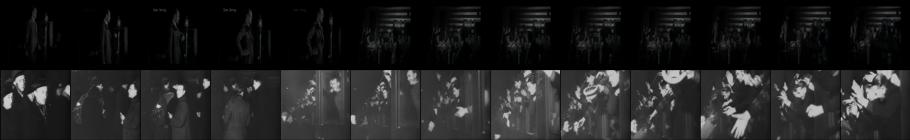

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Förväntningarnas tid_Nya hot och drömmar.mp4,00:35:44,00:35:57,13,897430,107.819557,10
SF2997A-E.1.mpg,00:23:58,00:24:11,13,888940,107.819557,10


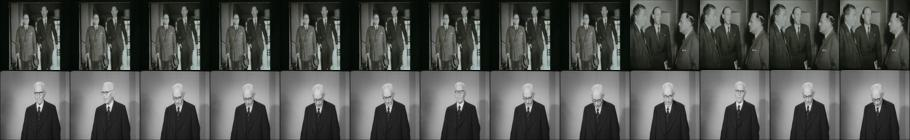

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:14:31,00:14:44,13,956129,102.199310,5
SF2791.1.mpg,00:03:48,00:04:01,13,686516,102.199310,5


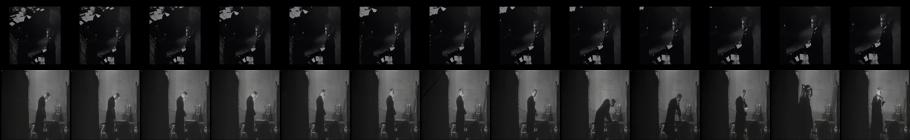

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Å, dyre prins.webm",00:31:58,00:32:11,13,972841,105.076370,11
SF2837B.1.mpg,00:03:20,00:03:33,13,729320,105.076370,11


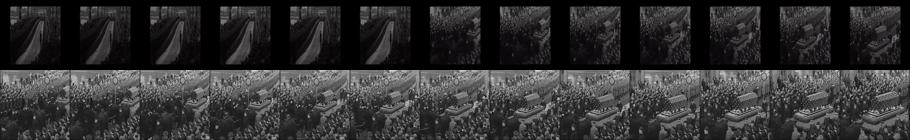

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1944.mp4,00:33:24,00:33:36,12,931716,90.387772,8
SF2410A-C.1.mpg,00:19:43,00:19:55,12,340203,90.387772,8


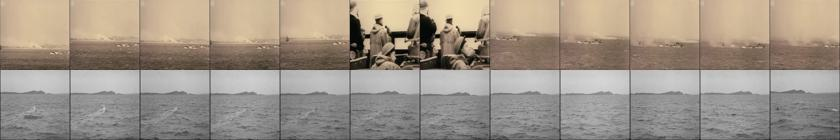

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:01:54,00:02:06,12,955372,115.185547,8
SF2789.1.mpg,00:04:26,00:04:38,12,684743,115.185547,8


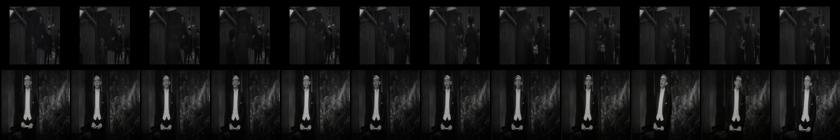

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Handel.webm,00:14:02,00:14:14,12,974706,103.778175,7
SF2626C.1.mpg,00:10:15,00:10:27,12,547746,103.778175,7


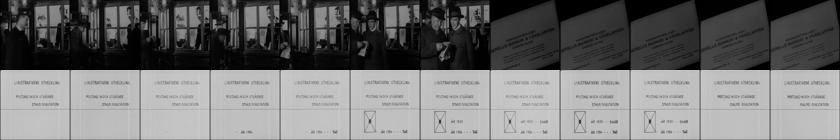

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Handel.webm,00:14:02,00:14:14,12,974706,98.224693,7
SF2545B.1.mpg,00:05:10,00:05:22,12,475628,98.224693,7


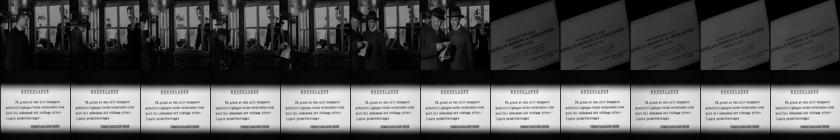

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:04:13,00:04:25,12,966150,109.415840,5
SF2830.1.mpg,00:01:46,00:01:58,12,719430,109.415840,5


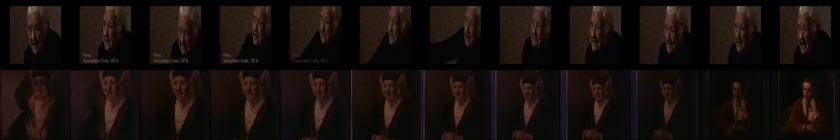

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Å, dyre prins.webm",00:31:58,00:32:10,12,972841,100.026276,9
SF2502D.1.mpg,00:02:56,00:03:08,12,428668,100.026276,9


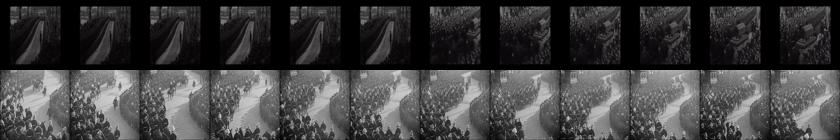

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Å, dyre prins.webm",00:31:58,00:32:10,12,972841,106.130737,7
SF220C.1.mpg,00:12:49,00:13:01,12,155914,106.130737,7


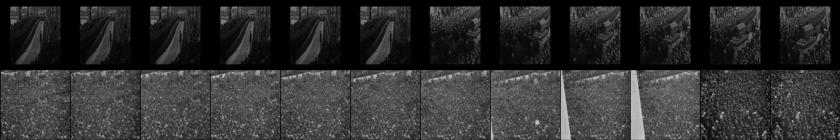

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:30:15,00:30:26,11,957073,98.547340,4
SF2789.1.mpg,00:13:37,00:13:48,11,685294,98.547340,4


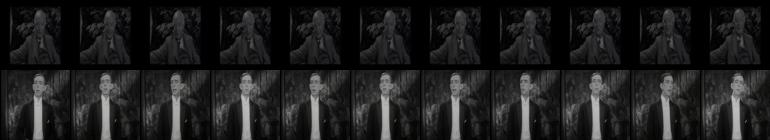

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:30:15,00:30:26,11,957073,97.844521,8
SF2554.1.mpg,00:10:32,00:10:43,11,483947,97.844521,8


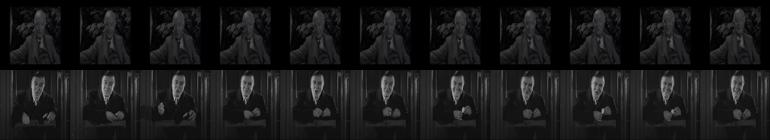

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:30:15,00:30:26,11,957073,96.204063,4
SF2654.1.mpg,00:06:25,00:06:36,11,582339,96.204063,4


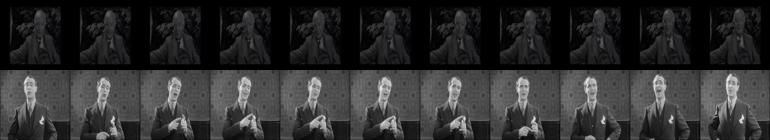

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Förväntningarnas tid_Nya hot och drömmar.mp4,00:35:44,00:35:55,11,897430,109.926186,6
SF2604.1.mpg,00:00:06,00:00:17,11,522294,109.926186,6


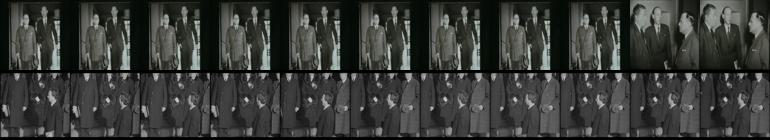

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Förväntningarnas tid_Nya hot och drömmar.mp4,00:35:44,00:35:55,11,897430,114.885620,10
SF2998A-F.1.mpg,00:04:54,00:05:05,11,890727,114.885620,10


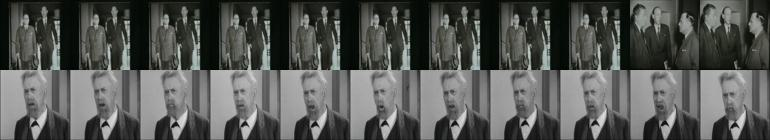

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:30:15,00:30:26,11,957073,97.305122,5
SF2654.1.mpg,00:06:58,00:07:09,11,582372,97.305122,5


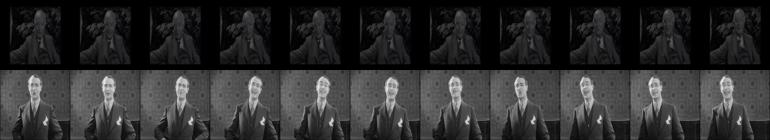

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:30:15,00:30:26,11,957073,93.233543,4
SF2805.1.mpg,00:00:32,00:00:43,11,696199,93.233543,4


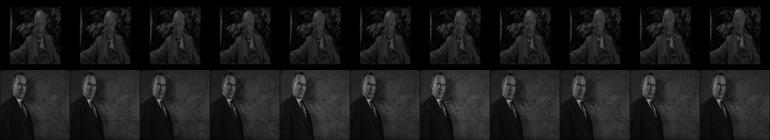

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1942.mp4,00:34:29,00:34:40,11,924840,115.732658,5
SF2789.1.mpg,00:13:48,00:13:59,11,685305,115.732658,5


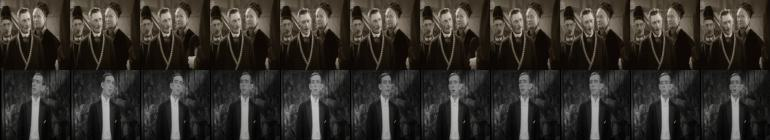

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:06:04,00:06:15,11,955622,99.125694,5
SF264.1.mpg,00:04:38,00:04:49,11,560247,99.125694,5


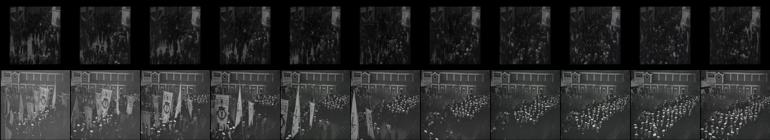

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:30:15,00:30:26,11,957073,97.268242,3
SF2764.1.mpg,00:03:33,00:03:44,11,668238,97.268242,3


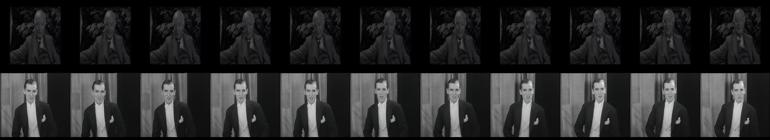

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:30:15,00:30:26,11,957073,84.205643,3
SF2789.1.mpg,00:05:27,00:05:38,11,684804,84.205643,3


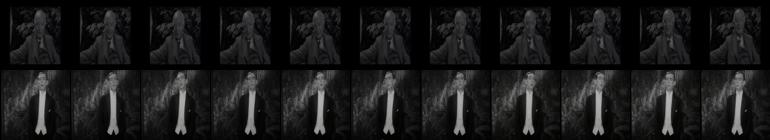

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1948.webm,00:19:22,00:19:32,10,946517,108.442284,3
SF2491A-B.1.mpg,00:16:15,00:16:25,10,413255,108.442284,3


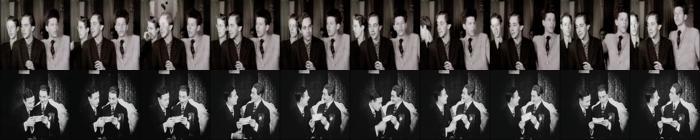

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1942.mp4,00:31:08,00:31:18,10,924639,107.395912,3
SF2764.1.mpg,00:03:34,00:03:44,10,668239,107.395912,3


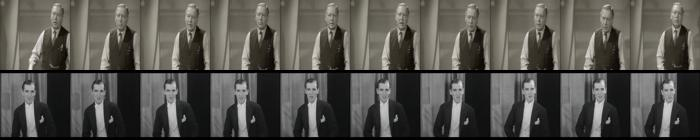

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:24:26,00:24:36,10,967363,nan,10
SF2189.1.mpg,00:01:11,00:01:21,10,136368,nan,10


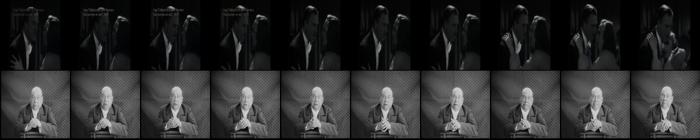

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1948.webm,00:19:22,00:19:32,10,946517,93.465157,2
SF2764.1.mpg,00:03:33,00:03:43,10,668238,93.465157,2


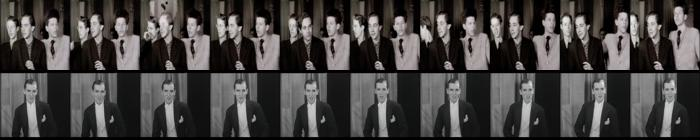

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:30:15,00:30:25,10,957073,97.866524,4
SF2764.1.mpg,00:03:03,00:03:13,10,668208,97.866524,4


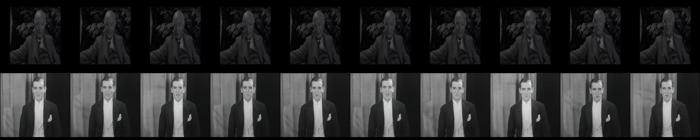

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:30:15,00:30:25,10,957073,99.792374,2
SF2764.1.mpg,00:03:58,00:04:08,10,668263,99.792374,2


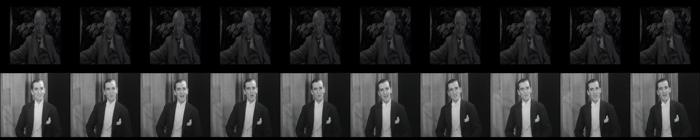

In [71]:
before_set_combined = set(combined_project_sequences)
SequenceFinder.remove_unwanted_sequences(combined_project_sequences, combined_project, 'TV_unwanted_frames_2.xlsx')
after_set_combined = set(combined_project_sequences)
print(f'Before removal: {len(before_set_combined)} sequences.\nAfter removal: {len(after_set_combined)} sequences.\n({(len(before_set_combined)-len(after_set_combined)) / len(before_set_combined)*100:.2f}% removed)')
combined_project_finder.show_notebook_sequence(before_set_combined.difference(after_set_combined), show_limit=50, show_shift=False, frame_resize=(70,70), convert_format='JPEG')

We look at the remaining matching results in the form of a bar plot once more.

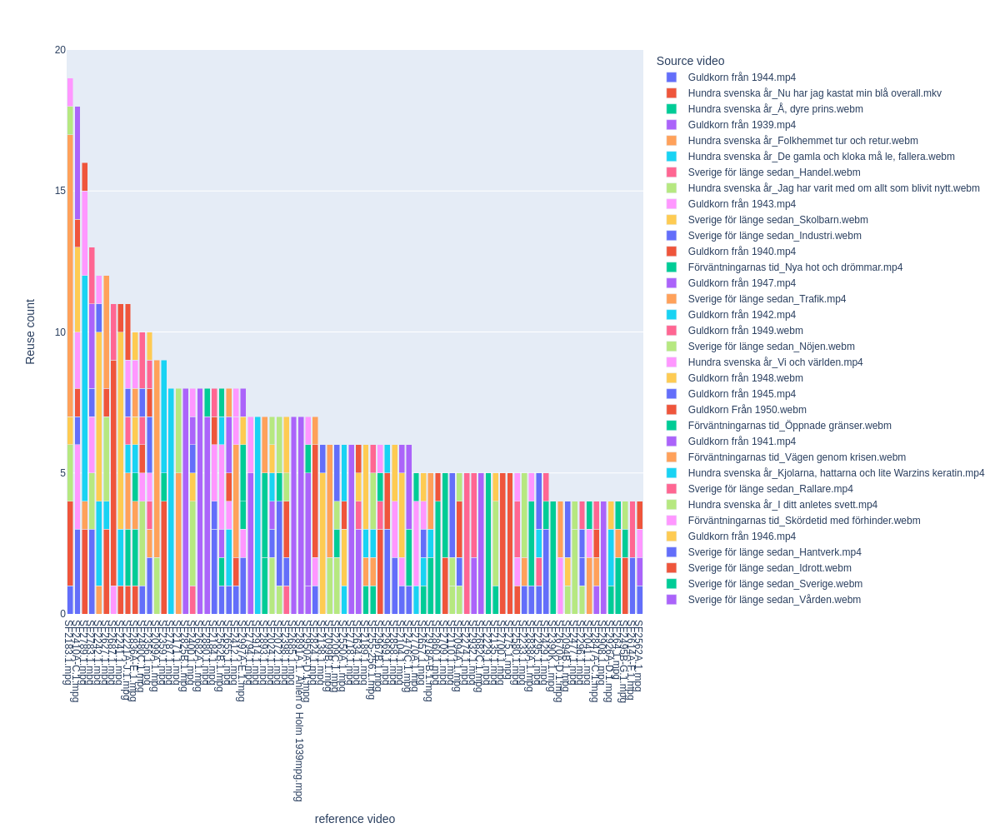

In [72]:
combined_project.show_most_reused_files(combined_project_sequences, video_list=TV_dataset_project.frame_extractor.video_list,size=(1200, 1000))

And output the remaining matching results as thumbnail previews. Once more, the longest found sequence will be shown first and we limit the number of shown sequences to 200.

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1942.mp4,00:10:06,00:12:04,118,923377,56.226704,17
SF2914.1.mpg,00:08:44,00:10:42,118,815376,56.226704,17


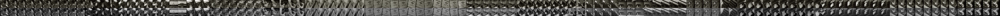

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1942.mp4,00:07:09,00:08:31,82,923200,69.738831,53
SF2914.1.mpg,00:04:26,00:05:48,82,815118,69.738831,53


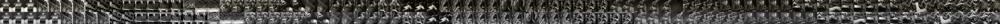

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1942.mp4,00:05:45,00:07:05,80,923116,60.305912,11
SF2914.1.mpg,00:02:17,00:03:37,80,814989,60.305912,11


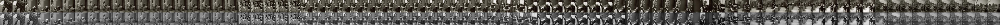

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1942.mp4,00:08:38,00:09:54,76,923289,60.310738,7
SF2914.1.mpg,00:05:57,00:07:13,76,815209,60.310738,7


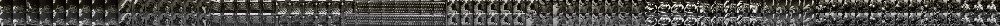

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1939.mp4,00:21:03,00:22:06,63,913542,76.565796,12
SF2908.1.mpg,00:05:27,00:06:30,63,809048,76.565796,12


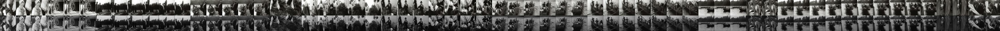

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1939.mp4,00:22:11,00:23:09,58,913610,95.022957,23
SF2908.1.mpg,00:06:35,00:07:33,58,809116,95.022957,23


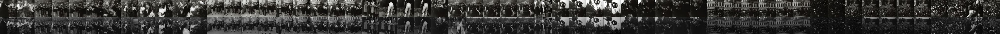

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Nöjen.webm,00:10:16,00:11:14,58,978667,93.224342,14
SF2171.1.mpg,00:05:21,00:06:19,58,124978,93.224342,14


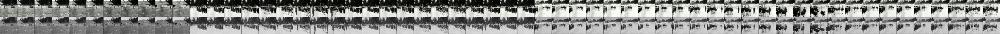

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1942.mp4,00:04:54,00:05:44,50,923065,52.389378,5
SF2914.1.mpg,00:00:21,00:01:11,50,814873,52.389378,5


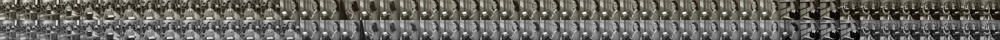

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1939.mp4,00:20:09,00:20:58,49,913488,84.219406,14
SF2908.1.mpg,00:04:33,00:05:22,49,808994,84.219406,14


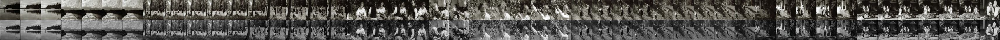

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1939.mp4,00:05:21,00:06:09,48,912600,57.845322,5
SF2891A.1. Åhlen o Holm 1939mpg.mpg,00:05:46,00:06:34,48,786031,57.845322,5


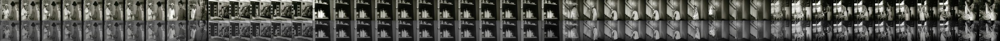

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1939.mp4,00:16:16,00:17:03,47,913255,76.669266,9
SF2685.1.mpg,00:02:41,00:03:28,47,615531,76.669266,9


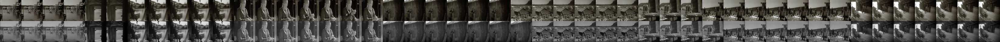

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1939.mp4,00:11:46,00:12:31,45,912985,83.681335,25
SF2880.1.mpg,00:00:00,00:00:45,45,778198,83.681335,25


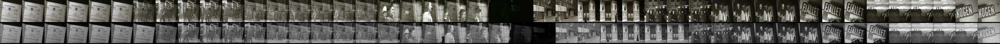

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Trafik.mp4,00:12:18,00:13:02,44,983050,93.602379,17
SF2171.1.mpg,00:09:06,00:09:50,44,125203,93.602379,17


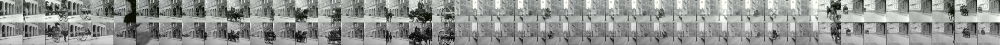

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1940.mp4,00:25:38,00:26:21,43,917321,86.894432,21
SF2687.1.mpg,00:09:23,00:10:06,43,616993,86.894432,21


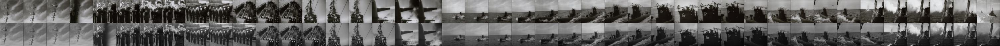

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1939.mp4,00:34:38,00:35:17,39,914357,73.552811,12
SF2682A.1.mpg,00:01:36,00:02:15,39,612719,73.552811,12


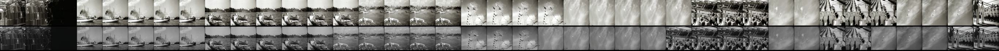

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1939.mp4,00:03:14,00:03:52,38,912473,82.992157,8
SF2891A.1. Åhlen o Holm 1939mpg.mpg,00:01:43,00:02:21,38,785788,82.992157,8


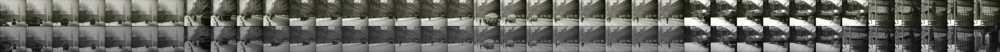

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1939.mp4,00:13:46,00:14:24,38,913105,79.497665,3
SF2880.1.mpg,00:03:28,00:04:06,38,778406,79.497665,3


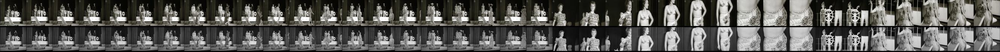

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1939.mp4,00:17:21,00:17:59,38,913320,70.479393,0
SF2685.1.mpg,00:05:40,00:06:18,38,615710,70.479393,0


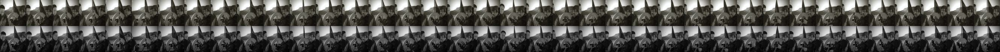

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1947.mp4,00:28:55,00:29:32,37,943731,92.652832,4
SF2825B.1.mpg,00:04:29,00:05:06,37,715778,92.652832,4


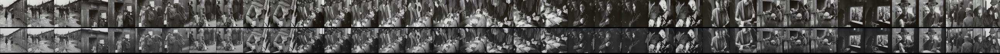

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_De gamla och kloka må le, fallera.webm",00:04:03,00:04:40,37,952490,88.195404,25
SF217.1.mpg,00:09:21,00:09:58,37,123903,88.195404,25


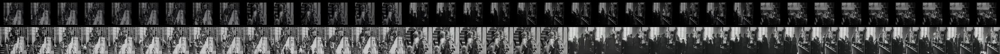

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1939.mp4,00:03:54,00:04:30,36,912513,50.344997,0
SF2891A.1. Åhlen o Holm 1939mpg.mpg,00:03:28,00:04:04,36,785893,50.344997,0


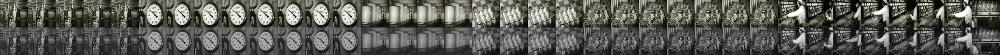

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1939.mp4,00:45:25,00:46:00,35,915004,95.372627,10
SF2718.1.mpg,00:08:54,00:09:29,35,640110,95.372627,10


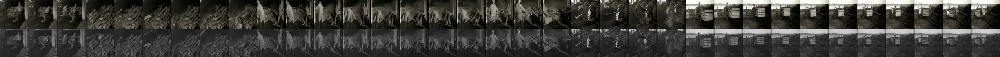

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Skolbarn.webm,00:03:03,00:03:37,34,980328,85.450867,6
SF2242.1.mpg,00:02:21,00:02:55,34,187366,85.450867,6


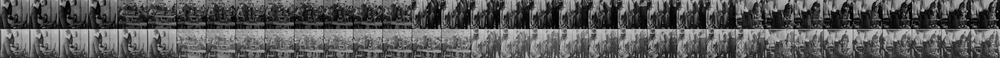

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1939.mp4,00:13:13,00:13:45,32,913072,84.782234,3
SF2880.1.mpg,00:02:32,00:03:04,32,778350,84.782234,3


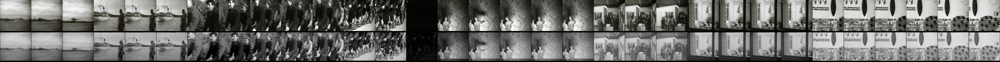

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1939.mp4,00:04:43,00:05:13,30,912562,71.237610,9
SF2891A.1. Åhlen o Holm 1939mpg.mpg,00:04:49,00:05:19,30,785974,71.237610,9


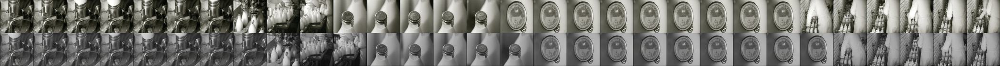

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1939.mp4,00:46:07,00:46:36,29,915046,78.378021,11
SF2718.1.mpg,00:09:57,00:10:26,29,640173,78.378021,11


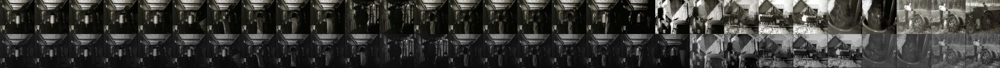

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Skolbarn.webm,00:15:52,00:16:21,29,981097,91.764587,26
SF2138.1.mpg,00:06:57,00:07:26,29,100836,91.764587,26


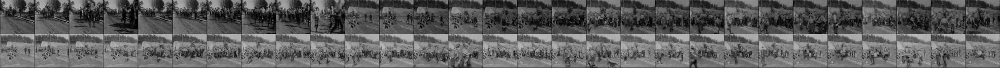

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1941.mp4,00:33:56,00:34:24,28,921298,88.743309,5
SF2794.1.mpg,00:01:22,00:01:50,28,688154,88.743309,5


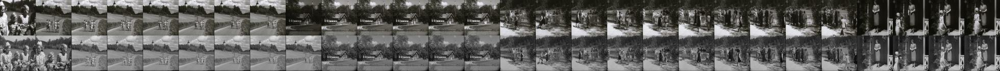

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Handel.webm,00:11:40,00:12:08,28,974564,96.281219,12
SF267.1.mpg,00:03:42,00:04:10,28,598437,96.281219,12


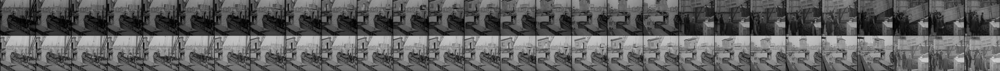

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Trafik.mp4,00:17:20,00:17:47,27,983352,91.839058,18
SF2183.1.mpg,00:10:31,00:10:58,27,133227,91.839058,18


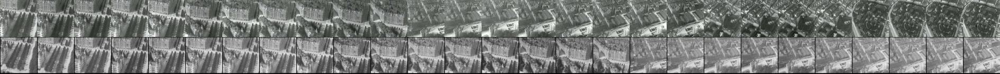

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Handel.webm,00:12:18,00:12:44,26,974602,98.521385,11
SF2209A.1.mpg,00:01:46,00:02:12,26,151314,98.521385,11


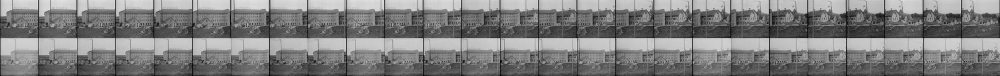

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Handel.webm,00:15:40,00:16:05,25,974804,97.920235,16
SF2265.1.mpg,00:06:42,00:07:07,25,205363,97.920235,16


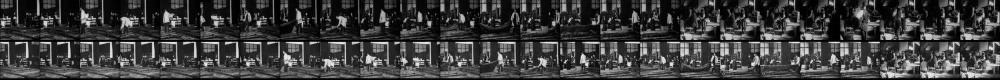

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Handel.webm,00:17:08,00:17:33,25,974892,93.782288,13
SF2304.1.mpg,00:12:28,00:12:53,25,241502,93.782288,13


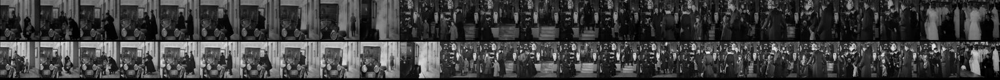

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1939.mp4,00:33:36,00:34:00,24,914295,95.200233,15
SF2682A.1.mpg,00:00:33,00:00:57,24,612656,95.200233,15


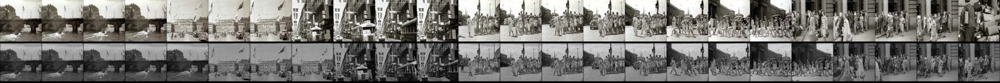

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Å, dyre prins.webm",00:03:52,00:04:16,24,971155,81.691032,11
SF2129.1.mpg,00:02:39,00:03:03,24,94304,81.691032,11


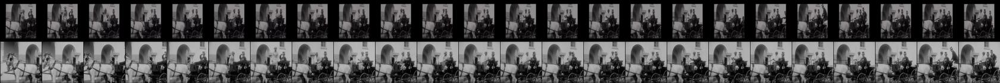

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1939.mp4,00:15:49,00:16:12,23,913228,71.239296,12
SF2685.1.mpg,00:01:22,00:01:45,23,615452,71.239296,12


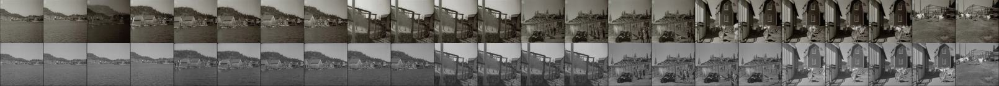

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Å, dyre prins.webm",00:06:25,00:06:46,21,971308,99.447853,11
SF2221A-J.1.mpg,00:30:52,00:31:13,21,169552,99.447853,11


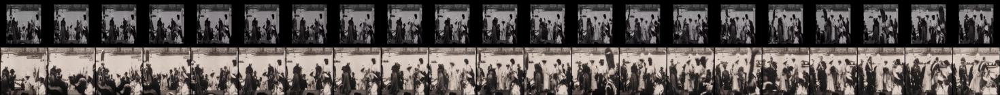

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Handel.webm,00:03:17,00:03:38,21,974061,88.864342,1
SF2050.1.mpg,00:05:33,00:05:54,21,35567,88.864342,1


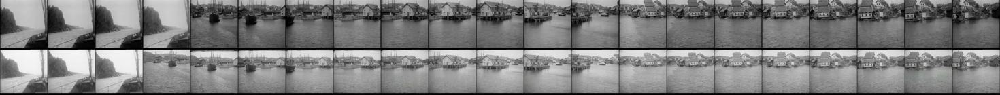

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1939.mp4,00:15:24,00:15:44,20,913203,81.614304,5
SF2685.1.mpg,00:00:34,00:00:54,20,615404,81.614304,5


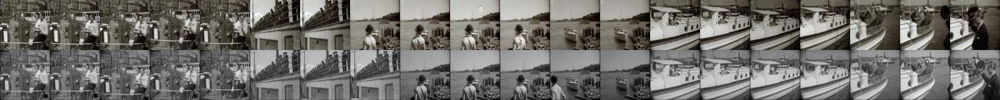

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1939.mp4,00:44:37,00:44:57,20,914956,88.384430,4
SF2718.1.mpg,00:06:41,00:07:01,20,639977,88.384430,4


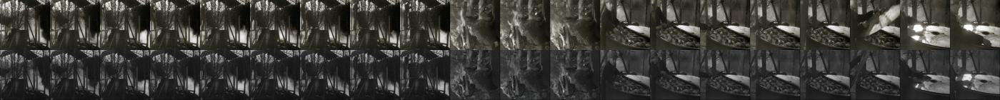

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Handel.webm,00:08:46,00:09:06,20,974390,115.262207,19
SF2826.1.mpg,00:03:37,00:03:57,20,716312,115.262207,19


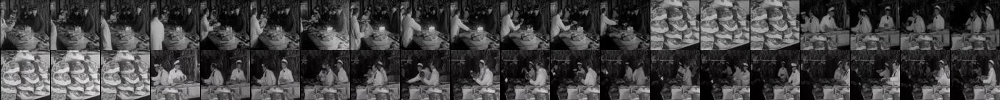

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1941.mp4,00:35:24,00:35:43,19,921386,85.310341,6
SF2794.1.mpg,00:09:25,00:09:44,19,688637,85.310341,6


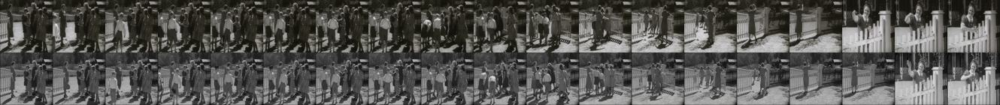

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Industri.webm,00:04:14,00:04:33,19,977236,91.588692,8
SF2140B.1.mpg,00:06:00,00:06:19,19,103336,91.588692,8


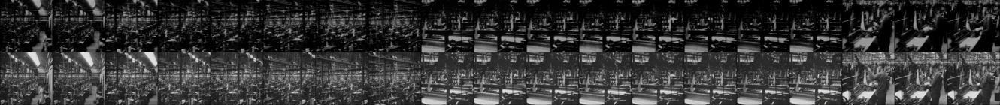

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Skolbarn.webm,00:15:52,00:16:11,19,981097,94.077087,18
SF2195.1.mpg,00:04:02,00:04:21,19,141027,94.077087,18


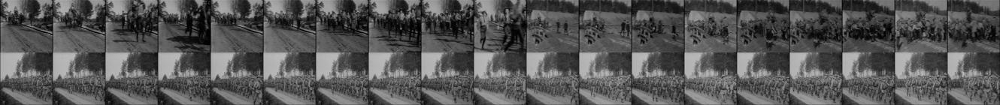

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1941.mp4,00:00:27,00:00:45,18,919289,83.970291,5
SF2554.1.mpg,00:00:26,00:00:44,18,483341,83.970291,5


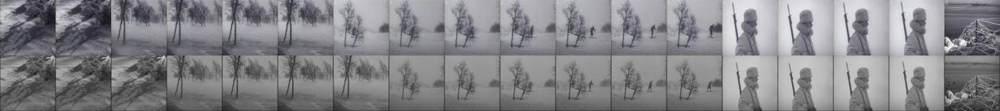

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1947.mp4,00:27:49,00:28:07,18,943665,93.706558,4
SF2825B.1.mpg,00:03:10,00:03:28,18,715699,93.706558,4


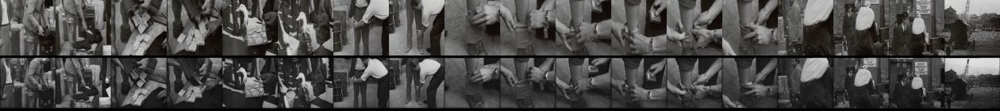

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Nöjen.webm,00:07:17,00:07:35,18,978488,93.325912,1
SF2183.1.mpg,00:02:44,00:03:02,18,132760,93.325912,1


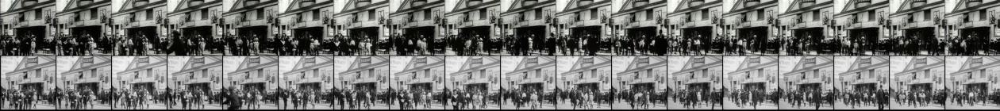

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Nöjen.webm,00:08:37,00:08:55,18,978568,102.741455,5
SF2218.1.mpg,00:01:41,00:01:59,18,162464,102.741455,5


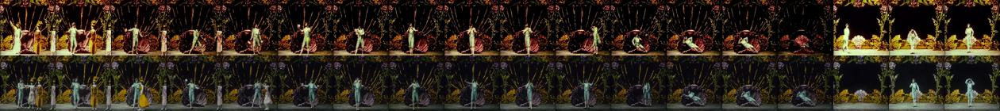

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1939.mp4,00:14:29,00:14:46,17,913148,80.564018,2
SF2880.1.mpg,00:04:11,00:04:28,17,778449,80.564018,2


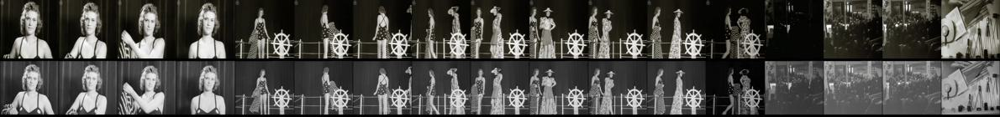

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1939.mp4,00:38:12,00:38:29,17,914571,97.639130,5
SF2682C.1.mpg,00:01:07,00:01:24,17,613846,97.639130,5


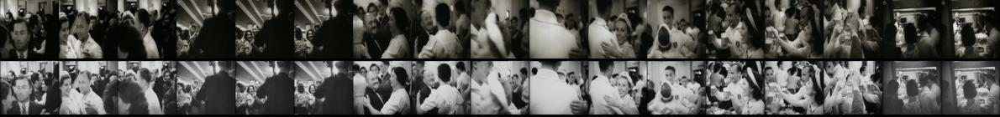

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1940.mp4,00:31:12,00:31:29,17,917655,80.061638,5
SF2687.1.mpg,00:13:16,00:13:33,17,617226,80.061638,5


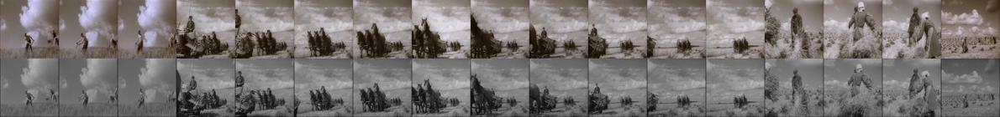

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_De gamla och kloka må le, fallera.webm",00:24:06,00:24:23,17,953693,88.486397,6
SF260A.1.mpg,00:00:03,00:00:20,17,527820,88.486397,6


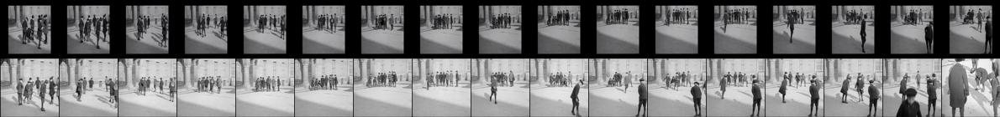

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:10:53,00:11:10,17,966550,95.618584,10
SF2042.1.mpg,00:09:24,00:09:41,17,30821,95.618584,10


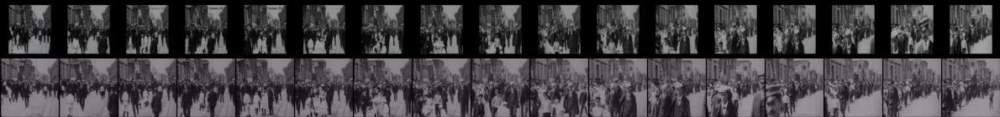

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:18:33,00:18:50,17,967010,90.173630,4
SF2627.1.mpg,00:10:08,00:10:25,17,548690,90.173630,4


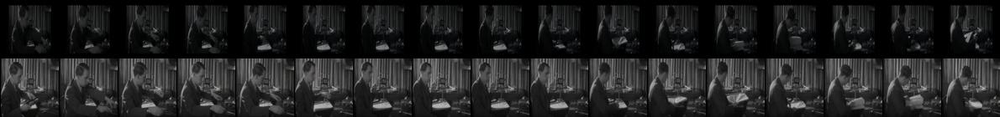

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Å, dyre prins.webm",00:08:00,00:08:17,17,971403,103.266663,5
SF2283B.1.mpg,00:07:56,00:08:13,17,225887,103.266663,5


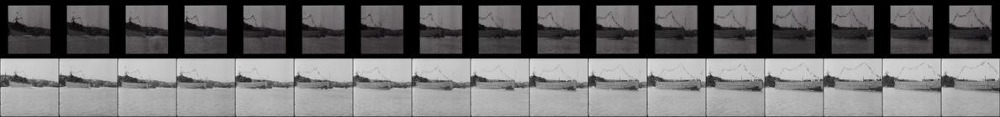

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Å, dyre prins.webm",00:08:00,00:08:17,17,971403,98.196915,7
SF2283C.1.mpg,00:10:07,00:10:24,17,226638,98.196915,7


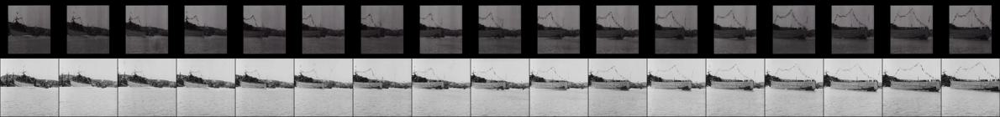

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Å, dyre prins.webm",00:10:39,00:10:56,17,971562,93.725479,3
SF2835.1.mpg,00:02:43,00:03:00,17,724451,93.725479,3


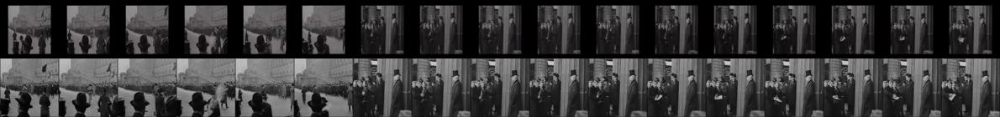

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Handel.webm,00:08:46,00:09:03,17,974390,81.673904,4
SF2826.1.mpg,00:03:18,00:03:35,17,716293,81.673904,4


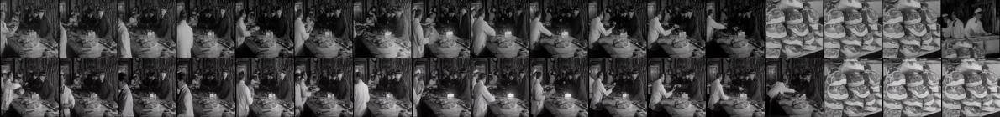

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1939.mp4,00:44:15,00:44:31,16,914934,73.343857,6
SF2718.1.mpg,00:06:18,00:06:34,16,639954,73.343857,6


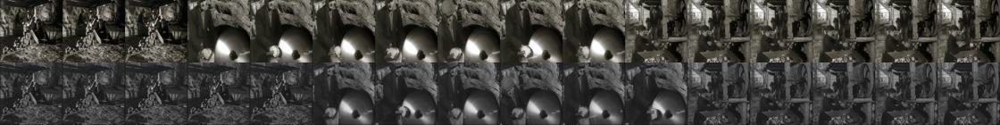

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1940.mp4,00:24:52,00:25:08,16,917275,83.044075,4
SF2687.1.mpg,00:08:38,00:08:54,16,616948,83.044075,4


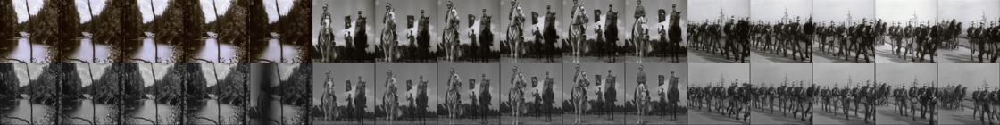

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1941.mp4,00:35:50,00:36:06,16,921412,97.103973,4
SF2794.1.mpg,00:09:52,00:10:08,16,688664,97.103973,4


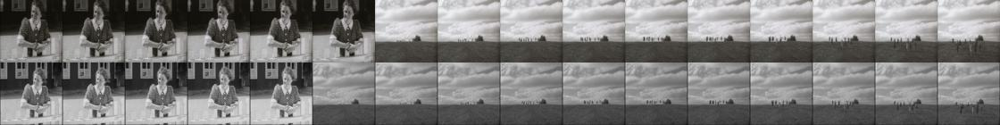

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:10:01,00:10:17,16,966498,103.371338,5
SF275.1.mpg,00:03:12,00:03:28,16,661983,103.371338,5


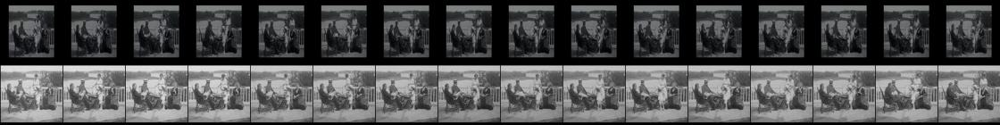

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Vi och världen.mp4,00:31:33,00:31:49,16,970787,83.155052,4
SF2770A.1.mpg,00:02:36,00:02:52,16,670875,83.155052,4


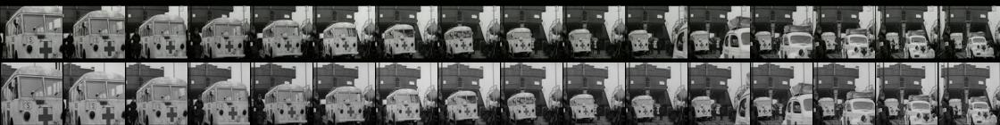

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Handel.webm,00:04:21,00:04:37,16,974125,88.328865,4
SF29.1.mpg,00:01:28,00:01:44,16,800984,88.328865,4


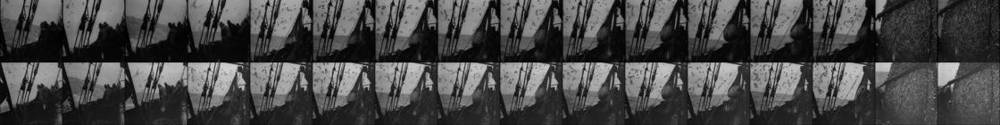

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Handel.webm,00:15:40,00:15:56,16,974804,54.748951,0
SF2064A.1.mpg,00:08:38,00:08:54,16,47088,54.748951,0


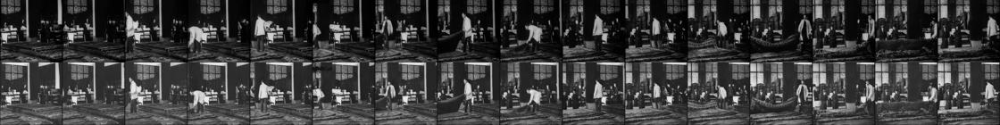

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Industri.webm,00:16:04,00:16:20,16,977946,87.264954,2
SF2480.B.Agafyr mm.1924mpg.mpg,00:01:15,00:01:31,16,404755,87.264954,2


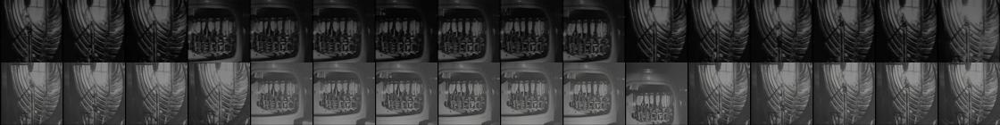

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Nöjen.webm,00:08:16,00:08:32,16,978547,100.743408,8
SF2218.1.mpg,00:01:20,00:01:36,16,162443,100.743408,8


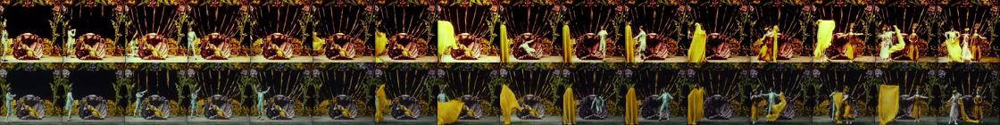

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Trafik.mp4,00:00:53,00:01:09,16,982365,95.031929,5
SF2412.1.mpg,00:09:31,00:09:47,16,341966,95.031929,5


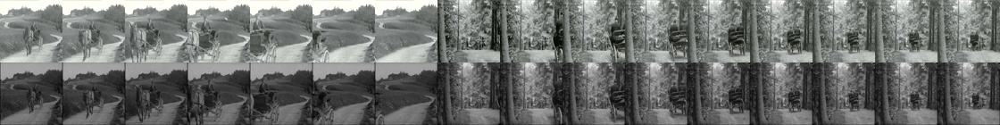

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Trafik.mp4,00:01:09,00:01:25,16,982381,93.782448,10
SF2412.1.mpg,00:10:05,00:10:21,16,342000,93.782448,10


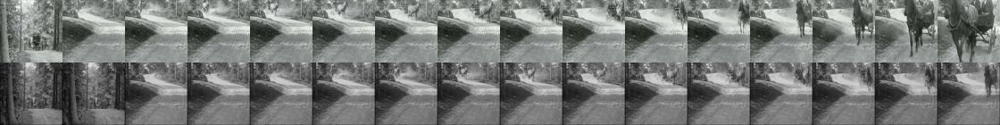

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Trafik.mp4,00:15:49,00:16:05,16,983261,93.637268,7
SF2099A.1.mpg,00:01:31,00:01:47,16,70143,93.637268,7


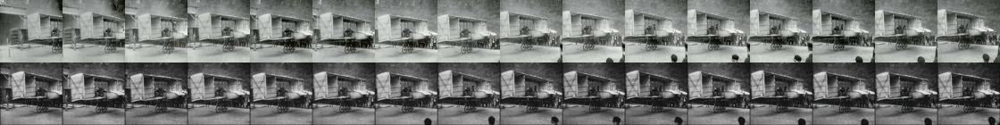

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Trafik.mp4,00:16:31,00:16:47,16,983303,97.617310,8
SF2108.1.mpg,00:07:26,00:07:42,16,79573,97.617310,8


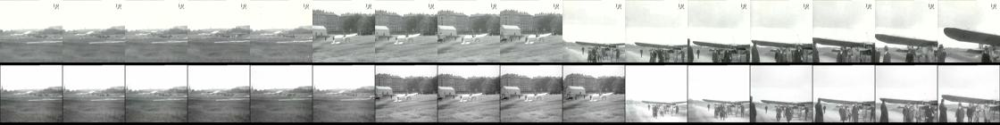

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1939.mp4,00:17:04,00:17:19,15,913303,90.671959,3
SF2685.1.mpg,00:04:10,00:04:25,15,615620,90.671959,3


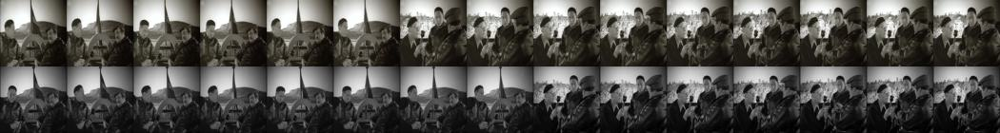

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1939.mp4,00:18:02,00:18:17,15,913361,83.485077,6
SF2880.1.mpg,00:04:51,00:05:06,15,778489,83.485077,6


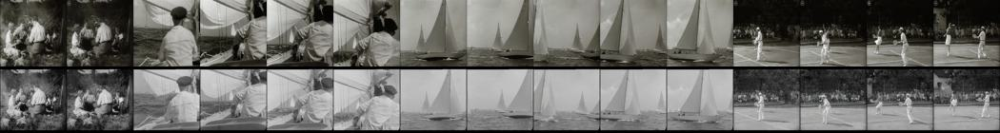

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1942.mp4,00:12:11,00:12:26,15,923502,59.148247,2
SF2914.1.mpg,00:10:49,00:11:04,15,815501,59.148247,2


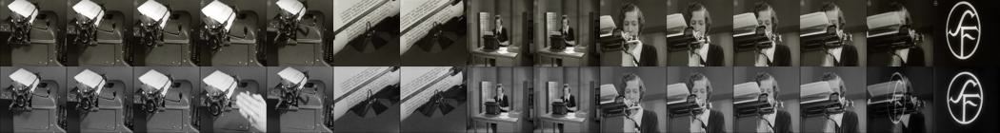

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1942.mp4,00:19:27,00:19:42,15,923938,61.278362,0
SF2621.1.mpg,00:01:27,00:01:42,15,542242,61.278362,0


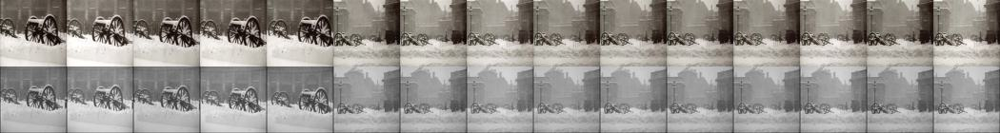

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_De gamla och kloka må le, fallera.webm",00:03:12,00:03:27,15,952439,83.379608,9
SF2241.1.mpg,00:00:40,00:00:55,15,186757,83.379608,9


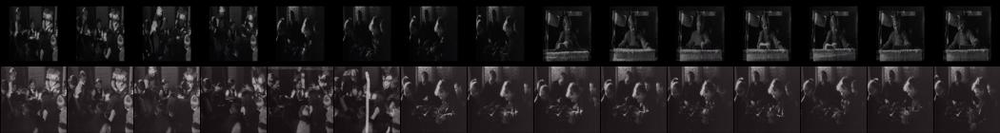

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_De gamla och kloka må le, fallera.webm",00:03:12,00:03:27,15,952439,89.617134,10
SF2241.1.mpg,00:02:38,00:02:53,15,186875,89.617134,10


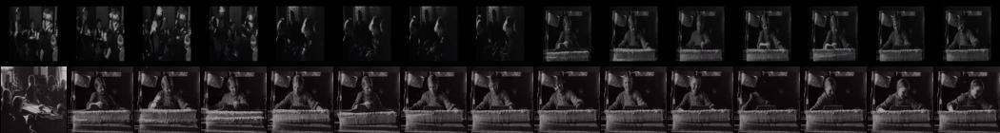

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_I ditt anletes svett.mp4,00:35:30,00:35:45,15,960421,91.540962,2
SF2635B.1.mpg,00:01:56,00:02:11,15,556411,91.540962,2


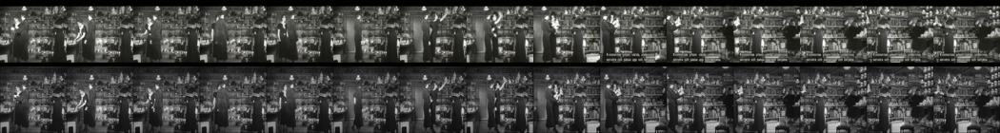

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Jag har varit med om allt som blivit nytt.webm,00:09:39,00:09:54,15,962248,86.548462,6
SF2183.1.mpg,00:11:22,00:11:37,15,133278,86.548462,6


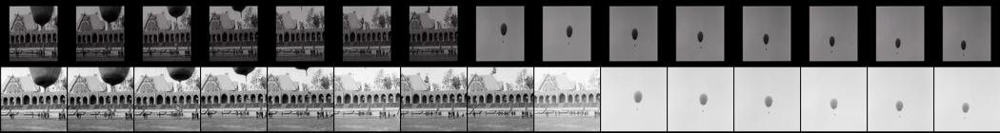

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Kjolarna, hattarna och lite Warzins keratin.mp4",00:03:15,00:03:30,15,964817,92.787041,5
SF2500A.1.mpg,00:06:52,00:07:07,15,424577,92.787041,5


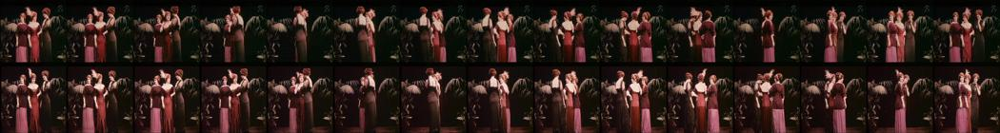

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:03:17,00:03:32,15,966094,85.655487,0
SF2183.1.mpg,00:02:44,00:02:59,15,132760,85.655487,0


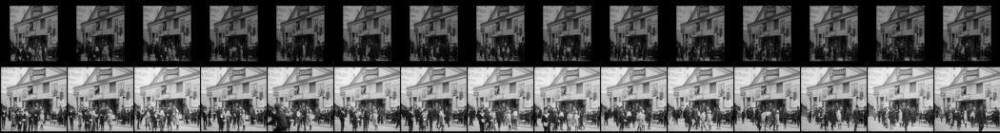

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Handel.webm,00:01:12,00:01:27,15,973936,95.767464,5
SF2644A.1.mpg,00:01:18,00:01:33,15,562857,95.767464,5


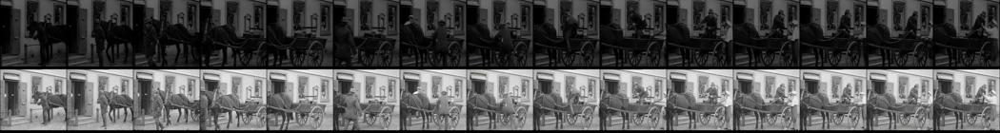

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Handel.webm,00:01:48,00:02:03,15,973972,92.135399,8
SF2028.1.mpg,00:03:18,00:03:33,15,20488,92.135399,8


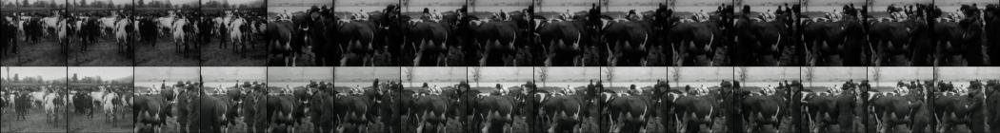

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Handel.webm,00:06:51,00:07:06,15,974275,87.385628,2
SF2064A.1.mpg,00:03:13,00:03:28,15,46763,87.385628,2


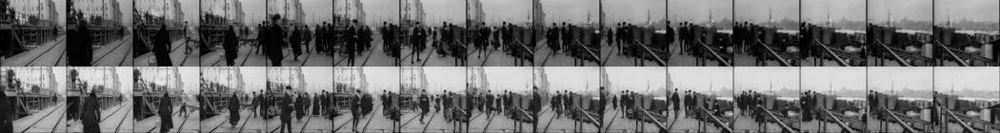

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Handel.webm,00:11:18,00:11:33,15,974542,92.195030,6
SF2274.1.mpg,00:05:51,00:06:06,15,217963,92.195030,6


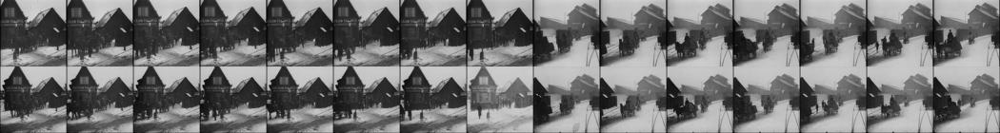

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Handel.webm,00:17:36,00:17:51,15,974920,101.122185,7
SF2304.1.mpg,00:12:58,00:13:13,15,241532,101.122185,7


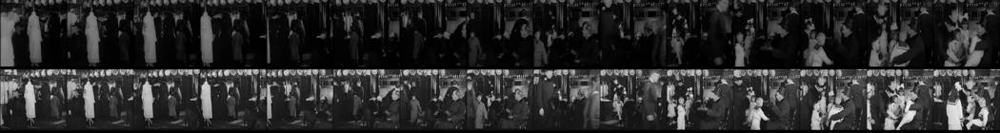

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Nöjen.webm,00:09:18,00:09:33,15,978609,86.525040,6
SF2062A.1.mpg,00:04:49,00:05:04,15,45348,86.525040,6


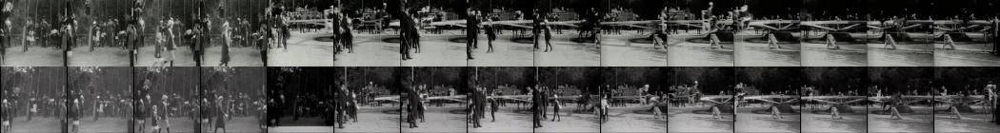

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Nöjen.webm,00:12:01,00:12:16,15,978772,81.482735,0
SF292.1.mpg,00:01:43,00:01:58,15,818808,81.482735,0


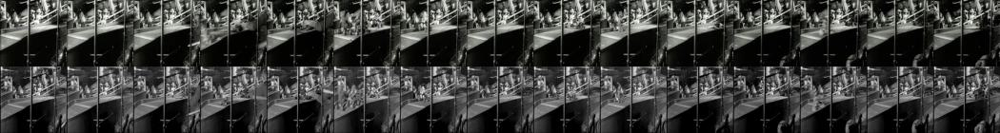

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Skolbarn.webm,00:15:52,00:16:07,15,981097,82.878174,14
SF2863A.1.mpg,00:08:36,00:08:51,15,755025,82.878174,14


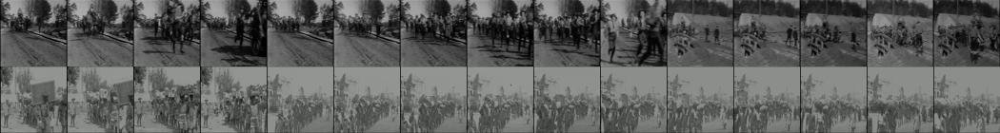

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Trafik.mp4,00:08:48,00:09:03,15,982840,94.334030,8
SF2183.1.mpg,00:02:20,00:02:35,15,132736,94.334030,8


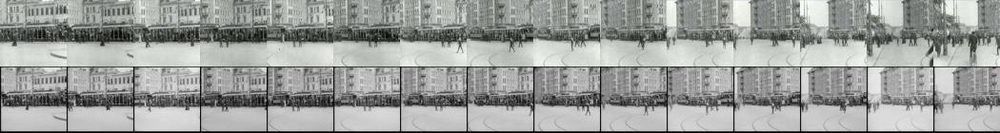

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1939.mp4,00:17:04,00:17:18,14,913303,92.314377,9
SF2685.1.mpg,00:03:50,00:04:04,14,615600,92.314377,9


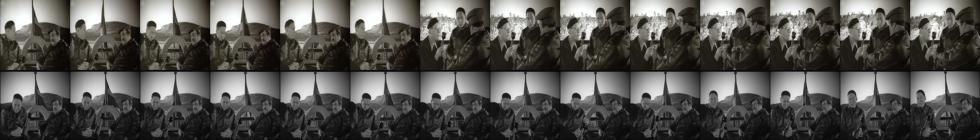

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1939.mp4,00:35:31,00:35:45,14,914410,96.707809,5
SF2682A.1.mpg,00:02:29,00:02:43,14,612772,96.707809,5


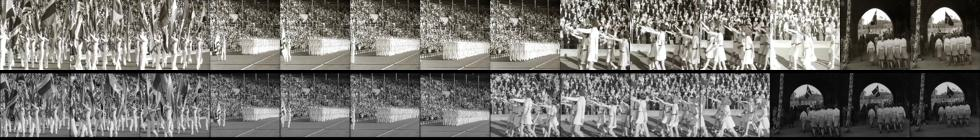

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1947.mp4,00:42:01,00:42:15,14,944517,93.500954,8
SF2476C.1.mpg,00:09:01,00:09:15,14,400991,93.500954,8


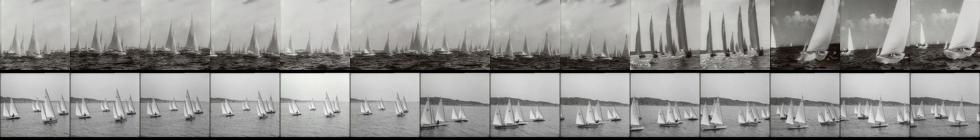

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1947.mp4,00:42:01,00:42:15,14,944517,94.194725,9
SF2695.1.mpg,00:00:56,00:01:10,14,623395,94.194725,9


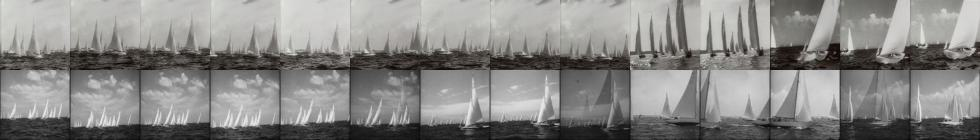

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1947.mp4,00:42:01,00:42:15,14,944517,81.846207,7
SF273.1.mpg,00:03:47,00:04:01,14,647104,81.846207,7


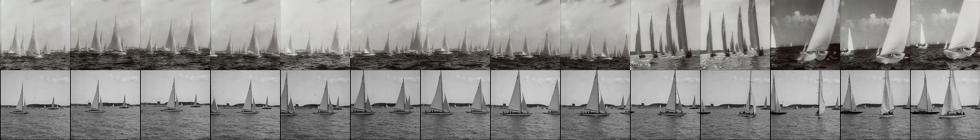

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:04:04,00:04:18,14,955502,106.167786,10
SF2242.1.mpg,00:06:36,00:06:50,14,187621,106.167786,10


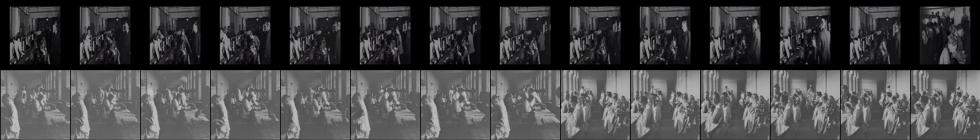

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:10:01,00:10:15,14,966498,96.166077,6
SF288.1.mpg,00:03:25,00:03:39,14,778183,96.166077,6


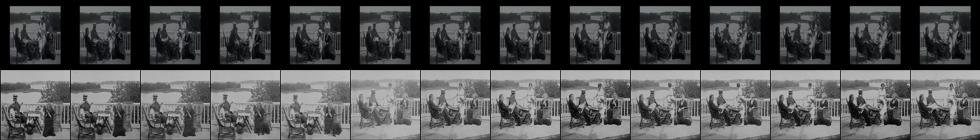

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Skolbarn.webm,00:01:56,00:02:10,14,980261,97.105965,7
SF2242.1.mpg,00:00:17,00:00:31,14,187242,97.105965,7


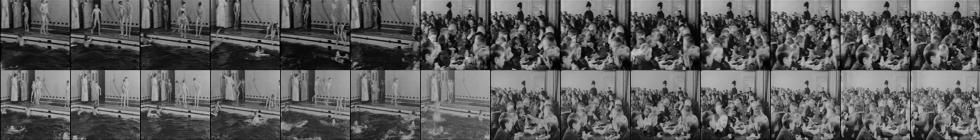

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Skolbarn.webm,00:06:57,00:07:11,14,980562,102.414551,8
SF2051.1.mpg,00:00:33,00:00:47,14,35774,102.414551,8


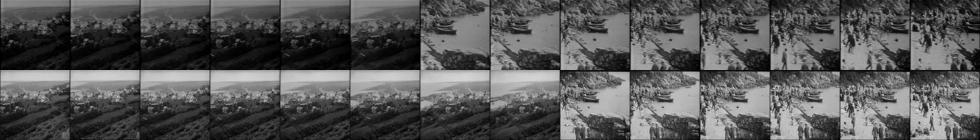

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Skolbarn.webm,00:10:41,00:10:55,14,980786,82.972488,6
SF2241.1.mpg,00:02:26,00:02:40,14,186863,82.972488,6


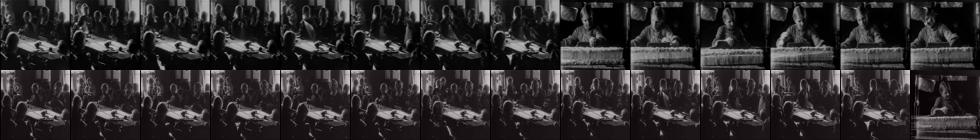

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Trafik.mp4,00:02:09,00:02:23,14,982441,74.601196,2
SF2055.1.mpg,00:06:08,00:06:22,14,39487,74.601196,2


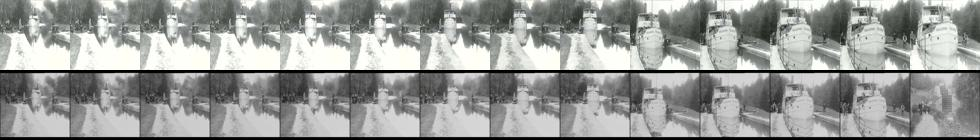

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Trafik.mp4,00:09:29,00:09:43,14,982881,99.021729,4
SF2183.1.mpg,00:07:59,00:08:13,14,133075,99.021729,4


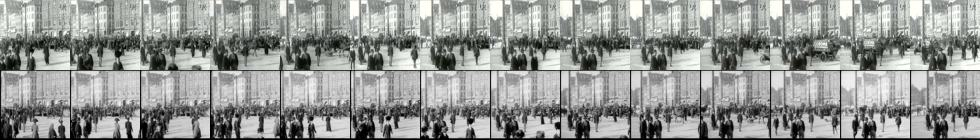

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Trafik.mp4,00:14:31,00:14:45,14,983183,89.057007,3
SF2171.1.mpg,00:11:26,00:11:40,14,125343,89.057007,3


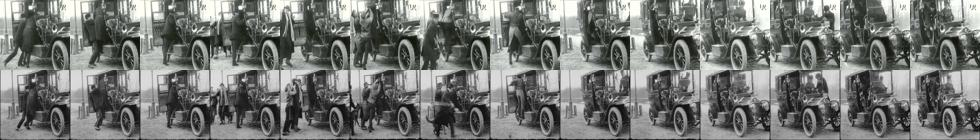

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1940.mp4,00:14:04,00:14:17,13,916627,106.548744,8
SF2398.1.mpg,00:09:01,00:09:14,13,330819,106.548744,8


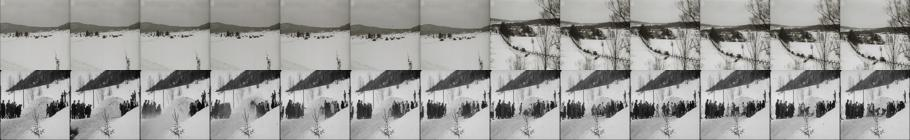

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1946.mp4,00:32:49,00:33:02,13,940525,103.736763,4
SF2835.1.mpg,00:10:57,00:11:10,13,724945,103.736763,4


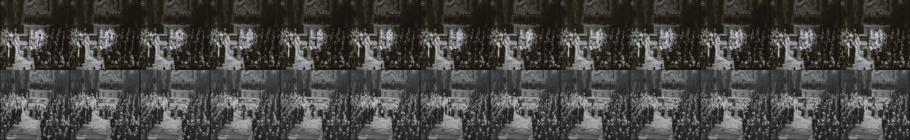

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1946.mp4,00:32:49,00:33:02,13,940525,99.431847,4
SF2836A-E.1.mpg,00:44:44,00:44:57,13,727813,99.431847,4


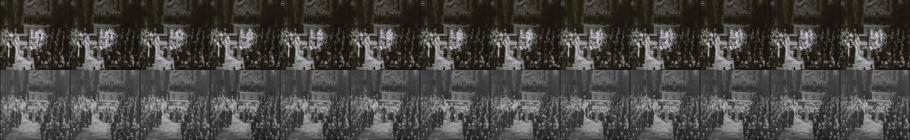

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1947.mp4,00:29:53,00:30:06,13,943789,87.263817,3
SF2825B.1.mpg,00:05:27,00:05:40,13,715836,87.263817,3


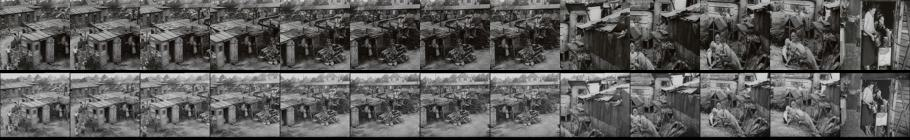

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_De gamla och kloka må le, fallera.webm",00:14:22,00:14:35,13,953109,94.276161,4
SF224.1.mpg,00:00:56,00:01:09,13,185791,94.276161,4


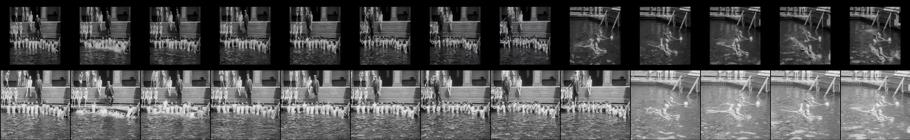

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:04:04,00:04:17,13,955502,94.006065,10
SF202.1.mpg,00:12:56,00:13:09,13,14863,94.006065,10


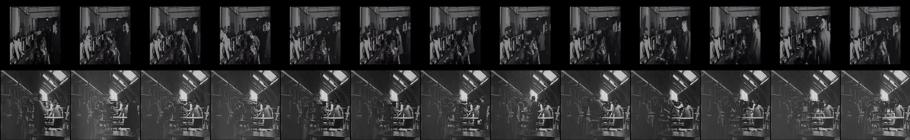

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:07:58,00:08:11,13,955736,84.749046,2
SF2221A-J.1.mpg,00:40:35,00:40:48,13,170135,84.749046,2


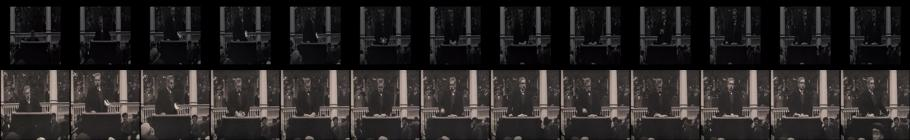

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_I ditt anletes svett.mp4,00:07:19,00:07:32,13,958730,82.243919,4
SF2072.1.mpg,00:11:05,00:11:18,13,52214,82.243919,4


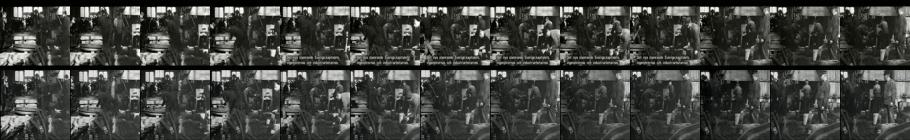

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Vi och världen.mp4,00:22:11,00:22:24,13,970225,99.909142,7
SF2413.1.mpg,00:03:43,00:03:56,13,342460,99.909142,7


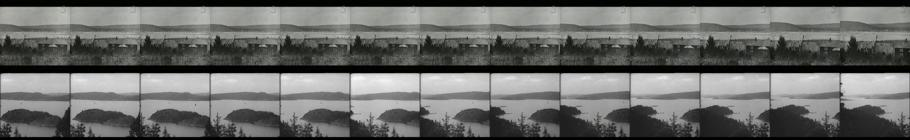

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Å, dyre prins.webm",00:08:00,00:08:13,13,971403,96.773598,7
SF2283A.1.mpg,00:04:55,00:05:08,13,225372,96.773598,7


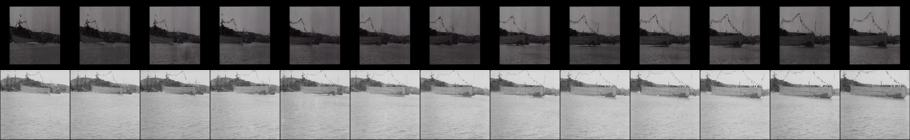

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Å, dyre prins.webm",00:10:39,00:10:52,13,971562,71.719887,10
SF2230.1.mpg,00:01:52,00:02:05,13,179822,71.719887,10


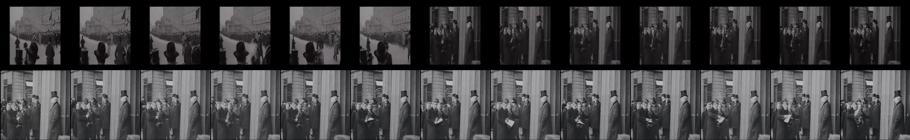

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Handel.webm,00:01:12,00:01:25,13,973936,96.773178,9
SF2129.1.mpg,00:02:51,00:03:04,13,94316,96.773178,9


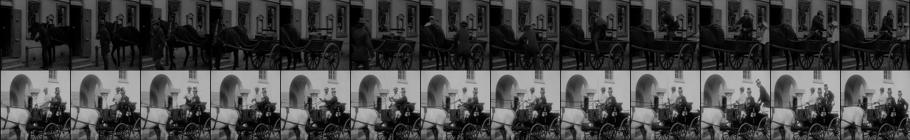

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Handel.webm,00:06:51,00:07:04,13,974275,115.609512,11
SF2061A.1.mpg,00:04:15,00:04:28,13,43682,115.609512,11


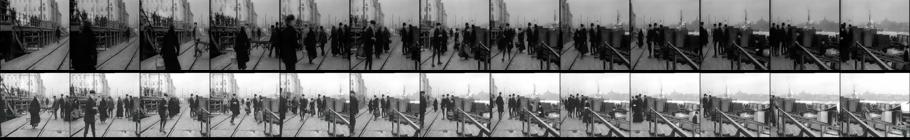

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Industri.webm,00:01:22,00:01:35,13,977064,112.972321,11
SF2184.1.mpg,00:01:20,00:01:33,13,133783,112.972321,11


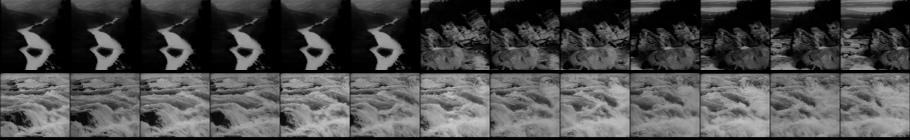

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Industri.webm,00:12:42,00:12:55,13,977744,95.405396,5
SF2072.1.mpg,00:12:36,00:12:49,13,52305,95.405396,5


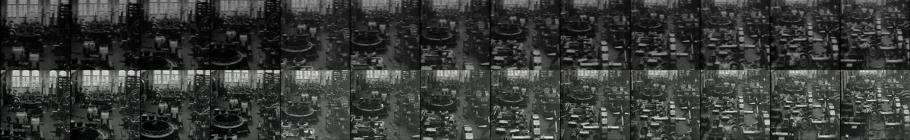

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Nöjen.webm,00:06:50,00:07:03,13,978461,84.767128,0
SF2322.1.mpg,00:07:51,00:08:04,13,252611,84.767128,0


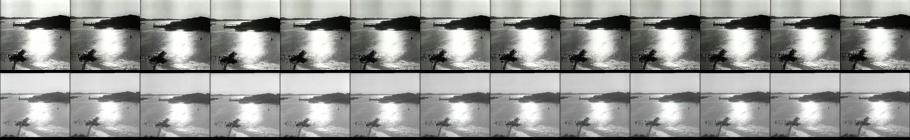

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Skolbarn.webm,00:15:13,00:15:26,13,981058,72.841537,0
SF2138.1.mpg,00:04:37,00:04:50,13,100696,72.841537,0


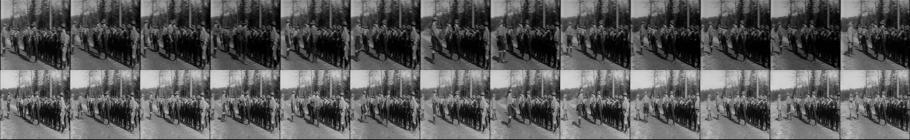

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Förväntningarnas tid_Nya hot och drömmar.mp4,00:23:31,00:23:43,12,896697,nan,12
SF2860.1.mpg,00:03:16,00:03:28,12,752350,nan,12


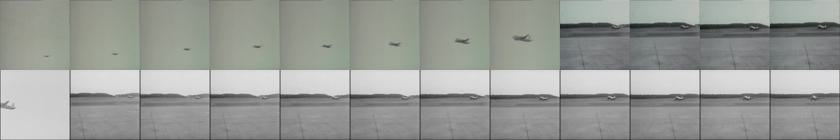

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1939.mp4,00:38:57,00:39:09,12,914616,100.777161,6
SF2682C.1.mpg,00:01:59,00:02:11,12,613898,100.777161,6


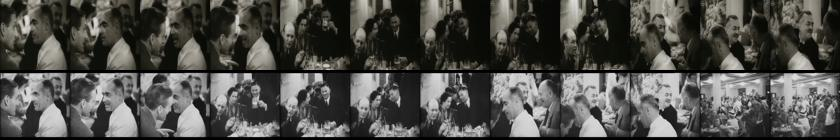

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1940.mp4,00:14:04,00:14:16,12,916627,109.847992,10
SF2312.1.mpg,00:06:59,00:07:11,12,246368,109.847992,10


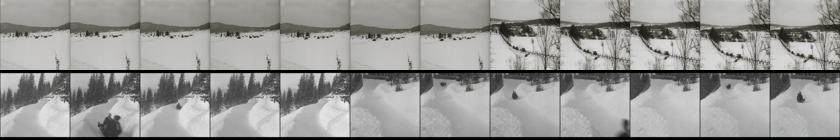

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1940.mp4,00:31:52,00:32:04,12,917695,61.589840,0
SF2687.1.mpg,00:13:56,00:14:08,12,617266,61.589840,0


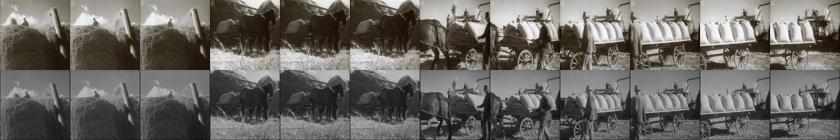

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1944.mp4,00:21:10,00:21:22,12,930982,112.249779,6
SF2148.1.mpg,00:11:30,00:11:42,12,109394,112.249779,6


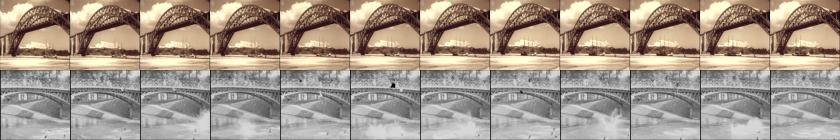

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1944.mp4,00:47:05,00:47:17,12,932537,101.612999,5
SF2382C.1.mpg,00:08:13,00:08:25,12,304612,101.612999,5


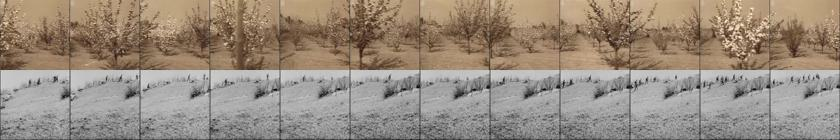

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1947.mp4,00:11:08,00:11:20,12,942664,94.038918,5
SF2382B.1.mpg,00:05:52,00:06:04,12,303881,94.038918,5


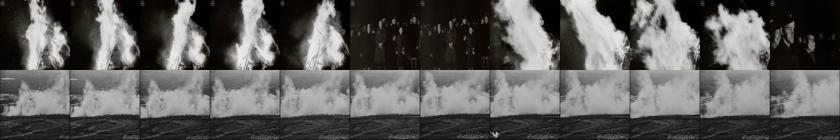

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1947.mp4,00:42:01,00:42:13,12,944517,85.701332,6
SF273.1.mpg,00:03:20,00:03:32,12,647077,85.701332,6


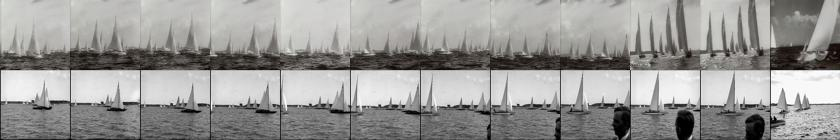

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_I ditt anletes svett.mp4,00:35:16,00:35:28,12,960407,100.791397,4
SF2635B.1.mpg,00:00:37,00:00:49,12,556332,100.791397,4


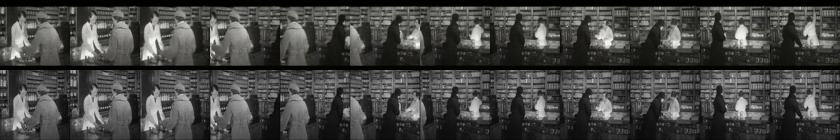

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Jag har varit med om allt som blivit nytt.webm,00:02:35,00:02:47,12,961824,101.857414,6
SF2094B.1.mpg,00:03:51,00:04:03,12,67477,101.857414,6


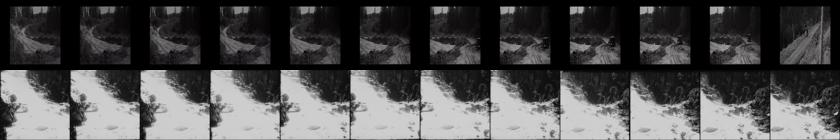

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Jag har varit med om allt som blivit nytt.webm,00:27:08,00:27:20,12,963297,83.662018,1
SF2024.1.mpg,00:09:16,00:09:28,12,18282,83.662018,1


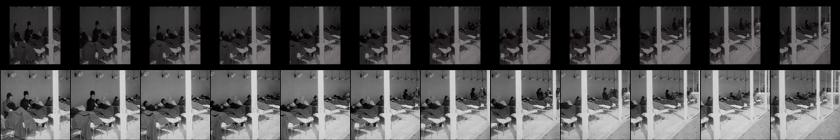

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Jag har varit med om allt som blivit nytt.webm,00:49:00,00:49:12,12,964609,92.896484,3
SF2209C.1.mpg,00:10:40,00:10:52,12,153294,92.896484,3


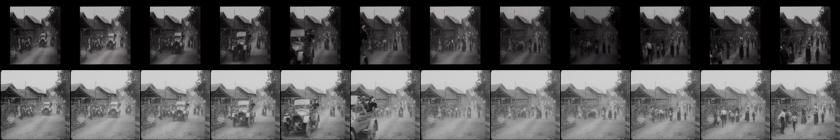

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:22:04,00:22:16,12,967221,115.108482,5
SF2742A.1.mpg,00:00:02,00:00:14,12,655737,115.108482,5


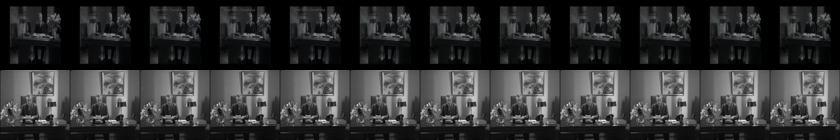

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Vi och världen.mp4,00:08:57,00:09:09,12,969431,107.565880,5
SF2410A-C.1.mpg,00:09:47,00:09:59,12,339607,107.565880,5


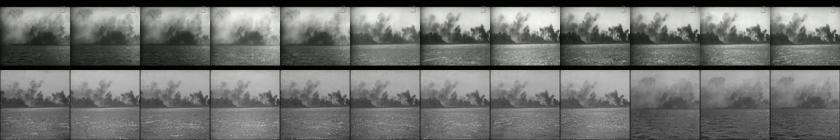

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Handel.webm,00:03:17,00:03:29,12,974061,nan,12
SF2569B.1.mpg,00:00:57,00:01:09,12,494715,nan,12


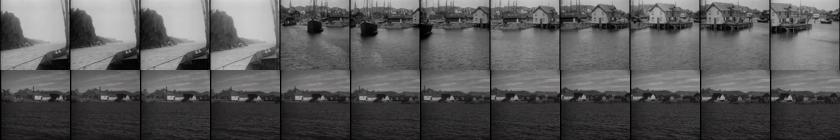

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Handel.webm,00:05:24,00:05:36,12,974188,83.764351,5
SF2433.1.mpg,00:03:48,00:04:00,12,364388,83.764351,5


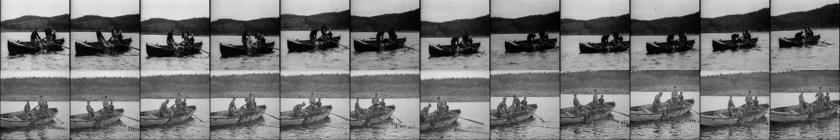

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Handel.webm,00:09:21,00:09:33,12,974425,84.271912,5
SF216.1.mpg,00:04:33,00:04:45,12,116999,84.271912,5


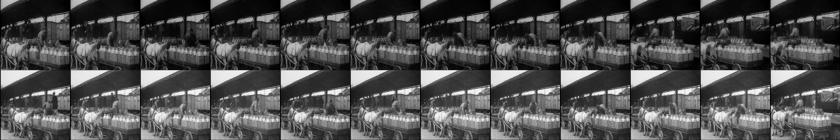

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Handel.webm,00:14:02,00:14:14,12,974706,59.198975,3
SF2304.1.mpg,00:01:08,00:01:20,12,240822,59.198975,3


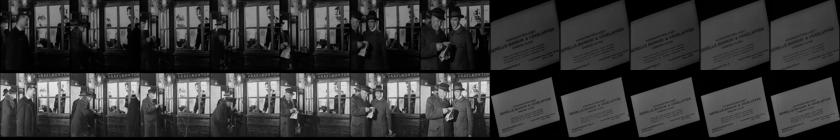

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Handel.webm,00:15:27,00:15:39,12,974791,65.896019,0
SF2265.1.mpg,00:05:30,00:05:42,12,205291,65.896019,0


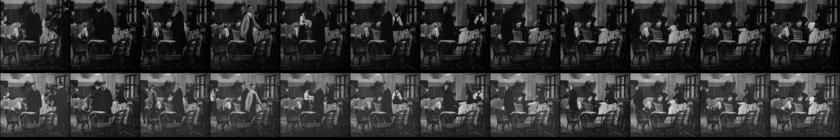

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Handel.webm,00:16:17,00:16:29,12,974841,52.854389,0
SF2265.1.mpg,00:08:44,00:08:56,12,205485,52.854389,0


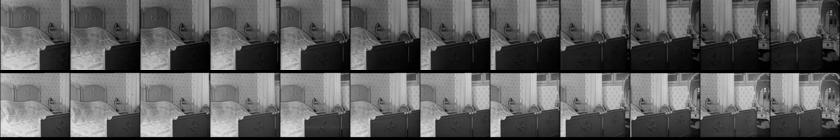

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Idrott.webm,00:13:37,00:13:49,12,976868,90.348076,8
SF2221A-J.1.mpg,01:15:34,01:15:46,12,172234,90.348076,8


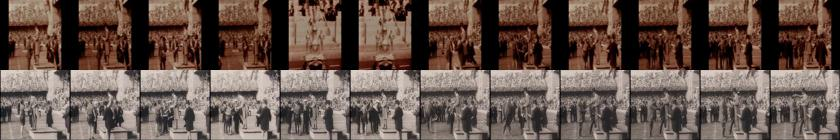

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Skolbarn.webm,00:15:52,00:16:04,12,981097,80.505493,5
SF2138.1.mpg,00:06:41,00:06:53,12,100820,80.505493,5


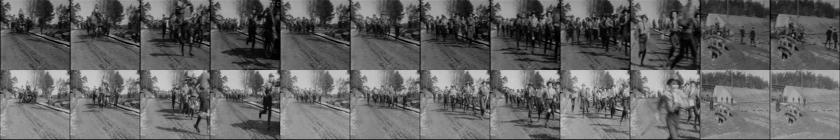

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Trafik.mp4,00:15:49,00:16:01,12,983261,92.353455,3
SF2099A.1.mpg,00:00:42,00:00:54,12,70094,92.353455,3


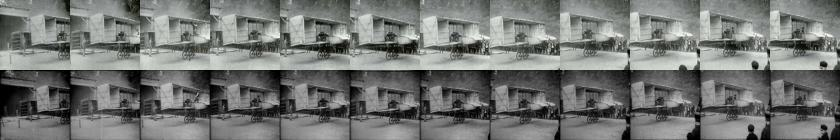

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Förväntningarnas tid_Nya hot och drömmar.mp4,00:22:32,00:22:43,11,896638,64.736588,1
SF2860.1.mpg,00:02:42,00:02:53,11,752316,64.736588,1


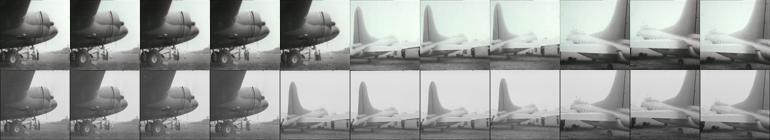

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1939.mp4,00:04:31,00:04:42,11,912550,61.798302,0
SF2891A.1. Åhlen o Holm 1939mpg.mpg,00:04:14,00:04:25,11,785939,61.798302,0


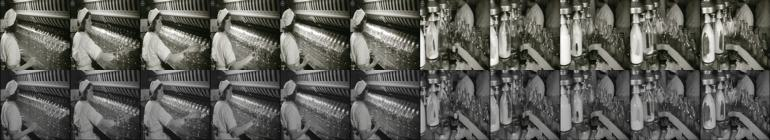

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1941.mp4,00:33:02,00:33:13,11,921244,107.365211,1
SF2794.1.mpg,00:00:28,00:00:39,11,688100,107.365211,1


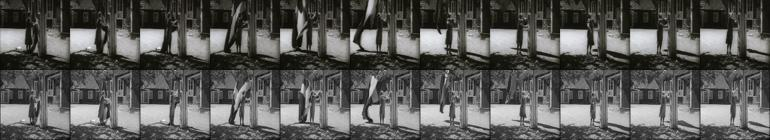

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1947.mp4,00:30:25,00:30:36,11,943821,93.092636,3
SF2825B.1.mpg,00:05:59,00:06:10,11,715868,93.092636,3


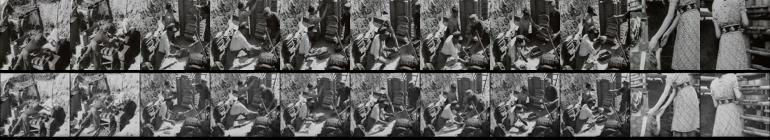

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1947.mp4,00:42:01,00:42:12,11,944517,76.867775,2
SF2695.1.mpg,00:00:04,00:00:15,11,623343,76.867775,2


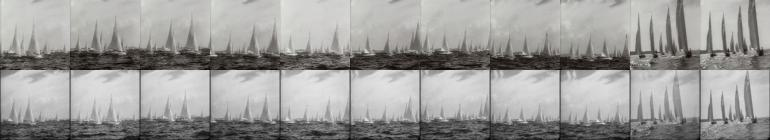

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1949.webm,00:57:08,00:57:19,11,952220,111.908524,6
SF2000.1.mpg,00:00:36,00:00:47,11,743,111.908524,6


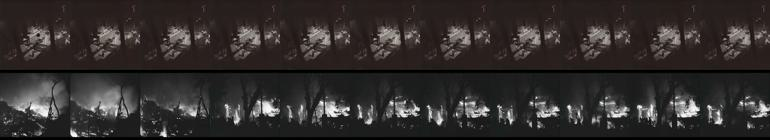

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:23:52,00:24:03,11,956690,97.594856,6
SF2023.1.mpg,00:04:22,00:04:33,11,17228,97.594856,6


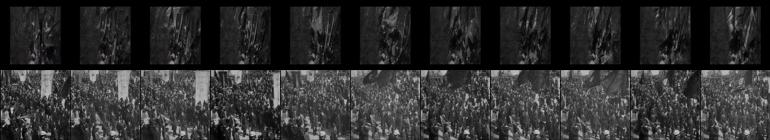

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Jag har varit med om allt som blivit nytt.webm,00:03:01,00:03:12,11,961850,103.006905,2
SF2480C.1.mpg,00:00:56,00:01:07,11,406053,103.006905,2


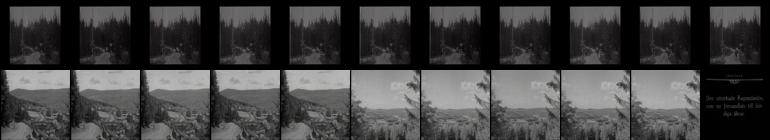

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Jag har varit med om allt som blivit nytt.webm,00:13:13,00:13:24,11,962462,86.884499,4
SF2296.1.mpg,00:04:40,00:04:51,11,235041,86.884499,4


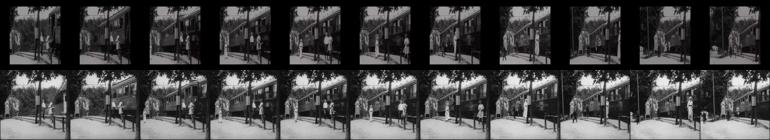

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Kjolarna, hattarna och lite Warzins keratin.mp4",00:03:03,00:03:14,11,964805,91.770309,3
SF2500A.1.mpg,00:07:15,00:07:26,11,424600,91.770309,3


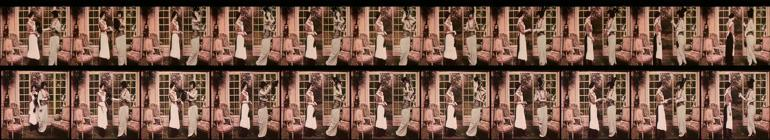

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Kjolarna, hattarna och lite Warzins keratin.mp4",00:16:15,00:16:26,11,965597,108.424194,5
SF2550A.1.mpg,00:01:13,00:01:24,11,480176,108.424194,5


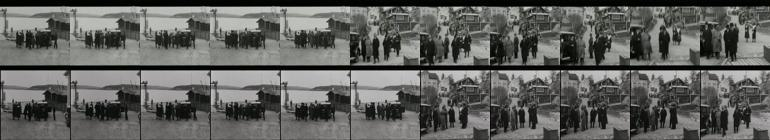

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Kjolarna, hattarna och lite Warzins keratin.mp4",00:16:32,00:16:43,11,965614,91.727608,4
SF2550A.1.mpg,00:01:32,00:01:43,11,480195,91.727608,4


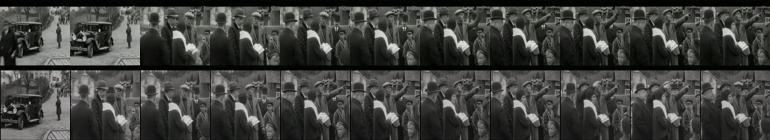

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:02:49,00:03:00,11,966066,79.764496,2
SF2183.1.mpg,00:01:11,00:01:22,11,132667,79.764496,2


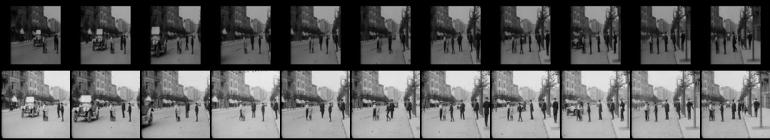

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:23:34,00:23:45,11,967311,73.019897,6
SF2700.1.mpg,00:07:41,00:07:52,11,627886,73.019897,6


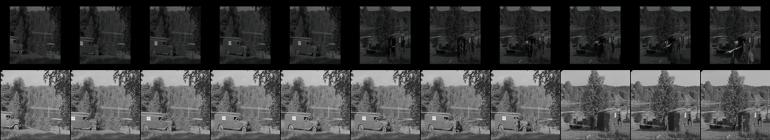

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Vi och världen.mp4,00:07:20,00:07:31,11,969334,108.045456,6
SF2256.1.mpg,00:07:47,00:07:58,11,199116,108.045456,6


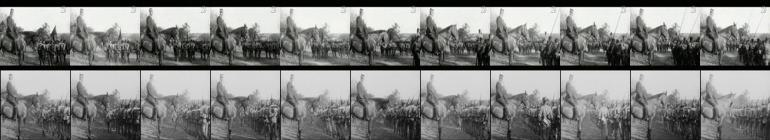

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Vi och världen.mp4,00:07:20,00:07:31,11,969334,95.983727,5
SF2256.1.mpg,00:08:43,00:08:54,11,199172,95.983727,5


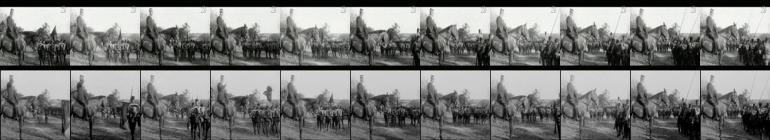

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Vi och världen.mp4,00:22:11,00:22:22,11,970225,110.244705,6
SF2240.1.mpg,00:00:59,00:01:10,11,186126,110.244705,6


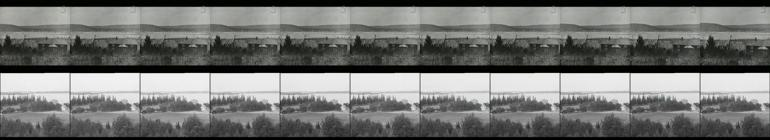

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Vi och världen.mp4,00:22:11,00:22:22,11,970225,115.966461,10
SF2494C.1.mpg,00:01:20,00:01:31,11,416325,115.966461,10


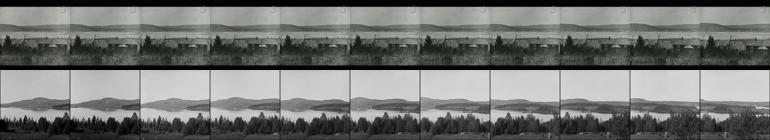

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Vi och världen.mp4,00:33:10,00:33:21,11,970884,76.538101,1
SF2770A.1.mpg,00:08:27,00:08:38,11,671226,76.538101,1


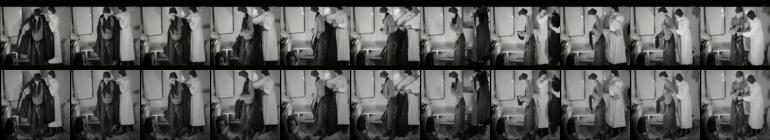

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Å, dyre prins.webm",00:00:58,00:01:09,11,970981,102.415466,4
SF2221A-J.1.mpg,00:05:15,00:05:26,11,168015,102.415466,4


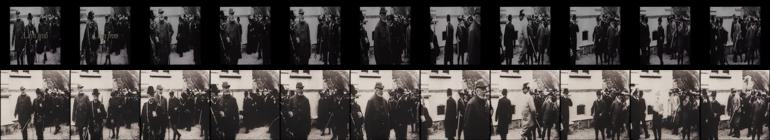

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Å, dyre prins.webm",00:10:14,00:10:25,11,971537,78.962753,3
SF2229.1.mpg,00:09:50,00:10:01,11,178784,78.962753,3


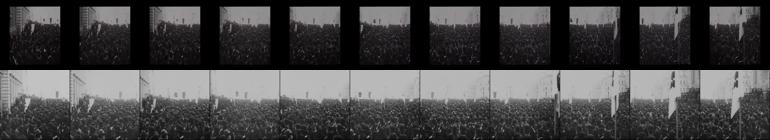

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Handel.webm,00:03:17,00:03:28,11,974061,nan,11
SF2400.1.mpg,00:09:56,00:10:07,11,332605,nan,11


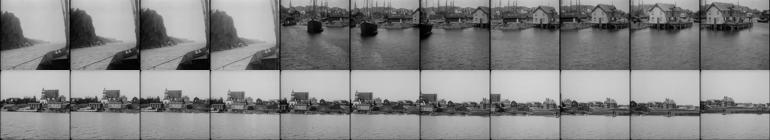

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Handel.webm,00:12:45,00:12:56,11,974629,93.256226,4
SF2209B.1.mpg,00:00:44,00:00:55,11,152025,93.256226,4


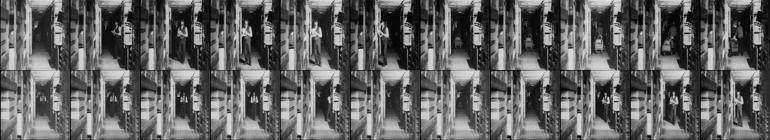

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Industri.webm,00:01:07,00:01:18,11,977049,104.340599,6
SF2176.1.mpg,00:08:22,00:08:33,11,128474,104.340599,6


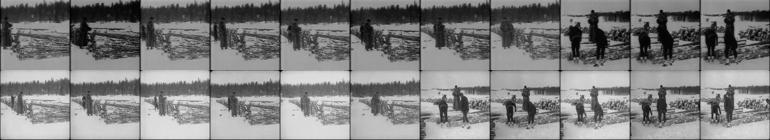

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Industri.webm,00:01:22,00:01:33,11,977064,118.111816,10
SF2094B.1.mpg,00:03:11,00:03:22,11,67437,118.111816,10


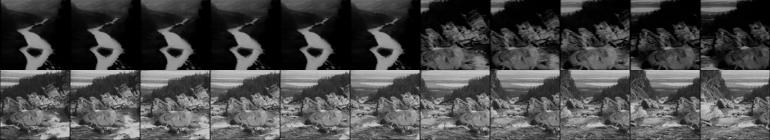

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Industri.webm,00:01:22,00:01:33,11,977064,99.936607,6
SF2314.1.mpg,00:05:13,00:05:24,11,247399,99.936607,6


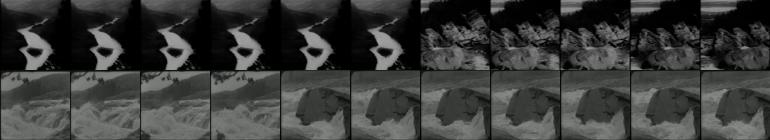

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Nöjen.webm,00:16:57,00:17:08,11,979068,109.271652,4
SF2094A.1.mpg,00:06:30,00:06:41,11,66898,109.271652,4


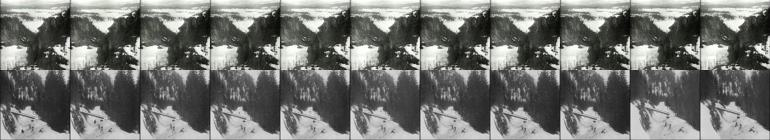

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Skolbarn.webm,00:02:47,00:02:58,11,980312,95.960777,3
SF2242.1.mpg,00:01:45,00:01:56,11,187330,95.960777,3


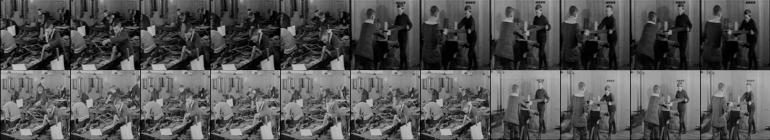

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Skolbarn.webm,00:03:39,00:03:50,11,980364,101.136230,4
SF2242.1.mpg,00:03:25,00:03:36,11,187430,101.136230,4


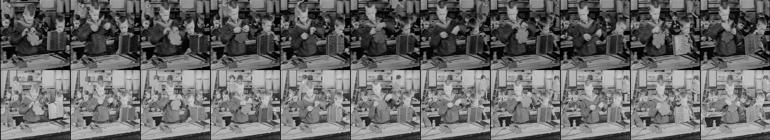

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Skolbarn.webm,00:08:19,00:08:30,11,980644,87.264481,3
SF2051.1.mpg,00:05:54,00:06:05,11,36095,87.264481,3


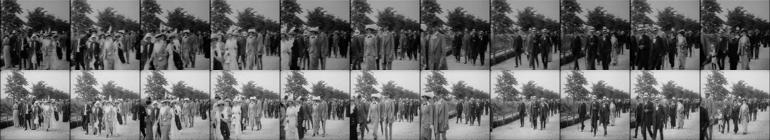

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Skolbarn.webm,00:08:44,00:08:55,11,980669,110.741173,4
SF2406.1.mpg,00:03:30,00:03:41,11,336190,110.741173,4


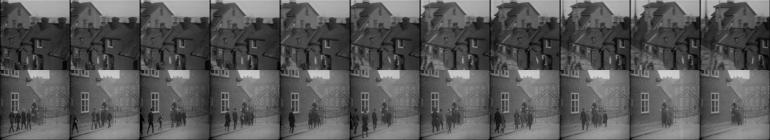

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Skolbarn.webm,00:08:44,00:08:55,11,980669,109.615028,4
SF2406.1.mpg,00:03:57,00:04:08,11,336217,109.615028,4


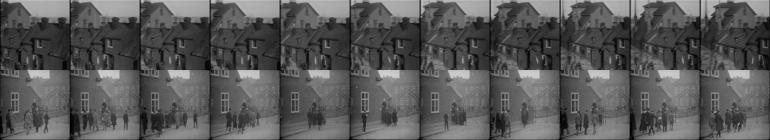

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Skolbarn.webm,00:10:01,00:10:12,11,980746,99.843452,2
SF2241.1.mpg,00:00:04,00:00:15,11,186721,99.843452,2


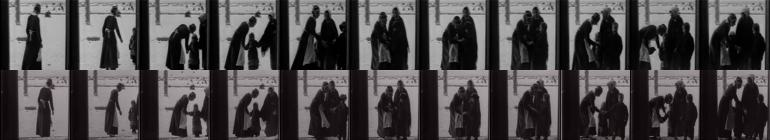

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Trafik.mp4,00:03:31,00:03:42,11,982523,72.025070,6
SF2055.1.mpg,00:08:19,00:08:30,11,39618,72.025070,6


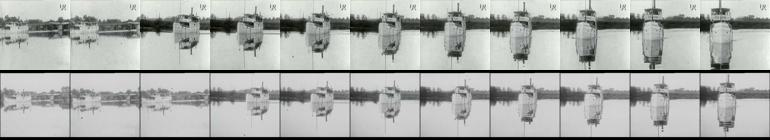

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Trafik.mp4,00:11:05,00:11:16,11,982977,95.157021,5
SF2183.1.mpg,00:08:49,00:09:00,11,133125,95.157021,5


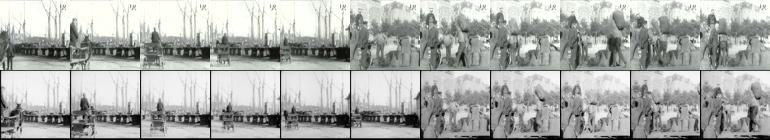

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Trafik.mp4,00:13:14,00:13:25,11,983106,87.400299,2
SF2171.1.mpg,00:10:09,00:10:20,11,125266,87.400299,2


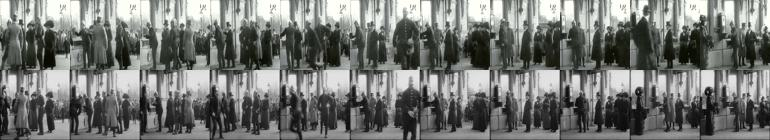

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Trafik.mp4,00:15:49,00:16:00,11,983261,87.805550,6
SF2099B.1.mpg,00:00:50,00:01:01,11,70979,87.805550,6


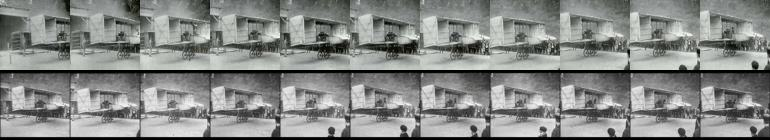

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Förväntningarnas tid_Nya hot och drömmar.mp4,00:05:20,00:05:30,10,895606,87.787338,0
SF2997A-E.1.mpg,00:24:20,00:24:30,10,888962,87.787338,0


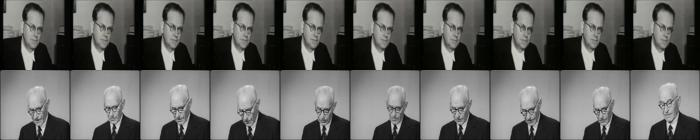

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Förväntningarnas tid_Skördetid med förhinder.webm,00:02:26,00:02:36,10,898681,105.391396,0
SF2657.1.mpg,00:12:38,00:12:48,10,585282,105.391396,0


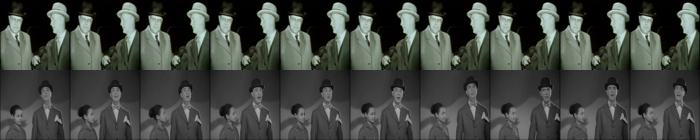

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Förväntningarnas tid_Skördetid med förhinder.webm,00:13:03,00:13:13,10,899318,92.617073,4
SF2794.1.mpg,00:06:55,00:07:05,10,688487,92.617073,4


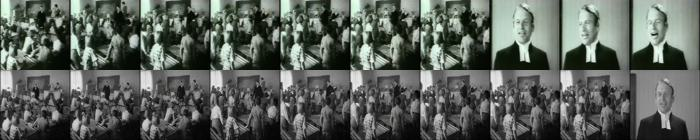

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Förväntningarnas tid_Skördetid med förhinder.webm,00:20:13,00:20:23,10,899748,107.868874,5
SF2950A-D.1.mpg,00:08:26,00:08:36,10,846798,107.868874,5


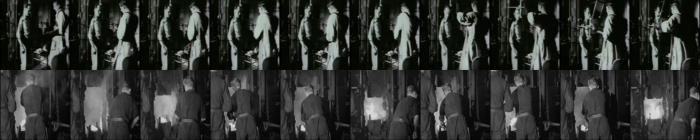

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn Från 1950.webm,00:11:10,00:11:20,10,909694,89.910599,2
SF2707.1.mpg,00:03:03,00:03:13,10,632123,89.910599,2


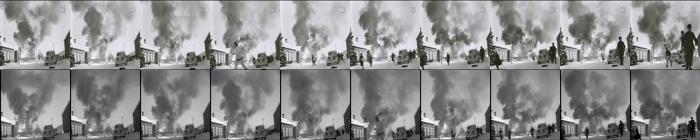

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1941.mp4,00:35:50,00:36:00,10,921412,102.821335,6
SF2783.1.mpg,00:08:05,00:08:15,10,681746,102.821335,6


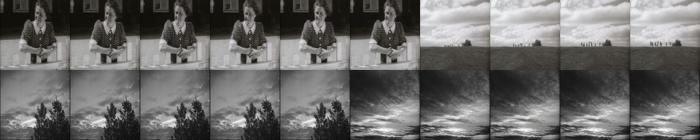

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1942.mp4,00:09:55,00:10:05,10,923366,61.256447,0
SF2914.1.mpg,00:08:17,00:08:27,10,815349,61.256447,0


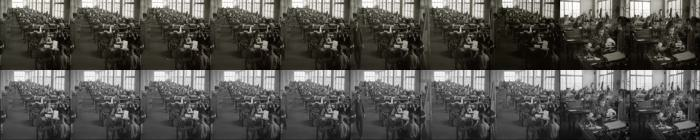

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1943.mp4,00:00:00,00:00:10,10,926215,103.397797,1
SF2838A.1.mpg,00:00:00,00:00:10,10,729643,103.397797,1


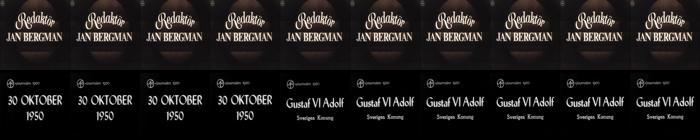

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1944.mp4,00:00:53,00:01:03,10,929765,109.680908,6
SF2868A-E.1.mpg,00:06:05,00:06:15,10,767702,109.680908,6


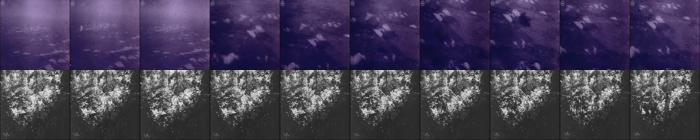

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1944.mp4,00:56:50,00:57:00,10,933122,nan,10
SF2260.1.mpg,00:12:09,00:12:19,10,202418,nan,10


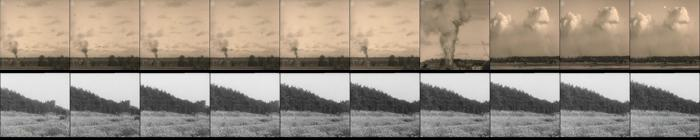

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1945.mp4,00:04:42,00:04:52,10,933514,108.726509,3
SF2228.1.mpg,00:03:20,00:03:30,10,177608,108.726509,3


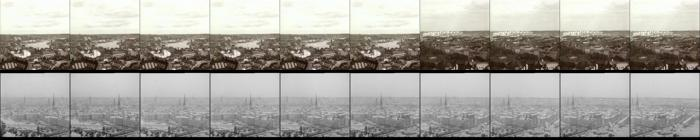

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1945.mp4,00:04:42,00:04:52,10,933514,103.184181,1
SF2414.1.mpg,00:07:11,00:07:21,10,343542,103.184181,1


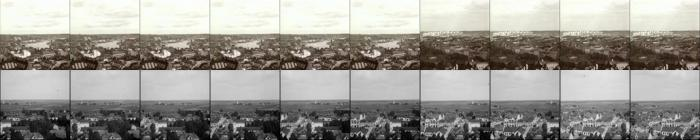

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1945.mp4,00:04:42,00:04:52,10,933514,108.308983,4
SF2456.1.mpg,00:01:24,00:01:34,10,385056,108.308983,4


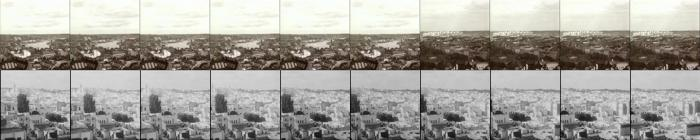

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1947.mp4,00:27:10,00:27:20,10,943626,104.163040,5
SF2825B.1.mpg,00:02:12,00:02:22,10,715641,104.163040,5


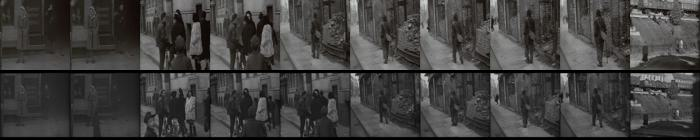

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1947.mp4,00:42:01,00:42:11,10,944517,82.104942,2
SF2166.1.mpg,00:03:40,00:03:50,10,120820,82.104942,2


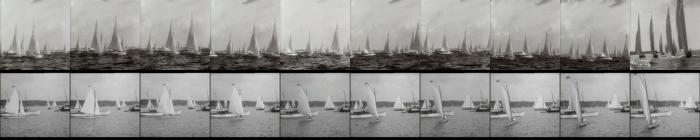

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1947.mp4,00:42:01,00:42:11,10,944517,84.289795,5
SF2476C.1.mpg,00:11:14,00:11:24,10,401124,84.289795,5


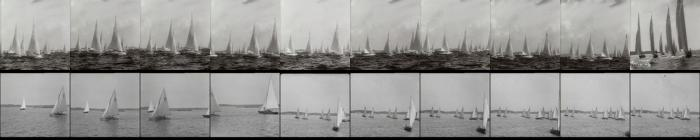

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1948.webm,00:43:46,00:43:56,10,947981,113.519577,5
SF2230.1.mpg,00:02:48,00:02:58,10,179878,113.519577,5


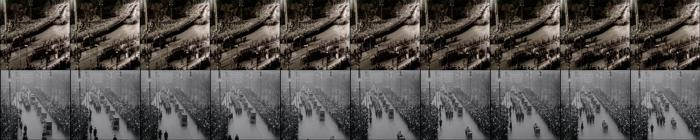

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_De gamla och kloka må le, fallera.webm",00:05:06,00:05:16,10,952553,87.026825,1
SF2221A-J.1.mpg,01:23:40,01:23:50,10,172720,87.026825,1


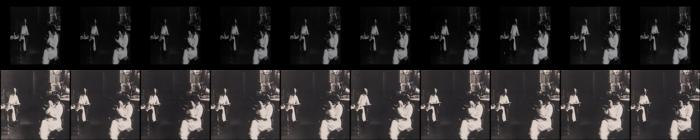

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_De gamla och kloka må le, fallera.webm",00:21:27,00:21:37,10,953534,97.920425,2
SF2789.1.mpg,00:02:23,00:02:33,10,684620,97.920425,2


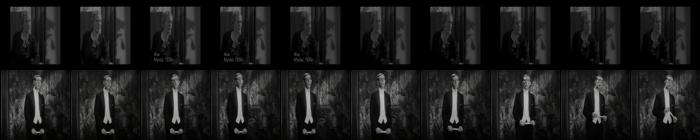

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_De gamla och kloka må le, fallera.webm",00:21:27,00:21:37,10,953534,100.329735,5
SF2789.1.mpg,00:02:45,00:02:55,10,684642,100.329735,5


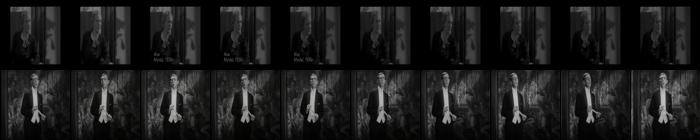

In [73]:
combined_project_finder.show_notebook_sequence(combined_project_sequences, show_limit=200, frame_resize=(70,70), convert_format='JPEG')

Last, we also have a look at thumbnail previews in the 5 remaining SF clips that have been most frequently reused, showing the most reused clip first.

SF video, and number of unique TV series used:


Video 2
SF2836A-E.1.mpg    9
SF2410A-C.1.mpg    8
SF2356.1.mpg       8
SF2221A-J.1.mpg    8
SF2183.1.mpg       7
Name: Video 1, dtype: int64

,Video 1,Video 2,Video 1 Start time,Video 1 End time,Video 2 Start time,Video 2 End time,Duration,Index Video 1,Index Video 2,Match mean distance,# not matching
105,Guldkorn från 1946.mp4,SF2836A-E.1.mpg,00:32:49,00:33:02,00:44:44,00:44:57,13,940525,727813,99.431847,4
244,Förväntningarnas tid_Nya hot och drömmar.mp4,SF2836A-E.1.mpg,00:25:10,00:25:19,00:24:27,00:24:36,9,896796,726596,75.758881,0
274,Guldkorn från 1948.webm,SF2836A-E.1.mpg,00:35:06,00:35:15,00:45:12,00:45:21,9,947461,727841,101.489273,4
335,Förväntningarnas tid_Vägen genom krisen.webm,SF2836A-E.1.mpg,00:12:43,00:12:51,00:08:05,00:08:13,8,902733,725614,102.490982,0
682,Hundra svenska år_Folkhemmet tur och retur.webm,SF2836A-E.1.mpg,00:01:42,00:01:48,00:18:42,00:18:48,6,955360,726251,100.939445,2
731,"Hundra svenska år_Å, dyre prins.webm",SF2836A-E.1.mpg,00:03:52,00:03:58,00:01:49,00:01:55,6,971155,725238,112.650002,3
993,"Hundra svenska år_Å, dyre prins.webm",SF2836A-E.1.mpg,00:22:35,00:22:40,00:20:43,00:20:48,5,972278,726372,89.263870,1
1054,Förväntningarnas tid_Skördetid med förhinder.webm,SF2836A-E.1.mpg,00:54:41,00:54:45,00:46:41,00:46:45,4,901816,727930,113.539665,0
1111,Guldkorn från 1942.mp4,SF2836A-E.1.mpg,00:01:43,00:01:47,00:19:51,00:19:55,4,922874,726320,87.996071,0
1261,Hundra svenska år_Nu har jag kastat min blå ov...,SF2836A-E.1.mpg,00:48:40,00:48:44,00:20:40,00:20:44,4,968817,726369,109.027710,0


,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1946.mp4,00:32:49,00:33:02,13,940525,99.431847,4
SF2836A-E.1.mpg,00:44:44,00:44:57,13,727813,99.431847,4


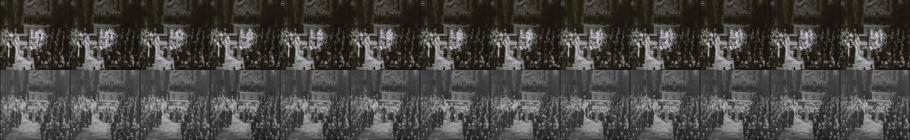

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Förväntningarnas tid_Nya hot och drömmar.mp4,00:25:10,00:25:19,9,896796,75.758881,0
SF2836A-E.1.mpg,00:24:27,00:24:36,9,726596,75.758881,0


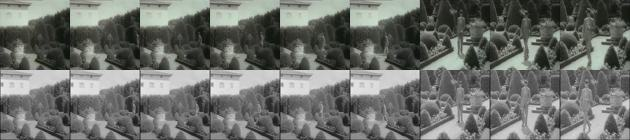

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1948.webm,00:35:06,00:35:15,9,947461,101.489273,4
SF2836A-E.1.mpg,00:45:12,00:45:21,9,727841,101.489273,4


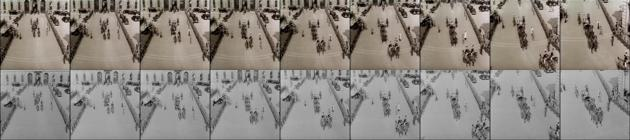

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Förväntningarnas tid_Vägen genom krisen.webm,00:12:43,00:12:51,8,902733,102.490982,0
SF2836A-E.1.mpg,00:08:05,00:08:13,8,725614,102.490982,0


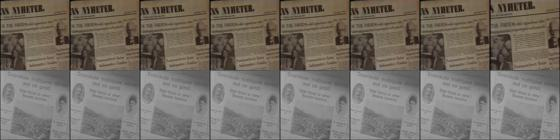

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:01:42,00:01:48,6,955360,100.939445,2
SF2836A-E.1.mpg,00:18:42,00:18:48,6,726251,100.939445,2


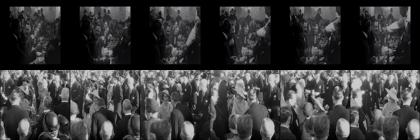

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Å, dyre prins.webm",00:03:52,00:03:58,6,971155,112.650002,3
SF2836A-E.1.mpg,00:01:49,00:01:55,6,725238,112.650002,3


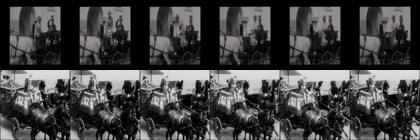

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Å, dyre prins.webm",00:22:35,00:22:40,5,972278,89.263870,1
SF2836A-E.1.mpg,00:20:43,00:20:48,5,726372,89.263870,1


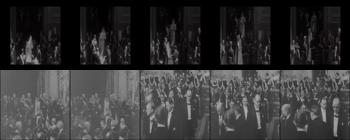

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Förväntningarnas tid_Skördetid med förhinder.webm,00:54:41,00:54:45,4,901816,113.539665,0
SF2836A-E.1.mpg,00:46:41,00:46:45,4,727930,113.539665,0


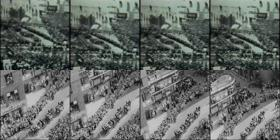

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1942.mp4,00:01:43,00:01:47,4,922874,87.996071,0
SF2836A-E.1.mpg,00:19:51,00:19:55,4,726320,87.996071,0


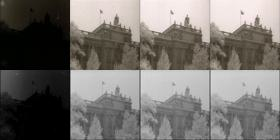

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:48:40,00:48:44,4,968817,109.027710,0
SF2836A-E.1.mpg,00:20:40,00:20:44,4,726369,109.027710,0


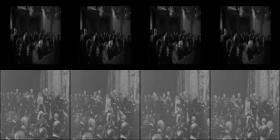

,Video 1,Video 2,Video 1 Start time,Video 1 End time,Video 2 Start time,Video 2 End time,Duration,Index Video 1,Index Video 2,Match mean distance,# not matching
133,Hundra svenska år_Vi och världen.mp4,SF2410A-C.1.mpg,00:08:57,00:09:09,00:09:47,00:09:59,12,969431,339607,107.565880,5
449,Guldkorn från 1941.mp4,SF2410A-C.1.mpg,00:40:08,00:40:15,00:03:07,00:03:14,7,921670,339207,105.250641,3
524,Hundra svenska år_Vi och världen.mp4,SF2410A-C.1.mpg,00:08:48,00:08:55,00:09:33,00:09:40,7,969422,339593,104.414513,0
809,Guldkorn Från 1950.webm,SF2410A-C.1.mpg,00:36:36,00:36:41,00:15:27,00:15:32,5,911220,339947,114.558083,1
830,Guldkorn från 1940.mp4,SF2410A-C.1.mpg,00:38:47,00:38:52,00:03:19,00:03:24,5,918110,339219,103.552658,1
837,Guldkorn från 1941.mp4,SF2410A-C.1.mpg,00:39:52,00:39:57,00:05:24,00:05:29,5,921654,339344,103.218407,1
838,Guldkorn från 1941.mp4,SF2410A-C.1.mpg,00:39:52,00:39:57,00:15:11,00:15:16,5,921654,339931,97.676636,0
839,Guldkorn från 1941.mp4,SF2410A-C.1.mpg,00:39:52,00:39:57,00:15:25,00:15:30,5,921654,339945,101.311371,1
858,Guldkorn från 1943.mp4,SF2410A-C.1.mpg,00:30:28,00:30:33,00:13:21,00:13:26,5,928043,339821,89.051254,0
901,Guldkorn från 1948.webm,SF2410A-C.1.mpg,00:40:54,00:40:59,00:15:11,00:15:16,5,947809,339931,94.484055,1


,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Vi och världen.mp4,00:08:57,00:09:09,12,969431,107.565880,5
SF2410A-C.1.mpg,00:09:47,00:09:59,12,339607,107.565880,5


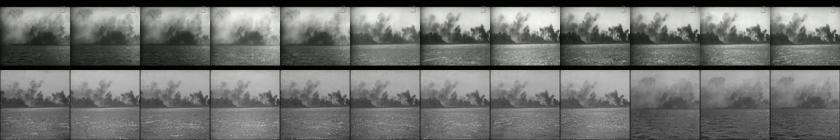

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1941.mp4,00:40:08,00:40:15,7,921670,105.250641,3
SF2410A-C.1.mpg,00:03:07,00:03:14,7,339207,105.250641,3


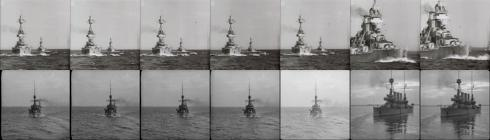

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Vi och världen.mp4,00:08:48,00:08:55,7,969422,104.414513,0
SF2410A-C.1.mpg,00:09:33,00:09:40,7,339593,104.414513,0


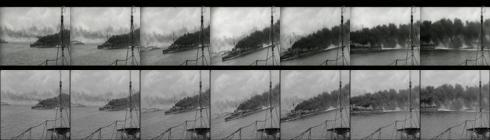

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn Från 1950.webm,00:36:36,00:36:41,5,911220,114.558083,1
SF2410A-C.1.mpg,00:15:27,00:15:32,5,339947,114.558083,1


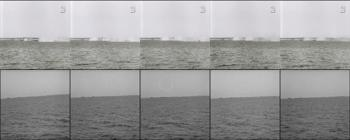

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1940.mp4,00:38:47,00:38:52,5,918110,103.552658,1
SF2410A-C.1.mpg,00:03:19,00:03:24,5,339219,103.552658,1


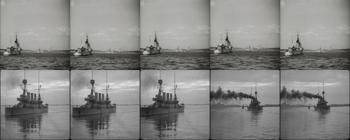

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1941.mp4,00:39:52,00:39:57,5,921654,103.218407,1
SF2410A-C.1.mpg,00:05:24,00:05:29,5,339344,103.218407,1


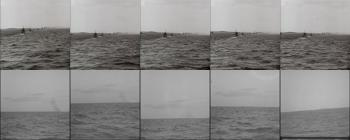

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1941.mp4,00:39:52,00:39:57,5,921654,97.676636,0
SF2410A-C.1.mpg,00:15:11,00:15:16,5,339931,97.676636,0


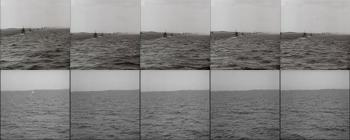

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1941.mp4,00:39:52,00:39:57,5,921654,101.311371,1
SF2410A-C.1.mpg,00:15:25,00:15:30,5,339945,101.311371,1


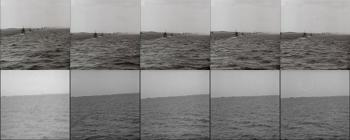

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1943.mp4,00:30:28,00:30:33,5,928043,89.051254,0
SF2410A-C.1.mpg,00:13:21,00:13:26,5,339821,89.051254,0


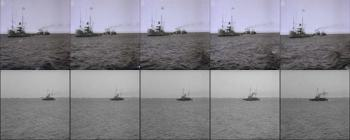

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1948.webm,00:40:54,00:40:59,5,947809,94.484055,1
SF2410A-C.1.mpg,00:15:11,00:15:16,5,339931,94.484055,1


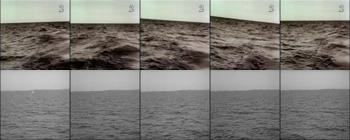

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1948.webm,00:40:54,00:40:59,5,947809,94.621475,1
SF2410A-C.1.mpg,00:22:29,00:22:34,5,340369,94.621475,1


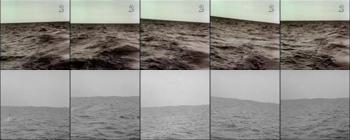

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1948.webm,00:40:54,00:40:59,5,947809,108.255539,0
SF2410A-C.1.mpg,00:22:42,00:22:47,5,340382,108.255539,0


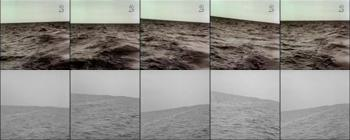

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Industri.webm,00:03:08,00:03:13,5,977170,108.297127,1
SF2410A-C.1.mpg,00:19:20,00:19:25,5,340180,108.297127,1


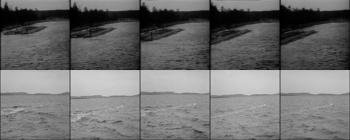

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1943.mp4,00:33:05,00:33:09,4,928200,97.372498,0
SF2410A-C.1.mpg,00:06:15,00:06:19,4,339395,97.372498,0


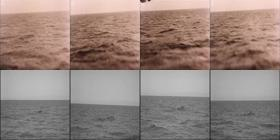

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1943.mp4,00:33:05,00:33:09,4,928200,99.505348,0
SF2410A-C.1.mpg,00:15:25,00:15:29,4,339945,99.505348,0


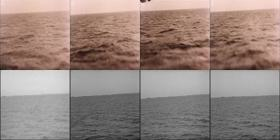

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1944.mp4,00:32:40,00:32:44,4,931672,86.299492,0
SF2410A-C.1.mpg,00:05:27,00:05:31,4,339347,86.299492,0


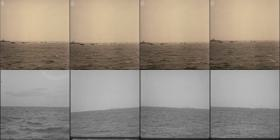

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1944.mp4,00:32:40,00:32:44,4,931672,93.761215,0
SF2410A-C.1.mpg,00:05:38,00:05:42,4,339358,93.761215,0


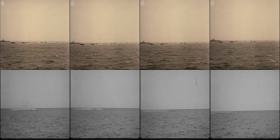

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1944.mp4,00:32:40,00:32:44,4,931672,98.758224,0
SF2410A-C.1.mpg,00:15:13,00:15:17,4,339933,98.758224,0


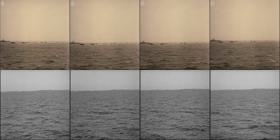

,Video 1,Video 2,Video 1 Start time,Video 1 End time,Video 2 Start time,Video 2 End time,Duration,Index Video 1,Index Video 2,Match mean distance,# not matching
262,Guldkorn från 1943.mp4,SF2356.1.mpg,00:38:43,00:38:52,00:00:31,00:00:40,9,928538,278944,104.039970,1
379,Hundra svenska år_Folkhemmet tur och retur.webm,SF2356.1.mpg,00:36:51,00:36:59,00:04:42,00:04:50,8,957469,279195,111.491074,3
445,Guldkorn från 1940.mp4,SF2356.1.mpg,00:14:04,00:14:11,00:05:22,00:05:29,7,916627,279235,100.599220,1
644,Guldkorn från 1944.mp4,SF2356.1.mpg,00:56:35,00:56:41,00:00:31,00:00:37,6,933107,278944,100.906006,2
652,Guldkorn från 1946.mp4,SF2356.1.mpg,00:48:37,00:48:43,00:00:34,00:00:40,6,941473,278947,105.109085,2
754,Sverige för länge sedan_Industri.webm,SF2356.1.mpg,00:01:22,00:01:28,00:00:47,00:00:53,6,977064,278960,NaN,6
872,Guldkorn från 1944.mp4,SF2356.1.mpg,00:56:18,00:56:23,00:07:09,00:07:14,5,933090,279342,110.405113,1
1008,Sverige för länge sedan_Industri.webm,SF2356.1.mpg,00:01:22,00:01:27,00:01:39,00:01:44,5,977064,279012,NaN,5
1022,Sverige för länge sedan_Rallare.mp4,SF2356.1.mpg,00:00:07,00:00:12,00:07:10,00:07:15,5,979090,279343,105.248878,1
1282,Sverige för länge sedan_Handel.webm,SF2356.1.mpg,00:03:17,00:03:21,00:09:11,00:09:15,4,974061,279464,NaN,4


,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1943.mp4,00:38:43,00:38:52,9,928538,104.039970,1
SF2356.1.mpg,00:00:31,00:00:40,9,278944,104.039970,1


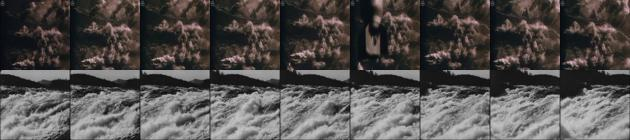

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:36:51,00:36:59,8,957469,111.491074,3
SF2356.1.mpg,00:04:42,00:04:50,8,279195,111.491074,3


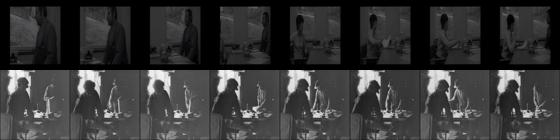

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1940.mp4,00:14:04,00:14:11,7,916627,100.599220,1
SF2356.1.mpg,00:05:22,00:05:29,7,279235,100.599220,1


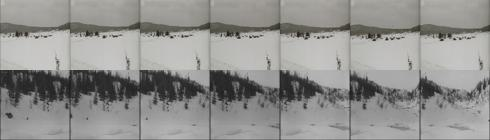

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1944.mp4,00:56:35,00:56:41,6,933107,100.906006,2
SF2356.1.mpg,00:00:31,00:00:37,6,278944,100.906006,2


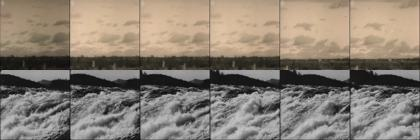

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1946.mp4,00:48:37,00:48:43,6,941473,105.109085,2
SF2356.1.mpg,00:00:34,00:00:40,6,278947,105.109085,2


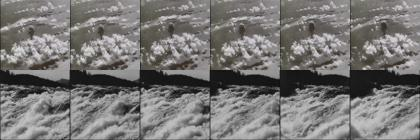

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Industri.webm,00:01:22,00:01:28,6,977064,nan,6
SF2356.1.mpg,00:00:47,00:00:53,6,278960,nan,6


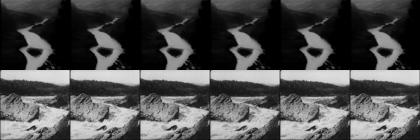

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1944.mp4,00:56:18,00:56:23,5,933090,110.405113,1
SF2356.1.mpg,00:07:09,00:07:14,5,279342,110.405113,1


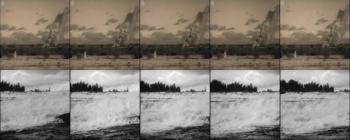

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Industri.webm,00:01:22,00:01:27,5,977064,nan,5
SF2356.1.mpg,00:01:39,00:01:44,5,279012,nan,5


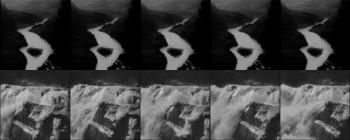

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Rallare.mp4,00:00:07,00:00:12,5,979090,105.248878,1
SF2356.1.mpg,00:07:10,00:07:15,5,279343,105.248878,1


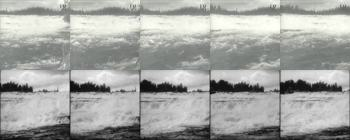

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Handel.webm,00:03:17,00:03:21,4,974061,nan,4
SF2356.1.mpg,00:09:11,00:09:15,4,279464,nan,4


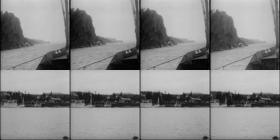

,Video 1,Video 2,Video 1 Start time,Video 1 End time,Video 2 Start time,Video 2 End time,Duration,Index Video 1,Index Video 2,Match mean distance,# not matching
36,"Hundra svenska år_Å, dyre prins.webm",SF2221A-J.1.mpg,00:06:25,00:06:46,00:30:52,00:31:13,21,971308,169552,99.447853,11
109,Hundra svenska år_Folkhemmet tur och retur.webm,SF2221A-J.1.mpg,00:07:58,00:08:11,00:40:35,00:40:48,13,955736,170135,84.749046,2
140,Sverige för länge sedan_Idrott.webm,SF2221A-J.1.mpg,00:13:37,00:13:49,01:15:34,01:15:46,12,976868,172234,90.348076,8
162,"Hundra svenska år_Å, dyre prins.webm",SF2221A-J.1.mpg,00:00:58,00:01:09,00:05:15,00:05:26,11,970981,168015,102.415466,4
197,"Hundra svenska år_De gamla och kloka må le, fa...",SF2221A-J.1.mpg,00:05:06,00:05:16,01:23:40,01:23:50,10,952553,172720,87.026825,1
312,Sverige för länge sedan_Idrott.webm,SF2221A-J.1.mpg,00:14:05,00:14:14,01:15:37,01:15:46,9,976896,172237,104.184555,5
427,Förväntningarnas tid_Skördetid med förhinder.webm,SF2221A-J.1.mpg,00:20:13,00:20:20,01:23:42,01:23:49,7,899748,172722,107.973061,3
749,Sverige för länge sedan_Handel.webm,SF2221A-J.1.mpg,00:07:20,00:07:26,00:22:03,00:22:09,6,974304,169023,105.340538,1
759,Sverige för länge sedan_Industri.webm,SF2221A-J.1.mpg,00:04:14,00:04:20,00:42:18,00:42:24,6,977236,170238,101.720703,2
932,Hundra svenska år_Folkhemmet tur och retur.webm,SF2221A-J.1.mpg,00:10:19,00:10:24,01:29:18,01:29:23,5,955877,173058,82.612869,0


,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Å, dyre prins.webm",00:06:25,00:06:46,21,971308,99.447853,11
SF2221A-J.1.mpg,00:30:52,00:31:13,21,169552,99.447853,11


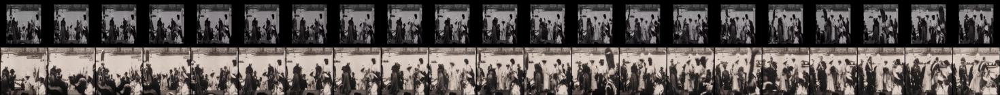

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:07:58,00:08:11,13,955736,84.749046,2
SF2221A-J.1.mpg,00:40:35,00:40:48,13,170135,84.749046,2


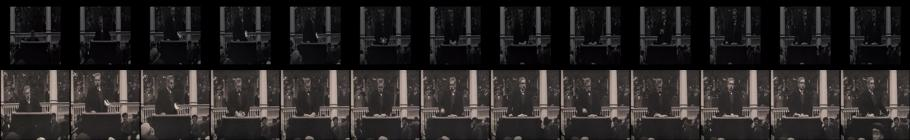

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Idrott.webm,00:13:37,00:13:49,12,976868,90.348076,8
SF2221A-J.1.mpg,01:15:34,01:15:46,12,172234,90.348076,8


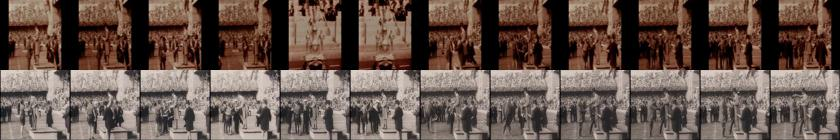

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_Å, dyre prins.webm",00:00:58,00:01:09,11,970981,102.415466,4
SF2221A-J.1.mpg,00:05:15,00:05:26,11,168015,102.415466,4


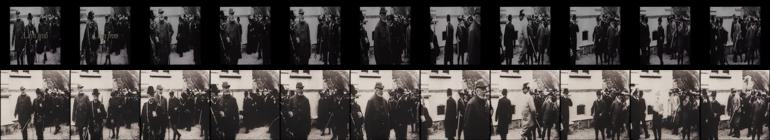

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
"Hundra svenska år_De gamla och kloka må le, fallera.webm",00:05:06,00:05:16,10,952553,87.026825,1
SF2221A-J.1.mpg,01:23:40,01:23:50,10,172720,87.026825,1


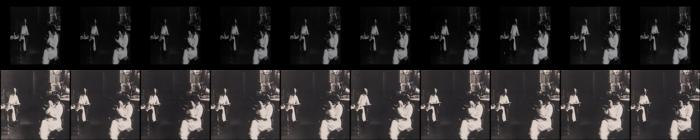

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Idrott.webm,00:14:05,00:14:14,9,976896,104.184555,5
SF2221A-J.1.mpg,01:15:37,01:15:46,9,172237,104.184555,5


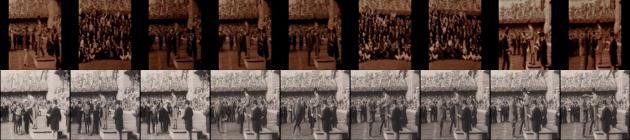

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Förväntningarnas tid_Skördetid med förhinder.webm,00:20:13,00:20:20,7,899748,107.973061,3
SF2221A-J.1.mpg,01:23:42,01:23:49,7,172722,107.973061,3


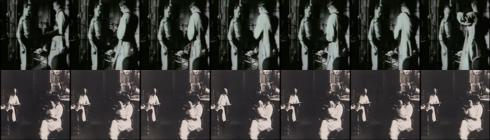

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Handel.webm,00:07:20,00:07:26,6,974304,105.340538,1
SF2221A-J.1.mpg,00:22:03,00:22:09,6,169023,105.340538,1


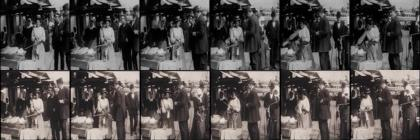

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Industri.webm,00:04:14,00:04:20,6,977236,101.720703,2
SF2221A-J.1.mpg,00:42:18,00:42:24,6,170238,101.720703,2


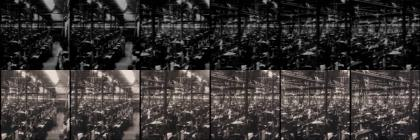

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Folkhemmet tur och retur.webm,00:10:19,00:10:24,5,955877,82.612869,0
SF2221A-J.1.mpg,01:29:18,01:29:23,5,173058,82.612869,0


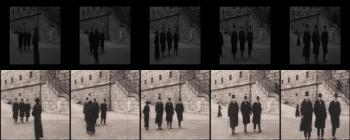

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:03:17,00:03:22,5,966094,106.414070,1
SF2221A-J.1.mpg,00:18:10,00:18:15,5,168790,106.414070,1


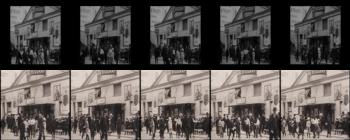

,Video 1,Video 2,Video 1 Start time,Video 1 End time,Video 2 Start time,Video 2 End time,Duration,Index Video 1,Index Video 2,Match mean distance,# not matching
29,Sverige för länge sedan_Trafik.mp4,SF2183.1.mpg,00:17:20,00:17:47,00:10:31,00:10:58,27,983352,133227,91.839058,18
46,Sverige för länge sedan_Nöjen.webm,SF2183.1.mpg,00:07:17,00:07:35,00:02:44,00:03:02,18,978488,132760,93.325912,1
78,Hundra svenska år_Jag har varit med om allt so...,SF2183.1.mpg,00:09:39,00:09:54,00:11:22,00:11:37,15,962248,133278,86.548462,6
80,Hundra svenska år_Nu har jag kastat min blå ov...,SF2183.1.mpg,00:03:17,00:03:32,00:02:44,00:02:59,15,966094,132760,85.655487,0
89,Sverige för länge sedan_Trafik.mp4,SF2183.1.mpg,00:08:48,00:09:03,00:02:20,00:02:35,15,982840,132736,94.334030,8
101,Sverige för länge sedan_Trafik.mp4,SF2183.1.mpg,00:09:29,00:09:43,00:07:59,00:08:13,14,982881,133075,99.021729,4
155,Hundra svenska år_Nu har jag kastat min blå ov...,SF2183.1.mpg,00:02:49,00:03:00,00:01:11,00:01:22,11,966066,132667,79.764496,2
177,Sverige för länge sedan_Trafik.mp4,SF2183.1.mpg,00:11:05,00:11:16,00:08:49,00:09:00,11,982977,133125,95.157021,5
241,Sverige för länge sedan_Trafik.mp4,SF2183.1.mpg,00:09:18,00:09:28,00:05:30,00:05:40,10,982870,132926,103.887871,3
326,Sverige för länge sedan_Trafik.mp4,SF2183.1.mpg,00:08:14,00:08:23,00:01:33,00:01:42,9,982806,132689,86.859314,3


,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Trafik.mp4,00:17:20,00:17:47,27,983352,91.839058,18
SF2183.1.mpg,00:10:31,00:10:58,27,133227,91.839058,18


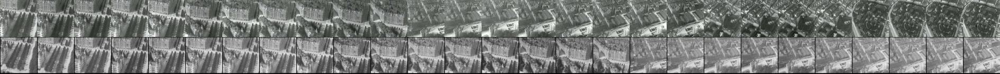

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Nöjen.webm,00:07:17,00:07:35,18,978488,93.325912,1
SF2183.1.mpg,00:02:44,00:03:02,18,132760,93.325912,1


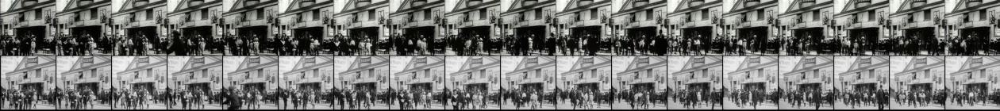

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Jag har varit med om allt som blivit nytt.webm,00:09:39,00:09:54,15,962248,86.548462,6
SF2183.1.mpg,00:11:22,00:11:37,15,133278,86.548462,6


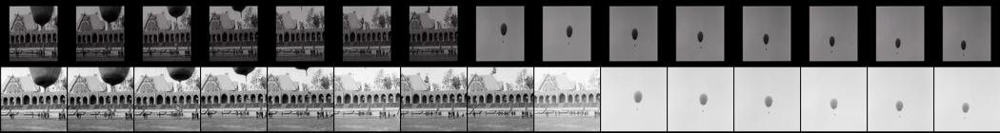

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:03:17,00:03:32,15,966094,85.655487,0
SF2183.1.mpg,00:02:44,00:02:59,15,132760,85.655487,0


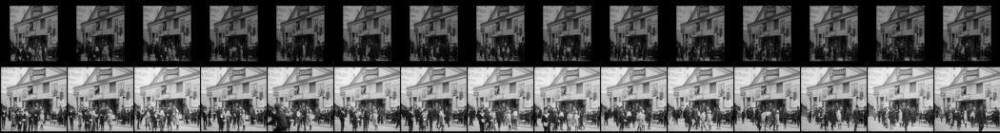

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Trafik.mp4,00:08:48,00:09:03,15,982840,94.334030,8
SF2183.1.mpg,00:02:20,00:02:35,15,132736,94.334030,8


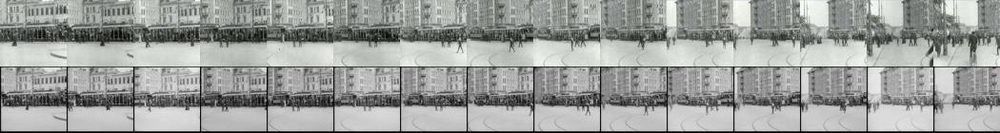

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Trafik.mp4,00:09:29,00:09:43,14,982881,99.021729,4
SF2183.1.mpg,00:07:59,00:08:13,14,133075,99.021729,4


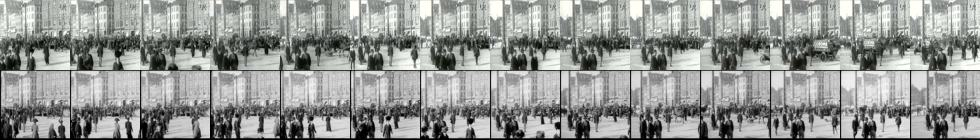

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:02:49,00:03:00,11,966066,79.764496,2
SF2183.1.mpg,00:01:11,00:01:22,11,132667,79.764496,2


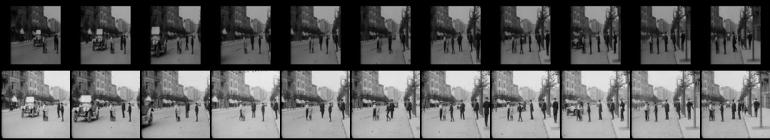

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Trafik.mp4,00:11:05,00:11:16,11,982977,95.157021,5
SF2183.1.mpg,00:08:49,00:09:00,11,133125,95.157021,5


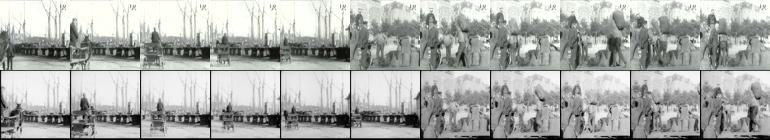

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Trafik.mp4,00:09:18,00:09:28,10,982870,103.887871,3
SF2183.1.mpg,00:05:30,00:05:40,10,132926,103.887871,3


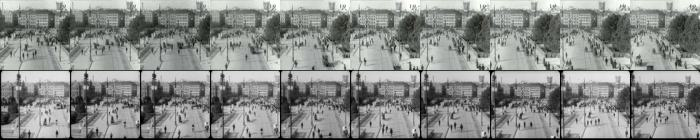

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Trafik.mp4,00:08:14,00:08:23,9,982806,86.859314,3
SF2183.1.mpg,00:01:33,00:01:42,9,132689,86.859314,3


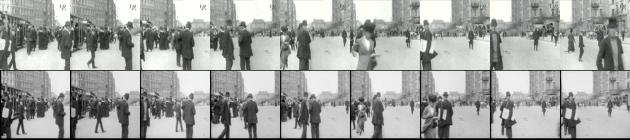

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Trafik.mp4,00:09:08,00:09:17,9,982860,87.666893,2
SF2183.1.mpg,00:01:11,00:01:20,9,132667,87.666893,2


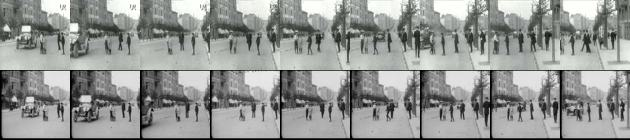

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Trafik.mp4,00:17:20,00:17:28,8,983352,nan,8
SF2183.1.mpg,00:11:00,00:11:08,8,133256,nan,8


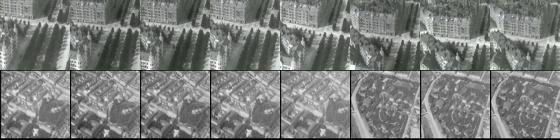

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Skolbarn.webm,00:00:28,00:00:35,7,980173,93.976128,0
SF2183.1.mpg,00:00:54,00:01:01,7,132650,93.976128,0


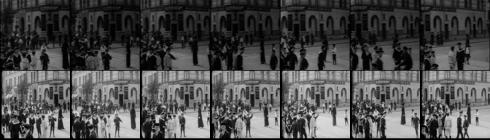

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Trafik.mp4,00:10:50,00:10:57,7,982962,89.656029,0
SF2183.1.mpg,00:09:18,00:09:25,7,133154,89.656029,0


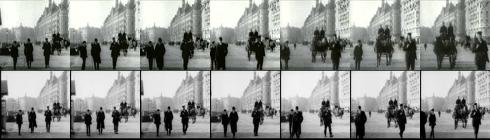

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Förväntningarnas tid_Skördetid med förhinder.webm,00:48:20,00:48:26,6,901435,113.691612,1
SF2183.1.mpg,00:01:16,00:01:22,6,132672,113.691612,1


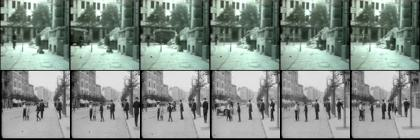

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Guldkorn från 1944.mp4,00:49:34,00:49:40,6,932686,104.381958,2
SF2183.1.mpg,00:06:03,00:06:09,6,132959,104.381958,2


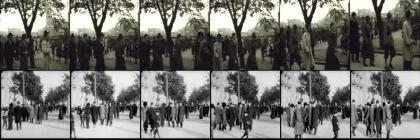

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Sverige för länge sedan_Trafik.mp4,00:14:57,00:15:03,6,983209,109.811157,2
SF2183.1.mpg,00:17:14,00:17:20,6,133630,109.811157,2


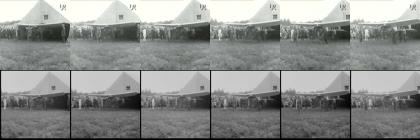

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Jag har varit med om allt som blivit nytt.webm,00:10:06,00:10:10,4,962275,108.622810,0
SF2183.1.mpg,00:13:44,00:13:48,4,133420,108.622810,0


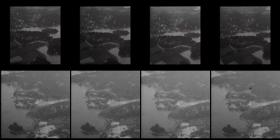

,Start time,End time,Duration,Index,Match mean distance,# not matching
Video,,,,,,
Hundra svenska år_Nu har jag kastat min blå overall.mkv,00:03:12,00:03:16,4,966089,100.684509,0
SF2183.1.mpg,00:01:37,00:01:41,4,132693,100.684509,0


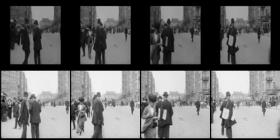

In [74]:
df = SequenceFinder.get_sequence_dataframe(combined_project_finder,combined_project_sequences)
grouped = df.groupby('Video 2')['Video 1'].nunique().sort_values(ascending=False).head(5)
print('SF video, and number of unique TV series used:')
display(grouped)
for video in grouped.keys():
    display(df[df['Video 2'] == video])
    combined_project_finder.show_notebook_sequence(contains_video(combined_project_sequences, video, combined_project_finder), show_limit=200, show_shift=False, frame_resize=(70,70), convert_format='JPEG')

After applying the same filters and features to customize the matching results (see hermeneutics layer for methodological details) we, unsurprisingly, found several reused sequences between the SF dataset and the television series. In our dataset, the titles of films in the SF-archive are always numerical (SF2001 etcetera and sometimes with letters SF2410A–C indicating sequels), yet the titles can be manually decoded and identified with the help of The Swedish Media Database ([SMDB](https://smdb.kb.se/smdb/english/)).

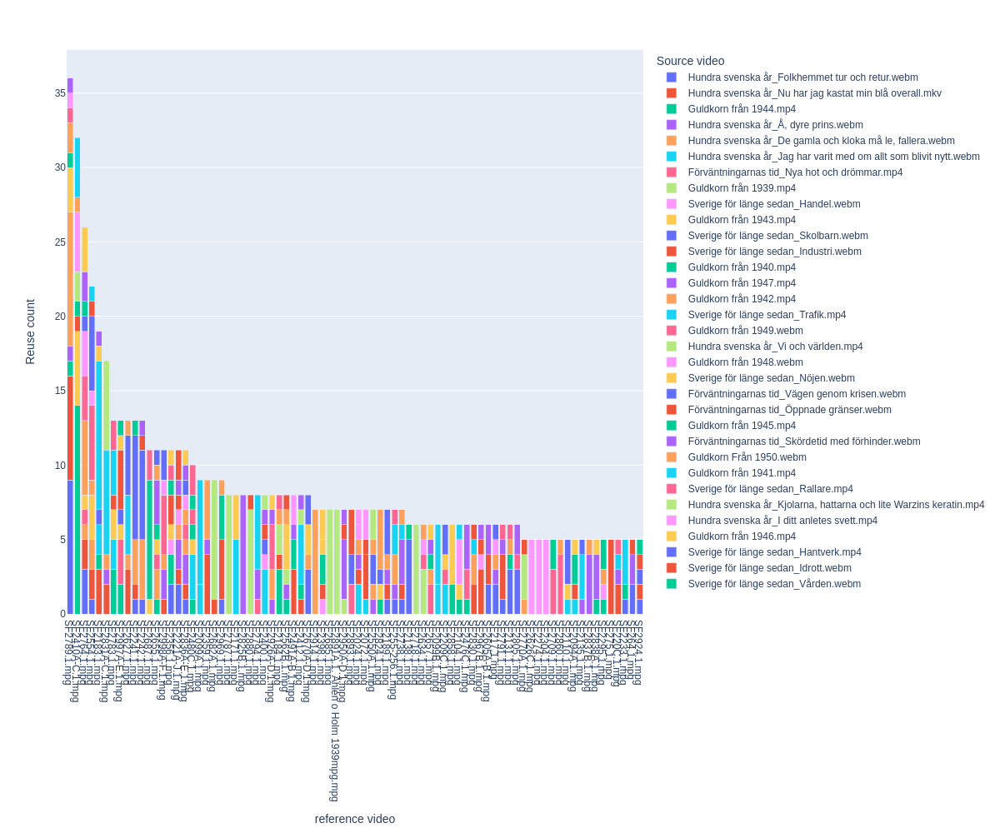

In [27]:
image_metadata("./media/plot_2.png", metadata="Chart showing the most reused clips from the SF archive to the left. The reuse count refers to the number of identified sequences. To produce this chart, we searched for sequences that were at least 5 seconds long. We also applied a distance metric of 120 and allowed a maximum of two frames within each sequence to deviate from this threshold. All matches *within* the TV dataset and SF dataset respectively were removed, to only show matching results *between* the two datasets. In this graph, no unwated sequences had been filtered out manually, meaning that the matching results contain a lot of inaccuracies. For more details, see hermeneutics layer.")

Looking at the plot in figure 28, a first thing to note is that sequences from the film SF2789.1 appear to have been reused the most. Over 35 sequences from this film were identified in 11 of the TV series episodes. SF2789 is, in fact, a short film from 1930, [*Medan båten glider*](https://www.filmarkivet.se/movies/medan-baten-glider/) (*While the boat is drifting*) featuring Prince Wilhelm, a royal Swedish media celebrity, himself an avid filmmaker (and author). In the film, Prince Wilhelm recites his poem "While the Boat is Drifting", evocing northern Scandinavia's "sparkling mountain lakes and mile-wide desert forests with their strange and enchanting mysticism". However, unfortunately for Prince Wilhelm, his recital was not actually reused since the VRD excessively mismatched the medium shot of Wilhelm (from his knees up). For instance, the VRD inaccurately suggested that he was both identical to an unknown woman in Häger's *A Hundred Swedish Years*, as well as (somewhat surprisingly) social democratic finance minister Ernst Wigforss (in the same TV series), and particularly so in a medium shot of him taken from a famous scene in Swedish film history with Wigforss debating God in a [1946 election film](https://www.filmarkivet.se/movies/per-albin-svarar-valkomna-till-oss/) (figure 29).

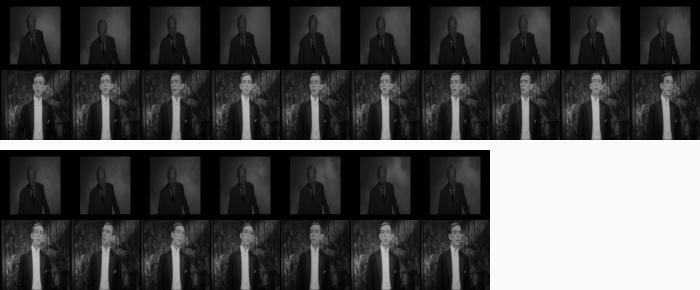

In [23]:
image_metadata("./media/wilhelm.jpeg", metadata="Mismatched sequence between Erst Wigforss and Prince Whilhelm. Upper row: *A Hundred Swedish Years*, 'A Round Trip to Folkhemmet'. Start time 00:32:37. End Time 00:32:54. Bottom row: *SF2789.1.* Start time 00:13:37. End time 00:13:54.")

After a second round of processing our matching results and manually removing a series of mismatched frames, such as the one showing Prince Wilhelm above, we are left with a slightly more accurate graph of the final matching results (figure 30). In this process, we also removed a series of manually identified mismatched sequences containing (near-)single-color frames, and frames showing easily misinterpreted scenes such as ocean horizons, trees, and clouds. Again, however, the plot should not be read as an absolute proof of reuse, since it still contains mismatched sequences that are kept to avoid filtering out correct matches. In other words, we once again approach the plot as a tool for getting an overview of *where to start looking for* actual instances of reuse. 

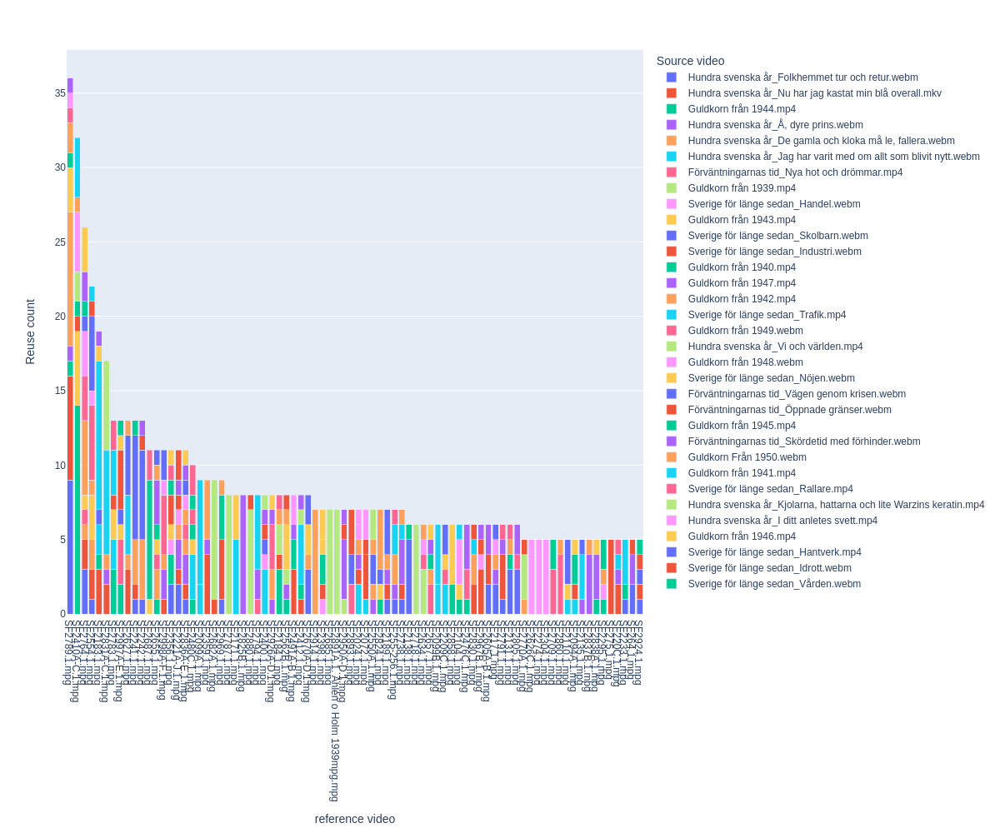

In [26]:
image_metadata("./media/plot_3.png", metadata="Graph showing the most reused clips from the SF archive to the left. To produce this graph, we applied a distance metric threshold of 120, and filtered out all sequences that were shorter than 5 seconds, allowing 2 skipped frames per sequence.")

Since all of our historical documentaries were based on the SF-archive – to a greater or lesser degree – the reuse depicted in the plot above did not come as a particular surprise. But which type of footage was reused, and what kind of sequences were favored by the filmmakers? The VRD helps us untangle some of these questions. Following the chart above, for instance, the VRD suggests that the film SF2836A – *Gustaf V in memoriam*, a short film about the Swedish king Gustaf V from 1950 – was reused in ten different documentary episodes within our televisual dataset. A number of these matches are incorrect but some, such as *Gold Nuggets* (from 1946), reused a 13 seconds long sequence from the SF archive, and so did the TV series *Time of Expectations*. 

The reason for the popularity of SF2836A was likely twofold: on the one hand, it focused on the royal family – a frequent topic of newsreels during the first half of the 20th-century – and on the other hand, SF2836A was described as "a memory film" (compiled by filmmaker Nils Jerring) of the life and times of Gustaf V who passed away in 1950 (figure 31). In short, SF2836 gave later filmmakers the opportunity to find earlier footage of a popular subject, as well as more contemporary sequences. In Olle Häger's episode of the royal family in Sweden, ["Å dyre prins"](https://www.youtube.com/watch?v=xYwA4EK8rog) ('O, Esteemed Prince', in *A Hundred Swedish Years*) at least one sequence was taken from SF2836A depicting royal marriage (and its difficulties).

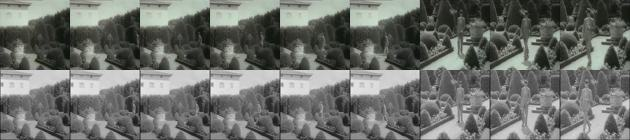

In [30]:
image_metadata("./media/royal.jpeg", metadata="Footage of Swedish royal estates. Upper row: *Time of Expectations*, 'New Challenges and Dreams'. Start time 00:25:10. End Time 00:25:19. Bottom row: *SF2836A-E.1*. Start time 00:24:27. End time 00:24:36.")

Another film from the SF-archive that features prominently in the reused footage is SF2410A-C. The VRD claims that sequences are reused eighteen times in seven different episodes in our televisual dataset. The are many mismatches, however. SF2410A-C depicts scenes from the Swedish navy in 1918, and Häger reused a sequence of explosions at sea in his last episode of *A Hundred Swedish Years* (figure 32). Interestingly, the VRD suggests reuse of SF2410A-C within Bergman's [*Gold Nuggets* (from the year 1941)](https://www.youtube.com/watch?v=x5W2jTeFYfM), thus indicating ahistorical representation. Of course, documentary films are not always historically accurate, especially concerning added sound or the usage of *iconic* footage (to use C.S. Peirce terminology). The VRD claims (amusingly) that scenes of the Swedish navy in 1918 are similar to the Soviet fleet during the Second World War, which is obviously not correct.

Accurate matches are, however, found for SF2221A-J, a numerical title that refers to Gardar Sahlberg's compilation film *When the Century was Young* (När seklet var ungt) from 1961 (figure 33 and 34). This is not surprising since Sahlberg's film was based on old newsreels and film fragments from the SF-archive, and espcially the oldest footage from before the First World War. In fact, Sahlberg is the person who during the 1960s was responsible for cataloging and preserving the SF-archive once it was bought by Radio Sweden from SF in 1954. As an homage to Sahlberg (one might assume) both Bergman in Sweden, *A Long Time Ago* and Häger reused SF2221A-J a lot. What we discover with the help of the VRD is thus a kind of meta-reuse or media archaeology of film historical layers, with TV documenataries reusing footage from a historical compilation film based on the SF-archive. We are also reminded of how this footage is remediated once more, as RosaMannen has uploaded *Sweden, A Long Time Ago*, 'Commerce' on [YouTube](https://www.youtube.com/watch?v=ygZkTkTPaYs). In this context, the episode has triggered a discussion around the age of the footage: "Must be before 1914 when open market trade with meat was banned in 1914", suggests the user @jonasglanshed.

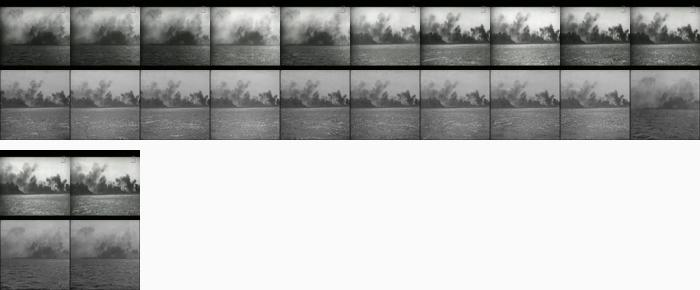

In [31]:
image_metadata("./media/explosion.jpeg", metadata="Military exercise performed by the Swedish navy in 1918. Upper row: *A Hundred Swedish Years*, 'The World and Us'. Start time 00:08:57. End Time 00:09:09. Bottom row: *SF2410A-C.1.* Start time 00:09:47. End time 00:09:59.")

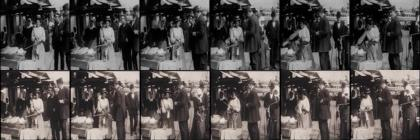

In [32]:
image_metadata("./media/sahlberg_1.jpeg", metadata="Reuse of a Gardar Sahlberg's compilation film *When the century was young*. Upper row: *Sweden, A Long Time Ago*, 'Commerce'. Start time 00:07:20. End Time 00:07:26. Bottom row: *SF2221A-J.1.* Start time 00:22:03. End time 00:22:09")

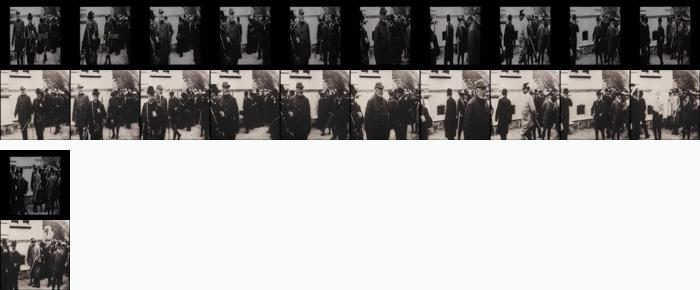

In [33]:
image_metadata("./media/sahlberg_2.jpeg", metadata="Reuse of a Gardar Sahlberg's compilation film *When the century was young*. Upper row: *A Hundred Swedish Years*, 'O, Esteemed Prince'. Start time 00:00:58. End Time 00:01:09. Bottom row: *SF2221A-J.1*. Start time 00:05:15. End time 00:05:26.")

One particularly interesting reuse concerns the film fragment SF2183 (figure 35 and 36). It contains footage from Stockholm shot in 1913 and 1914, with different film fragments depicting everyday life in an urban setting as well as sequences shot from two early ballon ascents over the capital. In his documentary *Sweden, A Long Time Ago* Bergman reused an almost thirty seconds long sequence from these aerial balloon shots. Häger also reused similar sequences in his episode ["I Have Seen Everything That Is New"](https://www.youtube.com/watch?v=cVtFOZMHZjA) of *A Hundred Swedish Years*, both the acent of the ballon and aerial shots of Stockholm from above. 

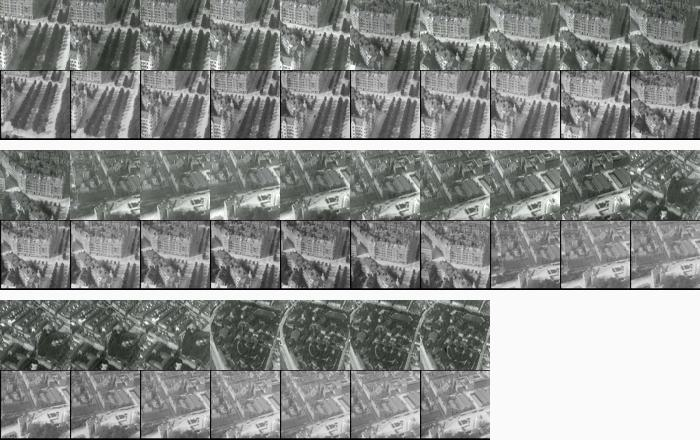

In [34]:
image_metadata("./media/balloon_1.jpeg", metadata="Reused sequence shot from an air balloon above Stockholm. Upper row: *Sweden, A Long Time Ago*, 'Traffic'. Start time 00:17:20. End Time 00:17:47. Bottom row: *SF2183.1.* Start time 00:10:31. End time 00:10:58.")

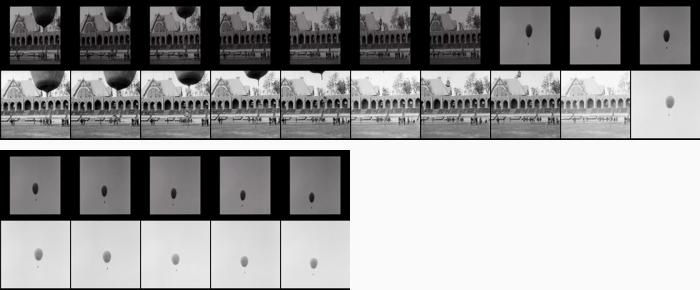

In [35]:
image_metadata("./media/balloon_2.jpeg", metadata="Reused sequence shot from an air balloon above Stockholm. Upper row: *A Hundred Swedish Years*, 'I Have Experienced All That is New'. Start time 00:09:39. End Time 00:09:54. Bottom row: *SF2183.1.* Start time 00:11:22. End time 00:11:37.")

It is hardly surprising that prolonged sequences shot from a balloon appears in these documentaries. The footage is simply stunning. In fact, SF2183 seems to have been a favorite archival film for both Bergman and Häger. The reuse that was previously described – featuring automobiles, trams, the horse-drawn hearse, and the cinema Pariserteatern – all have their origins in SF2183. Not only is the footage from SF2183 frequently reused, but the film also has an interesting archival history in itself. Following catalog information and metadata found at the National Library of Sweden, this thirteen-minute film includes five different types of footage: everyday life in Vasastan (a neighborhood in Stockholm), shots of the cinema Pariserteatern, various images from Stockholm, and balloon ascents in 1914 and 1913. Since there are no copyright restrictions, the Stockholm City Museum have included the separate films from SF2183 on their portal [Stockholmskällan](https://stockholmskallan.stockholm.se/sok/?q=SF%202183). Online it is hence possible both to watch the [sequences from Vasastan](https://stockholmskallan.stockholm.se/post/29570) in accurate frame rate (which is not always the case on YouTube) or the [balloon ascent from Stockholm's Olympic stadium](https://stockholmskallan.stockholm.se/post/29565) in 1913. In the last film, however, it is apparent from the intertitle that it is not of Swedish origin. On the contrary, it is clearly a Pathé film production. The SF-archive, in fact, contains a lot of international films and film fragments which SF and later Radio Sweden claimed to have  copyrights to – which they obviously did not.

## Concluding remarks

When Radio Sweden purchased the SF-archive in 1964, the sole purpose was reuse. Old films were to be compiled into new TV programs and given an afterlife in a novel medium, albeit in re-edited form. Today, a similar reuse of moving images also occurs on digital platforms, as old television programs and films have found a haven on YouTube (and similar sites). RosaMannen’s ways of making Swedish TV history available are appreciated by many and have been tolerated by SVT, perhaps because his VHS copies are of lesser quality. Then again, YouTube is today also the platform for algorithmic upscaling experiments of predominantly older films (to avoid IPR issues). Material from the SF-archive has, for example, been reused and uploaded by [ColorByCarl](https://www.youtube.com/@colorbycarl), with footage  remastered and upscaled to 4K and 60 frames per second using various AI and software toolkits. Even if film archivists usually detest machine learning algorithms, such upscaling has received immense attention: Denis Shiryaev upscaled version of footage from the SF-archive – shot by [Swedish Biograph in New York in 1911](https://www.youtube.com/watch?v=hZ1OgQL9_Cw&t=1s) – has been viewed more than twenty million times (all likely including a number of bots). Naturally, algorithms alter these films but so did prior TV-producers. A wider digital context of the Video Reuse Detector hence also includes computational reuse in other ways. All likely, an increasing amount of films from the SF-archive will surmount on YouTube – or as Abigail de Kosnik has stated: "Online, each media commodity becomes, at the instant of its release, an archive to be plundered, an original to be memorized, copied, and manipulated – a starting point or springboard for receivers’ creativity, rather than an end unto itself" (<cite data-cite="1971321/ZD4PDJV5"></cite>).

The part of the SF-archive that was studied in this article includes some of the very first Swedish film materials, such as sequences shot by a local Lumière cinematographer at the Stockholm exhibition in 1897. These films are popular and have habitually been used in historical television documentaries, since they are the oldest depicting Sweden. To our surprise, however, they did not feature prominently in our televisual dataset. This indicates that the VRD can not just be used to discern reuse, but also archival absences, gaps and missing examples of reuse. In theory, it would be even possible to detect exactly what sequences from the SF-archive were most popular and reused by TV producers at Swedish Television (SVT) from the mid-1960s until today, should the datasets be enlarged. In the example presented here, we included roughly 1,400 videos from the SF-archive. Taking the research further, it would of course be interesting to include a larger part of the archive, if not the entire archive as such.

On a practical level, the VRD toolkit does not fully automate the search for audiovisual reuse yet it evidently makes it possible to search for - and find - audiovisual reuse in datasets whose size far outreaches what any individual human being can process. While manual labor is still needed to interpret the match results (involving, for instance, double-checking filtering settings, sorting out unwanted frames, and iteratively tweaking and improving the similarity search), we hope to have shown that the toolkit can be of help when sorting through large archives of film. Since the VRD's ways of searching for visual similarities is based on still images, it is worth noting that the basic features of the toolkit (using the CNN + FAISS library, as well as some of the code for filtering matching results) could also be applied to study the reuse of images in general (photographs, drawings etc.,).

There are, however, a couple of things to keep in mind when using the toolkit. For instance, the matching results presented in this article would likely change if another CNN was used, or if the fingerprints would have been extracted from another layer in EfficientNetB4. Similarly, using another indexation library than Faiss to calculate similarity neighbors – such as [Annoy](https://github.com/spotify/annoy), [Milvus](https://milvus.io/), or [Hnswlib](https://github.com/nmslib/hnswlib) – would likely impact the matching results. Currently, we have not done any extensive performance tests or comparisons with these tools. All of this is to say that every application of the VRD will generate a specific set of outputs that are specific to the datasets and settings at hand.

Aside from these practical issues, a couple of broader pitfalls and ethical issues regarding the use of CNNs must also be considered. For instance, CNNs have been widely critiqued for being biased – primarily because of problems surrounding their training datsets where sociodemographic groups such as women, people of color, LGBTQ+ communities, and people with disabilities – are frequently heavily underrepresented (<cite data-cite="1971321/FXZYJ9Z8"></cite>). As a result, several CNNs have been shown to carry racial, sexual, and heteronormative biases, as well as biases relating to functionality. Similarly, images from non-Western countries are often heavily underrepresented in training datasets, meaning that many CNNs have difficulties recognizing non-Western household environments such as kitchens/bathrooms and the everyday objects, furniture, and utensils found therein (<cite data-cite="1971321/ZFWA7ZZI"></cite>). The VRD does not use machine learning to classify objects and humans that appear in images. However, this does not mean that the toolkit escapes the general biases that are associated with CNNs. For instance, there is every reason to assume that the VRD will be most successful processing visual imagery that depicts contemporary, commercial, and European/Anglo-American environments. 

### Areas of future development

There are several ways in which the VRD toolkit could be developed further. For example, adding more features for analyzing the effects of applied filters (for instance in the form of statistics showing lost matching results) could provide more transparency and help in finding the right parameters for each filter. More efforts could also go into implementing features for preparing datasets, for instance by removing or ignoring frames that contain a lot of text or single-color (or near-single-color) frames. One possible way of removing text-heavy frames could involve using the OCR features that are embedded in ffmpeg. Regarding the removal of (near-)single-color frames, we have experimented with an algorithm that can currently be found in the `is_monochrome` function in the file "image_preprocessing.py" found on [Github](https://github.com/humlab/video_reuse_detector). 

Another way of dealing with the problem of unwanted frames could involve making use of the neural network's capacities to recognize text, talking heads, and black frames when preparing datasets. In particular, it would be useful if such filters could be applied *before* frames are processed with CNNs and Faiss, as this would likely reduce the image processing time and improve the accuracy of the distance metric distribution. At the moment, however, none of these features have been fully embedded in the VRD.

To further improve the toolkit, we have also played with the idea of using an ensemble method. This involves allowing multiple deep-learning models to identify similar frames, and reaching a concensus before presenting the results. This could help alleviate any issues where a specific model is vulnerable to identifying similar (but not identical) scenes as being the same, for example the previously mentioned talking heads. It would also give us an additional metric to use to express confidence in the results, and automatically flag low-confidence matches. In cases where a specific match is under doubt, an alternative method could be used if it is more accurate, even if this hypothetical method is computationally expensive.

Currently, the VRD is equipped with several features for double-checking, scrutinizing, and handling false positives – that is, instances when sequences have been found and given low distance metric values, even though they do not exemplify an actual instance of reuse. As previously discussed, this may for example concern sequences containing text, black frames, or talking heads. However, the toolkit does not include any features for scrutinizing and handling false negatives – i.e. instances when a correct sequence has not been found and is thus excluded from the matching results. For instance, false negatives may appear if a video contains lots of still images or slow visual movements, which can cause correct matches to be "pushed out" of the top 250 closest neighbors for each analysed frame (see discussion in section [Step 3. Calculate similarity neighbours](#Step-3.-Calculate-similarity-neighbours)). Adding features for double-checking false negatives is thus another possible area of future development. 

So is improving the database structure that underlies the toolkit, which could be enhanced to better handle multiple fingerprints from the same set of images. We also believe that much could be done regarding the structured and large-scale testing of the performance of the toolkit, for example based on the use of different CNNs, different kinds of source materials, and different tools for calculating nearest similarity neighbors. Given the possibility to embed complex plots, graphs, tables, and visualizations in Jupyter Notebooks, there are also many opportunities to develop how matching results are shown. In many cases, however, these solutions need to be customized to the specific dataset and research questions that are explored. For instance, the possibility to present matching results in graphic visualizations in a relevant way is heavily dependent on the size of datasets, which makes it difficult to embed general features in toolkits such the VRD. One of the great advantages of Jupyter Notebooks, however, is that users have every opportunity to add and remove features from the VRD toolkit by themselves. A good place to start is by using the [Plotly](https://plotly.com/python/) library, which is currently embedded in the VRD.

Areas of future development aside, we hope that this article has demonstrated the potential of using machine learning to explore audiovisual reuse and showcased the possibilities of using the VRD to navigate historic archives in new ways. 